In [21]:
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras import losses
from tensorflow.keras import metrics

In [2]:
from sklearn.feature_extraction.text import CountVectorizer
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Model
from keras.layers import *

In [3]:
import tensorflow as tf
import numpy as np

In [4]:
from gensim import models

okt_model = models.word2vec.Word2Vec.load('NaverMovie_okt_wo_jep.model')

In [7]:
import pandas as pd

In [8]:
train_data = pd.read_csv('ratings_train.txt',sep='\t').dropna().reset_index(drop=True)
test_data = pd.read_csv('ratings_test.txt',sep='\t').dropna().reset_index(drop=True)

training_sentences = []
testing_sentences = []

In [9]:
documents = []
for item in train_data.document:
    documents.append(item)

labels = []
for item in train_data.label:
    labels.append(item)

In [10]:
test_documents = []
for item in test_data.document:
    test_documents.append(item)

test_labels = []
for item in test_data.label:
    test_labels.append(item)

In [12]:
vocab_size = 20000
embedding_dim = 200
max_length = 41
trunc_type='post'
oov_tok = '<OOV>'

tokenizer = Tokenizer(num_words = vocab_size, oov_token=oov_tok)
tokenizer.fit_on_texts(documents)

In [24]:
word_index = tokenizer.word_index
text_sequences = tokenizer.texts_to_sequences(documents)
print(len(word_index))
print(word_index)

padded = pad_sequences(text_sequences,maxlen=max_length,truncating = 'pre')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [25]:
testing_sequences = tokenizer.texts_to_sequences(test_documents)
test_padded = pad_sequences(testing_sequences, maxlen=max_length)

In [16]:
len(word_index)

296311

In [13]:
word_index

{'<OOV>': 1,
 '영화': 2,
 '너무': 3,
 '정말': 4,
 '진짜': 5,
 '이': 6,
 '그냥': 7,
 '왜': 8,
 '이런': 9,
 '더': 10,
 '수': 11,
 '영화를': 12,
 '다': 13,
 '잘': 14,
 '좀': 15,
 '보고': 16,
 'ㅋㅋ': 17,
 '그': 18,
 '영화는': 19,
 '영화가': 20,
 '본': 21,
 '봤는데': 22,
 '최고의': 23,
 '아': 24,
 '이건': 25,
 '내가': 26,
 '없는': 27,
 '없다': 28,
 '드라마': 29,
 '완전': 30,
 '이렇게': 31,
 '참': 32,
 '이거': 33,
 '평점': 34,
 '그리고': 35,
 '이게': 36,
 '좋은': 37,
 '있는': 38,
 '연기': 39,
 '내': 40,
 '평점이': 41,
 '보는': 42,
 '다시': 43,
 '스토리': 44,
 '역시': 45,
 '최고': 46,
 '쓰레기': 47,
 '난': 48,
 '많이': 49,
 'ㅋ': 50,
 '것': 51,
 'ㅋㅋㅋ': 52,
 '한': 53,
 'ㅠㅠ': 54,
 '재밌게': 55,
 '없고': 56,
 '또': 57,
 '하는': 58,
 '아깝다': 59,
 '꼭': 60,
 '보면': 61,
 '가장': 62,
 '마지막': 63,
 '뭐': 64,
 '영화다': 65,
 '무슨': 66,
 '하지만': 67,
 'ㅡㅡ': 68,
 'ㅎㅎ': 69,
 '10점': 70,
 '별로': 71,
 '같은': 72,
 '작품': 73,
 '솔직히': 74,
 '끝까지': 75,
 '볼': 76,
 '넘': 77,
 '안': 78,
 '대한': 79,
 '만든': 80,
 '와': 81,
 '봐도': 82,
 'ㅠ': 83,
 '전혀': 84,
 '그래도': 85,
 '같다': 86,
 '말이': 87,
 '좋다': 88,
 '지금': 89,
 '아주': 90,
 '뭔가': 91,
 '있다': 9

In [15]:
print(padded[0])
print(padded.shape)

[   0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0   24  937    5 6728 1098]
(149995, 41)


In [17]:
okt_model.wv.word_vec

<bound method WordEmbeddingsKeyedVectors.word_vec of <gensim.models.keyedvectors.Word2VecKeyedVectors object at 0x7fe37d91ef70>>

In [36]:
okt_model.wv.__getitem__('영화')

array([ 0.12119786,  0.05254925,  0.11666581,  0.00956702, -0.08624224,
       -0.08833613, -0.17021699,  0.4042423 ,  0.20302576, -0.10528007,
        0.08093155, -0.087348  ,  0.09609   , -0.249641  ,  0.15883704,
        0.02089171,  0.17305753,  0.14782053, -0.09545022, -0.03725938,
       -0.18407936,  0.12546061,  0.15644677, -0.05640691,  0.10128642,
        0.18283078, -0.0904993 , -0.04083158,  0.08176205, -0.08159911,
       -0.03998358, -0.07812551,  0.11512112,  0.06677101, -0.11404743,
       -0.0407777 ,  0.08842587, -0.041789  ,  0.08205824, -0.00235391,
       -0.1321882 , -0.01480534,  0.04746222, -0.07225914,  0.00377097,
       -0.30144978, -0.00377448,  0.07460964, -0.04190301, -0.16758958,
       -0.269369  , -0.02010972, -0.08711573,  0.11878891, -0.14280207,
        0.10571102, -0.01736576, -0.17804615,  0.21601959,  0.06440319,
        0.04023864, -0.17576098, -0.07381154, -0.0163809 , -0.20358616,
        0.07889241,  0.02014136, -0.21393687,  0.01464214,  0.00

In [27]:
embedding_matrix = np.zeros((vocab_size, embedding_dim))

index = 0 
for word, idx in tokenizer.word_index.items():
    try:
        embedding_vector = okt_model.wv.__getitem__(word)
        if embedding_vector is not None:
            embedding_matrix[idx] = embedding_vector
    except Exception as e:
        print(word)
        print(e)
        
embedding_matrix.shape

<OOV>
"word '<OOV>' not in vocabulary"
영화를
"word '영화를' not in vocabulary"
영화는
"word '영화는' not in vocabulary"
영화가
"word '영화가' not in vocabulary"
봤는데
"word '봤는데' not in vocabulary"
최고의
"word '최고의' not in vocabulary"
이건
"word '이건' not in vocabulary"
내가
"word '내가' not in vocabulary"
없는
"word '없는' not in vocabulary"
참
"word '참' not in vocabulary"
이거
"word '이거' not in vocabulary"
이게
"word '이게' not in vocabulary"
좋은
"word '좋은' not in vocabulary"
있는
"word '있는' not in vocabulary"
평점이
"word '평점이' not in vocabulary"
보는
"word '보는' not in vocabulary"
재밌게
"word '재밌게' not in vocabulary"
없고
"word '없고' not in vocabulary"
하는
"word '하는' not in vocabulary"
보면
"word '보면' not in vocabulary"
영화다
"word '영화다' not in vocabulary"
10점
"word '10점' not in vocabulary"
같은
"word '같은' not in vocabulary"
솔직히
"word '솔직히' not in vocabulary"
끝까지
"word '끝까지' not in vocabulary"
넘
"word '넘' not in vocabulary"
만든
"word '만든' not in vocabulary"
봐도
"word '봐도' not in vocabulary"
말이
"word '말이' not in vocabulary"
영화의
"word '영화의' not

"word '하다가' not in vocabulary"
말도안되는
"word '말도안되는' not in vocabulary"
높아
"word '높아' not in vocabulary"
연기력은
"word '연기력은' not in vocabulary"
보기에는
"word '보기에는' not in vocabulary"
깨닫게
"word '깨닫게' not in vocabulary"
꽤나
"word '꽤나' not in vocabulary"
하는게
"word '하는게' not in vocabulary"
시리즈는
"word '시리즈는' not in vocabulary"
1편
"word '1편' not in vocabulary"
포스터가
"word '포스터가' not in vocabulary"
아쉽지만
"word '아쉽지만' not in vocabulary"
돈을
"word '돈을' not in vocabulary"
소중한
"word '소중한' not in vocabulary"
살다살다
"word '살다살다' not in vocabulary"
책을
"word '책을' not in vocabulary"
감독을
"word '감독을' not in vocabulary"
느낄수
"word '느낄수' not in vocabulary"
원작에
"word '원작에' not in vocabulary"
명작을
"word '명작을' not in vocabulary"
자체는
"word '자체는' not in vocabulary"
색다른
"word '색다른' not in vocabulary"
봤는데도
"word '봤는데도' not in vocabulary"
영상이
"word '영상이' not in vocabulary"
부분도
"word '부분도' not in vocabulary"
많은데
"word '많은데' not in vocabulary"
따라
"word '따라' not in vocabulary"
감동은
"word '감동은' not in vocabulary"
생각으로
"word '생각으로' 

났다
"word '났다' not in vocabulary"
하세요
"word '하세요' not in vocabulary"
만드네
"word '만드네' not in vocabulary"
표현할
"word '표현할' not in vocabulary"
무거운
"word '무거운' not in vocabulary"
억지스럽고
"word '억지스럽고' not in vocabulary"
대박이다
"word '대박이다' not in vocabulary"
해야지
"word '해야지' not in vocabulary"
부족하고
"word '부족하고' not in vocabulary"
모든것이
"word '모든것이' not in vocabulary"
의한
"word '의한' not in vocabulary"
알바가
"word '알바가' not in vocabulary"
m창
"word 'm창' not in vocabulary"
쓰레기를
"word '쓰레기를' not in vocabulary"
결국은
"word '결국은' not in vocabulary"
맞아
"word '맞아' not in vocabulary"
10대
"word '10대' not in vocabulary"
웃음을
"word '웃음을' not in vocabulary"
완성도가
"word '완성도가' not in vocabulary"
문제를
"word '문제를' not in vocabulary"
후반부에
"word '후반부에' not in vocabulary"
스토리로
"word '스토리로' not in vocabulary"
얘기를
"word '얘기를' not in vocabulary"
수는
"word '수는' not in vocabulary"
시리즈를
"word '시리즈를' not in vocabulary"
짜증나게
"word '짜증나게' not in vocabulary"
주인공들이
"word '주인공들이' not in vocabulary"
아까워서
"word '아까워서' not in vocabulary"
이해

본적이
"word '본적이' not in vocabulary"
묘하게
"word '묘하게' not in vocabulary"
감정이입이
"word '감정이입이' not in vocabulary"
몇번이나
"word '몇번이나' not in vocabulary"
현실성이
"word '현실성이' not in vocabulary"
1위
"word '1위' not in vocabulary"
통쾌한
"word '통쾌한' not in vocabulary"
틈이
"word '틈이' not in vocabulary"
미안하지만
"word '미안하지만' not in vocabulary"
일깨워주는
"word '일깨워주는' not in vocabulary"
모르겠는데
"word '모르겠는데' not in vocabulary"
알지
"word '알지' not in vocabulary"
새롭게
"word '새롭게' not in vocabulary"
잼있는
"word '잼있는' not in vocabulary"
대실망
"word '대실망' not in vocabulary"
알았더니
"word '알았더니' not in vocabulary"
내용으로
"word '내용으로' not in vocabulary"
고마운
"word '고마운' not in vocabulary"
재미만
"word '재미만' not in vocabulary"
가슴아픈
"word '가슴아픈' not in vocabulary"
이해할수
"word '이해할수' not in vocabulary"
3번
"word '3번' not in vocabulary"
재미있었고
"word '재미있었고' not in vocabulary"
기대는
"word '기대는' not in vocabulary"
각자의
"word '각자의' not in vocabulary"
돌아보게
"word '돌아보게' not in vocabulary"
되었는데
"word '되었는데' not in vocabulary"
유머가
"word '유머가' not in voca

"word '다가오는' not in vocabulary"
있었어요
"word '있었어요' not in vocabulary"
시리즈로
"word '시리즈로' not in vocabulary"
본질을
"word '본질을' not in vocabulary"
대박입니다
"word '대박입니다' not in vocabulary"
그렇다치고
"word '그렇다치고' not in vocabulary"
여자친구랑
"word '여자친구랑' not in vocabulary"
잊혀지지가
"word '잊혀지지가' not in vocabulary"
이전에
"word '이전에' not in vocabulary"
생각해요
"word '생각해요' not in vocabulary"
욕나옴
"word '욕나옴' not in vocabulary"
영화다운
"word '영화다운' not in vocabulary"
밋밋하고
"word '밋밋하고' not in vocabulary"
드라마에서
"word '드라마에서' not in vocabulary"
1인
"word '1인' not in vocabulary"
영화관가서
"word '영화관가서' not in vocabulary"
흥미진진하고
"word '흥미진진하고' not in vocabulary"
잊을수가
"word '잊을수가' not in vocabulary"
놈들이
"word '놈들이' not in vocabulary"
꿈이
"word '꿈이' not in vocabulary"
찾았다
"word '찾았다' not in vocabulary"
중요한건
"word '중요한건' not in vocabulary"
괴물이
"word '괴물이' not in vocabulary"
주려고
"word '주려고' not in vocabulary"
후한
"word '후한' not in vocabulary"
까는
"word '까는' not in vocabulary"
욕만
"word '욕만' not in vocabulary"
낳은
"word '낳은' not in voc

"word 'ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ' not in vocabulary"
제목으로
"word '제목으로' not in vocabulary"
눈은
"word '눈은' not in vocabulary"
1은
"word '1은' not in vocabulary"
못하면
"word '못하면' not in vocabulary"
자연의
"word '자연의' not in vocabulary"
관람불가
"word '관람불가' not in vocabulary"
재미없을
"word '재미없을' not in vocabulary"
않길
"word '않길' not in vocabulary"
기대했건만
"word '기대했건만' not in vocabulary"
만든것
"word '만든것' not in vocabulary"
되요
"word '되요' not in vocabulary"
흐른다
"word '흐른다' not in vocabulary"
제작진은
"word '제작진은' not in vocabulary"
나라는
"word '나라는' not in vocabulary"
인상적이었다
"word '인상적이었다' not in vocabulary"
복수극
"word '복수극' not in vocabulary"
안되지
"word '안되지' not in vocabulary"
낫다고
"word '낫다고' not in vocabulary"
녹아있는
"word '녹아있는' not in vocabulary"
평점조절
"word '평점조절' not in vocabulary"
평가할
"word '평가할' not in vocabulary"
개가
"word '개가' not in vocabulary"
팬이지만
"word '팬이지만' not in vocabulary"
갔다가
"word '갔다가' not in vocabulary"
없군요
"word '없군요' not in vocabulary"
케릭터
"word '케릭터' not in vocabulary"
이때까지
"word '이때까지' not in vocabular

반전이라고
"word '반전이라고' not in vocabulary"
뻔했다
"word '뻔했다' not in vocabulary"
쓰레기에
"word '쓰레기에' not in vocabulary"
그랬지만
"word '그랬지만' not in vocabulary"
전해지는
"word '전해지는' not in vocabulary"
스토리라인
"word '스토리라인' not in vocabulary"
잘어울리는
"word '잘어울리는' not in vocabulary"
낮은게
"word '낮은게' not in vocabulary"
어디다
"word '어디다' not in vocabulary"
싶어졌다
"word '싶어졌다' not in vocabulary"
일깨워
"word '일깨워' not in vocabulary"
아름답습니다
"word '아름답습니다' not in vocabulary"
서로의
"word '서로의' not in vocabulary"
억지설정
"word '억지설정' not in vocabulary"
얘기하고
"word '얘기하고' not in vocabulary"
처음보는
"word '처음보는' not in vocabulary"
행복합니다
"word '행복합니다' not in vocabulary"
정의는
"word '정의는' not in vocabulary"
유덕화가
"word '유덕화가' not in vocabulary"
답이없다
"word '답이없다' not in vocabulary"
욕망을
"word '욕망을' not in vocabulary"
전달하는
"word '전달하는' not in vocabulary"
찾은
"word '찾은' not in vocabulary"
비가
"word '비가' not in vocabulary"
어른들은
"word '어른들은' not in vocabulary"
신비롭고
"word '신비롭고' not in vocabulary"
의미로
"word '의미로' not in vocabulary"
9점을
"word '9점

불친절한
"word '불친절한' not in vocabulary"
감정들
"word '감정들' not in vocabulary"
삶이란
"word '삶이란' not in vocabulary"
시끄러워서
"word '시끄러워서' not in vocabulary"
감회가
"word '감회가' not in vocabulary"
사실이다
"word '사실이다' not in vocabulary"
온몸에
"word '온몸에' not in vocabulary"
각본에
"word '각본에' not in vocabulary"
중구난방
"word '중구난방' not in vocabulary"
싫고
"word '싫고' not in vocabulary"
의심이
"word '의심이' not in vocabulary"
이해안감
"word '이해안감' not in vocabulary"
개봉하고
"word '개봉하고' not in vocabulary"
어지간하면
"word '어지간하면' not in vocabulary"
같잖은
"word '같잖은' not in vocabulary"
멀
"word '멀' not in vocabulary"
해피엔딩이라
"word '해피엔딩이라' not in vocabulary"
최악인
"word '최악인' not in vocabulary"
감정은
"word '감정은' not in vocabulary"
영화인가요
"word '영화인가요' not in vocabulary"
영화ㅋ
"word '영화ㅋ' not in vocabulary"
영화본
"word '영화본' not in vocabulary"
왔다갔다
"word '왔다갔다' not in vocabulary"
재해석
"word '재해석' not in vocabulary"
극단적
"word '극단적' not in vocabulary"
잘생겼다
"word '잘생겼다' not in vocabulary"
4는
"word '4는' not in vocabulary"
나오던데
"word '나오던데' not in vocabu

스토리에서
"word '스토리에서' not in vocabulary"
그들에게
"word '그들에게' not in vocabulary"
낭비한
"word '낭비한' not in vocabulary"
개졸작
"word '개졸작' not in vocabulary"
끊이지
"word '끊이지' not in vocabulary"
병맛같은
"word '병맛같은' not in vocabulary"
기대했다가
"word '기대했다가' not in vocabulary"
비교해
"word '비교해' not in vocabulary"
로맨스는
"word '로맨스는' not in vocabulary"
연출까지
"word '연출까지' not in vocabulary"
재미있지만
"word '재미있지만' not in vocabulary"
억지웃음
"word '억지웃음' not in vocabulary"
비극이
"word '비극이' not in vocabulary"
됐음
"word '됐음' not in vocabulary"
아이들이랑
"word '아이들이랑' not in vocabulary"
으리가
"word '으리가' not in vocabulary"
제점수는요
"word '제점수는요' not in vocabulary"
시리즈물
"word '시리즈물' not in vocabulary"
모르겟고
"word '모르겟고' not in vocabulary"
이해가안감
"word '이해가안감' not in vocabulary"
보더라도
"word '보더라도' not in vocabulary"
인물에
"word '인물에' not in vocabulary"
잘짜여진
"word '잘짜여진' not in vocabulary"
게임이
"word '게임이' not in vocabulary"
개념이
"word '개념이' not in vocabulary"
5가
"word '5가' not in vocabulary"
쥐어짜는
"word '쥐어짜는' not in vocabulary"
그랬어요
"word '그랬어

예술적
"word '예술적' not in vocabulary"
놀랐어요
"word '놀랐어요' not in vocabulary"
사진을
"word '사진을' not in vocabulary"
살아나는
"word '살아나는' not in vocabulary"
어울리고
"word '어울리고' not in vocabulary"
감명을
"word '감명을' not in vocabulary"
두가지
"word '두가지' not in vocabulary"
유치하긴
"word '유치하긴' not in vocabulary"
애니메이션이다
"word '애니메이션이다' not in vocabulary"
과감히
"word '과감히' not in vocabulary"
낡은
"word '낡은' not in vocabulary"
일본영화를
"word '일본영화를' not in vocabulary"
되어가는
"word '되어가는' not in vocabulary"
두려워
"word '두려워' not in vocabulary"
기대하면
"word '기대하면' not in vocabulary"
재미가없네요
"word '재미가없네요' not in vocabulary"
맞지않는
"word '맞지않는' not in vocabulary"
조합이
"word '조합이' not in vocabulary"
인위적인
"word '인위적인' not in vocabulary"
유치합니다
"word '유치합니다' not in vocabulary"
감성으로
"word '감성으로' not in vocabulary"
답은
"word '답은' not in vocabulary"
대한민국을
"word '대한민국을' not in vocabulary"
알았던
"word '알았던' not in vocabulary"
안해도
"word '안해도' not in vocabulary"
투자를
"word '투자를' not in vocabulary"
안봅니다
"word '안봅니다' not in vocabulary"
믿기지가
"word '믿

다음편
"word '다음편' not in vocabulary"
머하나
"word '머하나' not in vocabulary"
아쉽게도
"word '아쉽게도' not in vocabulary"
보입니다
"word '보입니다' not in vocabulary"
말이되냐
"word '말이되냐' not in vocabulary"
단점이
"word '단점이' not in vocabulary"
조합은
"word '조합은' not in vocabulary"
시리즈중에서
"word '시리즈중에서' not in vocabulary"
많았음
"word '많았음' not in vocabulary"
빨고
"word '빨고' not in vocabulary"
봐선
"word '봐선' not in vocabulary"
시사하는
"word '시사하는' not in vocabulary"
흉내낸
"word '흉내낸' not in vocabulary"
만들었구나
"word '만들었구나' not in vocabulary"
재능을
"word '재능을' not in vocabulary"
살아온
"word '살아온' not in vocabulary"
관객과
"word '관객과' not in vocabulary"
추천은
"word '추천은' not in vocabulary"
평점들이
"word '평점들이' not in vocabulary"
비쥬얼은
"word '비쥬얼은' not in vocabulary"
걸려
"word '걸려' not in vocabulary"
좋앙
"word '좋앙' not in vocabulary"
어디가고
"word '어디가고' not in vocabulary"
지키는
"word '지키는' not in vocabulary"
적당하다고
"word '적당하다고' not in vocabulary"
변해가는
"word '변해가는' not in vocabulary"
리메이크작
"word '리메이크작' not in vocabulary"
작품들을
"word '작품들을' not in voca

얻었다
"word '얻었다' not in vocabulary"
얘들
"word '얘들' not in vocabulary"
돌아보는
"word '돌아보는' not in vocabulary"
징그러운
"word '징그러운' not in vocabulary"
찍으면서
"word '찍으면서' not in vocabulary"
보고싶음
"word '보고싶음' not in vocabulary"
어색했다
"word '어색했다' not in vocabulary"
홍콩영화는
"word '홍콩영화는' not in vocabulary"
괴물은
"word '괴물은' not in vocabulary"
일상에서
"word '일상에서' not in vocabulary"
기다려져요
"word '기다려져요' not in vocabulary"
실망함
"word '실망함' not in vocabulary"
그런듯
"word '그런듯' not in vocabulary"
잘봄
"word '잘봄' not in vocabulary"
젊고
"word '젊고' not in vocabulary"
몇명이
"word '몇명이' not in vocabulary"
카메라의
"word '카메라의' not in vocabulary"
거예요
"word '거예요' not in vocabulary"
긴장과
"word '긴장과' not in vocabulary"
생긴것도
"word '생긴것도' not in vocabulary"
걸출한
"word '걸출한' not in vocabulary"
대화도
"word '대화도' not in vocabulary"
평들이
"word '평들이' not in vocabulary"
신선하네요
"word '신선하네요' not in vocabulary"
잼다
"word '잼다' not in vocabulary"
그어떤
"word '그어떤' not in vocabulary"
적극적으로
"word '적극적으로' not in vocabulary"
특성상
"word '특성상' not in vocabula

나루토가
"word '나루토가' not in vocabulary"
하지마세요
"word '하지마세요' not in vocabulary"
초특급
"word '초특급' not in vocabulary"
시청하는
"word '시청하는' not in vocabulary"
음악때문에
"word '음악때문에' not in vocabulary"
영웅의
"word '영웅의' not in vocabulary"
몰입감과
"word '몰입감과' not in vocabulary"
역으로
"word '역으로' not in vocabulary"
편안히
"word '편안히' not in vocabulary"
테러를
"word '테러를' not in vocabulary"
불러도
"word '불러도' not in vocabulary"
건강한
"word '건강한' not in vocabulary"
아오이유우
"word '아오이유우' not in vocabulary"
리뷰보고
"word '리뷰보고' not in vocabulary"
올려
"word '올려' not in vocabulary"
모르겟음
"word '모르겟음' not in vocabulary"
긍정적인
"word '긍정적인' not in vocabulary"
올리
"word '올리' not in vocabulary"
음악이나
"word '음악이나' not in vocabulary"
생각하게하는
"word '생각하게하는' not in vocabulary"
받아들이는
"word '받아들이는' not in vocabulary"
호프만의
"word '호프만의' not in vocabulary"
오즈의
"word '오즈의' not in vocabulary"
당한다
"word '당한다' not in vocabulary"
한켠이
"word '한켠이' not in vocabulary"
먹먹해지고
"word '먹먹해지고' not in vocabulary"
8점대가
"word '8점대가' not in vocabulary"
힘겹게
"word '힘겹게'

추억의영화
"word '추억의영화' not in vocabulary"
각본까지
"word '각본까지' not in vocabulary"
영화계에
"word '영화계에' not in vocabulary"
지네요
"word '지네요' not in vocabulary"
볼듯
"word '볼듯' not in vocabulary"
성인들이
"word '성인들이' not in vocabulary"
참지
"word '참지' not in vocabulary"
일그러진
"word '일그러진' not in vocabulary"
코폴라
"word '코폴라' not in vocabulary"
명연기에
"word '명연기에' not in vocabulary"
인형이
"word '인형이' not in vocabulary"
올라가고
"word '올라가고' not in vocabulary"
본방사수를
"word '본방사수를' not in vocabulary"
재미로만
"word '재미로만' not in vocabulary"
느림
"word '느림' not in vocabulary"
쓰레기통으로
"word '쓰레기통으로' not in vocabulary"
소설같은
"word '소설같은' not in vocabulary"
남자다
"word '남자다' not in vocabulary"
반만
"word '반만' not in vocabulary"
신선함과
"word '신선함과' not in vocabulary"
3점대
"word '3점대' not in vocabulary"
알게되서
"word '알게되서' not in vocabulary"
오늘날의
"word '오늘날의' not in vocabulary"
만들어졌다
"word '만들어졌다' not in vocabulary"
흘러간
"word '흘러간' not in vocabulary"
속이는
"word '속이는' not in vocabulary"
망설였는데
"word '망설였는데' not in vocabulary"
역사적인
"word '역사적인' n

크로넨버그의
"word '크로넨버그의' not in vocabulary"
간단히
"word '간단히' not in vocabulary"
괜찮은거
"word '괜찮은거' not in vocabulary"
대화는
"word '대화는' not in vocabulary"
얘는
"word '얘는' not in vocabulary"
성공을
"word '성공을' not in vocabulary"
만화보다
"word '만화보다' not in vocabulary"
초중반
"word '초중반' not in vocabulary"
되고싶다
"word '되고싶다' not in vocabulary"
없어져야
"word '없어져야' not in vocabulary"
우울하게
"word '우울하게' not in vocabulary"
보여줘
"word '보여줘' not in vocabulary"
한심스러운
"word '한심스러운' not in vocabulary"
다행입니다
"word '다행입니다' not in vocabulary"
욕도
"word '욕도' not in vocabulary"
많이도
"word '많이도' not in vocabulary"
영화였던
"word '영화였던' not in vocabulary"
무미건조한
"word '무미건조한' not in vocabulary"
틈을
"word '틈을' not in vocabulary"
관람을
"word '관람을' not in vocabulary"
있답니다
"word '있답니다' not in vocabulary"
중국에서
"word '중국에서' not in vocabulary"
영화같습니다
"word '영화같습니다' not in vocabulary"
귀엽긴
"word '귀엽긴' not in vocabulary"
영상이나
"word '영상이나' not in vocabulary"
재밌더라구요
"word '재밌더라구요' not in vocabulary"
리는
"word '리는' not in vocabulary"
픽션이
"word '픽션이'

신념을
"word '신념을' not in vocabulary"
새끼들은
"word '새끼들은' not in vocabulary"
코스트너
"word '코스트너' not in vocabulary"
극명하게
"word '극명하게' not in vocabulary"
쌩뚱맞게
"word '쌩뚱맞게' not in vocabulary"
하다보니
"word '하다보니' not in vocabulary"
봐버렸다
"word '봐버렸다' not in vocabulary"
여자들을
"word '여자들을' not in vocabulary"
걍쓰레기
"word '걍쓰레기' not in vocabulary"
생각이드네요
"word '생각이드네요' not in vocabulary"
4년전
"word '4년전' not in vocabulary"
받아도
"word '받아도' not in vocabulary"
분들이라면
"word '분들이라면' not in vocabulary"
졸작중의
"word '졸작중의' not in vocabulary"
너무재미있어서
"word '너무재미있어서' not in vocabulary"
tv드라마로
"word 'tv드라마로' not in vocabulary"
하지요
"word '하지요' not in vocabulary"
비교하다니
"word '비교하다니' not in vocabulary"
촌스러워
"word '촌스러워' not in vocabulary"
그외엔
"word '그외엔' not in vocabulary"
다음편을
"word '다음편을' not in vocabulary"
덜하지만
"word '덜하지만' not in vocabulary"
영화에다가
"word '영화에다가' not in vocabulary"
어뜨케
"word '어뜨케' not in vocabulary"
벌리고
"word '벌리고' not in vocabulary"
또보고싶어요
"word '또보고싶어요' not in vocabulary"
이러다
"word '이러다' not in vocab

고맙고
"word '고맙고' not in vocabulary"
병을
"word '병을' not in vocabulary"
용서하고
"word '용서하고' not in vocabulary"
바꿔야
"word '바꿔야' not in vocabulary"
스타일리쉬
"word '스타일리쉬' not in vocabulary"
꿈꾸며
"word '꿈꾸며' not in vocabulary"
와도
"word '와도' not in vocabulary"
러블리한
"word '러블리한' not in vocabulary"
흥미있는
"word '흥미있는' not in vocabulary"
감동없고
"word '감동없고' not in vocabulary"
니로
"word '니로' not in vocabulary"
자시고
"word '자시고' not in vocabulary"
유치했음
"word '유치했음' not in vocabulary"
쓰레기급
"word '쓰레기급' not in vocabulary"
시작도
"word '시작도' not in vocabulary"
맞아도
"word '맞아도' not in vocabulary"
재주가
"word '재주가' not in vocabulary"
최고당
"word '최고당' not in vocabulary"
그래봤자
"word '그래봤자' not in vocabulary"
망치로
"word '망치로' not in vocabulary"
들린다
"word '들린다' not in vocabulary"
부족할
"word '부족할' not in vocabulary"
한쿡영화
"word '한쿡영화' not in vocabulary"
몸매와
"word '몸매와' not in vocabulary"
쓰레기들은
"word '쓰레기들은' not in vocabulary"
한국말로
"word '한국말로' not in vocabulary"
멋지당
"word '멋지당' not in vocabulary"
품에
"word '품에' not in vocabulary"
여성

따온
"word '따온' not in vocabulary"
남녀주인공이
"word '남녀주인공이' not in vocabulary"
촬영도
"word '촬영도' not in vocabulary"
스릴넘치는
"word '스릴넘치는' not in vocabulary"
있길
"word '있길' not in vocabulary"
지루하면
"word '지루하면' not in vocabulary"
b급의
"word 'b급의' not in vocabulary"
일생에
"word '일생에' not in vocabulary"
스포츠영화의
"word '스포츠영화의' not in vocabulary"
연습좀
"word '연습좀' not in vocabulary"
날뿐
"word '날뿐' not in vocabulary"
only
index 20595 is out of bounds for axis 0 with size 20000
말이필요한가
"word '말이필요한가' not in vocabulary"
88
index 20597 is out of bounds for axis 0 with size 20000
플라스틱
index 20598 is out of bounds for axis 0 with size 20000
전기영화
"word '전기영화' not in vocabulary"
초등학생들이
"word '초등학생들이' not in vocabulary"
일베충
index 20601 is out of bounds for axis 0 with size 20000
집중하며
"word '집중하며' not in vocabulary"
후속편은
"word '후속편은' not in vocabulary"
먹었다
"word '먹었다' not in vocabulary"
봣다가
"word '봣다가' not in vocabulary"
안나오지만
"word '안나오지만' not in vocabulary"
시선에서
"word '시선에서' not in vocabulary"
김현주
index 20608 is out 

백미는
"word '백미는' not in vocabulary"
쥐뿔도
"word '쥐뿔도' not in vocabulary"
ost랑
"word 'ost랑' not in vocabulary"
몰입되는
"word '몰입되는' not in vocabulary"
보기좋아요
"word '보기좋아요' not in vocabulary"
왜봤을까
"word '왜봤을까' not in vocabulary"
애쉬튼
"word '애쉬튼' not in vocabulary"
그외는
"word '그외는' not in vocabulary"
드라마죠
"word '드라마죠' not in vocabulary"
감독하고
"word '감독하고' not in vocabulary"
교훈적
"word '교훈적' not in vocabulary"
mbc에서
"word 'mbc에서' not in vocabulary"
상영관에
"word '상영관에' not in vocabulary"
유능한
"word '유능한' not in vocabulary"
설정부터가
"word '설정부터가' not in vocabulary"
짱이야
"word '짱이야' not in vocabulary"
남매
index 21496 is out of bounds for axis 0 with size 20000
비교했을
"word '비교했을' not in vocabulary"
섬세하다
index 21498 is out of bounds for axis 0 with size 20000
보아의
"word '보아의' not in vocabulary"
현상을
"word '현상을' not in vocabulary"
토마스가
"word '토마스가' not in vocabulary"
달려가서
"word '달려가서' not in vocabulary"
슬픔은
"word '슬픔은' not in vocabulary"
받았다고
"word '받았다고' not in vocabulary"
기분입니다
"word '기분입니다' not in vocabulary"
사족이


유료로
"word '유료로' not in vocabulary"
다르구만
"word '다르구만' not in vocabulary"
열정으로
"word '열정으로' not in vocabulary"
사라의
"word '사라의' not in vocabulary"
이어짐
"word '이어짐' not in vocabulary"
아니잖니
"word '아니잖니' not in vocabulary"
반짝이는
"word '반짝이는' not in vocabulary"
밀려서
"word '밀려서' not in vocabulary"
믿겠다
"word '믿겠다' not in vocabulary"
채널돌리다
"word '채널돌리다' not in vocabulary"
올라갈때까지
"word '올라갈때까지' not in vocabulary"
감동이였습니다
"word '감동이였습니다' not in vocabulary"
다우니
index 22492 is out of bounds for axis 0 with size 20000
없단
"word '없단' not in vocabulary"
고창석
index 22494 is out of bounds for axis 0 with size 20000
대박인듯
"word '대박인듯' not in vocabulary"
맞춤
index 22496 is out of bounds for axis 0 with size 20000
리메이크한
"word '리메이크한' not in vocabulary"
웃음소리
index 22498 is out of bounds for axis 0 with size 20000
여주인공과
"word '여주인공과' not in vocabulary"
현실적이지도
"word '현실적이지도' not in vocabulary"
이해됨
"word '이해됨' not in vocabulary"
총격전
"word '총격전' not in vocabulary"
났고
"word '났고' not in vocabulary"
내재된
"word '내재된' not in

"word '추천해서' not in vocabulary"
섞어놓은
"word '섞어놓은' not in vocabulary"
이럴수
"word '이럴수' not in vocabulary"
설정들이
"word '설정들이' not in vocabulary"
한건가
"word '한건가' not in vocabulary"
너무높아
"word '너무높아' not in vocabulary"
대결이
"word '대결이' not in vocabulary"
공포스럽지도
"word '공포스럽지도' not in vocabulary"
직쏘의
"word '직쏘의' not in vocabulary"
안정적인
"word '안정적인' not in vocabulary"
무료하다
"word '무료하다' not in vocabulary"
감동적이여서
"word '감동적이여서' not in vocabulary"
콕
index 23491 is out of bounds for axis 0 with size 20000
나선
index 23492 is out of bounds for axis 0 with size 20000
허술해
"word '허술해' not in vocabulary"
풋풋함이
"word '풋풋함이' not in vocabulary"
재미있었네요
"word '재미있었네요' not in vocabulary"
기다리지
"word '기다리지' not in vocabulary"
못보게
"word '못보게' not in vocabulary"
상영시간도
"word '상영시간도' not in vocabulary"
저정도
"word '저정도' not in vocabulary"
숨막히고
"word '숨막히고' not in vocabulary"
명장
index 23501 is out of bounds for axis 0 with size 20000
일말의
"word '일말의' not in vocabulary"
소름이다
"word '소름이다' not in vocabulary"
작품인
"word '작품인' n

index 24479 is out of bounds for axis 0 with size 20000
안봐야겠다
"word '안봐야겠다' not in vocabulary"
심어준
"word '심어준' not in vocabulary"
이쁘긴
"word '이쁘긴' not in vocabulary"
두려움에
"word '두려움에' not in vocabulary"
초반부만
"word '초반부만' not in vocabulary"
고양이와
"word '고양이와' not in vocabulary"
포스터처럼
"word '포스터처럼' not in vocabulary"
질린
"word '질린' not in vocabulary"
열번
"word '열번' not in vocabulary"
살리기
"word '살리기' not in vocabulary"
벌어진
"word '벌어진' not in vocabulary"
섹슈얼
index 24491 is out of bounds for axis 0 with size 20000
제5원소
"word '제5원소' not in vocabulary"
강렬함
"word '강렬함' not in vocabulary"
20여년
"word '20여년' not in vocabulary"
마른
"word '마른' not in vocabulary"
7점이상은
"word '7점이상은' not in vocabulary"
재방으로
"word '재방으로' not in vocabulary"
축하드려요
"word '축하드려요' not in vocabulary"
신기하게
"word '신기하게' not in vocabulary"
와라
"word '와라' not in vocabulary"
이병헌은
"word '이병헌은' not in vocabulary"
하려나
"word '하려나' not in vocabulary"
신경좀
"word '신경좀' not in vocabulary"
구로자와
"word '구로자와' not in vocabulary"
매력없고
"word '매력없고' 

퍼펙트한
"word '퍼펙트한' not in vocabulary"
멘탈을
"word '멘탈을' not in vocabulary"
영화배우
index 25481 is out of bounds for axis 0 with size 20000
스탭들
index 25482 is out of bounds for axis 0 with size 20000
둘이나
"word '둘이나' not in vocabulary"
천국을
"word '천국을' not in vocabulary"
촌스럽지만
"word '촌스럽지만' not in vocabulary"
허세에
"word '허세에' not in vocabulary"
속빈
"word '속빈' not in vocabulary"
액션보다는
"word '액션보다는' not in vocabulary"
본성과
"word '본성과' not in vocabulary"
절정을
"word '절정을' not in vocabulary"
미중년이다
"word '미중년이다' not in vocabulary"
오멘
index 25492 is out of bounds for axis 0 with size 20000
있으리라
"word '있으리라' not in vocabulary"
난국이다
"word '난국이다' not in vocabulary"
평론에
"word '평론에' not in vocabulary"
학생들과
"word '학생들과' not in vocabulary"
매니아로서
"word '매니아로서' not in vocabulary"
화난
index 25498 is out of bounds for axis 0 with size 20000
내가진짜
"word '내가진짜' not in vocabulary"
재밌어유
"word '재밌어유' not in vocabulary"
흉내내지
"word '흉내내지' not in vocabulary"
왜그랬어요
"word '왜그랬어요' not in vocabulary"
차인표는
"word '차인표는' not in voca

자유분방한
"word '자유분방한' not in vocabulary"
아는사람은
"word '아는사람은' not in vocabulary"
살짝만
"word '살짝만' not in vocabulary"
번역이
"word '번역이' not in vocabulary"
공포인지
"word '공포인지' not in vocabulary"
취하게
"word '취하게' not in vocabulary"
짝사랑
index 26485 is out of bounds for axis 0 with size 20000
사귀고
"word '사귀고' not in vocabulary"
국민이라면
"word '국민이라면' not in vocabulary"
가리고
"word '가리고' not in vocabulary"
30분보다
"word '30분보다' not in vocabulary"
빵이
"word '빵이' not in vocabulary"
존슨
index 26491 is out of bounds for axis 0 with size 20000
밤새
index 26492 is out of bounds for axis 0 with size 20000
활
index 26493 is out of bounds for axis 0 with size 20000
배우진
index 26494 is out of bounds for axis 0 with size 20000
우정은
index 26495 is out of bounds for axis 0 with size 20000
허접쓰레기
"word '허접쓰레기' not in vocabulary"
조폭들이
"word '조폭들이' not in vocabulary"
커버린
"word '커버린' not in vocabulary"
13년
index 26499 is out of bounds for axis 0 with size 20000
김동완
index 26500 is out of bounds for axis 0 with size 20000
인생영화다
"word 

"word '부족했음' not in vocabulary"
어디든
"word '어디든' not in vocabulary"
밀어
"word '밀어' not in vocabulary"
평범하지않은
"word '평범하지않은' not in vocabulary"
쿨럭
index 27482 is out of bounds for axis 0 with size 20000
본능에
"word '본능에' not in vocabulary"
아닌거같은데
"word '아닌거같은데' not in vocabulary"
ooo기같은
"word 'ooo기같은' not in vocabulary"
악역연기
"word '악역연기' not in vocabulary"
뭐를
"word '뭐를' not in vocabulary"
후회되네요
"word '후회되네요' not in vocabulary"
퍽
index 27489 is out of bounds for axis 0 with size 20000
후카다
"word '후카다' not in vocabulary"
전작보단
"word '전작보단' not in vocabulary"
안지루하고
"word '안지루하고' not in vocabulary"
아테나
index 27493 is out of bounds for axis 0 with size 20000
재밌을수도
"word '재밌을수도' not in vocabulary"
법적으로
"word '법적으로' not in vocabulary"
최고봉은
"word '최고봉은' not in vocabulary"
사라지다
index 27497 is out of bounds for axis 0 with size 20000
연애시대
index 27498 is out of bounds for axis 0 with size 20000
여쥔공
"word '여쥔공' not in vocabulary"
이쁘다고
"word '이쁘다고' not in vocabulary"
호감으로
"word '호감으로' not in vocabulary"
그

귀엽당
"word '귀엽당' not in vocabulary"
보시죠
"word '보시죠' not in vocabulary"
델토로
"word '델토로' not in vocabulary"
넓어
"word '넓어' not in vocabulary"
솔솔
index 28366 is out of bounds for axis 0 with size 20000
커지는
"word '커지는' not in vocabulary"
비행기에서
"word '비행기에서' not in vocabulary"
몰입력
"word '몰입력' not in vocabulary"
박서준
index 28370 is out of bounds for axis 0 with size 20000
떨어지나
"word '떨어지나' not in vocabulary"
정말재밌네요
"word '정말재밌네요' not in vocabulary"
인간이다
"word '인간이다' not in vocabulary"
원작이라
"word '원작이라' not in vocabulary"
연약한
"word '연약한' not in vocabulary"
고개가
"word '고개가' not in vocabulary"
재난이
"word '재난이' not in vocabulary"
날아오는
"word '날아오는' not in vocabulary"
이거이거
"word '이거이거' not in vocabulary"
있다해도
"word '있다해도' not in vocabulary"
아쉬운작품
"word '아쉬운작품' not in vocabulary"
아름답다는
"word '아름답다는' not in vocabulary"
경악할
"word '경악할' not in vocabulary"
영화로부터
"word '영화로부터' not in vocabulary"
힘내세여
"word '힘내세여' not in vocabulary"
뿌리를
"word '뿌리를' not in vocabulary"
보여주기에
"word '보여주기에' not in vocabulary"
오락성

나온적은
"word '나온적은' not in vocabulary"
겨누고
"word '겨누고' not in vocabulary"
남주인공은
"word '남주인공은' not in vocabulary"
풀어낸다
"word '풀어낸다' not in vocabulary"
이영화랑
"word '이영화랑' not in vocabulary"
욕하는거
"word '욕하는거' not in vocabulary"
못하며
"word '못하며' not in vocabulary"
아닐수도
"word '아닐수도' not in vocabulary"
가지세요
"word '가지세요' not in vocabulary"
평점10
"word '평점10' not in vocabulary"
섬세함
"word '섬세함' not in vocabulary"
짐작이
"word '짐작이' not in vocabulary"
안나와요
"word '안나와요' not in vocabulary"
창의적이고
"word '창의적이고' not in vocabulary"
살리지도
"word '살리지도' not in vocabulary"
지겹지
"word '지겹지' not in vocabulary"
바바라
index 29244 is out of bounds for axis 0 with size 20000
영화라기보단
"word '영화라기보단' not in vocabulary"
안쓰러웠다
"word '안쓰러웠다' not in vocabulary"
벗어날수
"word '벗어날수' not in vocabulary"
가뭄에
"word '가뭄에' not in vocabulary"
안좋아해서
"word '안좋아해서' not in vocabulary"
로보캅을
"word '로보캅을' not in vocabulary"
2번은
"word '2번은' not in vocabulary"
요란하고
"word '요란하고' not in vocabulary"
dvd방
"word 'dvd방' not in vocabulary"
걱정
index 29254 is

개나줘라
"word '개나줘라' not in vocabulary"
억수로
"word '억수로' not in vocabulary"
bravo
"word 'bravo' not in vocabulary"
패틴슨
index 30231 is out of bounds for axis 0 with size 20000
부재가
"word '부재가' not in vocabulary"
유행하는
"word '유행하는' not in vocabulary"
자본이
"word '자본이' not in vocabulary"
했기에
"word '했기에' not in vocabulary"
되었는데요
"word '되었는데요' not in vocabulary"
알아요
"word '알아요' not in vocabulary"
곳곳의
"word '곳곳의' not in vocabulary"
00
index 30239 is out of bounds for axis 0 with size 20000
et
"word 'et' not in vocabulary"
기뻤고
"word '기뻤고' not in vocabulary"
보다보니까
"word '보다보니까' not in vocabulary"
펑펑울었네요
"word '펑펑울었네요' not in vocabulary"
시대에도
"word '시대에도' not in vocabulary"
보고와라
"word '보고와라' not in vocabulary"
배트맨은
"word '배트맨은' not in vocabulary"
경찰과
"word '경찰과' not in vocabulary"
무슨영화지
"word '무슨영화지' not in vocabulary"
겨우겨우
"word '겨우겨우' not in vocabulary"
하게된
"word '하게된' not in vocabulary"
7세이하
"word '7세이하' not in vocabulary"
중요하게
"word '중요하게' not in vocabulary"
풀기
index 30253 is out of bounds for axis

"word '의심스러움' not in vocabulary"
코미디까지
"word '코미디까지' not in vocabulary"
보고싶을때
"word '보고싶을때' not in vocabulary"
생각해봐야
"word '생각해봐야' not in vocabulary"
이영애의
"word '이영애의' not in vocabulary"
마누라와
"word '마누라와' not in vocabulary"
사수
index 31233 is out of bounds for axis 0 with size 20000
악이다
"word '악이다' not in vocabulary"
기지
index 31235 is out of bounds for axis 0 with size 20000
원작이나
"word '원작이나' not in vocabulary"
주성치를
"word '주성치를' not in vocabulary"
행동이나
"word '행동이나' not in vocabulary"
믿음에
"word '믿음에' not in vocabulary"
포스터만큼
"word '포스터만큼' not in vocabulary"
지속된다
"word '지속된다' not in vocabulary"
우리들이
"word '우리들이' not in vocabulary"
1호
"word '1호' not in vocabulary"
발연기다
"word '발연기다' not in vocabulary"
볼께
"word '볼께' not in vocabulary"
리암니슨은
"word '리암니슨은' not in vocabulary"
무는
"word '무는' not in vocabulary"
미소로
"word '미소로' not in vocabulary"
일조한
"word '일조한' not in vocabulary"
야하지도않고
"word '야하지도않고' not in vocabulary"
패기가
"word '패기가' not in vocabulary"
진주만
index 31252 is out of bounds for axis 0

"word '아침은' not in vocabulary"
공식이
"word '공식이' not in vocabulary"
쓰던지
"word '쓰던지' not in vocabulary"
소름돋아서
"word '소름돋아서' not in vocabulary"
못하는거
"word '못하는거' not in vocabulary"
옥보단
index 32232 is out of bounds for axis 0 with size 20000
하는데도
"word '하는데도' not in vocabulary"
않던데
"word '않던데' not in vocabulary"
모험담
"word '모험담' not in vocabulary"
이프로그램
"word '이프로그램' not in vocabulary"
첩보물
index 32237 is out of bounds for axis 0 with size 20000
전개해
"word '전개해' not in vocabulary"
황비홍에
"word '황비홍에' not in vocabulary"
면에서는
"word '면에서는' not in vocabulary"
생존하는
"word '생존하는' not in vocabulary"
여담으로
"word '여담으로' not in vocabulary"
근접한
"word '근접한' not in vocabulary"
무엇일까요
"word '무엇일까요' not in vocabulary"
장난아니네
"word '장난아니네' not in vocabulary"
고국에
"word '고국에' not in vocabulary"
그만큼의
"word '그만큼의' not in vocabulary"
두는게
"word '두는게' not in vocabulary"
안들면
"word '안들면' not in vocabulary"
으잌
index 32250 is out of bounds for axis 0 with size 20000
결말없는
"word '결말없는' not in vocabulary"
티라면
"word '티라면' not in 

회사는
"word '회사는' not in vocabulary"
국방부
index 33228 is out of bounds for axis 0 with size 20000
책임지고
"word '책임지고' not in vocabulary"
호러물의
"word '호러물의' not in vocabulary"
식상함에
"word '식상함에' not in vocabulary"
돌아가며
"word '돌아가며' not in vocabulary"
흥행도
"word '흥행도' not in vocabulary"
주류와
"word '주류와' not in vocabulary"
비주류의
"word '비주류의' not in vocabulary"
못하거나
"word '못하거나' not in vocabulary"
작가들은
"word '작가들은' not in vocabulary"
필요한듯
"word '필요한듯' not in vocabulary"
사나이의
"word '사나이의' not in vocabulary"
눈깔
"word '눈깔' not in vocabulary"
구경
index 33241 is out of bounds for axis 0 with size 20000
한쪽만
"word '한쪽만' not in vocabulary"
동서양을
"word '동서양을' not in vocabulary"
타이
index 33244 is out of bounds for axis 0 with size 20000
쉐리던
index 33245 is out of bounds for axis 0 with size 20000
내려고
"word '내려고' not in vocabulary"
본능적으로
"word '본능적으로' not in vocabulary"
감상할수
"word '감상할수' not in vocabulary"
칭찬해
"word '칭찬해' not in vocabulary"
카일
index 33250 is out of bounds for axis 0 with size 20000
거듭하는
"word '거듭

꿀잼♥
"word '꿀잼♥' not in vocabulary"
그남자의
"word '그남자의' not in vocabulary"
아니였어도
"word '아니였어도' not in vocabulary"
타잔을
"word '타잔을' not in vocabulary"
자아분열
"word '자아분열' not in vocabulary"
천만영화
"word '천만영화' not in vocabulary"
보아요
"word '보아요' not in vocabulary"
가족에대해
"word '가족에대해' not in vocabulary"
걸작의
"word '걸작의' not in vocabulary"
김은숙
index 34186 is out of bounds for axis 0 with size 20000
우익영화
"word '우익영화' not in vocabulary"
말만하면
"word '말만하면' not in vocabulary"
멜로영화는
"word '멜로영화는' not in vocabulary"
올드보이가
"word '올드보이가' not in vocabulary"
이질감을
"word '이질감을' not in vocabulary"
하나라
index 34192 is out of bounds for axis 0 with size 20000
잔잔함속에
"word '잔잔함속에' not in vocabulary"
윌리암스
index 34194 is out of bounds for axis 0 with size 20000
민망하지
"word '민망하지' not in vocabulary"
조선인
index 34196 is out of bounds for axis 0 with size 20000
조종사
index 34197 is out of bounds for axis 0 with size 20000
표현력은
"word '표현력은' not in vocabulary"
빡
index 34199 is out of bounds for axis 0 with size 20000
웃기는건
"word

"word '비꼬는' not in vocabulary"
테마도
"word '테마도' not in vocabulary"
다행이네
"word '다행이네' not in vocabulary"
발린
index 35165 is out of bounds for axis 0 with size 20000
drama
index 35166 is out of bounds for axis 0 with size 20000
그냥그냥
"word '그냥그냥' not in vocabulary"
넬슨
index 35168 is out of bounds for axis 0 with size 20000
만델라
index 35169 is out of bounds for axis 0 with size 20000
졌습니다
"word '졌습니다' not in vocabulary"
슬픈듯
"word '슬픈듯' not in vocabulary"
빼는
"word '빼는' not in vocabulary"
상징성
"word '상징성' not in vocabulary"
표정변화가
"word '표정변화가' not in vocabulary"
나레이션에
"word '나레이션에' not in vocabulary"
oo같네
"word 'oo같네' not in vocabulary"
아니라니
"word '아니라니' not in vocabulary"
비도
index 35178 is out of bounds for axis 0 with size 20000
ch
index 35179 is out of bounds for axis 0 with size 20000
차이의
"word '차이의' not in vocabulary"
쓰래기영화를
"word '쓰래기영화를' not in vocabulary"
분다
index 35182 is out of bounds for axis 0 with size 20000
발하지
"word '발하지' not in vocabulary"
못한데
"word '못한데' not in vocabulary"
자식만
"

"word '오마쥬를' not in vocabulary"
전달해주는
"word '전달해주는' not in vocabulary"
추석때
"word '추석때' not in vocabulary"
기다렸고
"word '기다렸고' not in vocabulary"
김슬기
index 36079 is out of bounds for axis 0 with size 20000
월트
index 36080 is out of bounds for axis 0 with size 20000
차량
index 36081 is out of bounds for axis 0 with size 20000
팬됨
"word '팬됨' not in vocabulary"
받기위해
"word '받기위해' not in vocabulary"
싸움에
"word '싸움에' not in vocabulary"
흥미로웠으나
"word '흥미로웠으나' not in vocabulary"
특이하지만
"word '특이하지만' not in vocabulary"
다른지
"word '다른지' not in vocabulary"
강인이
"word '강인이' not in vocabulary"
틀어줄
"word '틀어줄' not in vocabulary"
짠해서
"word '짠해서' not in vocabulary"
그것들이
"word '그것들이' not in vocabulary"
땅이
"word '땅이' not in vocabulary"
부모들의
"word '부모들의' not in vocabulary"
커버가
"word '커버가' not in vocabulary"
히어로물의
"word '히어로물의' not in vocabulary"
우울증을
"word '우울증을' not in vocabulary"
곳곳
index 36097 is out of bounds for axis 0 with size 20000
잘맞아서
"word '잘맞아서' not in vocabulary"
김치놈들
"word '김치놈들' not in vocabulary"
한채영

"word '5점이나' not in vocabulary"
복
index 36980 is out of bounds for axis 0 with size 20000
반전인데
"word '반전인데' not in vocabulary"
방영하면
"word '방영하면' not in vocabulary"
연계도
"word '연계도' not in vocabulary"
실망감
"word '실망감' not in vocabulary"
레너드
index 36985 is out of bounds for axis 0 with size 20000
어디있는가
"word '어디있는가' not in vocabulary"
때문이라는
"word '때문이라는' not in vocabulary"
만환데
"word '만환데' not in vocabulary"
격투신은
"word '격투신은' not in vocabulary"
될만하다
"word '될만하다' not in vocabulary"
남는군
"word '남는군' not in vocabulary"
좋던
"word '좋던' not in vocabulary"
갈등에
"word '갈등에' not in vocabulary"
신성일
index 36994 is out of bounds for axis 0 with size 20000
진짜ㅋㅋㅋ
"word '진짜ㅋㅋㅋ' not in vocabulary"
욕하게
"word '욕하게' not in vocabulary"
임의로
"word '임의로' not in vocabulary"
허벌나게
"word '허벌나게' not in vocabulary"
이규형
index 36999 is out of bounds for axis 0 with size 20000
대단하십니다
"word '대단하십니다' not in vocabulary"
안보는편인데
"word '안보는편인데' not in vocabulary"
아버지도
"word '아버지도' not in vocabulary"
재희
index 37003 is out of bounds

지난주
index 37976 is out of bounds for axis 0 with size 20000
시험을
"word '시험을' not in vocabulary"
김남주
index 37978 is out of bounds for axis 0 with size 20000
외적
index 37979 is out of bounds for axis 0 with size 20000
반의반도
"word '반의반도' not in vocabulary"
떼우는
"word '떼우는' not in vocabulary"
튈지
"word '튈지' not in vocabulary"
의리도
"word '의리도' not in vocabulary"
뒤로하고
"word '뒤로하고' not in vocabulary"
부서지는
"word '부서지는' not in vocabulary"
고문을
"word '고문을' not in vocabulary"
개웃겨
"word '개웃겨' not in vocabulary"
느낌만은
"word '느낌만은' not in vocabulary"
태민
index 37989 is out of bounds for axis 0 with size 20000
거칠게
"word '거칠게' not in vocabulary"
후회안해요
"word '후회안해요' not in vocabulary"
또라이다
"word '또라이다' not in vocabulary"
공허함
"word '공허함' not in vocabulary"
아쉬웠네요
"word '아쉬웠네요' not in vocabulary"
간닷
index 37995 is out of bounds for axis 0 with size 20000
없나보다
"word '없나보다' not in vocabulary"
피식했다
"word '피식했다' not in vocabulary"
억지결말
"word '억지결말' not in vocabulary"
믿을수없다
"word '믿을수없다' not in vocabulary"
국정원
index 38

"word '미치겟다' not in vocabulary"
보컬이
"word '보컬이' not in vocabulary"
반대한
"word '반대한' not in vocabulary"
톱으로
"word '톱으로' not in vocabulary"
oo인가
"word 'oo인가' not in vocabulary"
중국놈들
"word '중국놈들' not in vocabulary"
아까우니까
"word '아까우니까' not in vocabulary"
말콤
index 38974 is out of bounds for axis 0 with size 20000
공포영화계의
"word '공포영화계의' not in vocabulary"
무도를
"word '무도를' not in vocabulary"
앤딩은
"word '앤딩은' not in vocabulary"
한달동안
"word '한달동안' not in vocabulary"
남던
"word '남던' not in vocabulary"
뭔지모르겠다
"word '뭔지모르겠다' not in vocabulary"
최근에야
"word '최근에야' not in vocabulary"
홍석천
index 38982 is out of bounds for axis 0 with size 20000
바라봐주는
"word '바라봐주는' not in vocabulary"
때랑
"word '때랑' not in vocabulary"
미워할수없는
"word '미워할수없는' not in vocabulary"
에헴에헴
"word '에헴에헴' not in vocabulary"
어쩌려고
"word '어쩌려고' not in vocabulary"
몰입했어요
"word '몰입했어요' not in vocabulary"
록산느
index 38989 is out of bounds for axis 0 with size 20000
어설픔의
"word '어설픔의' not in vocabulary"
잣대는
"word '잣대는' not in vocabulary"
상업용
"word '상업용

"word '털리는' not in vocabulary"
로맨틱하지
"word '로맨틱하지' not in vocabulary"
미치거나
"word '미치거나' not in vocabulary"
탈출해서
"word '탈출해서' not in vocabulary"
노아의
"word '노아의' not in vocabulary"
피해망상에
"word '피해망상에' not in vocabulary"
뒷부분에
"word '뒷부분에' not in vocabulary"
뿅간다
"word '뿅간다' not in vocabulary"
선데이서울
index 39982 is out of bounds for axis 0 with size 20000
종로
index 39983 is out of bounds for axis 0 with size 20000
잘안남기는데
"word '잘안남기는데' not in vocabulary"
꼬마들이
"word '꼬마들이' not in vocabulary"
시작한게
"word '시작한게' not in vocabulary"
임창정은
"word '임창정은' not in vocabulary"
리메이크된
"word '리메이크된' not in vocabulary"
삼성이
"word '삼성이' not in vocabulary"
다문화를
"word '다문화를' not in vocabulary"
존트라볼타의
"word '존트라볼타의' not in vocabulary"
눈알에
"word '눈알에' not in vocabulary"
오판
"word '오판' not in vocabulary"
최저평점
"word '최저평점' not in vocabulary"
피비
index 39995 is out of bounds for axis 0 with size 20000
코알라
index 39996 is out of bounds for axis 0 with size 20000
프로스트의
"word '프로스트의' not in vocabulary"
마우스론
"word '마우스론' not 

"word '10점만점을' not in vocabulary"
죄악
index 40896 is out of bounds for axis 0 with size 20000
아이러브유
index 40897 is out of bounds for axis 0 with size 20000
실어
index 40898 is out of bounds for axis 0 with size 20000
둔갑시켜
"word '둔갑시켜' not in vocabulary"
줄뿐
"word '줄뿐' not in vocabulary"
액션장면
"word '액션장면' not in vocabulary"
몰려온다
"word '몰려온다' not in vocabulary"
여름을
"word '여름을' not in vocabulary"
더웃겨
"word '더웃겨' not in vocabulary"
명화다
"word '명화다' not in vocabulary"
등도
"word '등도' not in vocabulary"
안믿긴다
"word '안믿긴다' not in vocabulary"
여운까지
"word '여운까지' not in vocabulary"
혼자봐도
"word '혼자봐도' not in vocabulary"
과거엔
"word '과거엔' not in vocabulary"
상관없고
"word '상관없고' not in vocabulary"
보여드리고
"word '보여드리고' not in vocabulary"
여자라는
"word '여자라는' not in vocabulary"
만난다
"word '만난다' not in vocabulary"
심심풀이
"word '심심풀이' not in vocabulary"
섭외도
"word '섭외도' not in vocabulary"
아닌걸
"word '아닌걸' not in vocabulary"
의미하는게
"word '의미하는게' not in vocabulary"
25년
index 40919 is out of bounds for axis 0 with size 20000
돌아버리

"word '됬지만' not in vocabulary"
교양있고
"word '교양있고' not in vocabulary"
낚이지마라
"word '낚이지마라' not in vocabulary"
발광
index 41770 is out of bounds for axis 0 with size 20000
막혀서
"word '막혀서' not in vocabulary"
집착의
"word '집착의' not in vocabulary"
작위의
"word '작위의' not in vocabulary"
기숙사에서
"word '기숙사에서' not in vocabulary"
알았슴
index 41775 is out of bounds for axis 0 with size 20000
현장감
"word '현장감' not in vocabulary"
처음알았네요
"word '처음알았네요' not in vocabulary"
증거로
"word '증거로' not in vocabulary"
재밌거나
"word '재밌거나' not in vocabulary"
마져
"word '마져' not in vocabulary"
비참하고
"word '비참하고' not in vocabulary"
영웅본색의
"word '영웅본색의' not in vocabulary"
리메이크나
"word '리메이크나' not in vocabulary"
근원을
"word '근원을' not in vocabulary"
프로그램의
"word '프로그램의' not in vocabulary"
지치다
index 41786 is out of bounds for axis 0 with size 20000
울컥햇다
"word '울컥햇다' not in vocabulary"
3점짜리영화
"word '3점짜리영화' not in vocabulary"
새는
"word '새는' not in vocabulary"
진짜재미없어
"word '진짜재미없어' not in vocabulary"
가까운듯
"word '가까운듯' not in vocabulary"
3년전에
"word 

index 42724 is out of bounds for axis 0 with size 20000
극단
index 42725 is out of bounds for axis 0 with size 20000
어쨌다고
"word '어쨌다고' not in vocabulary"
일삼는
"word '일삼는' not in vocabulary"
지아
index 42728 is out of bounds for axis 0 with size 20000
볼려는
"word '볼려는' not in vocabulary"
정령
index 42730 is out of bounds for axis 0 with size 20000
이야기일까
"word '이야기일까' not in vocabulary"
쿠스트리차
"word '쿠스트리차' not in vocabulary"
정치란
"word '정치란' not in vocabulary"
서투른
"word '서투른' not in vocabulary"
가벼운마음으로
"word '가벼운마음으로' not in vocabulary"
연기보다
"word '연기보다' not in vocabulary"
진국이다
"word '진국이다' not in vocabulary"
첫걸음
index 42738 is out of bounds for axis 0 with size 20000
죠는
"word '죠는' not in vocabulary"
시간버렸네
"word '시간버렸네' not in vocabulary"
닭
index 42741 is out of bounds for axis 0 with size 20000
로맨틱영화
index 42742 is out of bounds for axis 0 with size 20000
2점이상
"word '2점이상' not in vocabulary"
언제부턴가
"word '언제부턴가' not in vocabulary"
이태석
index 42745 is out of bounds for axis 0 with size 20000
연출하면
"w

"word '어울렸는데' not in vocabulary"
어긋나서
"word '어긋나서' not in vocabulary"
드럽게없고
"word '드럽게없고' not in vocabulary"
뛰어난게
"word '뛰어난게' not in vocabulary"
갱영화도
"word '갱영화도' not in vocabulary"
밴에플렉
"word '밴에플렉' not in vocabulary"
죽을까봐
"word '죽을까봐' not in vocabulary"
한재석
index 43731 is out of bounds for axis 0 with size 20000
교수님
"word '교수님' not in vocabulary"
2층에서
"word '2층에서' not in vocabulary"
마법에
"word '마법에' not in vocabulary"
땅크
index 43735 is out of bounds for axis 0 with size 20000
99년작
"word '99년작' not in vocabulary"
설레발치면서
"word '설레발치면서' not in vocabulary"
개봉했더라면
"word '개봉했더라면' not in vocabulary"
아이스크림이
"word '아이스크림이' not in vocabulary"
다음작품이
"word '다음작품이' not in vocabulary"
정말아쉽다
"word '정말아쉽다' not in vocabulary"
날라다님
"word '날라다님' not in vocabulary"
총맞음
"word '총맞음' not in vocabulary"
뻔한내용이지만
"word '뻔한내용이지만' not in vocabulary"
이뻤어요
"word '이뻤어요' not in vocabulary"
나이들어도
"word '나이들어도' not in vocabulary"
참신성
"word '참신성' not in vocabulary"
다르기는
"word '다르기는' not in vocabulary"
맞았어
"word '맞았어' 

감정선으로
"word '감정선으로' not in vocabulary"
매달려
"word '매달려' not in vocabulary"
트루먼쇼
index 44726 is out of bounds for axis 0 with size 20000
회장이
"word '회장이' not in vocabulary"
지리네요
"word '지리네요' not in vocabulary"
없는거같다
"word '없는거같다' not in vocabulary"
'한
"word ''한' not in vocabulary"
얘기다
"word '얘기다' not in vocabulary"
연기호흡
"word '연기호흡' not in vocabulary"
제리는
"word '제리는' not in vocabulary"
tva는
"word 'tva는' not in vocabulary"
재밌다고는
"word '재밌다고는' not in vocabulary"
아노하나
index 44736 is out of bounds for axis 0 with size 20000
아나운서가
"word '아나운서가' not in vocabulary"
음정
index 44738 is out of bounds for axis 0 with size 20000
착한거
"word '착한거' not in vocabulary"
남질
"word '남질' not in vocabulary"
리부트를
"word '리부트를' not in vocabulary"
느낌밖에
"word '느낌밖에' not in vocabulary"
쓰레기였음
"word '쓰레기였음' not in vocabulary"
고문이였음
"word '고문이였음' not in vocabulary"
로마인들이
"word '로마인들이' not in vocabulary"
지역에
"word '지역에' not in vocabulary"
살았다는
"word '살았다는' not in vocabulary"
근거는
"word '근거는' not in vocabulary"
하루에도
"word '하

베이컨
index 45724 is out of bounds for axis 0 with size 20000
거품낀
"word '거품낀' not in vocabulary"
할리우드가
"word '할리우드가' not in vocabulary"
최악의영화였음
"word '최악의영화였음' not in vocabulary"
좌파가
"word '좌파가' not in vocabulary"
땀과
"word '땀과' not in vocabulary"
op
index 45730 is out of bounds for axis 0 with size 20000
막말
index 45731 is out of bounds for axis 0 with size 20000
본방사수♥
"word '본방사수♥' not in vocabulary"
흥분하고
"word '흥분하고' not in vocabulary"
고마웠다
"word '고마웠다' not in vocabulary"
차네요
"word '차네요' not in vocabulary"
졸라재미없다
"word '졸라재미없다' not in vocabulary"
잘안주는데
"word '잘안주는데' not in vocabulary"
ㅋㅋ1
"word 'ㅋㅋ1' not in vocabulary"
다리에서
"word '다리에서' not in vocabulary"
달리던
"word '달리던' not in vocabulary"
기다렸다는
"word '기다렸다는' not in vocabulary"
진부하기만
"word '진부하기만' not in vocabulary"
걸작인
"word '걸작인' not in vocabulary"
독보적인
"word '독보적인' not in vocabulary"
7을
"word '7을' not in vocabulary"
넘어가다니
"word '넘어가다니' not in vocabulary"
분노해서
"word '분노해서' not in vocabulary"
제기럴
"word '제기럴' not in vocabulary"
나온다던
"wo

"word '삼류드라마' not in vocabulary"
28년전
"word '28년전' not in vocabulary"
펙의
"word '펙의' not in vocabulary"
오드리햅번
index 46726 is out of bounds for axis 0 with size 20000
그자체였다
"word '그자체였다' not in vocabulary"
커플에게
"word '커플에게' not in vocabulary"
비강추
"word '비강추' not in vocabulary"
구속과
"word '구속과' not in vocabulary"
엮어서
"word '엮어서' not in vocabulary"
무시했었는데
"word '무시했었는데' not in vocabulary"
나왔었던
"word '나왔었던' not in vocabulary"
신애가
"word '신애가' not in vocabulary"
벗었으면
"word '벗었으면' not in vocabulary"
가봤던
"word '가봤던' not in vocabulary"
슬래셔무비
"word '슬래셔무비' not in vocabulary"
노래할
"word '노래할' not in vocabulary"
어색했어요
"word '어색했어요' not in vocabulary"
포뇨
index 46740 is out of bounds for axis 0 with size 20000
소스케
index 46741 is out of bounds for axis 0 with size 20000
될것입니다
"word '될것입니다' not in vocabulary"
싸구려다
"word '싸구려다' not in vocabulary"
능력자가
"word '능력자가' not in vocabulary"
최악이예요
"word '최악이예요' not in vocabulary"
인간극장이
"word '인간극장이' not in vocabulary"
영화상영
"word '영화상영' not in vocabulary"
실소
index 

index 47723 is out of bounds for axis 0 with size 20000
코엘료의
"word '코엘료의' not in vocabulary"
풀이
index 47725 is out of bounds for axis 0 with size 20000
엑기스
index 47726 is out of bounds for axis 0 with size 20000
10번보는게
"word '10번보는게' not in vocabulary"
로맨스코메디
"word '로맨스코메디' not in vocabulary"
영화도중에
"word '영화도중에' not in vocabulary"
소년병이
"word '소년병이' not in vocabulary"
장교보다
"word '장교보다' not in vocabulary"
쓰라는데
"word '쓰라는데' not in vocabulary"
맴버를
"word '맴버를' not in vocabulary"
1빠니까
"word '1빠니까' not in vocabulary"
라이언일병
"word '라이언일병' not in vocabulary"
얕고
"word '얕고' not in vocabulary"
oo바
"word 'oo바' not in vocabulary"
김승우도
"word '김승우도' not in vocabulary"
곳에서도
"word '곳에서도' not in vocabulary"
넘기
"word '넘기' not in vocabulary"
음양사
index 47741 is out of bounds for axis 0 with size 20000
쓰러질뻔
"word '쓰러질뻔' not in vocabulary"
빠순이들은
"word '빠순이들은' not in vocabulary"
마이클잭슨의
"word '마이클잭슨의' not in vocabulary"
평점이너무낮네요
"word '평점이너무낮네요' not in vocabulary"
김기덕표
"word '김기덕표' not in vocabulary"
내나
"word '내

정의할
"word '정의할' not in vocabulary"
작가라면
"word '작가라면' not in vocabulary"
몇년동안
"word '몇년동안' not in vocabulary"
챙피하다
"word '챙피하다' not in vocabulary"
몰리
index 48727 is out of bounds for axis 0 with size 20000
넘귀여워
"word '넘귀여워' not in vocabulary"
가슴한쪽이
"word '가슴한쪽이' not in vocabulary"
하위
index 48730 is out of bounds for axis 0 with size 20000
내안에
"word '내안에' not in vocabulary"
볼영화는
"word '볼영화는' not in vocabulary"
좀그렇네요
"word '좀그렇네요' not in vocabulary"
이제것
"word '이제것' not in vocabulary"
침몰하는
"word '침몰하는' not in vocabulary"
나온듯한
"word '나온듯한' not in vocabulary"
토론
index 48737 is out of bounds for axis 0 with size 20000
50대
"word '50대' not in vocabulary"
처연한
"word '처연한' not in vocabulary"
필모에서
"word '필모에서' not in vocabulary"
전개될
"word '전개될' not in vocabulary"
농장이
"word '농장이' not in vocabulary"
1점주는놈들
"word '1점주는놈들' not in vocabulary"
햇빛
index 48744 is out of bounds for axis 0 with size 20000
내용개판
"word '내용개판' not in vocabulary"
오작교
index 48746 is out of bounds for axis 0 with size 20000
미국이고
"w

불끈쥐게
"word '불끈쥐게' not in vocabulary"
옛날에도
"word '옛날에도' not in vocabulary"
죄값
index 49725 is out of bounds for axis 0 with size 20000
지다가
"word '지다가' not in vocabulary"
오감만족
"word '오감만족' not in vocabulary"
닝기리
"word '닝기리' not in vocabulary"
자막올라갈때
"word '자막올라갈때' not in vocabulary"
리얼하지
"word '리얼하지' not in vocabulary"
파블로
index 49731 is out of bounds for axis 0 with size 20000
카르멘
index 49732 is out of bounds for axis 0 with size 20000
미카엘라
"word '미카엘라' not in vocabulary"
접근도
"word '접근도' not in vocabulary"
영화강추
"word '영화강추' not in vocabulary"
sky
"word 'sky' not in vocabulary"
이념에
"word '이념에' not in vocabulary"
넘겨보다가
"word '넘겨보다가' not in vocabulary"
맨눈으로
"word '맨눈으로' not in vocabulary"
훈훈해진다
"word '훈훈해진다' not in vocabulary"
요한
index 49741 is out of bounds for axis 0 with size 20000
8년간의
"word '8년간의' not in vocabulary"
당황스럽지만
"word '당황스럽지만' not in vocabulary"
복수심에
"word '복수심에' not in vocabulary"
색다르네요
"word '색다르네요' not in vocabulary"
슬프다는
"word '슬프다는' not in vocabulary"
홍대
index 49747 is 

"word '깡패들이' not in vocabulary"
귀중품
"word '귀중품' not in vocabulary"
아까웠을듯
"word '아까웠을듯' not in vocabulary"
그돈을
"word '그돈을' not in vocabulary"
적극적인
"word '적극적인' not in vocabulary"
죽여버리겠다
"word '죽여버리겠다' not in vocabulary"
추하게
"word '추하게' not in vocabulary"
akb48
"word 'akb48' not in vocabulary"
말하니
"word '말하니' not in vocabulary"
경고합니다
"word '경고합니다' not in vocabulary"
고어물로
"word '고어물로' not in vocabulary"
적합하지
"word '적합하지' not in vocabulary"
라스트의
"word '라스트의' not in vocabulary"
폭발력
index 50735 is out of bounds for axis 0 with size 20000
스토우의
"word '스토우의' not in vocabulary"
여러가지가
"word '여러가지가' not in vocabulary"
해설
index 50738 is out of bounds for axis 0 with size 20000
찾는데
"word '찾는데' not in vocabulary"
퉷퉷
index 50740 is out of bounds for axis 0 with size 20000
한국사
index 50741 is out of bounds for axis 0 with size 20000
지면
index 50742 is out of bounds for axis 0 with size 20000
짝이없음
"word '짝이없음' not in vocabulary"
시트콤중에
"word '시트콤중에' not in vocabulary"
지겹지않은
"word '지겹지않은' not in vocabulary"

"word '골든타임2' not in vocabulary"
직업만
"word '직업만' not in vocabulary"
보편적으로
"word '보편적으로' not in vocabulary"
매니아틱한
"word '매니아틱한' not in vocabulary"
나올거야
"word '나올거야' not in vocabulary"
지체
index 51575 is out of bounds for axis 0 with size 20000
달려든
"word '달려든' not in vocabulary"
벅시
index 51577 is out of bounds for axis 0 with size 20000
살인충동
"word '살인충동' not in vocabulary"
횟수가
"word '횟수가' not in vocabulary"
중요한것은
"word '중요한것은' not in vocabulary"
회장의
"word '회장의' not in vocabulary"
보호하는
"word '보호하는' not in vocabulary"
감동이냐
"word '감동이냐' not in vocabulary"
상업영화를
"word '상업영화를' not in vocabulary"
개짱
"word '개짱' not in vocabulary"
14년전에
"word '14년전에' not in vocabulary"
비투스
index 51587 is out of bounds for axis 0 with size 20000
꾸민
"word '꾸민' not in vocabulary"
b급수준에도
"word 'b급수준에도' not in vocabulary"
어린애들은
"word '어린애들은' not in vocabulary"
낮은것들
"word '낮은것들' not in vocabulary"
보고싶은드라마
"word '보고싶은드라마' not in vocabulary"
잔혹함으로
"word '잔혹함으로' not in vocabulary"
긴박감을
"word '긴박감을' not in vocabulary"
너무즐겁

007영화
"word '007영화' not in vocabulary"
조연인데
"word '조연인데' not in vocabulary"
선희가
"word '선희가' not in vocabulary"
친근하게
"word '친근하게' not in vocabulary"
이이상의
"word '이이상의' not in vocabulary"
뻔지르르한
"word '뻔지르르한' not in vocabulary"
동급영화
"word '동급영화' not in vocabulary"
아이리스1
"word '아이리스1' not in vocabulary"
대대적인
"word '대대적인' not in vocabulary"
생겼네요
"word '생겼네요' not in vocabulary"
흉내내던
"word '흉내내던' not in vocabulary"
선입견이
"word '선입견이' not in vocabulary"
그녀에게서
"word '그녀에게서' not in vocabulary"
남자판
"word '남자판' not in vocabulary"
oo인듯
"word 'oo인듯' not in vocabulary"
효민은
"word '효민은' not in vocabulary"
허드슨이
"word '허드슨이' not in vocabulary"
순진한척
"word '순진한척' not in vocabulary"
내돈이
"word '내돈이' not in vocabulary"
사죄하라
"word '사죄하라' not in vocabulary"
정말재미있었어요
"word '정말재미있었어요' not in vocabulary"
평점보지말고
"word '평점보지말고' not in vocabulary"
많아졌지만
"word '많아졌지만' not in vocabulary"
뭐가좋다고
"word '뭐가좋다고' not in vocabulary"
따라갈수
"word '따라갈수' not in vocabulary"
어제의
"word '어제의' not in vocabulary"
보게되었지만
"word '보게되었지만' no

여자면
"word '여자면' not in vocabulary"
난무한데
"word '난무한데' not in vocabulary"
말들은
"word '말들은' not in vocabulary"
노감독의
"word '노감독의' not in vocabulary"
왜이래요
"word '왜이래요' not in vocabulary"
안봤어요
"word '안봤어요' not in vocabulary"
공감대는
"word '공감대는' not in vocabulary"
교수는
"word '교수는' not in vocabulary"
강간당하고
"word '강간당하고' not in vocabulary"
혹시나하고
"word '혹시나하고' not in vocabulary"
보여줬고
"word '보여줬고' not in vocabulary"
무엇이냐고
"word '무엇이냐고' not in vocabulary"
묻는다면
"word '묻는다면' not in vocabulary"
따지려면
"word '따지려면' not in vocabulary"
볼수있다면
"word '볼수있다면' not in vocabulary"
허술했음
"word '허술했음' not in vocabulary"
아닌가싶다
"word '아닌가싶다' not in vocabulary"
어설픔은
"word '어설픔은' not in vocabulary"
고급스런
"word '고급스런' not in vocabulary"
안목을
"word '안목을' not in vocabulary"
놀이터도
"word '놀이터도' not in vocabulary"
관록있는
"word '관록있는' not in vocabulary"
무시하기
"word '무시하기' not in vocabulary"
한말씀
"word '한말씀' not in vocabulary"
드리자면
"word '드리자면' not in vocabulary"
전부입니다
"word '전부입니다' not in vocabulary"
짜증나던데
"word '짜증나던데' not in vocabular

할말없게
"word '할말없게' not in vocabulary"
최악ㅠ
"word '최악ㅠ' not in vocabulary"
닉쿤이
"word '닉쿤이' not in vocabulary"
견자단이랑
"word '견자단이랑' not in vocabulary"
'어떤
"word ''어떤' not in vocabulary"
지금다시
"word '지금다시' not in vocabulary"
상책이라고
"word '상책이라고' not in vocabulary"
얘쁘고
"word '얘쁘고' not in vocabulary"
벡터맨
index 54639 is out of bounds for axis 0 with size 20000
에필로그를
"word '에필로그를' not in vocabulary"
재밌뜸
"word '재밌뜸' not in vocabulary"
ㄹㄹ
index 54642 is out of bounds for axis 0 with size 20000
후려치고
"word '후려치고' not in vocabulary"
맨발로
"word '맨발로' not in vocabulary"
찾아헤매이는
"word '찾아헤매이는' not in vocabulary"
자살하거나
"word '자살하거나' not in vocabulary"
빠져있는
"word '빠져있는' not in vocabulary"
실험이라고
"word '실험이라고' not in vocabulary"
죄수
index 54649 is out of bounds for axis 0 with size 20000
아버지한테
"word '아버지한테' not in vocabulary"
저런가
"word '저런가' not in vocabulary"
노잼이었는데
"word '노잼이었는데' not in vocabulary"
자체임
"word '자체임' not in vocabulary"
명성으로
"word '명성으로' not in vocabulary"
청년을
"word '청년을' not in vocabulary"
참다못해
"

후까시는
"word '후까시는' not in vocabulary"
잡아라
"word '잡아라' not in vocabulary"
약자의
"word '약자의' not in vocabulary"
미술팀이
"word '미술팀이' not in vocabulary"
서른살
"word '서른살' not in vocabulary"
여행하고
"word '여행하고' not in vocabulary"
메리포핀스
index 55639 is out of bounds for axis 0 with size 20000
스크린에서는
"word '스크린에서는' not in vocabulary"
웃음뿐이
"word '웃음뿐이' not in vocabulary"
따라하려고
"word '따라하려고' not in vocabulary"
한것은
"word '한것은' not in vocabulary"
보여준다고해도
"word '보여준다고해도' not in vocabulary"
실망적이다
"word '실망적이다' not in vocabulary"
장난감을
"word '장난감을' not in vocabulary"
쪽으로만
"word '쪽으로만' not in vocabulary"
센세이션
index 55648 is out of bounds for axis 0 with size 20000
개밥을
"word '개밥을' not in vocabulary"
간건가
"word '간건가' not in vocabulary"
이영훈
index 55651 is out of bounds for axis 0 with size 20000
케이지는
"word '케이지는' not in vocabulary"
본방도
"word '본방도' not in vocabulary"
머무르는
"word '머무르는' not in vocabulary"
매우좋은
"word '매우좋은' not in vocabulary"
탄생한
"word '탄생한' not in vocabulary"
음산하게
"word '음산하게' not in vocabulary"
나불거리는

"word '국영이' not in vocabulary"
요원은
"word '요원은' not in vocabulary"
더한다
"word '더한다' not in vocabulary"
유부녀
index 56630 is out of bounds for axis 0 with size 20000
신선하니
"word '신선하니' not in vocabulary"
부당함을
"word '부당함을' not in vocabulary"
떠난지
"word '떠난지' not in vocabulary"
교회는
"word '교회는' not in vocabulary"
협상
index 56635 is out of bounds for axis 0 with size 20000
얘기들
"word '얘기들' not in vocabulary"
도대채
"word '도대채' not in vocabulary"
초등1학년
"word '초등1학년' not in vocabulary"
꼬꼬마들
"word '꼬꼬마들' not in vocabulary"
예산은
"word '예산은' not in vocabulary"
열풍속에
"word '열풍속에' not in vocabulary"
정준호는
"word '정준호는' not in vocabulary"
감명받은
"word '감명받은' not in vocabulary"
진짜싫다
"word '진짜싫다' not in vocabulary"
병맛나는
"word '병맛나는' not in vocabulary"
ip
"word 'ip' not in vocabulary"
절대보지마시길
"word '절대보지마시길' not in vocabulary"
왜사냐
"word '왜사냐' not in vocabulary"
최고네여
"word '최고네여' not in vocabulary"
데이지의
"word '데이지의' not in vocabulary"
드마라
"word '드마라' not in vocabulary"
요세는
"word '요세는' not in vocabulary"
흐르면서
"word '흐르면

몇년후
"word '몇년후' not in vocabulary"
썼네
"word '썼네' not in vocabulary"
것같아서
"word '것같아서' not in vocabulary"
주는거야
"word '주는거야' not in vocabulary"
못잡음
"word '못잡음' not in vocabulary"
으따
"word '으따' not in vocabulary"
연기잘해서
"word '연기잘해서' not in vocabulary"
과다한
"word '과다한' not in vocabulary"
레옹도
"word '레옹도' not in vocabulary"
선고
index 57652 is out of bounds for axis 0 with size 20000
본방사수하는
"word '본방사수하는' not in vocabulary"
다큐영화였다
"word '다큐영화였다' not in vocabulary"
프로에서
"word '프로에서' not in vocabulary"
해주는것도
"word '해주는것도' not in vocabulary"
얼씬도
"word '얼씬도' not in vocabulary"
전달할려고
"word '전달할려고' not in vocabulary"
바보들에게
"word '바보들에게' not in vocabulary"
멋진배우
"word '멋진배우' not in vocabulary"
미국만세
"word '미국만세' not in vocabulary"
이놈
"word '이놈' not in vocabulary"
유라
index 57663 is out of bounds for axis 0 with size 20000
컨트리
index 57664 is out of bounds for axis 0 with size 20000
로멘스에
"word '로멘스에' not in vocabulary"
주윤발도
"word '주윤발도' not in vocabulary"
주먹에
"word '주먹에' not in vocabulary"
자체이며
"word '자체이며

cg없는
"word 'cg없는' not in vocabulary"
싫었는지
"word '싫었는지' not in vocabulary"
받는구나
"word '받는구나' not in vocabulary"
엉망징창
"word '엉망징창' not in vocabulary"
맺다
index 58539 is out of bounds for axis 0 with size 20000
꼭보세용
"word '꼭보세용' not in vocabulary"
신기했는데
"word '신기했는데' not in vocabulary"
슬프진
"word '슬프진' not in vocabulary"
블랙잭을
"word '블랙잭을' not in vocabulary"
블랙잭
index 58544 is out of bounds for axis 0 with size 20000
해야되는
"word '해야되는' not in vocabulary"
건지요
"word '건지요' not in vocabulary"
구상한
"word '구상한' not in vocabulary"
3에서
"word '3에서' not in vocabulary"
들어갔을까
"word '들어갔을까' not in vocabulary"
한잔하고
"word '한잔하고' not in vocabulary"
쥐들이
"word '쥐들이' not in vocabulary"
비루스와
"word '비루스와' not in vocabulary"
배지터
"word '배지터' not in vocabulary"
배우까지
"word '배우까지' not in vocabulary"
잡기위해서
"word '잡기위해서' not in vocabulary"
매긴다
"word '매긴다' not in vocabulary"
죽는것도
"word '죽는것도' not in vocabulary"
풀어나갔다
"word '풀어나갔다' not in vocabulary"
다운받지
"word '다운받지' not in vocabulary"
버퍼링
index 58560 is out of bounds for

"word '받쳐주니' not in vocabulary"
손익분기점
"word '손익분기점' not in vocabulary"
안절부절
index 59472 is out of bounds for axis 0 with size 20000
닮아가지고
"word '닮아가지고' not in vocabulary"
애니메이션이었습니다
"word '애니메이션이었습니다' not in vocabulary"
망쳤고
"word '망쳤고' not in vocabulary"
입안에서
"word '입안에서' not in vocabulary"
못했어요
"word '못했어요' not in vocabulary"
지나데이비스
"word '지나데이비스' not in vocabulary"
도박하지
"word '도박하지' not in vocabulary"
탁탁
index 59480 is out of bounds for axis 0 with size 20000
수준이구나
"word '수준이구나' not in vocabulary"
여자킬러
"word '여자킬러' not in vocabulary"
것같음
"word '것같음' not in vocabulary"
전하고자하는메세지가
"word '전하고자하는메세지가' not in vocabulary"
연극과
"word '연극과' not in vocabulary"
주길래
"word '주길래' not in vocabulary"
문제인것
"word '문제인것' not in vocabulary"
깨버렸다
"word '깨버렸다' not in vocabulary"
감상하기
"word '감상하기' not in vocabulary"
이봉원
index 59490 is out of bounds for axis 0 with size 20000
3명을
"word '3명을' not in vocabulary"
북미에서
"word '북미에서' not in vocabulary"
낚였군
index 59493 is out of bounds for axis 0 with size 20000
지

쯧쯔
index 60394 is out of bounds for axis 0 with size 20000
판타지적
"word '판타지적' not in vocabulary"
강력추천하는
"word '강력추천하는' not in vocabulary"
잘수
"word '잘수' not in vocabulary"
마셰티
index 60398 is out of bounds for axis 0 with size 20000
에일리언보다
"word '에일리언보다' not in vocabulary"
따라가는데
"word '따라가는데' not in vocabulary"
당하지말고
"word '당하지말고' not in vocabulary"
지켜준다는
"word '지켜준다는' not in vocabulary"
액션도좋고
"word '액션도좋고' not in vocabulary"
그래픽임
"word '그래픽임' not in vocabulary"
적용을
"word '적용을' not in vocabulary"
저릿
index 60406 is out of bounds for axis 0 with size 20000
큰일날뻔
"word '큰일날뻔' not in vocabulary"
협박으로
"word '협박으로' not in vocabulary"
김민수
index 60409 is out of bounds for axis 0 with size 20000
우스울
"word '우스울' not in vocabulary"
시청율은
"word '시청율은' not in vocabulary"
제격인데
"word '제격인데' not in vocabulary"
배스
index 60413 is out of bounds for axis 0 with size 20000
첨이자
"word '첨이자' not in vocabulary"
아이들에
"word '아이들에' not in vocabulary"
이런영화만
"word '이런영화만' not in vocabulary"
지우면
"word '지우면' not in vocabu

마파도
index 61412 is out of bounds for axis 0 with size 20000
가련한
"word '가련한' not in vocabulary"
연기인데
"word '연기인데' not in vocabulary"
팡
index 61415 is out of bounds for axis 0 with size 20000
킬링타임용임
"word '킬링타임용임' not in vocabulary"
인공적인
"word '인공적인' not in vocabulary"
엉성해서
"word '엉성해서' not in vocabulary"
제니퍼역시이쁘군
"word '제니퍼역시이쁘군' not in vocabulary"
원숭이에혼신을다한연기
"word '원숭이에혼신을다한연기' not in vocabulary"
어마무시하군
"word '어마무시하군' not in vocabulary"
목사의
"word '목사의' not in vocabulary"
한발은
"word '한발은' not in vocabulary"
리치를
"word '리치를' not in vocabulary"
mb는
"word 'mb는' not in vocabulary"
카펜터식
"word '카펜터식' not in vocabulary"
13구역액션이
"word '13구역액션이' not in vocabulary"
촌스러워보일정도다
"word '촌스러워보일정도다' not in vocabulary"
이쁜건
"word '이쁜건' not in vocabulary"
카우프만
index 61430 is out of bounds for axis 0 with size 20000
외국영화가
"word '외국영화가' not in vocabulary"
인정하며
"word '인정하며' not in vocabulary"
타격이
"word '타격이' not in vocabulary"
만들려
"word '만들려' not in vocabulary"
아른
index 61435 is out of bounds for axis 0 with s

"word '명장은' not in vocabulary"
우왕좌왕하다
"word '우왕좌왕하다' not in vocabulary"
장황하다
index 62187 is out of bounds for axis 0 with size 20000
평점쓰는
"word '평점쓰는' not in vocabulary"
호기심이라도
"word '호기심이라도' not in vocabulary"
액션영화에서
"word '액션영화에서' not in vocabulary"
방송국에
"word '방송국에' not in vocabulary"
틀어주고
"word '틀어주고' not in vocabulary"
허술하지
"word '허술하지' not in vocabulary"
메이를
"word '메이를' not in vocabulary"
제대로만
"word '제대로만' not in vocabulary"
안에서는
"word '안에서는' not in vocabulary"
시켜놓고
"word '시켜놓고' not in vocabulary"
끊지도
"word '끊지도' not in vocabulary"
어찌좀
"word '어찌좀' not in vocabulary"
해봐요
"word '해봐요' not in vocabulary"
비현실적임
"word '비현실적임' not in vocabulary"
수퍼맨
index 62202 is out of bounds for axis 0 with size 20000
어른스러운
"word '어른스러운' not in vocabulary"
100대
"word '100대' not in vocabulary"
뜨거움을
"word '뜨거움을' not in vocabulary"
보고싶엉
"word '보고싶엉' not in vocabulary"
쿵후
index 62207 is out of bounds for axis 0 with size 20000
잘봤듭니다
"word '잘봤듭니다' not in vocabulary"
ㅅ신고
"word 'ㅅ신고' not in vocabulary"
담에도


"word '좀비계의' not in vocabulary"
하게하네
"word '하게하네' not in vocabulary"
시댁에
"word '시댁에' not in vocabulary"
표절인가
"word '표절인가' not in vocabulary"
모방에
"word '모방에' not in vocabulary"
나누어
"word '나누어' not in vocabulary"
야생동물
index 63158 is out of bounds for axis 0 with size 20000
태극기를
"word '태극기를' not in vocabulary"
없다보니
"word '없다보니' not in vocabulary"
충분했다고
"word '충분했다고' not in vocabulary"
스릴러물이
"word '스릴러물이' not in vocabulary"
에슬란
index 63163 is out of bounds for axis 0 with size 20000
민폐케릭도
"word '민폐케릭도' not in vocabulary"
아름다웠으나
"word '아름다웠으나' not in vocabulary"
만족에
"word '만족에' not in vocabulary"
말해줘
"word '말해줘' not in vocabulary"
제일좋음
"word '제일좋음' not in vocabulary"
난감함
"word '난감함' not in vocabulary"
기대말고
"word '기대말고' not in vocabulary"
다운받아보세요
"word '다운받아보세요' not in vocabulary"
봤느데
index 63172 is out of bounds for axis 0 with size 20000
잡게
"word '잡게' not in vocabulary"
냉정하다
index 63174 is out of bounds for axis 0 with size 20000
거북합니다
"word '거북합니다' not in vocabulary"
날정도로
"word '날정도로' not

추천해주셔서
"word '추천해주셔서' not in vocabulary"
김수미만
"word '김수미만' not in vocabulary"
불공평하다
index 64003 is out of bounds for axis 0 with size 20000
젖
index 64004 is out of bounds for axis 0 with size 20000
상황에서의
"word '상황에서의' not in vocabulary"
저런사람이
"word '저런사람이' not in vocabulary"
앤서니퀸
"word '앤서니퀸' not in vocabulary"
그레고리펙
"word '그레고리펙' not in vocabulary"
예의로
"word '예의로' not in vocabulary"
내다
index 64010 is out of bounds for axis 0 with size 20000
창대했으나
"word '창대했으나' not in vocabulary"
그럭저럭별로
"word '그럭저럭별로' not in vocabulary"
탑5
"word '탑5' not in vocabulary"
해피투게더
index 64014 is out of bounds for axis 0 with size 20000
인정해야지
"word '인정해야지' not in vocabulary"
봤니
"word '봤니' not in vocabulary"
차별의
"word '차별의' not in vocabulary"
한입에
"word '한입에' not in vocabulary"
여자꼬마
"word '여자꼬마' not in vocabulary"
5분보다가
"word '5분보다가' not in vocabulary"
만든것입니다
"word '만든것입니다' not in vocabulary"
건축물은
"word '건축물은' not in vocabulary"
우리나
"word '우리나' not in vocabulary"
전사한
"word '전사한' not in vocabulary"
내용도좋았고
"word 

"word '치우고' not in vocabulary"
루카스는
"word '루카스는' not in vocabulary"
고달픈
"word '고달픈' not in vocabulary"
생각하는거
"word '생각하는거' not in vocabulary"
김신
index 64911 is out of bounds for axis 0 with size 20000
해놓고선
"word '해놓고선' not in vocabulary"
이야기들과
"word '이야기들과' not in vocabulary"
시청율을
"word '시청율을' not in vocabulary"
케이티
index 64915 is out of bounds for axis 0 with size 20000
맛없다
index 64916 is out of bounds for axis 0 with size 20000
나갔다면
"word '나갔다면' not in vocabulary"
크레이븐
index 64918 is out of bounds for axis 0 with size 20000
1이라도
"word '1이라도' not in vocabulary"
블레이드는
"word '블레이드는' not in vocabulary"
상황속에
"word '상황속에' not in vocabulary"
흠이랄까
"word '흠이랄까' not in vocabulary"
숭고함에
"word '숭고함에' not in vocabulary"
편견일
"word '편견일' not in vocabulary"
센티
index 64925 is out of bounds for axis 0 with size 20000
모랄까
"word '모랄까' not in vocabulary"
장난에
"word '장난에' not in vocabulary"
울엇는데
"word '울엇는데' not in vocabulary"
알바년들
"word '알바년들' not in vocabulary"
박재정은
"word '박재정은' not in vocabulary"
단언한다
"

재밌다ㅎㅎ
"word '재밌다ㅎㅎ' not in vocabulary"
영화조차도
"word '영화조차도' not in vocabulary"
바도
"word '바도' not in vocabulary"
민망하네요
"word '민망하네요' not in vocabulary"
10점씩이나
"word '10점씩이나' not in vocabulary"
하나님으로
"word '하나님으로' not in vocabulary"
모시는
"word '모시는' not in vocabulary"
신약에
"word '신약에' not in vocabulary"
허무하지도
"word '허무하지도' not in vocabulary"
못하는거지
"word '못하는거지' not in vocabulary"
줄수가없다
"word '줄수가없다' not in vocabulary"
우직하고
"word '우직하고' not in vocabulary"
사실도
"word '사실도' not in vocabulary"
간절하고
"word '간절하고' not in vocabulary"
외침
index 65943 is out of bounds for axis 0 with size 20000
내려갈
"word '내려갈' not in vocabulary"
스트레이트
index 65945 is out of bounds for axis 0 with size 20000
안썼으면
"word '안썼으면' not in vocabulary"
개봉됐으면
"word '개봉됐으면' not in vocabulary"
얼굴보면
"word '얼굴보면' not in vocabulary"
화내면서
"word '화내면서' not in vocabulary"
쓰레기예요
"word '쓰레기예요' not in vocabulary"
변질되어
"word '변질되어' not in vocabulary"
이슈만
"word '이슈만' not in vocabulary"
봐줘야해
"word '봐줘야해' not in vocabulary"
정말순수한
"word '정말순수한' 

진짜재밌네
"word '진짜재밌네' not in vocabulary"
돌아갔으면
"word '돌아갔으면' not in vocabulary"
좋겠고
"word '좋겠고' not in vocabulary"
총집합에
"word '총집합에' not in vocabulary"
도박에
"word '도박에' not in vocabulary"
포스터에서부터
"word '포스터에서부터' not in vocabulary"
재미도없지만
"word '재미도없지만' not in vocabulary"
바닥의
"word '바닥의' not in vocabulary"
령
index 66804 is out of bounds for axis 0 with size 20000
수정할
"word '수정할' not in vocabulary"
캠페인
index 66806 is out of bounds for axis 0 with size 20000
계보
index 66807 is out of bounds for axis 0 with size 20000
중경삼림을
"word '중경삼림을' not in vocabulary"
대사만으로
"word '대사만으로' not in vocabulary"
래리
"word '래리' not in vocabulary"
짜리는
"word '짜리는' not in vocabulary"
하지말게
"word '하지말게' not in vocabulary"
이딴영화좀
"word '이딴영화좀' not in vocabulary"
우주전함
"word '우주전함' not in vocabulary"
전범기가
"word '전범기가' not in vocabulary"
볼품없이
"word '볼품없이' not in vocabulary"
이해못하시는분들은
"word '이해못하시는분들은' not in vocabulary"
투입
index 66818 is out of bounds for axis 0 with size 20000
없엇다면
"word '없엇다면' not in vocabulary"
안슬퍼
"wor

"word '난리침' not in vocabulary"
남을만한
"word '남을만한' not in vocabulary"
치를
"word '치를' not in vocabulary"
유치하긴했지만
"word '유치하긴했지만' not in vocabulary"
살고자
"word '살고자' not in vocabulary"
넣었지만
"word '넣었지만' not in vocabulary"
클레멘타인보다
"word '클레멘타인보다' not in vocabulary"
자유민주주의를
"word '자유민주주의를' not in vocabulary"
안씀
"word '안씀' not in vocabulary"
꼽고싶다
"word '꼽고싶다' not in vocabulary"
실패는
"word '실패는' not in vocabulary"
만세를
"word '만세를' not in vocabulary"
불러일으킬
"word '불러일으킬' not in vocabulary"
무서움이란
"word '무서움이란' not in vocabulary"
오다가
"word '오다가' not in vocabulary"
있을것같다
"word '있을것같다' not in vocabulary"
체위
index 67816 is out of bounds for axis 0 with size 20000
거였군
"word '거였군' not in vocabulary"
대단한것같습니다
"word '대단한것같습니다' not in vocabulary"
준비하는
"word '준비하는' not in vocabulary"
본이
"word '본이' not in vocabulary"
그것빼고는
"word '그것빼고는' not in vocabulary"
이었기에
"word '이었기에' not in vocabulary"
이씨발
"word '이씨발' not in vocabulary"
1989년
index 67824 is out of bounds for axis 0 with size 20000
이건아냐
"word '이건아냐' not in

"word '상자에' not in vocabulary"
초콜릿일
"word '초콜릿일' not in vocabulary"
자체부터가
"word '자체부터가' not in vocabulary"
망치는데
"word '망치는데' not in vocabulary"
인사동
index 68609 is out of bounds for axis 0 with size 20000
스캔들도
"word '스캔들도' not in vocabulary"
미져리
index 68611 is out of bounds for axis 0 with size 20000
이런말이
"word '이런말이' not in vocabulary"
세대는
"word '세대는' not in vocabulary"
간만이다
"word '간만이다' not in vocabulary"
만들꺼면
"word '만들꺼면' not in vocabulary"
미음주면
"word '미음주면' not in vocabulary"
반가워
"word '반가워' not in vocabulary"
기쁨을
"word '기쁨을' not in vocabulary"
달콤함을
"word '달콤함을' not in vocabulary"
레이시
"word '레이시' not in vocabulary"
길이다
"word '길이다' not in vocabulary"
이게먼지
"word '이게먼지' not in vocabulary"
무겁지만은
"word '무겁지만은' not in vocabulary"
정체에
"word '정체에' not in vocabulary"
큰지
"word '큰지' not in vocabulary"
다코타패닝
"word '다코타패닝' not in vocabulary"
우수함
"word '우수함' not in vocabulary"
예전같지
"word '예전같지' not in vocabulary"
진보
index 68629 is out of bounds for axis 0 with size 20000
26일
index 68630 is out of

영화볼라고
"word '영화볼라고' not in vocabulary"
독백이
"word '독백이' not in vocabulary"
개티즌
index 69637 is out of bounds for axis 0 with size 20000
학급의
"word '학급의' not in vocabulary"
맡긴다
"word '맡긴다' not in vocabulary"
현실적이라서
"word '현실적이라서' not in vocabulary"
잘하시구
"word '잘하시구' not in vocabulary"
더워서
"word '더워서' not in vocabulary"
유발시키는
"word '유발시키는' not in vocabulary"
장미희
index 69644 is out of bounds for axis 0 with size 20000
폴워커를
"word '폴워커를' not in vocabulary"
페미니즘의
"word '페미니즘의' not in vocabulary"
동족을
"word '동족을' not in vocabulary"
안타까웟습니다
"word '안타까웟습니다' not in vocabulary"
떨어졌음
"word '떨어졌음' not in vocabulary"
인주가
"word '인주가' not in vocabulary"
배우신
"word '배우신' not in vocabulary"
ㅍㅎㅎㅎ
index 69652 is out of bounds for axis 0 with size 20000
재연
index 69653 is out of bounds for axis 0 with size 20000
올릴께요
"word '올릴께요' not in vocabulary"
들어왔다고
"word '들어왔다고' not in vocabulary"
벽보고
"word '벽보고' not in vocabulary"
따라해도
"word '따라해도' not in vocabulary"
개선문이
"word '개선문이' not in vocabulary"
해주는듯
"word '해주는듯' 

index 70620 is out of bounds for axis 0 with size 20000
볼때에는
"word '볼때에는' not in vocabulary"
날들의
"word '날들의' not in vocabulary"
범죄자보다
"word '범죄자보다' not in vocabulary"
말아먹었네
"word '말아먹었네' not in vocabulary"
낮은지는
"word '낮은지는' not in vocabulary"
1점인게
"word '1점인게' not in vocabulary"
썰렁함과
"word '썰렁함과' not in vocabulary"
임팩트있다
"word '임팩트있다' not in vocabulary"
부르는데
"word '부르는데' not in vocabulary"
중세에
"word '중세에' not in vocabulary"
낫잖아
"word '낫잖아' not in vocabulary"
노병장
"word '노병장' not in vocabulary"
지상파에서했으면
"word '지상파에서했으면' not in vocabulary"
김정민씨
"word '김정민씨' not in vocabulary"
느껴졌는데
"word '느껴졌는데' not in vocabulary"
마스터즈
index 70636 is out of bounds for axis 0 with size 20000
아무쪼록
index 70637 is out of bounds for axis 0 with size 20000
붕괴를
"word '붕괴를' not in vocabulary"
이야기하고자도
"word '이야기하고자도' not in vocabulary"
성생활을
"word '성생활을' not in vocabulary"
고민한
"word '고민한' not in vocabulary"
어린이집
index 70642 is out of bounds for axis 0 with size 20000
이들에게는
"word '이들에게는' not in vocabulary"
너무매력적인
"w

담당한
"word '담당한' not in vocabulary"
애니메이션만
"word '애니메이션만' not in vocabulary"
히키코모리는
"word '히키코모리는' not in vocabulary"
굉장했습니다
"word '굉장했습니다' not in vocabulary"
전쟁앞에서는
"word '전쟁앞에서는' not in vocabulary"
이라크가
"word '이라크가' not in vocabulary"
옳은것일가
"word '옳은것일가' not in vocabulary"
코미디영화계의
"word '코미디영화계의' not in vocabulary"
매수
index 71576 is out of bounds for axis 0 with size 20000
top야
"word 'top야' not in vocabulary"
줘야한다
"word '줘야한다' not in vocabulary"
의도하는
"word '의도하는' not in vocabulary"
사랑이면
"word '사랑이면' not in vocabulary"
사생아
index 71581 is out of bounds for axis 0 with size 20000
버려야겠다
"word '버려야겠다' not in vocabulary"
필름아깝다
"word '필름아깝다' not in vocabulary"
6살난
"word '6살난' not in vocabulary"
주연들의연기력
"word '주연들의연기력' not in vocabulary"
테론과
"word '테론과' not in vocabulary"
피우는
"word '피우는' not in vocabulary"
여자분이
"word '여자분이' not in vocabulary"
개빡치네
"word '개빡치네' not in vocabulary"
한계인지
"word '한계인지' not in vocabulary"
탄탄하지만
"word '탄탄하지만' not in vocabulary"
내인생최악
"word '내인생최악' not in vocabulary"


"word '극장판만드는데' not in vocabulary"
10주년으로
"word '10주년으로' not in vocabulary"
재개봉하니이건
"word '재개봉하니이건' not in vocabulary"
한대희가
"word '한대희가' not in vocabulary"
개그콘서트본다고
"word '개그콘서트본다고' not in vocabulary"
내전화끊음개그콘서트
"word '내전화끊음개그콘서트' not in vocabulary"
세계최초의
"word '세계최초의' not in vocabulary"
애니매이션이라는
"word '애니매이션이라는' not in vocabulary"
문학적이
"word '문학적이' not in vocabulary"
감옥살이
"word '감옥살이' not in vocabulary"
시켜시켜
"word '시켜시켜' not in vocabulary"
책을보세여
"word '책을보세여' not in vocabulary"
미친겁니다
"word '미친겁니다' not in vocabulary"
날정도
"word '날정도' not in vocabulary"
흑인음악과
"word '흑인음악과' not in vocabulary"
'알리시아'
"word ''알리시아'' not in vocabulary"
1점남기고
"word '1점남기고' not in vocabulary"
ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ완전
"word 'ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ완전' not in vocabulary"
재밓당
"word '재밓당' not in vocabulary"
아진짜너무좋아요ㅜㅜ짱짱
"word '아진짜너무좋아요ㅜㅜ짱짱' not in vocabulary"
잘나타내주었던거같아요
"word '잘나타내주었던거같아요' not in vocabulary"
중간정도
"word '중간정도' not in vocabulary"
뭔가알수없는매력에빠져드는
"word '뭔가알수없는매력에빠져드는' not in vocabulary"
토막살해한
"word '토막살해한' not in voca

결실을
"word '결실을' not in vocabulary"
거둔
"word '거둔' not in vocabulary"
지저분한내용에
"word '지저분한내용에' not in vocabulary"
갈겨쓴내용
"word '갈겨쓴내용' not in vocabulary"
마지막빼고
"word '마지막빼고' not in vocabulary"
유치하고재미없고
"word '유치하고재미없고' not in vocabulary"
선정성이
"word '선정성이' not in vocabulary"
값진영화였다
"word '값진영화였다' not in vocabulary"
전화통화
index 73468 is out of bounds for axis 0 with size 20000
재미잇음매우
"word '재미잇음매우' not in vocabulary"
2좀
"word '2좀' not in vocabulary"
놀래킬려면
"word '놀래킬려면' not in vocabulary"
놀래키던지
"word '놀래키던지' not in vocabulary"
사람수도
"word '사람수도' not in vocabulary"
흩어져서
"word '흩어져서' not in vocabulary"
밀리네
"word '밀리네' not in vocabulary"
식인종이라면서
"word '식인종이라면서' not in vocabulary"
어쩌잔거야
"word '어쩌잔거야' not in vocabulary"
식인으로
"word '식인으로' not in vocabulary"
말살되고
"word '말살되고' not in vocabulary"
짐승화
"word '짐승화' not in vocabulary"
표현이라도
"word '표현이라도' not in vocabulary"
개허술하고
"word '개허술하고' not in vocabulary"
존나재밌던데
"word '존나재밌던데' not in vocabulary"
늑대들의
"word '늑대들의' not in vocabulary"
낭만적이었던
"word '낭만적이었

"word '보는영화는' not in vocabulary"
평균이상이
"word '평균이상이' not in vocabulary"
선동식영화는
"word '선동식영화는' not in vocabulary"
7점이상대임
"word '7점이상대임' not in vocabulary"
대단들하다
"word '대단들하다' not in vocabulary"
어려운영화
"word '어려운영화' not in vocabulary"
원표만
"word '원표만' not in vocabulary"
1점줘버리는건데
"word '1점줘버리는건데' not in vocabulary"
시범에대한스토리만후딱전개되네
"word '시범에대한스토리만후딱전개되네' not in vocabulary"
이영화뭐지
"word '이영화뭐지' not in vocabulary"
하품나오더라
"word '하품나오더라' not in vocabulary"
티비단막극용으로도
"word '티비단막극용으로도' not in vocabulary"
감성팔이용영화는
"word '감성팔이용영화는' not in vocabulary"
이미시대가
"word '이미시대가' not in vocabulary"
리뷰남기긴
"word '리뷰남기긴' not in vocabulary"
잘몰라서
"word '잘몰라서' not in vocabulary"
윤하♥
"word '윤하♥' not in vocabulary"
nayajoa
"word 'nayajoa' not in vocabulary"
재미뚬ㅎㅎ
"word '재미뚬ㅎㅎ' not in vocabulary"
오로린은
"word '오로린은' not in vocabulary"
스탠은
"word '스탠은' not in vocabulary"
매력적이지가
"word '매력적이지가' not in vocabulary"
야마카시액션의
"word '야마카시액션의' not in vocabulary"
최악이었을것
"word '최악이었을것' not in vocabulary"
개편잘했네욬ㅋㅋㅋㅋ재방보는데
"word '개편잘했네

팝콘이나
"word '팝콘이나' not in vocabulary"
휴대폰카메라가
"word '휴대폰카메라가' not in vocabulary"
안보여주는곳이
"word '안보여주는곳이' not in vocabulary"
만들었니ㅣ
"word '만들었니ㅣ' not in vocabulary"
고하는
"word '고하는' not in vocabulary"
신파일거라
"word '신파일거라' not in vocabulary"
예술영화이더구나
"word '예술영화이더구나' not in vocabulary"
괜츈타
"word '괜츈타' not in vocabulary"
이방인이다
"word '이방인이다' not in vocabulary"
미궁사건이여
"word '미궁사건이여' not in vocabulary"
못하겄내
"word '못하겄내' not in vocabulary"
사고내서
"word '사고내서' not in vocabulary"
모른다구
"word '모른다구' not in vocabulary"
하문
index 75350 is out of bounds for axis 0 with size 20000
미제사건
"word '미제사건' not in vocabulary"
되는거여ㅈ정말
"word '되는거여ㅈ정말' not in vocabulary"
머하는거여
"word '머하는거여' not in vocabulary"
중거
"word '중거' not in vocabulary"
아니냐구
"word '아니냐구' not in vocabulary"
골따리네
"word '골따리네' not in vocabulary"
지리한데
"word '지리한데' not in vocabulary"
재미터진다
"word '재미터진다' not in vocabulary"
군인이라
"word '군인이라' not in vocabulary"
재미던데
"word '재미던데' not in vocabulary"
전광렬씨
"word '전광렬씨' not in vocabulary"
안그러면0점
"word '안그러면0점'

"word '도가니임' not in vocabulary"
그냥그돈으로
"word '그냥그돈으로' not in vocabulary"
치킨한마리
"word '치킨한마리' not in vocabulary"
전율☆
"word '전율☆' not in vocabulary"
빅이
"word '빅이' not in vocabulary"
영화였어요'가구야
"word '영화였어요'가구야' not in vocabulary"
이야기'
"word '이야기'' not in vocabulary"
뒷이야기처럼
"word '뒷이야기처럼' not in vocabulary"
들렸었구요
"word '들렸었구요' not in vocabulary"
호러용치고
"word '호러용치고' not in vocabulary"
영화수준에
"word '영화수준에' not in vocabulary"
흥행성공몇년안에
"word '흥행성공몇년안에' not in vocabulary"
대박작품하나
"word '대박작품하나' not in vocabulary"
더내길
"word '더내길' not in vocabulary"
난리나
"word '난리나' not in vocabulary"
무슨패션쇼장이야
"word '무슨패션쇼장이야' not in vocabulary"
'한'관에서
"word ''한'관에서' not in vocabulary"
상영된다는
"word '상영된다는' not in vocabulary"
답답해죽을뻔햇다
"word '답답해죽을뻔햇다' not in vocabulary"
멀쩡한눈알은
"word '멀쩡한눈알은' not in vocabulary"
어따써먹는거냐
"word '어따써먹는거냐' not in vocabulary"
열심히하는
"word '열심히하는' not in vocabulary"
모습이너무
"word '모습이너무' not in vocabulary"
한화콘도에서
"word '한화콘도에서' not in vocabulary"
입력하면
"word '입력하면' not in vocabulary"
모욕죄가
"word '

사만다는이뻣다
"word '사만다는이뻣다' not in vocabulary"
흥미진진ㅋㅋ볼만한듯
"word '흥미진진ㅋㅋ볼만한듯' not in vocabulary"
오룡
"word '오룡' not in vocabulary"
썻다
index 77364 is out of bounds for axis 0 with size 20000
손오공머리가
"word '손오공머리가' not in vocabulary"
갈증해소엔
"word '갈증해소엔' not in vocabulary"
수박도
"word '수박도' not in vocabulary"
케토레이
"word '케토레이' not in vocabulary"
버리고는
"word '버리고는' not in vocabulary"
안가네그
"word '안가네그' not in vocabulary"
아니였어요
"word '아니였어요' not in vocabulary"
헛점많은
"word '헛점많은' not in vocabulary"
꼼꼼하지
"word '꼼꼼하지' not in vocabulary"
특정종교
"word '특정종교' not in vocabulary"
프레데터라는
"word '프레데터라는' not in vocabulary"
후퇴하는
"word '후퇴하는' not in vocabulary"
만들지마십시오
"word '만들지마십시오' not in vocabulary"
예술가라면
"word '예술가라면' not in vocabulary"
앞서가세요
"word '앞서가세요' not in vocabulary"
안전은
"word '안전은' not in vocabulary"
우느라
"word '우느라' not in vocabulary"
지칠정도
"word '지칠정도' not in vocabulary"
oo라그래ㅋㅋ
"word 'oo라그래ㅋㅋ' not in vocabulary"
보물상자같은
"word '보물상자같은' not in vocabulary"
앞으로만들지마라
"word '앞으로만들지마라' not in vocabulary"
더운날줄도

더기
index 78079 is out of bounds for axis 0 with size 20000
게이라면ㅋㅋㅋㅋ
"word '게이라면ㅋㅋㅋㅋ' not in vocabulary"
그속을
"word '그속을' not in vocabulary"
빠져들어간다
"word '빠져들어간다' not in vocabulary"
감동적이넴
"word '감동적이넴' not in vocabulary"
인연이라는게
"word '인연이라는게' not in vocabulary"
존재할까
"word '존재할까' not in vocabulary"
왜나오고엔딩은
"word '왜나오고엔딩은' not in vocabulary"
뭔지아오
"word '뭔지아오' not in vocabulary"
빡ㅋ쳐ㅋ
"word '빡ㅋ쳐ㅋ' not in vocabulary"
뭐시기도
"word '뭐시기도' not in vocabulary"
트루로맨스
"word '트루로맨스' not in vocabulary"
1993
index 78091 is out of bounds for axis 0 with size 20000
배럴즈
"word '배럴즈' not in vocabulary"
스내치
index 78093 is out of bounds for axis 0 with size 20000
2001
index 78094 is out of bounds for axis 0 with size 20000
이세편을
"word '이세편을' not in vocabulary"
버무린거
"word '버무린거' not in vocabulary"
짜집기한듯한
"word '짜집기한듯한' not in vocabulary"
정두홍식
"word '정두홍식' not in vocabulary"
강간당했는데
"word '강간당했는데' not in vocabulary"
신고도안하고
"word '신고도안하고' not in vocabulary"
워크투리멤버
"word '워크투리멤버' not in vocabulary"
노트북도
"word '노트북도' 

안녕하시냐
"word '안녕하시냐' not in vocabulary"
쿠바음악인의
"word '쿠바음악인의' not in vocabulary"
음악처럼
"word '음악처럼' not in vocabulary"
찾아보이
"word '찾아보이' not in vocabulary"
천재라는
"word '천재라는' not in vocabulary"
와진짜진짜재밌네
"word '와진짜진짜재밌네' not in vocabulary"
포기ㅠㅠ
"word '포기ㅠㅠ' not in vocabulary"
약한감도
"word '약한감도' not in vocabulary"
오락성에선
"word '오락성에선' not in vocabulary"
주고싶기에
"word '주고싶기에' not in vocabulary"
배우연기서부터
"word '배우연기서부터' not in vocabulary"
블랙인걸
"word '블랙인걸' not in vocabulary"
혼자로
"word '혼자로' not in vocabulary"
김옥빈이랑
"word '김옥빈이랑' not in vocabulary"
이딴거밖에
"word '이딴거밖에' not in vocabulary"
못찍은건지
"word '못찍은건지' not in vocabulary"
ㅡㅡ끝나고
"word 'ㅡㅡ끝나고' not in vocabulary"
쪄서
"word '쪄서' not in vocabulary"
나왔었음몇년이
"word '나왔었음몇년이' not in vocabulary"
승질나네
"word '승질나네' not in vocabulary"
너물
"word '너물' not in vocabulary"
잘만든영화가
"word '잘만든영화가' not in vocabulary"
보구나면
"word '보구나면' not in vocabulary"
합니다약자에
"word '합니다약자에' not in vocabulary"
불편함에서
"word '불편함에서' not in vocabulary"
맴도는잔잔하면서도
"word '맴도는잔잔하면서도' not in vo

멀보는거야
"word '멀보는거야' not in vocabulary"
모습이기도하고
"word '모습이기도하고' not in vocabulary"
swat
"word 'swat' not in vocabulary"
애니메트릭스
"word '애니메트릭스' not in vocabulary"
신세계라고
"word '신세계라고' not in vocabulary"
거북이들의
"word '거북이들의' not in vocabulary"
얼굴근육이
"word '얼굴근육이' not in vocabulary"
모터가
"word '모터가' not in vocabulary"
못했던거다
"word '못했던거다' not in vocabulary"
공친시간이란
"word '공친시간이란' not in vocabulary"
시간이든
"word '시간이든' not in vocabulary"
이후와
"word '이후와' not in vocabulary"
이전은
"word '이전은' not in vocabulary"
달라져있고
"word '달라져있고' not in vocabulary"
어제가
"word '어제가' not in vocabulary"
에로틱함속의
"word '에로틱함속의' not in vocabulary"
커피마실때
"word '커피마실때' not in vocabulary"
엉엉이
"word '엉엉이' not in vocabulary"
싫음해외웹에서도
"word '싫음해외웹에서도' not in vocabulary"
흑역사일거라는
"word '흑역사일거라는' not in vocabulary"
안해봤냐
"word '안해봤냐' not in vocabulary"
보호보호
"word '보호보호' not in vocabulary"
김구라처럼
"word '김구라처럼' not in vocabulary"
확인하다
"word '확인하다' not in vocabulary"
동물영화중
"word '동물영화중' not in vocabulary"
상대해
"word '상대해' not in vocabulary"


"word '일본가' not in vocabulary"
이런말할
"word '이런말할' not in vocabulary"
자격이잇나
"word '자격이잇나' not in vocabulary"
1심재판했던
"word '1심재판했던' not in vocabulary"
2심재판
"word '2심재판' not in vocabulary"
쌍둥이판사냐
"word '쌍둥이판사냐' not in vocabulary"
억지감동줄라고
"word '억지감동줄라고' not in vocabulary"
애쓴거
"word '애쓴거' not in vocabulary"
안타깝더라
"word '안타깝더라' not in vocabulary"
합의는
"word '합의는' not in vocabulary"
1심판결선고시까지다
"word '1심판결선고시까지다' not in vocabulary"
2심들어가면
"word '2심들어가면' not in vocabulary"
합의해도
"word '합의해도' not in vocabulary"
처벌받는다
"word '처벌받는다' not in vocabulary"
영화작가
"word '영화작가' not in vocabulary"
법공부좀더해라
"word '법공부좀더해라' not in vocabulary"
20대에게
"word '20대에게' not in vocabulary"
여행가고파
"word '여행가고파' not in vocabulary"
동아리를
"word '동아리를' not in vocabulary"
취업동아리를
"word '취업동아리를' not in vocabulary"
후회했겠다
"word '후회했겠다' not in vocabulary"
믿을게안데
"word '믿을게안데' not in vocabulary"
읽어봤는데요
"word '읽어봤는데요' not in vocabulary"
작품이라그런지
"word '작품이라그런지' not in vocabulary"
주제인지도
"word '주제인지도' not in vocabulary"
파악하기
"word '파악하기' n

계절풍
"word '계절풍' not in vocabulary"
무모할
"word '무모할' not in vocabulary"
국교때본거넹당시
"word '국교때본거넹당시' not in vocabulary"
책이먼저나왔었다네
"word '책이먼저나왔었다네' not in vocabulary"
세균보듯싫어하지
"word '세균보듯싫어하지' not in vocabulary"
걔들은
"word '걔들은' not in vocabulary"
중화사상이라
"word '중화사상이라' not in vocabulary"
지구가돈다고
"word '지구가돈다고' not in vocabulary"
정통한족도
"word '정통한족도' not in vocabulary"
이민족
"word '이민족' not in vocabulary"
일본도글치만
"word '일본도글치만' not in vocabulary"
떼넘들도더하다
"word '떼넘들도더하다' not in vocabulary"
오죽힌은
"word '오죽힌은' not in vocabulary"
탄압했긋나
"word '탄압했긋나' not in vocabulary"
유대이라고나
"word '유대이라고나' not in vocabulary"
치유한다
"word '치유한다' not in vocabulary"
양반이지
"word '양반이지' not in vocabulary"
뭘그래ㅋㅋㅋㅋㅋ
"word '뭘그래ㅋㅋㅋㅋㅋ' not in vocabulary"
홍성수
"word '홍성수' not in vocabulary"
영화보다1점
"word '영화보다1점' not in vocabulary"
못봤습니다
"word '못봤습니다' not in vocabulary"
1942로만
"word '1942로만' not in vocabulary"
괜차늠
"word '괜차늠' not in vocabulary"
업그레이드판
"word '업그레이드판' not in vocabulary"
마련했다
"word '마련했다' not in vocabulary"
과거편에서의
"word 

흥행참패에
"word '흥행참패에' not in vocabulary"
예쁘니
"word '예쁘니' not in vocabulary"
아름다우니
"word '아름다우니' not in vocabulary"
제대로본건지
"word '제대로본건지' not in vocabulary"
줄만하지
"word '줄만하지' not in vocabulary"
감성팔이영화
"word '감성팔이영화' not in vocabulary"
승부조작이죠
"word '승부조작이죠' not in vocabulary"
평점조작하고갔네요
"word '평점조작하고갔네요' not in vocabulary"
따르려는
"word '따르려는' not in vocabulary"
중간계
"word '중간계' not in vocabulary"
6부작의
"word '6부작의' not in vocabulary"
꾸며줬다
"word '꾸며줬다' not in vocabulary"
불태운
"word '불태운' not in vocabulary"
140분동안
"word '140분동안' not in vocabulary"
나뉜다는
"word '나뉜다는' not in vocabulary"
버전들을
"word '버전들을' not in vocabulary"
함축이
"word '함축이' not in vocabulary"
약하다는데
"word '약하다는데' not in vocabulary"
아무얘기없이
"word '아무얘기없이' not in vocabulary"
영구와땡칠이
"word '영구와땡칠이' not in vocabulary"
수준입니다
"word '수준입니다' not in vocabulary"
못났고
"word '못났고' not in vocabulary"
기다리구
"word '기다리구' not in vocabulary"
차린건
"word '차린건' not in vocabulary"
먹을게
"word '먹을게' not in vocabulary"
지자야닌이란
"word '지자야닌이란' not in vocabulary"
괜찮은여배우

배우고도
"word '배우고도' not in vocabulary"
엘리트보다
"word '엘리트보다' not in vocabulary"
민중이
"word '민중이' not in vocabulary"
공화정
"word '공화정' not in vocabulary"
설립이라는
"word '설립이라는' not in vocabulary"
모르더라도
"word '모르더라도' not in vocabulary"
와이어액션무협물을
"word '와이어액션무협물을' not in vocabulary"
리얼타임드라마로서
"word '리얼타임드라마로서' not in vocabulary"
저평가하진
"word '저평가하진' not in vocabulary"
성실하고
"word '성실하고' not in vocabulary"
낚시꾼들아
"word '낚시꾼들아' not in vocabulary"
신발색깔
"word '신발색깔' not in vocabulary"
빨간색깔들아
"word '빨간색깔들아' not in vocabulary"
다음사람
"word '다음사람' not in vocabulary"
앵간히하자
"word '앵간히하자' not in vocabulary"
성냥팔이소녀보다
"word '성냥팔이소녀보다' not in vocabulary"
겜블러
"word '겜블러' not in vocabulary"
쳐다볼
"word '쳐다볼' not in vocabulary"
극복해가는지
"word '극복해가는지' not in vocabulary"
찾아주는
"word '찾아주는' not in vocabulary"
빼놓치않구
"word '빼놓치않구' not in vocabulary"
인물하나하나
"word '인물하나하나' not in vocabulary"
녹아잇구
"word '녹아잇구' not in vocabulary"
막상드라마와는
"word '막상드라마와는' not in vocabulary"
유나의
"word '유나의' not in vocabulary"
사랑합니다♥
"word '사랑합니다♥' not

"word '터키젤리가' not in vocabulary"
먹고싶어진다
"word '먹고싶어진다' not in vocabulary"
만점받을
"word '만점받을' not in vocabulary"
사람고기여야하나
"word '사람고기여야하나' not in vocabulary"
그많은
"word '그많은' not in vocabulary"
소고기를
"word '소고기를' not in vocabulary"
공전해야하나
"word '공전해야하나' not in vocabulary"
인간의본성이라면
"word '인간의본성이라면' not in vocabulary"
적인데
"word '적인데' not in vocabulary"
전쟁하던가
"word '전쟁하던가' not in vocabulary"
생체실험에써야하는거아닌가
"word '생체실험에써야하는거아닌가' not in vocabulary"
잘보겠습니다
"word '잘보겠습니다' not in vocabulary"
한스러운
"word '한스러운' not in vocabulary"
재미있다ㅋ
"word '재미있다ㅋ' not in vocabulary"
재미써ㅋㅋ천공의성라퓨타
"word '재미써ㅋㅋ천공의성라퓨타' not in vocabulary"
앞바다를
"word '앞바다를' not in vocabulary"
오염시키고
"word '오염시키고' not in vocabulary"
주민의
"word '주민의' not in vocabulary"
생계와
"word '생계와' not in vocabulary"
삼성을
"word '삼성을' not in vocabulary"
싸워줄
"word '싸워줄' not in vocabulary"
실화였지
"word '실화였지' not in vocabulary"
모음으로
"word '모음으로' not in vocabulary"
담론인
"word '담론인' not in vocabulary"
설명적이고
"word '설명적이고' not in vocabulary"
과장적이며
"word '과장적이며' not

"word '떼들만' not in vocabulary"
달려든다
"word '달려든다' not in vocabulary"
돈주기도
"word '돈주기도' not in vocabulary"
무섭겠지
"word '무섭겠지' not in vocabulary"
제목나오고
"word '제목나오고' not in vocabulary"
다운받아올려고
"word '다운받아올려고' not in vocabulary"
재미없나보네
"word '재미없나보네' not in vocabulary"
애이건진짜재미없는듯ㅎ
"word '애이건진짜재미없는듯ㅎ' not in vocabulary"
재희는
"word '재희는' not in vocabulary"
라이더가됩니다
"word '라이더가됩니다' not in vocabulary"
느작없어요
"word '느작없어요' not in vocabulary"
금발누님빼곤
"word '금발누님빼곤' not in vocabulary"
이소재로
"word '이소재로' not in vocabulary"
말아먹을
"word '말아먹을' not in vocabulary"
알게된듯
"word '알게된듯' not in vocabulary"
조폭을코믹으로
"word '조폭을코믹으로' not in vocabulary"
승화시키는건
"word '승화시키는건' not in vocabulary"
곤충들
"word '곤충들' not in vocabulary"
감동적이기까지하네요
"word '감동적이기까지하네요' not in vocabulary"
포풍저그가나가신다영차영차영차
"word '포풍저그가나가신다영차영차영차' not in vocabulary"
초반과
"word '초반과' not in vocabulary"
약해져버린
"word '약해져버린' not in vocabulary"
안만났으면
"word '안만났으면' not in vocabulary"
좋왔을
"word '좋왔을' not in vocabulary"
개신교인들은
"word '개신교인들은' not in vocabulary"

두말할거
"word '두말할거' not in vocabulary"
누가평점을
"word '누가평점을' not in vocabulary"
내려놓은거야
"word '내려놓은거야' not in vocabulary"
breast
"word 'breast' not in vocabulary"
찾아볼껄
"word '찾아볼껄' not in vocabulary"
정들라
"word '정들라' not in vocabulary"
죽는듯
"word '죽는듯' not in vocabulary"
머리속에서만
"word '머리속에서만' not in vocabulary"
공포매니아에게
"word '공포매니아에게' not in vocabulary"
사형제도의
"word '사형제도의' not in vocabulary"
의미보단
"word '의미보단' not in vocabulary"
멋있음ㅎㅎ
"word '멋있음ㅎㅎ' not in vocabulary"
이혼부부지만
"word '이혼부부지만' not in vocabulary"
연얘했으면
"word '연얘했으면' not in vocabulary"
♥♥♥♥오늘이
"word '♥♥♥♥오늘이' not in vocabulary"
기다려진당
"word '기다려진당' not in vocabulary"
노총각
"word '노총각' not in vocabulary"
각인을
"word '각인을' not in vocabulary"
잘시켜주는
"word '잘시켜주는' not in vocabulary"
애그론
"word '애그론' not in vocabulary"
팬될거
"word '팬될거' not in vocabulary"
보시면알아요
"word '보시면알아요' not in vocabulary"
기어나온것만
"word '기어나온것만' not in vocabulary"
필름이라
"word '필름이라' not in vocabulary"
조지클루니는
"word '조지클루니는' not in vocabulary"
연기할때가
"word '연기할때가' not in vocabula

"word '힌번보세여ㅜㅜㅜ이영화가' not in vocabulary"
진짜입니디ㅜ
"word '진짜입니디ㅜ' not in vocabulary"
ㅂ맛ㅋㅋ와
"word 'ㅂ맛ㅋㅋ와' not in vocabulary"
에로영화임
"word '에로영화임' not in vocabulary"
잘주는데
"word '잘주는데' not in vocabulary"
3d영화라는
"word '3d영화라는' not in vocabulary"
죽이는데만
"word '죽이는데만' not in vocabulary"
국물도
"word '국물도' not in vocabulary"
완벽성보다
"word '완벽성보다' not in vocabulary"
박신양이
"word '박신양이' not in vocabulary"
성당에서의
"word '성당에서의' not in vocabulary"
대사하나로
"word '대사하나로' not in vocabulary"
잡는것도
"word '잡는것도' not in vocabulary"
몰아주고
"word '몰아주고' not in vocabulary"
핵노잼이다ㅋㅋㅋㅋ
"word '핵노잼이다ㅋㅋㅋㅋ' not in vocabulary"
진짜재미업음
"word '진짜재미업음' not in vocabulary"
공감해요
"word '공감해요' not in vocabulary"
쉬우면서도
"word '쉬우면서도' not in vocabulary"
그리워하면
"word '그리워하면' not in vocabulary"
월량대표아적심
"word '월량대표아적심' not in vocabulary"
등려군
index 87689 is out of bounds for axis 0 with size 20000
존나쓰레기영화다
"word '존나쓰레기영화다' not in vocabulary"
믿을께안되네
"word '믿을께안되네' not in vocabulary"
넘친다넘쳐
"word '넘친다넘쳐' not in vocabulary"
2편봤는데
"word '2편봤는데' not in voc

"word '빼놓지않고봄' not in vocabulary"
영화미국
"word '영화미국' not in vocabulary"
렘수면이라든지
"word '렘수면이라든지' not in vocabulary"
용어도
"word '용어도' not in vocabulary"
숙지하고
"word '숙지하고' not in vocabulary"
추천된거
"word '추천된거' not in vocabulary"
훑어보시고
"word '훑어보시고' not in vocabulary"
빠를듯합니다
"word '빠를듯합니다' not in vocabulary"
꿈속에서는
"word '꿈속에서는' not in vocabulary"
욕망도
"word '욕망도' not in vocabulary"
잘표현
"word '잘표현' not in vocabulary"
탄광이아니라
"word '탄광이아니라' not in vocabulary"
터널인가요
"word '터널인가요' not in vocabulary"
부끕럽다
"word '부끕럽다' not in vocabulary"
드라마일
"word '드라마일' not in vocabulary"
음악감독이
"word '음악감독이' not in vocabulary"
장형윤감독님을
"word '장형윤감독님을' not in vocabulary"
장편도
"word '장편도' not in vocabulary"
흑염소
"word '흑염소' not in vocabulary"
대변해주고
"word '대변해주고' not in vocabulary"
재밌을것같아서
"word '재밌을것같아서' not in vocabulary"
성격장애인
"word '성격장애인' not in vocabulary"
주변인물들이
"word '주변인물들이' not in vocabulary"
가족되어보기
"word '가족되어보기' not in vocabulary"
할말없네요
"word '할말없네요' not in vocabulary"
eat
"word 'eat' not in vocabulary"
마주할수는

"word 'feather' not in vocabulary"
화장실개그는
"word '화장실개그는' not in vocabulary"
엘이
"word '엘이' not in vocabulary"
부러우면서
"word '부러우면서' not in vocabulary"
당당한게
"word '당당한게' not in vocabulary"
글남기네
"word '글남기네' not in vocabulary"
국회
index 89468 is out of bounds for axis 0 with size 20000
다녀왔었다
"word '다녀왔었다' not in vocabulary"
참석해주셨던
"word '참석해주셨던' not in vocabulary"
유족
index 89471 is out of bounds for axis 0 with size 20000
않으셨다
"word '않으셨다' not in vocabulary"
태반인듯하다
"word '태반인듯하다' not in vocabulary"
어리광인
"word '어리광인' not in vocabulary"
알게될일
"word '알게될일' not in vocabulary"
미루는지
"word '미루는지' not in vocabulary"
까내리는데
"word '까내리는데' not in vocabulary"
지끈거리는
"word '지끈거리는' not in vocabulary"
멜릭
"word '멜릭' not in vocabulary"
심호한
"word '심호한' not in vocabulary"
황금곰상에
"word '황금곰상에' not in vocabulary"
a2jugsyqxm
"word 'a2jugsyqxm' not in vocabulary"
시즌1볼때도
"word '시즌1볼때도' not in vocabulary"
머리싸움안하고
"word '머리싸움안하고' not in vocabulary"
머릿수
index 89485 is out of bounds for axis 0 with size 20000
싸움하는거보고
"word

짚어주는
"word '짚어주는' not in vocabulary"
정말감동적이다ㅠㅠ
"word '정말감동적이다ㅠㅠ' not in vocabulary"
찾아봤는데정말
"word '찾아봤는데정말' not in vocabulary"
보기잘한거같다
"word '보기잘한거같다' not in vocabulary"
보게되던데요
"word '보게되던데요' not in vocabulary"
내사랑탄
"word '내사랑탄' not in vocabulary"
주는거지만
"word '주는거지만' not in vocabulary"
화소도
"word '화소도' not in vocabulary"
변호인보다
"word '변호인보다' not in vocabulary"
실제감
"word '실제감' not in vocabulary"
어른두명이
"word '어른두명이' not in vocabulary"
살인마들한테도
"word '살인마들한테도' not in vocabulary"
조지겠다
"word '조지겠다' not in vocabulary"
귀엽지만애들이라
"word '귀엽지만애들이라' not in vocabulary"
슈퍼맨이돌아왔다를보게
"word '슈퍼맨이돌아왔다를보게' not in vocabulary"
되네요진작볼걸
"word '되네요진작볼걸' not in vocabulary"
재미없는디
"word '재미없는디' not in vocabulary"
'소'처럼
"word ''소'처럼' not in vocabulary"
순진하기만하고
"word '순진하기만하고' not in vocabulary"
기적이라고
"word '기적이라고' not in vocabulary"
수명까지
"word '수명까지' not in vocabulary"
못살았음이
"word '못살았음이' not in vocabulary"
할아버지라면
"word '할아버지라면' not in vocabulary"
좋겠다라고
"word '좋겠다라고' not in vocabulary"
판단했으리라
"word '판단했으리라' not in v

댜큐였습니다
"word '댜큐였습니다' not in vocabulary"
드라마스페셜인줄
"word '드라마스페셜인줄' not in vocabulary"
같은시간대에
"word '같은시간대에' not in vocabulary"
몰려있다
"word '몰려있다' not in vocabulary"
구입할려다가
"word '구입할려다가' not in vocabulary"
사라질련다
"word '사라질련다' not in vocabulary"
아버지들에
"word '아버지들에' not in vocabulary"
초반10분
"word '초반10분' not in vocabulary"
자동차씬말곤
"word '자동차씬말곤' not in vocabulary"
젤쓰레기냐
"word '젤쓰레기냐' not in vocabulary"
01년
index 91472 is out of bounds for axis 0 with size 20000
화려했겠지만
"word '화려했겠지만' not in vocabulary"
ㅠㅠ안된다ㅜㅜㅜ
"word 'ㅠㅠ안된다ㅜㅜㅜ' not in vocabulary"
평화롭던사람들
"word '평화롭던사람들' not in vocabulary"
ㅠㅠ배에갇혀
"word 'ㅠㅠ배에갇혀' not in vocabulary"
죽은사람들
"word '죽은사람들' not in vocabulary"
윤제균식
"word '윤제균식' not in vocabulary"
'신파영화''
"word ''신파영화''' not in vocabulary"
세시간짜리
"word '세시간짜리' not in vocabulary"
시간안가는
"word '시간안가는' not in vocabulary"
지루함을참고
"word '지루함을참고' not in vocabulary"
끝까지못봄
"word '끝까지못봄' not in vocabulary"
문학이
"word '문학이' not in vocabulary"
괜찮다싶었는데
"word '괜찮다싶었는데' not in vocabulary"
형편없어지네
"word 

"word '왜만드나몰라' not in vocabulary"
특a급
"word '특a급' not in vocabulary"
샌다
"word '샌다' not in vocabulary"
버려질
"word '버려질' not in vocabulary"
아랑곳하지않고
"word '아랑곳하지않고' not in vocabulary"
누린게
"word '누린게' not in vocabulary"
사후세계를
"word '사후세계를' not in vocabulary"
다이너소어
"word '다이너소어' not in vocabulary"
좋겠네여ㅎㅎ
"word '좋겠네여ㅎㅎ' not in vocabulary"
재미째
"word '재미째' not in vocabulary"
출연하신
"word '출연하신' not in vocabulary"
연기보니
"word '연기보니' not in vocabulary"
감상하지마라
"word '감상하지마라' not in vocabulary"
눈배린다
"word '눈배린다' not in vocabulary"
마지막작이라
"word '마지막작이라' not in vocabulary"
oo로마이신이다
"word 'oo로마이신이다' not in vocabulary"
일류배우를
"word '일류배우를' not in vocabulary"
3류드라마다
"word '3류드라마다' not in vocabulary"
흥미없어
"word '흥미없어' not in vocabulary"
못누르겠다
"word '못누르겠다' not in vocabulary"
넘별로에요
"word '넘별로에요' not in vocabulary"
줫나게
"word '줫나게' not in vocabulary"
욕나오는드라마
"word '욕나오는드라마' not in vocabulary"
욕처먹을각오로
"word '욕처먹을각오로' not in vocabulary"
캐스팅까지는
"word '캐스팅까지는' not in vocabulary"
이야기하려는지
"word '이야기하려는지' not in vocab

"word '났겠군' not in vocabulary"
혁명이었을텐데
"word '혁명이었을텐데' not in vocabulary"
않으마
"word '않으마' not in vocabulary"
관람하신
"word '관람하신' not in vocabulary"
애도와
"word '애도와' not in vocabulary"
받칩니다
"word '받칩니다' not in vocabulary"
녀석들이라고
"word '녀석들이라고' not in vocabulary"
전편이라고
"word '전편이라고' not in vocabulary"
지칭하는것과
"word '지칭하는것과' not in vocabulary"
비극적이고
"word '비극적이고' not in vocabulary"
비관적인
"word '비관적인' not in vocabulary"
갈구해내면
"word '갈구해내면' not in vocabulary"
죽음의숲봤다
"word '죽음의숲봤다' not in vocabulary"
잠들게햇던
"word '잠들게햇던' not in vocabulary"
손때
index 93475 is out of bounds for axis 0 with size 20000
안묻은
"word '안묻은' not in vocabulary"
소니야
"word '소니야' not in vocabulary"
마블한테
"word '마블한테' not in vocabulary"
넘겨라
"word '넘겨라' not in vocabulary"
과소
index 93480 is out of bounds for axis 0 with size 20000
역대급이고
"word '역대급이고' not in vocabulary"
라젠비의
"word '라젠비의' not in vocabulary"
성룡최고의
"word '성룡최고의' not in vocabulary"
섬뜩하네요
"word '섬뜩하네요' not in vocabulary"
약하군요
"word '약하군요' not in vocabulary"
떼쟁이
index 93486

따듯해지는영화
"word '따듯해지는영화' not in vocabulary"
ㅠㅠ극장에서
"word 'ㅠㅠ극장에서' not in vocabulary"
베스트3
"word '베스트3' not in vocabulary"
아키라도
"word '아키라도' not in vocabulary"
아키라지만
"word '아키라지만' not in vocabulary"
토시로의
"word '토시로의' not in vocabulary"
배끼기하
"word '배끼기하' not in vocabulary"
1961년작이니
"word '1961년작이니' not in vocabulary"
별5
"word '별5' not in vocabulary"
즐겨주세요
"word '즐겨주세요' not in vocabulary"
백만배좋습니다
"word '백만배좋습니다' not in vocabulary"
스토리시작도안하고
"word '스토리시작도안하고' not in vocabulary"
곰돌이
index 94473 is out of bounds for axis 0 with size 20000
본담에
"word '본담에' not in vocabulary"
잼나긴
"word '잼나긴' not in vocabulary"
복잡성을
"word '복잡성을' not in vocabulary"
난잡했고
"word '난잡했고' not in vocabulary"
재밌네요ㅠㅠ감동적
"word '재밌네요ㅠㅠ감동적' not in vocabulary"
ㅡ그
"word 'ㅡ그' not in vocabulary"
이준기씨
"word '이준기씨' not in vocabulary"
포교분
"word '포교분' not in vocabulary"
감초연기
"word '감초연기' not in vocabulary"
임성한제자니
"word '임성한제자니' not in vocabulary"
칭구니
"word '칭구니' not in vocabulary"
너대단하다
"word '너대단하다' not in vocabulary"
엠비씨도대단
"word '

저녁끝날때까지봤던영화
"word '저녁끝날때까지봤던영화' not in vocabulary"
영상과음악은
"word '영상과음악은' not in vocabulary"
말그대로몸에젖어들어온다
"word '말그대로몸에젖어들어온다' not in vocabulary"
나와주기만하는거만으로도
"word '나와주기만하는거만으로도' not in vocabulary"
관객엿먹일려고
"word '관객엿먹일려고' not in vocabulary"
터미네이터야
"word '터미네이터야' not in vocabulary"
살아나
"word '살아나' not in vocabulary"
인형인줄
"word '인형인줄' not in vocabulary"
밝은데로나와라
"word '밝은데로나와라' not in vocabulary"
완전통쾌
"word '완전통쾌' not in vocabulary"
이태임때매
"word '이태임때매' not in vocabulary"
50년대작이라고는
"word '50년대작이라고는' not in vocabulary"
과욕이로다
"word '과욕이로다' not in vocabulary"
건달코믹
"word '건달코믹' not in vocabulary"
복수살인
"word '복수살인' not in vocabulary"
식상해져버린
"word '식상해져버린' not in vocabulary"
멀티플렉스의
"word '멀티플렉스의' not in vocabulary"
환기시켜줄
"word '환기시켜줄' not in vocabulary"
노력는
"word '노력는' not in vocabulary"
설명했는지
"word '설명했는지' not in vocabulary"
데이빗보위가
"word '데이빗보위가' not in vocabulary"
효주땜에봤다만
"word '효주땜에봤다만' not in vocabulary"
참좋아라는데
"word '참좋아라는데' not in vocabulary"
재중인가땜에
"word '재중인가땜에' not in vocabulary"
넘심하다고


"word '대려와' not in vocabulary"
파나
"word '파나' not in vocabulary"
잘생겼더라
"word '잘생겼더라' not in vocabulary"
감동이네요ㅜㅜ
"word '감동이네요ㅜㅜ' not in vocabulary"
어중간한함
"word '어중간한함' not in vocabulary"
액션영화들이
"word '액션영화들이' not in vocabulary"
la의
"word 'la의' not in vocabulary"
고독하다
"word '고독하다' not in vocabulary"
볼수있는곳좀
"word '볼수있는곳좀' not in vocabulary"
알려주실수
"word '알려주실수' not in vocabulary"
생각이고
"word '생각이고' not in vocabulary"
정말감동적이다
"word '정말감동적이다' not in vocabulary"
김민종이시대최고의배우
"word '김민종이시대최고의배우' not in vocabulary"
강의가참한심하다
"word '강의가참한심하다' not in vocabulary"
b급인
"word 'b급인' not in vocabulary"
만드셨는데
"word '만드셨는데' not in vocabulary"
죽음이예요
"word '죽음이예요' not in vocabulary"
제이크질렌할
"word '제이크질렌할' not in vocabulary"
없어ㅛㅇ
"word '없어ㅛㅇ' not in vocabulary"
흥미롭지않음
"word '흥미롭지않음' not in vocabulary"
또니몬따나
"word '또니몬따나' not in vocabulary"
스릴러호러느낌
"word '스릴러호러느낌' not in vocabulary"
오헤성
"word '오헤성' not in vocabulary"
스톼
"word '스톼' not in vocabulary"
미직지근하고
"word '미직지근하고' not in vocabulary"
5기까지나오는거보면
"word '5기까지나

"word '인정은' not in vocabulary"
몇개째인지
"word '몇개째인지' not in vocabulary"
별점자다
"word '별점자다' not in vocabulary"
그리고난
"word '그리고난' not in vocabulary"
브이오디
"word '브이오디' not in vocabulary"
무료라
"word '무료라' not in vocabulary"
황새의
"word '황새의' not in vocabulary"
알리요
"word '알리요' not in vocabulary"
모텔가는
"word '모텔가는' not in vocabulary"
썸이
"word '썸이' not in vocabulary"
조소와
"word '조소와' not in vocabulary"
냉소를
"word '냉소를' not in vocabulary"
알아줘야
"word '알아줘야' not in vocabulary"
잠수함인데
"word '잠수함인데' not in vocabulary"
내부는
"word '내부는' not in vocabulary"
낡았지
"word '낡았지' not in vocabulary"
타던
"word '타던' not in vocabulary"
함정과
"word '함정과' not in vocabulary"
넘은듯
"word '넘은듯' not in vocabulary"
걸작중의걸작
"word '걸작중의걸작' not in vocabulary"
다하지만
"word '다하지만' not in vocabulary"
어쩜좋냐
"word '어쩜좋냐' not in vocabulary"
본건있어갖구
"word '본건있어갖구' not in vocabulary"
페이크다큐식으로
"word '페이크다큐식으로' not in vocabulary"
이달3일
"word '이달3일' not in vocabulary"
웹하드에
"word '웹하드에' not in vocabulary"
떠다니네
"word '떠다니네' not in vocabulary"
김철규
"word '김철

디스커버리
index 98460 is out of bounds for axis 0 with size 20000
마지막에펑펑울었음
"word '마지막에펑펑울었음' not in vocabulary"
공포속에숨겨진비극
"word '공포속에숨겨진비극' not in vocabulary"
그리고모성애
"word '그리고모성애' not in vocabulary"
좋아하셨어욧
"word '좋아하셨어욧' not in vocabulary"
감동적이였구
"word '감동적이였구' not in vocabulary"
신이누님
"word '신이누님' not in vocabulary"
눈물날뻔했어요
"word '눈물날뻔했어요' not in vocabulary"
민아연기
"word '민아연기' not in vocabulary"
기회가되면
"word '기회가되면' not in vocabulary"
아깝다는사람들
"word '아깝다는사람들' not in vocabulary"
공부하세요ㅎ
"word '공부하세요ㅎ' not in vocabulary"
맥아리없는
"word '맥아리없는' not in vocabulary"
여성액션물에
"word '여성액션물에' not in vocabulary"
부채질한다
"word '부채질한다' not in vocabulary"
누가한건지
"word '누가한건지' not in vocabulary"
맞췄당
"word '맞췄당' not in vocabulary"
난해조잡
"word '난해조잡' not in vocabulary"
이뤄진다는
"word '이뤄진다는' not in vocabulary"
성형전
index 98479 is out of bounds for axis 0 with size 20000
방영되어
"word '방영되어' not in vocabulary"
마리랑
"word '마리랑' not in vocabulary"
기뻣어요
"word '기뻣어요' not in vocabulary"
재밌삼
"word '재밌삼' not in vocabulary"
질질거림
"wo

승부보기에는
"word '승부보기에는' not in vocabulary"
부른건
"word '부른건' not in vocabulary"
욕망이야
"word '욕망이야' not in vocabulary"
레즈고
"word '레즈고' not in vocabulary"
호모고
"word '호모고' not in vocabulary"
전염병균
"word '전염병균' not in vocabulary"
살균이
"word '살균이' not in vocabulary"
단언컨데굿닥터는훌륭한드라마였다
"word '단언컨데굿닥터는훌륭한드라마였다' not in vocabulary"
성장영화중
"word '성장영화중' not in vocabulary"
만나려고
"word '만나려고' not in vocabulary"
영화구성이나
"word '영화구성이나' not in vocabulary"
한개인의
"word '한개인의' not in vocabulary"
실현을
"word '실현을' not in vocabulary"
으흐흐흑
"word '으흐흐흑' not in vocabulary"
송편
index 99474 is out of bounds for axis 0 with size 20000
못보는거임
"word '못보는거임' not in vocabulary"
결혼했으면
"word '결혼했으면' not in vocabulary"
좋겠땅
"word '좋겠땅' not in vocabulary"
페시의
"word '페시의' not in vocabulary"
조연들만
"word '조연들만' not in vocabulary"
제대로침
"word '제대로침' not in vocabulary"
우뢰매나
"word '우뢰매나' not in vocabulary"
후뢰쉬맨을
"word '후뢰쉬맨을' not in vocabulary"
연령층이라면
"word '연령층이라면' not in vocabulary"
뒤떨어졌다고
"word '뒤떨어졌다고' not in vocabulary"
이나영도
"word '이나영도' n

"word '슬푸당' not in vocabulary"
꼭볼거임
"word '꼭볼거임' not in vocabulary"
못받단말이어유
"word '못받단말이어유' not in vocabulary"
태백산맥과는
"word '태백산맥과는' not in vocabulary"
시간낭비할
"word '시간낭비할' not in vocabulary"
이병헌도
"word '이병헌도' not in vocabulary"
몇개찍다보니
"word '몇개찍다보니' not in vocabulary"
긴장도좀
"word '긴장도좀' not in vocabulary"
풀렸네
"word '풀렸네' not in vocabulary"
퐁네프연인들
"word '퐁네프연인들' not in vocabulary"
영상질
"word '영상질' not in vocabulary"
음성질도
"word '음성질도' not in vocabulary"
최민수씨의
"word '최민수씨의' not in vocabulary"
커리어중
"word '커리어중' not in vocabulary"
오점일듯
"word '오점일듯' not in vocabulary"
외설적이지
"word '외설적이지' not in vocabulary"
시스터즈편이
"word '시스터즈편이' not in vocabulary"
이렇게잼있다니
"word '이렇게잼있다니' not in vocabulary"
아노하나감독이다ㄷㄷ
"word '아노하나감독이다ㄷㄷ' not in vocabulary"
일본이니까
"word '일본이니까' not in vocabulary"
공감에
"word '공감에' not in vocabulary"
기초한다
"word '기초한다' not in vocabulary"
참고끝까지볼라햇는데
"word '참고끝까지볼라햇는데' not in vocabulary"
지루하고ㅜ
"word '지루하고ㅜ' not in vocabulary"
봤다면욕하면서
"word '봤다면욕하면서' not in vocabulary"
나왔을거다
"word '나왔을거다'

"word '핑계대는' not in vocabulary"
꽤재밌게
"word '꽤재밌게' not in vocabulary"
좋지않군
"word '좋지않군' not in vocabulary"
내가재밌으면
"word '내가재밌으면' not in vocabulary"
되는거니까ㅋ
"word '되는거니까ㅋ' not in vocabulary"
징리야
"word '징리야' not in vocabulary"
잉여짓하는
"word '잉여짓하는' not in vocabulary"
내등뒤에
"word '내등뒤에' not in vocabulary"
붙어줘
"word '붙어줘' not in vocabulary"
요정존재를
"word '요정존재를' not in vocabulary"
군대든
"word '군대든' not in vocabulary"
생포하거나
"word '생포하거나' not in vocabulary"
생화학가스를
"word '생화학가스를' not in vocabulary"
뿌리던가
"word '뿌리던가' not in vocabulary"
벙커버스터로
"word '벙커버스터로' not in vocabulary"
시키던가
"word '시키던가' not in vocabulary"
악령이랑
"word '악령이랑' not in vocabulary"
쪼그만
"word '쪼그만' not in vocabulary"
생물이랑
"word '생물이랑' not in vocabulary"
쫄아섴ㅋㅋ
"word '쫄아섴ㅋㅋ' not in vocabulary"
슈류탄
"word '슈류탄' not in vocabulary"
무너지겠더구만
"word '무너지겠더구만' not in vocabulary"
민지수처럼사는여자가어디있나요
"word '민지수처럼사는여자가어디있나요' not in vocabulary"
첨엔잘보다가지금은짜증나서
"word '첨엔잘보다가지금은짜증나서' not in vocabulary"
의감독배용균이해도
"word '의감독배용균이해도' not in vocabulary"
망작이온다
"wor

낮은거같다
"word '낮은거같다' not in vocabulary"
낮은거라면
"word '낮은거라면' not in vocabulary"
미국현지에서
"word '미국현지에서' not in vocabulary"
극찬받은
"word '극찬받은' not in vocabulary"
레슬러는
"word '레슬러는' not in vocabulary"
쪽바리영화
"word '쪽바리영화' not in vocabulary"
인간역도산을
"word '인간역도산을' not in vocabulary"
잘그린작품은
"word '잘그린작품은' not in vocabulary"
주인공인것부터가
"word '주인공인것부터가' not in vocabulary"
대만드라마의
"word '대만드라마의' not in vocabulary"
꺤
"word '꺤' not in vocabulary"
이해불가란
"word '이해불가란' not in vocabulary"
좆중고딩들인가
"word '좆중고딩들인가' not in vocabulary"
ㅋㅋ페넬로페랑
"word 'ㅋㅋ페넬로페랑' not in vocabulary"
바르뎀만
"word '바르뎀만' not in vocabulary"
봤음ㅋㅋ결멀뭐야
"word '봤음ㅋㅋ결멀뭐야' not in vocabulary"
ㅋㅋ병맛
"word 'ㅋㅋ병맛' not in vocabulary"
사촌동생
index 102476 is out of bounds for axis 0 with size 20000
보여줘야겠다
"word '보여줘야겠다' not in vocabulary"
한잔을
"word '한잔을' not in vocabulary"
마시고싶다
"word '마시고싶다' not in vocabulary"
그대안의
"word '그대안의' not in vocabulary"
만드신거에요
"word '만드신거에요' not in vocabulary"
수탈
index 102482 is out of bounds for axis 0 with size 20000
해방후
"word 

데스노트란
"word '데스노트란' not in vocabulary"
사신이
"word '사신이' not in vocabulary"
나타났다는
"word '나타났다는' not in vocabulary"
헛소릴
"word '헛소릴' not in vocabulary"
평점이지
"word '평점이지' not in vocabulary"
사이오닉
"word '사이오닉' not in vocabulary"
베슬이라도
"word '베슬이라도' not in vocabulary"
해외영화
"word '해외영화' not in vocabulary"
거의본적없지만
"word '거의본적없지만' not in vocabulary"
푹빠져본
"word '푹빠져본' not in vocabulary"
왜7점대밖에
"word '왜7점대밖에' not in vocabulary"
안되는거죠
"word '안되는거죠' not in vocabulary"
한번도안빠지고본왕팬이에요
"word '한번도안빠지고본왕팬이에요' not in vocabulary"
못본날은
"word '못본날은' not in vocabulary"
못난이3총사짱
"word '못난이3총사짱' not in vocabulary"
공중파가아니라
"word '공중파가아니라' not in vocabulary"
시청자가없었다는게
"word '시청자가없었다는게' not in vocabulary"
모두들죤연기감사합니다
"word '모두들죤연기감사합니다' not in vocabulary"
남발하는군
"word '남발하는군' not in vocabulary"
만들어졌네요
"word '만들어졌네요' not in vocabulary"
새로움보다는
"word '새로움보다는' not in vocabulary"
힘찬오빤언제나와요
"word '힘찬오빤언제나와요' not in vocabulary"
예고편엔나왔는데
"word '예고편엔나왔는데' not in vocabulary"
방송은2주째안나오죠ㅋㅋㅋㅋ
"word '방송은2주째안나오죠ㅋㅋㅋㅋ' not in vocabula

"word '두남매만' not in vocabulary"
루즈해지는
"word '루즈해지는' not in vocabulary"
끝나고나선
"word '끝나고나선' not in vocabulary"
딱은
"word '딱은' not in vocabulary"
나올수있을까보는
"word '나올수있을까보는' not in vocabulary"
이제는주인공의
"word '이제는주인공의' not in vocabulary"
멍청해선가
"word '멍청해선가' not in vocabulary"
변하는구만
"word '변하는구만' not in vocabulary"
전래동화
"word '전래동화' not in vocabulary"
한편이나
"word '한편이나' not in vocabulary"
읽어줘라
"word '읽어줘라' not in vocabulary"
살아가는가
"word '살아가는가' not in vocabulary"
뒤돌아볼나이가된거같다
"word '뒤돌아볼나이가된거같다' not in vocabulary"
보고엄청울었음
"word '보고엄청울었음' not in vocabulary"
안중근의사인데
"word '안중근의사인데' not in vocabulary"
시도하지말든가
"word '시도하지말든가' not in vocabulary"
갔었으면
"word '갔었으면' not in vocabulary"
시대니
"word '시대니' not in vocabulary"
섞다가
"word '섞다가' not in vocabulary"
이렇게빡치는건처음인거같네ㅋㅋ올레티비
"word '이렇게빡치는건처음인거같네ㅋㅋ올레티비' not in vocabulary"
천원으로
"word '천원으로' not in vocabulary"
반짝할인하길래
"word '반짝할인하길래' not in vocabulary"
내용읽어보니까
"word '내용읽어보니까' not in vocabulary"
상처받은사람치유를위한영화라길래
"word '상처받은사람치유를위한영화라길래' not in vocabulary"
기대하

"word 'sleepy' not in vocabulary"
선물한
"word '선물한' not in vocabulary"
못봤기
"word '못봤기' not in vocabulary"
절대보지마요진심
"word '절대보지마요진심' not in vocabulary"
연발하는그녀가
"word '연발하는그녀가' not in vocabulary"
ㅇ나ㅆ
"word 'ㅇ나ㅆ' not in vocabulary"
네덜란드
index 105460 is out of bounds for axis 0 with size 20000
풍차돌리기
"word '풍차돌리기' not in vocabulary"
전혜진
"word '전혜진' not in vocabulary"
살펴보면
"word '살펴보면' not in vocabulary"
일본원작이
"word '일본원작이' not in vocabulary"
핀트를
"word '핀트를' not in vocabulary"
스필버그란
"word '스필버그란' not in vocabulary"
연대기의
"word '연대기의' not in vocabulary"
3000억
"word '3000억' not in vocabulary"
벌어들일만한
"word '벌어들일만한' not in vocabulary"
후크란
"word '후크란' not in vocabulary"
동화된
"word '동화된' not in vocabulary"
교리가
"word '교리가' not in vocabulary"
봤는데ㅋㅋ
"word '봤는데ㅋㅋ' not in vocabulary"
기억난다는
"word '기억난다는' not in vocabulary"
디지는줄알았다
"word '디지는줄알았다' not in vocabulary"
여주몸매뿐
"word '여주몸매뿐' not in vocabulary"
건드렸다고
"word '건드렸다고' not in vocabulary"
찍히면죽는다랑
"word '찍히면죽는다랑' not in vocabulary"
거의비슷비슷한데
"word '거의비슷비슷한

"word '많은영화를봐왓지만' not in vocabulary"
영화는없다고생각합니다
"word '영화는없다고생각합니다' not in vocabulary"
람보에대한
"word '람보에대한' not in vocabulary"
고정관념이
"word '고정관념이' not in vocabulary"
깨져버렸다
"word '깨져버렸다' not in vocabulary"
전쟁영화속
"word '전쟁영화속' not in vocabulary"
주인공인줄알았는데
"word '주인공인줄알았는데' not in vocabulary"
딸리지않는
"word '딸리지않는' not in vocabulary"
곽진언노래잘하기만하고만
"word '곽진언노래잘하기만하고만' not in vocabulary"
무슨ㅉ
"word '무슨ㅉ' not in vocabulary"
가상현실도
"word '가상현실도' not in vocabulary"
났나괜찮은
"word '났나괜찮은' not in vocabulary"
시나리오들
"word '시나리오들' not in vocabulary"
죽여주고
"word '죽여주고' not in vocabulary"
금성티비
"word '금성티비' not in vocabulary"
늘어날때까지
"word '늘어날때까지' not in vocabulary"
제밋네
"word '제밋네' not in vocabulary"
너무너무재미있었습니다
"word '너무너무재미있었습니다' not in vocabulary"
몰랐어여
"word '몰랐어여' not in vocabulary"
이런조호형같은
"word '이런조호형같은' not in vocabulary"
뷐
"word '뷐' not in vocabulary"
엉엉울엇네요
"word '엉엉울엇네요' not in vocabulary"
면도있지만
"word '면도있지만' not in vocabulary"
너무좋았어요♥
"word '너무좋았어요♥' not in vocabulary"
결말도아쉽고
"word '결말도아쉽고' not in v

이런영화는제발
"word '이런영화는제발' not in vocabulary"
암울한가
"word '암울한가' not in vocabulary"
달려가면
"word '달려가면' not in vocabulary"
쫓아온다
"word '쫓아온다' not in vocabulary"
행동에까지
"word '행동에까지' not in vocabulary"
빠지다보면
"word '빠지다보면' not in vocabulary"
비밀지도
"word '비밀지도' not in vocabulary"
주문등
"word '주문등' not in vocabulary"
푹빠지는
"word '푹빠지는' not in vocabulary"
보는내내어지럽고
"word '보는내내어지럽고' not in vocabulary"
21일을
"word '21일을' not in vocabulary"
'인간관계'의
"word ''인간관계'의' not in vocabulary"
허상에
"word '허상에' not in vocabulary"
'모던
"word ''모던' not in vocabulary"
클래식'이라
"word '클래식'이라' not in vocabulary"
정치인은
"word '정치인은' not in vocabulary"
한거라기보다
"word '한거라기보다' not in vocabulary"
선방한듯
"word '선방한듯' not in vocabulary"
해외입양에
"word '해외입양에' not in vocabulary"
기억다시돌아오길
"word '기억다시돌아오길' not in vocabulary"
빌께요
"word '빌께요' not in vocabulary"
정은지때문에
"word '정은지때문에' not in vocabulary"
참고본다
"word '참고본다' not in vocabulary"
정은지도화이팅
"word '정은지도화이팅' not in vocabulary"
안나라는
"word '안나라는' not in vocabulary"
걸만큼
"word '걸만큼' not in vocabula

여성잡이랑
"word '여성잡이랑' not in vocabulary"
껴넣고애들이
"word '껴넣고애들이' not in vocabulary"
옛날영화같은그런느끼나
"word '옛날영화같은그런느끼나' not in vocabulary"
but두배우의
"word 'but두배우의' not in vocabulary"
동참한다
"word '동참한다' not in vocabulary"
44444
"word '44444' not in vocabulary"
뭔노무
"word '뭔노무' not in vocabulary"
신연식감독
"word '신연식감독' not in vocabulary"
천재아닌가요
"word '천재아닌가요' not in vocabulary"
관객대화에서
"word '관객대화에서' not in vocabulary"
씨를봤다
"word '씨를봤다' not in vocabulary"
소이씨
"word '소이씨' not in vocabulary"
강하면서도
"word '강하면서도' not in vocabulary"
느낌이포근이
"word '느낌이포근이' not in vocabulary"
실망시키지않은수준있는
"word '실망시키지않은수준있는' not in vocabulary"
자증나는
"word '자증나는' not in vocabulary"
구타유발
"word '구타유발' not in vocabulary"
엿먹을
"word '엿먹을' not in vocabulary"
히히히히히히히히히히히히히히히
"word '히히히히히히히히히히히히히히히' not in vocabulary"
ㅋㅋ리뷰봐라
"word 'ㅋㅋ리뷰봐라' not in vocabulary"
2006년꺼밖에
"word '2006년꺼밖에' not in vocabulary"
예뼛고
"word '예뼛고' not in vocabulary"
당시영화로선
"word '당시영화로선' not in vocabulary"
윤일봉
"word '윤일봉' not in vocabulary"
귀엽구만
"word '귀엽구만' not in v

"word '넘이뻐' not in vocabulary"
사귀였음
"word '사귀였음' not in vocabulary"
할리와
"word '할리와' not in vocabulary"
뚝배기
index 109130 is out of bounds for axis 0 with size 20000
공장이다
"word '공장이다' not in vocabulary"
미친ㅋㅋㅋ
"word '미친ㅋㅋㅋ' not in vocabulary"
개황당함ㅉㅉ
"word '개황당함ㅉㅉ' not in vocabulary"
즐길거릴
"word '즐길거릴' not in vocabulary"
못즐기는
"word '못즐기는' not in vocabulary"
잡아다
"word '잡아다' not in vocabulary"
늘질
"word '늘질' not in vocabulary"
전형적인유독성코미디영화
"word '전형적인유독성코미디영화' not in vocabulary"
으어허헣어허어헣헣허어허허엏허거허어허헣
"word '으어허헣어허어헣헣허어허허엏허거허어허헣' not in vocabulary"
짐캐리영화
"word '짐캐리영화' not in vocabulary"
촬영도중
"word '촬영도중' not in vocabulary"
사망해서인지
"word '사망해서인지' not in vocabulary"
총결과가
"word '총결과가' not in vocabulary"
찜찜하긴
"word '찜찜하긴' not in vocabulary"
블링링이
"word '블링링이' not in vocabulary"
놀기만
"word '놀기만' not in vocabulary"
강도질한
"word '강도질한' not in vocabulary"
미친짓하고
"word '미친짓하고' not in vocabulary"
비키니덕분에
"word '비키니덕분에' not in vocabulary"
희망fc아이들이
"word '희망fc아이들이' not in vocabulary"
축구선수로
"word '축구선수로' not in voc

확장
index 110060 is out of bounds for axis 0 with size 20000
시켜서라도
"word '시켜서라도' not in vocabulary"
보안했었어야
"word '보안했었어야' not in vocabulary"
국밥으로
"word '국밥으로' not in vocabulary"
따뜻한드라마입니다
"word '따뜻한드라마입니다' not in vocabulary"
예쁜사랑이야기
"word '예쁜사랑이야기' not in vocabulary"
권여사캐릭터가
"word '권여사캐릭터가' not in vocabulary"
사랑이야만큼흥미롭습니다
"word '사랑이야만큼흥미롭습니다' not in vocabulary"
듭니당
"word '듭니당' not in vocabulary"
확인해볼라다가
"word '확인해볼라다가' not in vocabulary"
끝까지봤네
"word '끝까지봤네' not in vocabulary"
쌀도떨어졌을듯
"word '쌀도떨어졌을듯' not in vocabulary"
매길이유도
"word '매길이유도' not in vocabulary"
졸라ㅠㅠㅠ
"word '졸라ㅠㅠㅠ' not in vocabulary"
추리애니메이션이
"word '추리애니메이션이' not in vocabulary"
놀람ㄷㄷㄷ
"word '놀람ㄷㄷㄷ' not in vocabulary"
골랐다가
"word '골랐다가' not in vocabulary"
돈다발의
"word '돈다발의' not in vocabulary"
처단
index 110078 is out of bounds for axis 0 with size 20000
흉내내도
"word '흉내내도' not in vocabulary"
영화매니아가
"word '영화매니아가' not in vocabulary"
백억이라면서요
"word '백억이라면서요' not in vocabulary"
사먹었나요
"word '사먹었나요' not in vocabulary"
알바비로
"word '알바비로' not

당구공
index 111036 is out of bounds for axis 0 with size 20000
말하고싶은건데
"word '말하고싶은건데' not in vocabulary"
해들리
"word '해들리' not in vocabulary"
정말대박이죠
"word '정말대박이죠' not in vocabulary"
스토리까지도
"word '스토리까지도' not in vocabulary"
엄청나죠마지막에
"word '엄청나죠마지막에' not in vocabulary"
정말소름입니다
"word '정말소름입니다' not in vocabulary"
벽력시리즈의
"word '벽력시리즈의' not in vocabulary"
소환진
"word '소환진' not in vocabulary"
청양자
"word '청양자' not in vocabulary"
반갑네그려
"word '반갑네그려' not in vocabulary"
거지같은건
"word '거지같은건' not in vocabulary"
사회비판적인
"word '사회비판적인' not in vocabulary"
연출같은건
"word '연출같은건' not in vocabulary"
만든영화라는것이
"word '만든영화라는것이' not in vocabulary"
박중훈표
"word '박중훈표' not in vocabulary"
1970년작
"word '1970년작' not in vocabulary"
바람과함께사라지다만
"word '바람과함께사라지다만' not in vocabulary"
명작이라할놈들이구먼
"word '명작이라할놈들이구먼' not in vocabulary"
여자성우한명이
"word '여자성우한명이' not in vocabulary"
25명의
"word '25명의' not in vocabulary"
따뜻했어ㅓㅓㅓㅓㅓㅓㅓㅓㅓㅓㅓ
"word '따뜻했어ㅓㅓㅓㅓㅓㅓㅓㅓㅓㅓㅓ' not in vocabulary"
진목승
index 111058 is out of bounds for axis 0 with size 20000
강

"word '볼거기땜에' not in vocabulary"
같나
"word '같나' not in vocabulary"
졸작임에도
"word '졸작임에도' not in vocabulary"
찰나
index 111959 is out of bounds for axis 0 with size 20000
격정미는
"word '격정미는' not in vocabulary"
임성한의
"word '임성한의' not in vocabulary"
방송국과
"word '방송국과' not in vocabulary"
관계자들은
"word '관계자들은' not in vocabulary"
방조자인
"word '방조자인' not in vocabulary"
살인하는광경을
"word '살인하는광경을' not in vocabulary"
보고있으면서
"word '보고있으면서' not in vocabulary"
즐거운에
"word '즐거운에' not in vocabulary"
기뻐하는
"word '기뻐하는' not in vocabulary"
악연기로
"word '악연기로' not in vocabulary"
피에타를
"word '피에타를' not in vocabulary"
신세경소리지르는것조차어색
"word '신세경소리지르는것조차어색' not in vocabulary"
지상파드라마는
"word '지상파드라마는' not in vocabulary"
다이딴식임
"word '다이딴식임' not in vocabulary"
재벌에
"word '재벌에' not in vocabulary"
탄생에
"word '탄생에' not in vocabulary"
누구요
"word '누구요' not in vocabulary"
관심도없고
"word '관심도없고' not in vocabulary"
비도오방
"word '비도오방' not in vocabulary"
섹시함도없고
"word '섹시함도없고' not in vocabulary"
섹ㅅ도없다
"word '섹ㅅ도없다' not in vocabulary"
평점이낮네요
"word '평점이낮

"word '참드럽게멍청하다' not in vocabulary"
화가날정도로
"word '화가날정도로' not in vocabulary"
버블경제가
"word '버블경제가' not in vocabulary"
미친애니
"word '미친애니' not in vocabulary"
역시나조니뎁
"word '역시나조니뎁' not in vocabulary"
이쁜여배우랑사랑을
"word '이쁜여배우랑사랑을' not in vocabulary"
다운해서바야지
"word '다운해서바야지' not in vocabulary"
스타도
"word '스타도' not in vocabulary"
기대치높은
"word '기대치높은' not in vocabulary"
비하치높은
"word '비하치높은' not in vocabulary"
단순관객들
"word '단순관객들' not in vocabulary"
자슥들아
"word '자슥들아' not in vocabulary"
훌륭한거
"word '훌륭한거' not in vocabulary"
웃게만드는
"word '웃게만드는' not in vocabulary"
지젠느
"word '지젠느' not in vocabulary"
발생후
"word '발생후' not in vocabulary"
브리핑과
"word '브리핑과' not in vocabulary"
도면입수
"word '도면입수' not in vocabulary"
재훈련이
"word '재훈련이' not in vocabulary"
필수인데
"word '필수인데' not in vocabulary"
서바이벌이나
"word '서바이벌이나' not in vocabulary"
서든하는줄
"word '서든하는줄' not in vocabulary"
아네ㅎㅎ
"word '아네ㅎㅎ' not in vocabulary"
없죠이런식으로
"word '없죠이런식으로' not in vocabulary"
방송할거면
"word '방송할거면' not in vocabulary"
불러요
"word '불러요' not in vocabulary"

"word '노출영화를' not in vocabulary"
찍더라도
"word '찍더라도' not in vocabulary"
다양해
"word '다양해' not in vocabulary"
잇다는게
"word '잇다는게' not in vocabulary"
엘리쟈베스
"word '엘리쟈베스' not in vocabulary"
계약서
"word '계약서' not in vocabulary"
메말랐던
"word '메말랐던' not in vocabulary"
뿌려준
"word '뿌려준' not in vocabulary"
올려주겠다
"word '올려주겠다' not in vocabulary"
머니로도
"word '머니로도' not in vocabulary"
캐쉬백
"word '캐쉬백' not in vocabulary"
외국로케로
"word '외국로케로' not in vocabulary"
찬양가사속에
"word '찬양가사속에' not in vocabulary"
남겨지는영화
"word '남겨지는영화' not in vocabulary"
3끼를해결하고있는
"word '3끼를해결하고있는' not in vocabulary"
현재삶을감사하지못하였음을감사하지못한삶을
"word '현재삶을감사하지못하였음을감사하지못한삶을' not in vocabulary"
되돌아보게되었습니다
"word '되돌아보게되었습니다' not in vocabulary"
타마키히로시와
"word '타마키히로시와' not in vocabulary"
용감했던
"word '용감했던' not in vocabulary"
관대한거다
"word '관대한거다' not in vocabulary"
포켓몬에
"word '포켓몬에' not in vocabulary"
죽는순간
"word '죽는순간' not in vocabulary"
좌르르
"word '좌르르' not in vocabulary"
쏟아졌어요
"word '쏟아졌어요' not in vocabulary"
다방레지아가씨가
"word '다방레지아가씨가' not in vocabulary"
두

"word '좋다오ㅓㅇ우우웅로ㅓ러렁ㅇ' not in vocabulary"
둘러대지만
"word '둘러대지만' not in vocabulary"
묻지마가
"word '묻지마가' not in vocabulary"
글읽는
"word '글읽는' not in vocabulary"
성격없는
"word '성격없는' not in vocabulary"
친구잖아
"word '친구잖아' not in vocabulary"
징징징
"word '징징징' not in vocabulary"
구정물에
"word '구정물에' not in vocabulary"
쳐박았네
"word '쳐박았네' not in vocabulary"
통쾌무비하기가
"word '통쾌무비하기가' not in vocabulary"
북두의
"word '북두의' not in vocabulary"
권도
"word '권도' not in vocabulary"
치킨은
"word '치킨은' not in vocabulary"
땡기더라구요
"word '땡기더라구요' not in vocabulary"
서브컬쳐게
"word '서브컬쳐게' not in vocabulary"
사람들절대보지마세요
"word '사람들절대보지마세요' not in vocabulary"
동심을찾아야지그딴소리하면서
"word '동심을찾아야지그딴소리하면서' not in vocabulary"
보셨다가는
"word '보셨다가는' not in vocabulary"
촛대랑시계에
"word '촛대랑시계에' not in vocabulary"
치입니다
"word '치입니다' not in vocabulary"
영어제목은
"word '영어제목은' not in vocabulary"
coffins으로
"word 'coffins으로' not in vocabulary"
환자가나가기도전에
"word '환자가나가기도전에' not in vocabulary"
뒷담화까는
"word '뒷담화까는' not in vocabulary"
그걸못듣는환자
"word '그걸못듣는환자' not in vocabulary"
보

하지마라첼로도하지말고
"word '하지마라첼로도하지말고' not in vocabulary"
조여주는구나
"word '조여주는구나' not in vocabulary"
대박재미없다
"word '대박재미없다' not in vocabulary"
발표할수
"word '발표할수' not in vocabulary"
후편보니
"word '후편보니' not in vocabulary"
선배님♡
"word '선배님♡' not in vocabulary"
보는내리
"word '보는내리' not in vocabulary"
불편했던건
"word '불편했던건' not in vocabulary"
슬퍼여
"word '슬퍼여' not in vocabulary"
한국영화감독이라고
"word '한국영화감독이라고' not in vocabulary"
표현해야되는지를
"word '표현해야되는지를' not in vocabulary"
영화는심리영화기에사람들의평점이다제각기네요
"word '영화는심리영화기에사람들의평점이다제각기네요' not in vocabulary"
별점ㅇ
"word '별점ㅇ' not in vocabulary"
높ㅇ은지
"word '높ㅇ은지' not in vocabulary"
맞추장
"word '맞추장' not in vocabulary"
헛둘헛둘
"word '헛둘헛둘' not in vocabulary"
이영화해주면
"word '이영화해주면' not in vocabulary"
감동이었나
"word '감동이었나' not in vocabulary"
멋진풍경도
"word '멋진풍경도' not in vocabulary"
굿의
"word '굿의' not in vocabulary"
콤비같은
"word '콤비같은' not in vocabulary"
한쌍이
"word '한쌍이' not in vocabulary"
로망인
"word '로망인' not in vocabulary"
아일랜드는
"word '아일랜드는' not in vocabulary"
화룡정점
"word '화룡정점' not in vocabulary"
액

"word '너무재밌따' not in vocabulary"
설정뿐인듯
"word '설정뿐인듯' not in vocabulary"
이씨
index 116801 is out of bounds for axis 0 with size 20000
속상했어
"word '속상했어' not in vocabulary"
ㅋㅋ보면서
"word 'ㅋㅋ보면서' not in vocabulary"
그점때문에
"word '그점때문에' not in vocabulary"
지루할때쯤
"word '지루할때쯤' not in vocabulary"
상황들로
"word '상황들로' not in vocabulary"
유치찬란하게
"word '유치찬란하게' not in vocabulary"
안맞는거
"word '안맞는거' not in vocabulary"
이상보는데
"word '이상보는데' not in vocabulary"
안뵜는데
"word '안뵜는데' not in vocabulary"
리뷰를어떻게써
"word '리뷰를어떻게써' not in vocabulary"
육백만
"word '육백만' not in vocabulary"
달라의
"word '달라의' not in vocabulary"
다시한번보고싶다
"word '다시한번보고싶다' not in vocabulary"
흔했다
"word '흔했다' not in vocabulary"
끝이냐고
"word '끝이냐고' not in vocabulary"
선후배의
"word '선후배의' not in vocabulary"
삶의중요한가치를
"word '삶의중요한가치를' not in vocabulary"
문제란건지
"word '문제란건지' not in vocabulary"
감상편은
"word '감상편은' not in vocabulary"
앗아가려는
"word '앗아가려는' not in vocabulary"
대환란으로
"word '대환란으로' not in vocabulary"
정말재미있었는데
"word '정말재미있었는데' not in vocabulary"
직시하게
"word '

"word '실력6점그리고' not in vocabulary"
컨셉인거
"word '컨셉인거' not in vocabulary"
10점합계10점
"word '10점합계10점' not in vocabulary"
짜증연발
"word '짜증연발' not in vocabulary"
금마좀
"word '금마좀' not in vocabulary"
죽여삐지
"word '죽여삐지' not in vocabulary"
까놓고말해서결국
"word '까놓고말해서결국' not in vocabulary"
한국전쟁중에
"word '한국전쟁중에' not in vocabulary"
무기팔러오던
"word '무기팔러오던' not in vocabulary"
우미아버지가
"word '우미아버지가' not in vocabulary"
죽은걸
"word '죽은걸' not in vocabulary"
희생양인냥
"word '희생양인냥' not in vocabulary"
묘사하는게
"word '묘사하는게' not in vocabulary"
좋지않았음
"word '좋지않았음' not in vocabulary"
출생의비밀과
"word '출생의비밀과' not in vocabulary"
흐지부지결말
"word '흐지부지결말' not in vocabulary"
퀴어들이
"word '퀴어들이' not in vocabulary"
10점으론
"word '10점으론' not in vocabulary"
독일장교의
"word '독일장교의' not in vocabulary"
갚았으면
"word '갚았으면' not in vocabulary"
악한무리라고
"word '악한무리라고' not in vocabulary"
똑같진
"word '똑같진' not in vocabulary"
죽일놈이지
"word '죽일놈이지' not in vocabulary"
띄우다니
"word '띄우다니' not in vocabulary"
디스하네
"word '디스하네' not in vocabulary"
묻어줘
"word '묻어줘' not in vocabula

패배한다
"word '패배한다' not in vocabulary"
방송한의도는좋았는데
"word '방송한의도는좋았는데' not in vocabulary"
뭣같더군
"word '뭣같더군' not in vocabulary"
fin
"word 'fin' not in vocabulary"
뜨는순간
"word '뜨는순간' not in vocabulary"
가슴아팠다
"word '가슴아팠다' not in vocabulary"
마하나
"word '마하나' not in vocabulary"
구성요소들은
"word '구성요소들은' not in vocabulary"
달려가며
"word '달려가며' not in vocabulary"
남성영화의
"word '남성영화의' not in vocabulary"
영화보러가기
"word '영화보러가기' not in vocabulary"
병맛끼가
"word '병맛끼가' not in vocabulary"
반영됐다고
"word '반영됐다고' not in vocabulary"
한국코드와
"word '한국코드와' not in vocabulary"
걱정했지만걱정은
"word '걱정했지만걱정은' not in vocabulary"
걱정일뿐
"word '걱정일뿐' not in vocabulary"
ㅋㅋㅋㅋ완전
"word 'ㅋㅋㅋㅋ완전' not in vocabulary"
상상해가며
"word '상상해가며' not in vocabulary"
만들어야하는
"word '만들어야하는' not in vocabulary"
사랑함으로써
"word '사랑함으로써' not in vocabulary"
괴담수준
"word '괴담수준' not in vocabulary"
부정애에
"word '부정애에' not in vocabulary"
여섯살
"word '여섯살' not in vocabulary"
관람이라
"word '관람이라' not in vocabulary"
에니가
"word '에니가' not in vocabulary"
다가왔어요
"word '다가왔어요' not in vocabu

아메리카가
"word '아메리카가' not in vocabulary"
'캡틴'아메리카일
"word ''캡틴'아메리카일' not in vocabulary"
히어로물에
"word '히어로물에' not in vocabulary"
짬뽕이라
"word '짬뽕이라' not in vocabulary"
유치할지도
"word '유치할지도' not in vocabulary"
일러
"word '일러' not in vocabulary"
무삼하리오
"word '무삼하리오' not in vocabulary"
비폭력
index 119651 is out of bounds for axis 0 with size 20000
담배연기처럼
"word '담배연기처럼' not in vocabulary"
기억이ㅎ
"word '기억이ㅎ' not in vocabulary"
벌떡벌떡
"word '벌떡벌떡' not in vocabulary"
피어스가
"word '피어스가' not in vocabulary"
시계는
"word '시계는' not in vocabulary"
들더만
"word '들더만' not in vocabulary"
1987영화가
"word '1987영화가' not in vocabulary"
30년된건데도
"word '30년된건데도' not in vocabulary"
ㅊㅈ가
"word 'ㅊㅈ가' not in vocabulary"
방식이에요
"word '방식이에요' not in vocabulary"
짱일세
"word '짱일세' not in vocabulary"
패밀리인지
"word '패밀리인지' not in vocabulary"
병맛같은사람들
"word '병맛같은사람들' not in vocabulary"
얘기에요
"word '얘기에요' not in vocabulary"
답답하고느리다고느낄수있음
"word '답답하고느리다고느낄수있음' not in vocabulary"
많은나라에가보고
"word '많은나라에가보고' not in vocabulary"
인맥쩌는
"word '인맥쩌는' not in vocab

"word '쳐던지는' not in vocabulary"
00년
index 120705 is out of bounds for axis 0 with size 20000
전후로나
"word '전후로나' not in vocabulary"
더잇을까
"word '더잇을까' not in vocabulary"
나나아성은
"word '나나아성은' not in vocabulary"
깨기힘들듯
"word '깨기힘들듯' not in vocabulary"
안티가많은대신팬도많다는사실
"word '안티가많은대신팬도많다는사실' not in vocabulary"
명왕성인데
"word '명왕성인데' not in vocabulary"
명왕성이
"word '명왕성이' not in vocabulary"
행성에서
"word '행성에서' not in vocabulary"
퇴출된
"word '퇴출된' not in vocabulary"
명왕성은
"word '명왕성은' not in vocabulary"
둥글게
"word '둥글게' not in vocabulary"
개그적
"word '개그적' not in vocabulary"
19세기라는
"word '19세기라는' not in vocabulary"
세력에
"word '세력에' not in vocabulary"
없냐이것도
"word '없냐이것도' not in vocabulary"
약발다한
"word '약발다한' not in vocabulary"
35분
index 120722 is out of bounds for axis 0 with size 20000
dvd조차도
"word 'dvd조차도' not in vocabulary"
할매를
"word '할매를' not in vocabulary"
질식사
"word '질식사' not in vocabulary"
정말로충격적인
"word '정말로충격적인' not in vocabulary"
장면이었다
"word '장면이었다' not in vocabulary"
짐작하는바가
"word '짐작하는바가' not in vocabula

디즈니로
"word '디즈니로' not in vocabulary"
웜작
"word '웜작' not in vocabulary"
먹칠하네
"word '먹칠하네' not in vocabulary"
구현된
"word '구현된' not in vocabulary"
8점임
"word '8점임' not in vocabulary"
낮춰드릴께용zz
"word '낮춰드릴께용zz' not in vocabulary"
천성이란운명을타고났기때문에사회에서규정된것들과의갈등에고통스러워하는사람들
"word '천성이란운명을타고났기때문에사회에서규정된것들과의갈등에고통스러워하는사람들' not in vocabulary"
가장사실적인
"word '가장사실적인' not in vocabulary"
전쟁영화다
"word '전쟁영화다' not in vocabulary"
재밌든데ㅋ특수훈련받는
"word '재밌든데ㅋ특수훈련받는' not in vocabulary"
쥐로나오는
"word '쥐로나오는' not in vocabulary"
출근준비하면서
"word '출근준비하면서' not in vocabulary"
영주
index 121709 is out of bounds for axis 0 with size 20000
나쁜기지배ㅋㅋ
"word '나쁜기지배ㅋㅋ' not in vocabulary"
영주가
"word '영주가' not in vocabulary"
말못되게하는데
"word '말못되게하는데' not in vocabulary"
되게좋고
"word '되게좋고' not in vocabulary"
빨랐음
"word '빨랐음' not in vocabulary"
좋겠다지금
"word '좋겠다지금' not in vocabulary"
꼬는듯ㅠㅠ
"word '꼬는듯ㅠㅠ' not in vocabulary"
누명쓴거
"word '누명쓴거' not in vocabulary"
밝혀졌으면
"word '밝혀졌으면' not in vocabulary"
다운되고
"word '다운되고' not in vocabulary"
만드신분이랑
"word '만드

완전히상실한듯
"word '완전히상실한듯' not in vocabulary"
이거재밌다는사람뭐냐
"word '이거재밌다는사람뭐냐' not in vocabulary"
총질만하다끝나네
"word '총질만하다끝나네' not in vocabulary"
역으로만
"word '역으로만' not in vocabulary"
학부모의
"word '학부모의' not in vocabulary"
사상최초
"word '사상최초' not in vocabulary"
배째기식
"word '배째기식' not in vocabulary"
할머니네때문에
"word '할머니네때문에' not in vocabulary"
거러지
"word '거러지' not in vocabulary"
관불이냐
"word '관불이냐' not in vocabulary"
남는다무용과교수님덕분에
"word '남는다무용과교수님덕분에' not in vocabulary"
좋은영화건졌다이런영화
"word '좋은영화건졌다이런영화' not in vocabulary"
놓치기싫다
"word '놓치기싫다' not in vocabulary"
자석인간은
"word '자석인간은' not in vocabulary"
방영된적있는
"word '방영된적있는' not in vocabulary"
랜디님이
"word '랜디님이' not in vocabulary"
밝혔는데
"word '밝혔는데' not in vocabulary"
파우더
"word '파우더' not in vocabulary"
우뢰매라기
"word '우뢰매라기' not in vocabulary"
10방을은
"word '10방을은' not in vocabulary"
흘렸을것같다
"word '흘렸을것같다' not in vocabulary"
쓰레기통같은
"word '쓰레기통같은' not in vocabulary"
프라스틱
"word '프라스틱' not in vocabulary"
메카닉을
"word '메카닉을' not in vocabulary"
영화를본순간
"word '영화를본순간' not in vocab

"word '원판불변임' not in vocabulary"
몰입하게만드는
"word '몰입하게만드는' not in vocabulary"
힘이있다
"word '힘이있다' not in vocabulary"
지인한테
"word '지인한테' not in vocabulary"
추천해주다
"word '추천해주다' not in vocabulary"
새롭네최고
"word '새롭네최고' not in vocabulary"
괴물같이
"word '괴물같이' not in vocabulary"
생긴여자
"word '생긴여자' not in vocabulary"
대려와서
"word '대려와서' not in vocabulary"
믿지못하겠네
"word '믿지못하겠네' not in vocabulary"
ooh
"word 'ooh' not in vocabulary"
easier
"word 'easier' not in vocabulary"
모자라며
"word '모자라며' not in vocabulary"
액션영화로서
"word '액션영화로서' not in vocabulary"
기대이하고
"word '기대이하고' not in vocabulary"
무술영화로서
"word '무술영화로서' not in vocabulary"
기대이하이다
"word '기대이하이다' not in vocabulary"
의도했든
"word '의도했든' not in vocabulary"
성취하지
"word '성취하지' not in vocabulary"
램버트와
"word '램버트와' not in vocabulary"
테마곡
"word '테마곡' not in vocabulary"
천조국의
"word '천조국의' not in vocabulary"
그냥별로
"word '그냥별로' not in vocabulary"
경험으로부터의
"word '경험으로부터의' not in vocabulary"
교차점을
"word '교차점을' not in vocabulary"
'방
"word ''방' not in vocabulary"
안'이라는
"word 

"word '정지훈을' not in vocabulary"
낙점
"word '낙점' not in vocabulary"
개낚인
"word '개낚인' not in vocabulary"
소재참신
"word '소재참신' not in vocabulary"
3번돋음
"word '3번돋음' not in vocabulary"
마지막계획
"word '마지막계획' not in vocabulary"
l의
"word 'l의' not in vocabulary"
현직
index 124710 is out of bounds for axis 0 with size 20000
특수부대들이
"word '특수부대들이' not in vocabulary"
멋잇다고
"word '멋잇다고' not in vocabulary"
축구선수가
"word '축구선수가' not in vocabulary"
응원할께
"word '응원할께' not in vocabulary"
총소리
"word '총소리' not in vocabulary"
어떤소녀와
"word '어떤소녀와' not in vocabulary"
말이야기
"word '말이야기' not in vocabulary"
압니다요
"word '압니다요' not in vocabulary"
내팔자야
"word '내팔자야' not in vocabulary"
조커는
"word '조커는' not in vocabulary"
조커인것같다
"word '조커인것같다' not in vocabulary"
적반하장이라는
"word '적반하장이라는' not in vocabulary"
쓱액이
"word '쓱액이' not in vocabulary"
더블불륜에다
"word '더블불륜에다' not in vocabulary"
라푼젤은
"word '라푼젤은' not in vocabulary"
깔려죽는다고
"word '깔려죽는다고' not in vocabulary"
순화시킨듯하네요
"word '순화시킨듯하네요' not in vocabulary"
디지니의
"word '디지니의' not in vocabulary"


변장한
"word '변장한' not in vocabulary"
코미디랑
"word '코미디랑' not in vocabulary"
죄다ㅣ
"word '죄다ㅣ' not in vocabulary"
봐버리고
"word '봐버리고' not in vocabulary"
난너무재밌게봤다
"word '난너무재밌게봤다' not in vocabulary"
'초한지
"word ''초한지' not in vocabulary"
서초패왕
"word '서초패왕' not in vocabulary"
''수호지
"word '''수호지' not in vocabulary"
수호전지
"word '수호전지' not in vocabulary"
외전격
"word '외전격' not in vocabulary"
이상이고
"word '이상이고' not in vocabulary"
임충과
"word '임충과' not in vocabulary"
노지심
"word '노지심' not in vocabulary"
'반전'영화
"word ''반전'영화' not in vocabulary"
반전영화네욤ㅎ
"word '반전영화네욤ㅎ' not in vocabulary"
좀비영화들보다
"word '좀비영화들보다' not in vocabulary"
요소에서
"word '요소에서' not in vocabulary"
마는군
"word '마는군' not in vocabulary"
주인공할만한
"word '주인공할만한' not in vocabulary"
응칠
index 125722 is out of bounds for axis 0 with size 20000
까방권
"word '까방권' not in vocabulary"
학생졸업영화수준
"word '학생졸업영화수준' not in vocabulary"
대단하다2009
"word '대단하다2009' not in vocabulary"
숨쉬느라
"word '숨쉬느라' not in vocabulary"
공기가
"word '공기가' not in vocabulary"
빅스크린과
"word '빅스크린과' no

보물훔쳐
"word '보물훔쳐' not in vocabulary"
재회에서
"word '재회에서' not in vocabulary"
사귐
"word '사귐' not in vocabulary"
끼어있어
"word '끼어있어' not in vocabulary"
수백향도
"word '수백향도' not in vocabulary"
좀낫네요
"word '좀낫네요' not in vocabulary"
맞아야지
"word '맞아야지' not in vocabulary"
빨리종용하구
"word '빨리종용하구' not in vocabulary"
쎅씨해서
"word '쎅씨해서' not in vocabulary"
누나쌕씨
"word '누나쌕씨' not in vocabulary"
판타지같아서봤는데
"word '판타지같아서봤는데' not in vocabulary"
꿀잠만자고
"word '꿀잠만자고' not in vocabulary"
보면진짜후회한다
"word '보면진짜후회한다' not in vocabulary"
재밋어영
"word '재밋어영' not in vocabulary"
매력있구
"word '매력있구' not in vocabulary"
테이큰류와
"word '테이큰류와' not in vocabulary"
열결되는걸
"word '열결되는걸' not in vocabulary"
잃지않게
"word '잃지않게' not in vocabulary"
편집에서
"word '편집에서' not in vocabulary"
왜만들엇어
"word '왜만들엇어' not in vocabulary"
다시한번되돌아가보자
"word '다시한번되돌아가보자' not in vocabulary"
토끼전이랑
"word '토끼전이랑' not in vocabulary"
별주부전이랑
"word '별주부전이랑' not in vocabulary"
77점
"word '77점' not in vocabulary"
죽순이의
"word '죽순이의' not in vocabulary"
인간인줄
"word '인간인줄' not in vocabula

"word '좀내리자' not in vocabulary"
망하게될
"word '망하게될' not in vocabulary"
어수룩함
"word '어수룩함' not in vocabulary"
그지같은영화네
"word '그지같은영화네' not in vocabulary"
뜸을들인다
"word '뜸을들인다' not in vocabulary"
하하랑
"word '하하랑' not in vocabulary"
정형돈때문에
"word '정형돈때문에' not in vocabulary"
이연희에피소드
"word '이연희에피소드' not in vocabulary"
7년사귄
"word '7년사귄' not in vocabulary"
제주도가서
"word '제주도가서' not in vocabulary"
원나잇에
"word '원나잇에' not in vocabulary"
결혼식당일날
"word '결혼식당일날' not in vocabulary"
헤어짐ㅋㅋㅋ
"word '헤어짐ㅋㅋㅋ' not in vocabulary"
사귄사이라는
"word '사귄사이라는' not in vocabulary"
왜한거지
"word '왜한거지' not in vocabulary"
다른커플들
"word '다른커플들' not in vocabulary"
에피도
"word '에피도' not in vocabulary"
그닥재미었고
"word '그닥재미었고' not in vocabulary"
끔직하다는
"word '끔직하다는' not in vocabulary"
돌대가리는
"word '돌대가리는' not in vocabulary"
먼내용인지몰라다시한번더봤다2번봐도
"word '먼내용인지몰라다시한번더봤다2번봐도' not in vocabulary"
멀말하고
"word '멀말하고' not in vocabulary"
미치광이를
"word '미치광이를' not in vocabulary"
몸대주던
"word '몸대주던' not in vocabulary"
무식이
"word '무식이' not in vocabulary"
꺼버릴려고
"word '꺼

집에서봐서그런지
"word '집에서봐서그런지' not in vocabulary"
비주얼덕에
"word '비주얼덕에' not in vocabulary"
나름지루하지않았다
"word '나름지루하지않았다' not in vocabulary"
미국판화산고라지고하는데
"word '미국판화산고라지고하는데' not in vocabulary"
잘만들어진영화같았음
"word '잘만들어진영화같았음' not in vocabulary"
존내슈발웃김ㅋㅋㅋㅋㅋ
"word '존내슈발웃김ㅋㅋㅋㅋㅋ' not in vocabulary"
나도저런아버지될거야슈발바리오
"word '나도저런아버지될거야슈발바리오' not in vocabulary"
페라
"word '페라' not in vocabulary"
오페랄라라라라
"word '오페랄라라라라' not in vocabulary"
갱들이나
"word '갱들이나' not in vocabulary"
코미디부분은
"word '코미디부분은' not in vocabulary"
멜로부분은
"word '멜로부분은' not in vocabulary"
영화보기전까진
"word '영화보기전까진' not in vocabulary"
아웅산수치에대해
"word '아웅산수치에대해' not in vocabulary"
잘몰랐었는데
"word '잘몰랐었는데' not in vocabulary"
그모습을
"word '그모습을' not in vocabulary"
했네요영화관에서
"word '했네요영화관에서' not in vocabulary"
영화를오붓한
"word '영화를오붓한' not in vocabulary"
닿자마자
"word '닿자마자' not in vocabulary"
바스라져
"word '바스라져' not in vocabulary"
점안에서
"word '점안에서' not in vocabulary"
4명이서차비먹거리6만원에보러감살다살다이런영화처음봄보자마자스크린찢고나올뻔ㅡㅡ
"word '4명이서차비먹거리6만원에보러감살다살다이런영화처음봄보자마자스크린찢고나올뻔ㅡㅡ' not in vo

척하다가
"word '척하다가' not in vocabulary"
스피드의
"word '스피드의' not in vocabulary"
타카코가
"word '타카코가' not in vocabulary"
여주인공이라니
"word '여주인공이라니' not in vocabulary"
캡이다
"word '캡이다' not in vocabulary"
이거다른감독이더시만들면안됨
"word '이거다른감독이더시만들면안됨' not in vocabulary"
즐기자면
"word '즐기자면' not in vocabulary"
마지막엔딩에
"word '마지막엔딩에' not in vocabulary"
못냉겨서
"word '못냉겨서' not in vocabulary"
안사네
"word '안사네' not in vocabulary"
맞지않는듯
"word '맞지않는듯' not in vocabulary"
다른사람이였다면
"word '다른사람이였다면' not in vocabulary"
대박이였을텐데ㅠ
"word '대박이였을텐데ㅠ' not in vocabulary"
mrost
"word 'mrost' not in vocabulary"
영화초반부즘에
"word '영화초반부즘에' not in vocabulary"
납치단들이
"word '납치단들이' not in vocabulary"
납치당한
"word '납치당한' not in vocabulary"
모르는사이인데
"word '모르는사이인데' not in vocabulary"
촬영하는장면
"word '촬영하는장면' not in vocabulary"
안됐다싶으면서도
"word '안됐다싶으면서도' not in vocabulary"
장면보면서
"word '장면보면서' not in vocabulary"
형편없습니다
"word '형편없습니다' not in vocabulary"
괜찮았었죠
"word '괜찮았었죠' not in vocabulary"
사기까지
"word '사기까지' not in vocabulary"
계획되었어
"word '계획되었어' not in vocab

외교통상부로부터
"word '외교통상부로부터' not in vocabulary"
통역
"word '통역' not in vocabulary"
지원등
"word '지원등' not in vocabulary"
영화에서처럼의
"word '영화에서처럼의' not in vocabulary"
침해도
"word '침해도' not in vocabulary"
ㅋㅋㅉㅉ
"word 'ㅋㅋㅉㅉ' not in vocabulary"
최고에서
"word '최고에서' not in vocabulary"
날아본적도없이
"word '날아본적도없이' not in vocabulary"
수리진의품에안겨
"word '수리진의품에안겨' not in vocabulary"
쉴수는없었을까
"word '쉴수는없었을까' not in vocabulary"
흰색런닝과트렁크만입고
"word '흰색런닝과트렁크만입고' not in vocabulary"
맘보춤을추던
"word '맘보춤을추던' not in vocabulary"
엄마를보지않고
"word '엄마를보지않고' not in vocabulary"
두주먹을쥐고걷던슬픈발걸음당신을영원히사랑해요
"word '두주먹을쥐고걷던슬픈발걸음당신을영원히사랑해요' not in vocabulary"
박진감과
"word '박진감과' not in vocabulary"
넘치네욜ㅋㅋ근데
"word '넘치네욜ㅋㅋ근데' not in vocabulary"
한글자막이
"word '한글자막이' not in vocabulary"
처음이네요ㅋㅋㅋㅋ
"word '처음이네요ㅋㅋㅋㅋ' not in vocabulary"
좀비시티
"word '좀비시티' not in vocabulary"
바이블이
"word '바이블이' not in vocabulary"
골빈여자들만
"word '골빈여자들만' not in vocabulary"
여자참여70
"word '여자참여70' not in vocabulary"
58이면
"word '58이면' not in vocabulary"
허영심이나
"word '허영심이나' not in vocabu

"word '빗나가는건' not in vocabulary"
하잖아요대결씬때
"word '하잖아요대결씬때' not in vocabulary"
힙도
"word '힙도' not in vocabulary"
안맞요
"word '안맞요' not in vocabulary"
봤능데
"word '봤능데' not in vocabulary"
추락한다
"word '추락한다' not in vocabulary"
명분
index 131207 is out of bounds for axis 0 with size 20000
뱀파이어부터
"word '뱀파이어부터' not in vocabulary"
링컨은
"word '링컨은' not in vocabulary"
대통령이셨다
"word '대통령이셨다' not in vocabulary"
연변언어들이
"word '연변언어들이' not in vocabulary"
친근하기도
"word '친근하기도' not in vocabulary"
첨에볼땐
"word '첨에볼땐' not in vocabulary"
머리아팠는데
"word '머리아팠는데' not in vocabulary"
짱재미있어요
"word '짱재미있어요' not in vocabulary"
거세유혈극인가
"word '거세유혈극인가' not in vocabulary"
페북에
"word '페북에' not in vocabulary"
홍삼캔디ㅜ
"word '홍삼캔디ㅜ' not in vocabulary"
정신차려여
"word '정신차려여' not in vocabulary"
넘쉬운것
"word '넘쉬운것' not in vocabulary"
악마인지
"word '악마인지' not in vocabulary"
환각인지
"word '환각인지' not in vocabulary"
알려주지않는다
"word '알려주지않는다' not in vocabulary"
소림사는
"word '소림사는' not in vocabulary"
밑에보니
"word '밑에보니' not in vocabulary"
해운대랑
"word '해운대랑' not 

"word '잡으려다가' not in vocabulary"
진보적
"word '진보적' not in vocabulary"
수록되어있어요
"word '수록되어있어요' not in vocabulary"
연애라
"word '연애라' not in vocabulary"
좋앗ㄴㅅ음
"word '좋앗ㄴㅅ음' not in vocabulary"
1점도아까움ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ앜ㅋㅋ
"word '1점도아까움ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ앜ㅋㅋ' not in vocabulary"
똥이라는
"word '똥이라는' not in vocabulary"
빅똥을
"word '빅똥을' not in vocabulary"
투척하면서
"word '투척하면서' not in vocabulary"
강조해야겠냐
"word '강조해야겠냐' not in vocabulary"
영화인게
"word '영화인게' not in vocabulary"
첫째구요
"word '첫째구요' not in vocabulary"
우리나라사람에게
"word '우리나라사람에게' not in vocabulary"
싱겁지도
"word '싱겁지도' not in vocabulary"
부분또한
"word '부분또한' not in vocabulary"
놓치지않았습니다
"word '놓치지않았습니다' not in vocabulary"
사투다
"word '사투다' not in vocabulary"
받을것
"word '받을것' not in vocabulary"
까지야
"word '까지야' not in vocabulary"
왜죽는거여
"word '왜죽는거여' not in vocabulary"
아기자기해서
"word '아기자기해서' not in vocabulary"
글구모차르트너무
"word '글구모차르트너무' not in vocabulary"
귀요미ㅋㅋ
"word '귀요미ㅋㅋ' not in vocabulary"
ㅋㅋ동엽신은
"word 'ㅋㅋ동엽신은' not in vocabulary"
쓸만하다ㅋㅋㅋ
"word '쓸만하다ㅋㅋㅋ' not in vocab

별로별로
"word '별로별로' not in vocabulary"
돌아가고싶고
"word '돌아가고싶고' not in vocabulary"
끝난건가요결국
"word '끝난건가요결국' not in vocabulary"
내주말은
"word '내주말은' not in vocabulary"
☆근데
"word '☆근데' not in vocabulary"
재희랑
"word '재희랑' not in vocabulary"
안이루어지나요
"word '안이루어지나요' not in vocabulary"
내심기대했는데
"word '내심기대했는데' not in vocabulary"
ㅠㅠ헝
"word 'ㅠㅠ헝' not in vocabulary"
이기주의자
"word '이기주의자' not in vocabulary"
진작하지
"word '진작하지' not in vocabulary"
죽을때다되서
"word '죽을때다되서' not in vocabulary"
그oo인게야
"word '그oo인게야' not in vocabulary"
리드미컬한
"word '리드미컬한' not in vocabulary"
리키김
"word '리키김' not in vocabulary"
흑역사라는게
"word '흑역사라는게' not in vocabulary"
초점없이
"word '초점없이' not in vocabulary"
초짜감독
"word '초짜감독' not in vocabulary"
눈물난
"word '눈물난' not in vocabulary"
막장드라마인줄
"word '막장드라마인줄' not in vocabulary"
한술더뜨는듯
"word '한술더뜨는듯' not in vocabulary"
커넥트에
"word '커넥트에' not in vocabulary"
디스커넥트
"word '디스커넥트' not in vocabulary"
리치만
"word '리치만' not in vocabulary"
끌어올릴수
"word '끌어올릴수' not in vocabulary"
문법이지만
"word '문법이지만' not in vocabula

"word '굵음' not in vocabulary"
ㅋㅋㅋㅋ이걸보느니영구와땡칠이를
"word 'ㅋㅋㅋㅋ이걸보느니영구와땡칠이를' not in vocabulary"
꽁배우
"word '꽁배우' not in vocabulary"
매우재밋었어요
"word '매우재밋었어요' not in vocabulary"
'대사'야
"word ''대사'야' not in vocabulary"
끝나갈때즈음에
"word '끝나갈때즈음에' not in vocabulary"
다채로운표정이
"word '다채로운표정이' not in vocabulary"
후한점수다
"word '후한점수다' not in vocabulary"
대상해를
"word '대상해를' not in vocabulary"
복귀하나
"word '복귀하나' not in vocabulary"
쉑이였어
"word '쉑이였어' not in vocabulary"
20편찍어서
"word '20편찍어서' not in vocabulary"
1편성공하니
"word '1편성공하니' not in vocabulary"
명감독이냐
"word '명감독이냐' not in vocabulary"
개쓔레귀
"word '개쓔레귀' not in vocabulary"
약혼녀의
"word '약혼녀의' not in vocabulary"
선라이즈의
"word '선라이즈의' not in vocabulary"
설레임부터
"word '설레임부터' not in vocabulary"
미드나잇의
"word '미드나잇의' not in vocabulary"
농익음까지
"word '농익음까지' not in vocabulary"
씁쓸하긴
"word '씁쓸하긴' not in vocabulary"
18여년의
"word '18여년의' not in vocabulary"
무게와
"word '무게와' not in vocabulary"
바람이다
"word '바람이다' not in vocabulary"
모험을해보고싶다
"word '모험을해보고싶다' not in vocabulary"
아즈키판다
"word 

"word '깨트리고있다' not in vocabulary"
대애박
"word '대애박' not in vocabulary"
짱인걸
"word '짱인걸' not in vocabulary"
감사해요감독님에게
"word '감사해요감독님에게' not in vocabulary"
'하르프웨이가
"word ''하르프웨이가' not in vocabulary"
하프웨이'
"word '하프웨이'' not in vocabulary"
마사키
"word '마사키' not in vocabulary"
넘넘재밋어요ㅎ
"word '넘넘재밋어요ㅎ' not in vocabulary"
최진혁두멋지고
"word '최진혁두멋지고' not in vocabulary"
송지효도
"word '송지효도' not in vocabulary"
스토리는그지같은데갓창정연기땜에10점준닼ㅋㅋㅋㅋ연기살발하네ㅋㅋㅋ
"word '스토리는그지같은데갓창정연기땜에10점준닼ㅋㅋㅋㅋ연기살발하네ㅋㅋㅋ' not in vocabulary"
sibal
"word 'sibal' not in vocabulary"
광복절특사
"word '광복절특사' not in vocabulary"
선생김봉두와
"word '선생김봉두와' not in vocabulary"
차승원표
"word '차승원표' not in vocabulary"
소소한것은
"word '소소한것은' not in vocabulary"
유가
index 134966 is out of bounds for axis 0 with size 20000
성유리씨의
"word '성유리씨의' not in vocabulary"
이런공포
"word '이런공포' not in vocabulary"
믿을것이
"word '믿을것이' not in vocabulary"
어중간함은
"word '어중간함은' not in vocabulary"
방송될때
"word '방송될때' not in vocabulary"
음식처럼
"word '음식처럼' not in vocabulary"
식샤
"word '식샤' not in vocabulary

"word '어릴때이영화보고' not in vocabulary"
나도꿈꿨던기억이
"word '나도꿈꿨던기억이' not in vocabulary"
기다리긴
"word '기다리긴' not in vocabulary"
뭘기다려
"word '뭘기다려' not in vocabulary"
몃명없나봐
"word '몃명없나봐' not in vocabulary"
그럴뜻하더니만
"word '그럴뜻하더니만' not in vocabulary"
싶으신분은
"word '싶으신분은' not in vocabulary"
ㅣㅣ
"word 'ㅣㅣ' not in vocabulary"
애니컬이라는
"word '애니컬이라는' not in vocabulary"
무색하지
"word '무색하지' not in vocabulary"
화신존나답없넼ㅋㅋㅋㅋ게스트는뻘로있나
"word '화신존나답없넼ㅋㅋㅋㅋ게스트는뻘로있나' not in vocabulary"
병풍으로
"word '병풍으로' not in vocabulary"
아니그리고생방을준비했음똑바로하던갘ㅋ존나답답하고정신없어
"word '아니그리고생방을준비했음똑바로하던갘ㅋ존나답답하고정신없어' not in vocabulary"
이럴거면걍접어라
"word '이럴거면걍접어라' not in vocabulary"
솔까별하나도아깝다진짜
"word '솔까별하나도아깝다진짜' not in vocabulary"
징역을보내든지
"word '징역을보내든지' not in vocabulary"
노역을시키든지해야지
"word '노역을시키든지해야지' not in vocabulary"
머하는거임
"word '머하는거임' not in vocabulary"
본보기를보여주야지
"word '본보기를보여주야지' not in vocabulary"
물려텨저서야
"word '물려텨저서야' not in vocabulary"
저모양이냐
"word '저모양이냐' not in vocabulary"
진행된
"word '진행된' not in vocabulary"
그냥시간떼우기엿을뿐
"word '그냥시간떼우기엿을뿐' not

영화합니다
"word '영화합니다' not in vocabulary"
연작이라는
"word '연작이라는' not in vocabulary"
상기하면서
"word '상기하면서' not in vocabulary"
스님들의
"word '스님들의' not in vocabulary"
아줌마가잼따고
"word '아줌마가잼따고' not in vocabulary"
천오백원내고
"word '천오백원내고' not in vocabulary"
빌려봤는데ㅠㅠ그비됴가게
"word '빌려봤는데ㅠㅠ그비됴가게' not in vocabulary"
불지르고
"word '불지르고' not in vocabulary"
9점이하는
"word '9점이하는' not in vocabulary"
게이다
"word '게이다' not in vocabulary"
23년이
"word '23년이' not in vocabulary"
절라없다
"word '절라없다' not in vocabulary"
냄새나서
"word '냄새나서' not in vocabulary"
뒤돌아보니
"word '뒤돌아보니' not in vocabulary"
남녀커플이
"word '남녀커플이' not in vocabulary"
앞좌석에
"word '앞좌석에' not in vocabulary"
다리올리고
"word '다리올리고' not in vocabulary"
담배피고있더라
"word '담배피고있더라' not in vocabulary"
둘러보니
"word '둘러보니' not in vocabulary"
나의커플과
"word '나의커플과' not in vocabulary"
담배커플
"word '담배커플' not in vocabulary"
자장가용
"word '자장가용' not in vocabulary"
쓰는사람들
"word '쓰는사람들' not in vocabulary"
다한줄
"word '다한줄' not in vocabulary"
패턴도
"word '패턴도' not in vocabulary"
평점에속지말자
"word '평점에속지말자' not in 

애쓰지
"word '애쓰지' not in vocabulary"
녹색의자와는
"word '녹색의자와는' not in vocabulary"
인디스러워진
"word '인디스러워진' not in vocabulary"
내세운것도
"word '내세운것도' not in vocabulary"
참신했고요
"word '참신했고요' not in vocabulary"
프레디얼굴이
"word '프레디얼굴이' not in vocabulary"
먹칠을해도
"word '먹칠을해도' not in vocabulary"
화려한이면뒤의
"word '화려한이면뒤의' not in vocabulary"
있어서ㅜ좋앗어욧
"word '있어서ㅜ좋앗어욧' not in vocabulary"
그린치급의
"word '그린치급의' not in vocabulary"
존나허무
"word '존나허무' not in vocabulary"
주이디샤넬
"word '주이디샤넬' not in vocabulary"
존나짱남
"word '존나짱남' not in vocabulary"
좋겄다
"word '좋겄다' not in vocabulary"
학원빠지면서
"word '학원빠지면서' not in vocabulary"
스릴만점임
"word '스릴만점임' not in vocabulary"
옥이
"word '옥이' not in vocabulary"
원망스러울
"word '원망스러울' not in vocabulary"
슬펐어요ㅠㅠ
"word '슬펐어요ㅠㅠ' not in vocabulary"
하자네
"word '하자네' not in vocabulary"
눈먼연기에
"word '눈먼연기에' not in vocabulary"
세련되었으며
"word '세련되었으며' not in vocabulary"
서부극좋아하고
"word '서부극좋아하고' not in vocabulary"
폭력느와르의
"word '폭력느와르의' not in vocabulary"
결정판을
"word '결정판을' not in vocabulary"
음악에는
"word '음악에는' not

"word '3점대에서' not in vocabulary"
4점대로
"word '4점대로' not in vocabulary"
10점대가
"word '10점대가' not in vocabulary"
많았구나
"word '많았구나' not in vocabulary"
원사의
"word '원사의' not in vocabulary"
임무수행능력만
"word '임무수행능력만' not in vocabulary"
쳐줄만함
"word '쳐줄만함' not in vocabulary"
군영화
"word '군영화' not in vocabulary"
한국소비자원에
"word '한국소비자원에' not in vocabulary"
노래늘
"word '노래늘' not in vocabulary"
에고에고
"word '에고에고' not in vocabulary"
독립영와
"word '독립영와' not in vocabulary"
노인들이야기
"word '노인들이야기' not in vocabulary"
평점왜높지
"word '평점왜높지' not in vocabulary"
사형에
"word '사형에' not in vocabulary"
사형이란
"word '사형이란' not in vocabulary"
감독님의디테일함에
"word '감독님의디테일함에' not in vocabulary"
심각성이
"word '심각성이' not in vocabulary"
파고들었다
"word '파고들었다' not in vocabulary"
설정탓에
"word '설정탓에' not in vocabulary"
유코팬인데
"word '유코팬인데' not in vocabulary"
단순화시켜
"word '단순화시켜' not in vocabulary"
내던지기
"word '내던지기' not in vocabulary"
일어날수있으며
"word '일어날수있으며' not in vocabulary"
늘어짐이
"word '늘어짐이' not in vocabulary"
재등장은
"word '재등장은' not in vocabulary"
왜낮을지생각해라

"word '컨빅션추천' not in vocabulary"
오래갑니다
"word '오래갑니다' not in vocabulary"
며느리들은
"word '며느리들은' not in vocabulary"
망쳐놓냐
"word '망쳐놓냐' not in vocabulary"
천벌받을것들
"word '천벌받을것들' not in vocabulary"
10원짜리야
"word '10원짜리야' not in vocabulary"
크레인의
"word '크레인의' not in vocabulary"
시선너머엔
"word '시선너머엔' not in vocabulary"
보일까요
"word '보일까요' not in vocabulary"
ㅋㅋㅋ뭔
"word 'ㅋㅋㅋ뭔' not in vocabulary"
10점이여
"word '10점이여' not in vocabulary"
재밌게봤을지
"word '재밌게봤을지' not in vocabulary"
전달할려는것이
"word '전달할려는것이' not in vocabulary"
뚜렷하지
"word '뚜렷하지' not in vocabulary"
쳅터1
"word '쳅터1' not in vocabulary"
수녀되기싫어요
"word '수녀되기싫어요' not in vocabulary"
챕터2
"word '챕터2' not in vocabulary"
sm아줌마
"word 'sm아줌마' not in vocabulary"
챕터3
"word '챕터3' not in vocabulary"
레즈비언아줌마
"word '레즈비언아줌마' not in vocabulary"
챕터4
"word '챕터4' not in vocabulary"
해방내가볼때는
"word '해방내가볼때는' not in vocabulary"
18금인지
"word '18금인지' not in vocabulary"
15금정도가
"word '15금정도가' not in vocabulary"
정당한거
"word '정당한거' not in vocabulary"
소재이다
"word '소재이다' not in vocabulary

너무웃겨서
"word '너무웃겨서' not in vocabulary"
눈물남ㅋㅋㅋㅋ근데
"word '눈물남ㅋㅋㅋㅋ근데' not in vocabulary"
서지혜와
"word '서지혜와' not in vocabulary"
차예련의
"word '차예련의' not in vocabulary"
환풍기도
"word '환풍기도' not in vocabulary"
열다섯시간
"word '열다섯시간' not in vocabulary"
일해야했다니
"word '일해야했다니' not in vocabulary"
자본앞에
"word '자본앞에' not in vocabulary"
악조건에서
"word '악조건에서' not in vocabulary"
소외계층에
"word '소외계층에' not in vocabulary"
내용완전
"word '내용완전' not in vocabulary"
막판도
"word '막판도' not in vocabulary"
이든
"word '이든' not in vocabulary"
레이크하고
"word '레이크하고' not in vocabulary"
이게좀비영화인지
"word '이게좀비영화인지' not in vocabulary"
별두개준다
"word '별두개준다' not in vocabulary"
그릴줄
"word '그릴줄' not in vocabulary"
모르겠더만
"word '모르겠더만' not in vocabulary"
많았는듯
"word '많았는듯' not in vocabulary"
서기때문에
"word '서기때문에' not in vocabulary"
좀유치하지만
"word '좀유치하지만' not in vocabulary"
엑스맨들의
"word '엑스맨들의' not in vocabulary"
보급형
"word '보급형' not in vocabulary"
요조한테
"word '요조한테' not in vocabulary"
보내어
"word '보내어' not in vocabulary"
재주가있음
"word '재주가있음' not in vocabulary"
재미없어

무슨상관이고
"word '무슨상관이고' not in vocabulary"
걸림돌이
"word '걸림돌이' not in vocabulary"
류배우님의
"word '류배우님의' not in vocabulary"
bird
"word 'bird' not in vocabulary"
평점다
"word '평점다' not in vocabulary"
깎는다고
"word '깎는다고' not in vocabulary"
1시간만투자해서
"word '1시간만투자해서' not in vocabulary"
망작이야
"word '망작이야' not in vocabulary"
진실한삶을찾고
"word '진실한삶을찾고' not in vocabulary"
알리고싶어죽고떠난다
"word '알리고싶어죽고떠난다' not in vocabulary"
버려진인연은한때니삶에서진실하지않았나보지
"word '버려진인연은한때니삶에서진실하지않았나보지' not in vocabulary"
개급
"word '개급' not in vocabulary"
마이인가
"word '마이인가' not in vocabulary"
쌈빡한
"word '쌈빡한' not in vocabulary"
괘안은
"word '괘안은' not in vocabulary"
이야깃거리를
"word '이야깃거리를' not in vocabulary"
평점등록되나요
"word '평점등록되나요' not in vocabulary"
농구공할매
"word '농구공할매' not in vocabulary"
재등장
index 141967 is out of bounds for axis 0 with size 20000
행정부의
"word '행정부의' not in vocabulary"
외교정책
"word '외교정책' not in vocabulary"
결정과정을
"word '결정과정을' not in vocabulary"
0점이면
"word '0점이면' not in vocabulary"
바보영화다
"word '바보영화다' not in vocabulary"
103분동안의
"word '1

"word '안다는걸' not in vocabulary"
치중하기
"word '치중하기' not in vocabulary"
놈으로
"word '놈으로' not in vocabulary"
그돌
"word '그돌' not in vocabulary"
전해주면
"word '전해주면' not in vocabulary"
낮춰야해
"word '낮춰야해' not in vocabulary"
그물을
"word '그물을' not in vocabulary"
생수로
"word '생수로' not in vocabulary"
식수난도
"word '식수난도' not in vocabulary"
해결했겠다
"word '해결했겠다' not in vocabulary"
오래생각나게
"word '오래생각나게' not in vocabulary"
네이버로인해알게되었는데
"word '네이버로인해알게되었는데' not in vocabulary"
정말흥미롭고
"word '정말흥미롭고' not in vocabulary"
용서하라
"word '용서하라' not in vocabulary"
액션없는성룡은어이없고명배우양조위의코믹연기에비해
"word '액션없는성룡은어이없고명배우양조위의코믹연기에비해' not in vocabulary"
영환최악
"word '영환최악' not in vocabulary"
더럽다는
"word '더럽다는' not in vocabulary"
이녹이가
"word '이녹이가' not in vocabulary"
리메이크작품으로
"word '리메이크작품으로' not in vocabulary"
축구가
"word '축구가' not in vocabulary"
럭비소재로
"word '럭비소재로' not in vocabulary"
스톤콜드
"word '스톤콜드' not in vocabulary"
오스틴과
"word '오스틴과' not in vocabulary"
박신양이란
"word '박신양이란' not in vocabulary"
백년에
"word '백년에' not in vocabulary"
말까하는
"word '말까

"word '합쳐만든' not in vocabulary"
xtm
index 143949 is out of bounds for axis 0 with size 20000
울리는뭐
"word '울리는뭐' not in vocabulary"
이게먼가요
"word '이게먼가요' not in vocabulary"
귀한배우들
"word '귀한배우들' not in vocabulary"
뭐하는짓인가요
"word '뭐하는짓인가요' not in vocabulary"
뭉클해지는영화
"word '뭉클해지는영화' not in vocabulary"
노라에프론을
"word '노라에프론을' not in vocabulary"
흐름이란
"word '흐름이란' not in vocabulary"
신의퀴즈나
"word '신의퀴즈나' not in vocabulary"
뱀파이어검사에
"word '뱀파이어검사에' not in vocabulary"
좋왔습니다
"word '좋왔습니다' not in vocabulary"
'짐승의
"word ''짐승의' not in vocabulary"
끝'이
"word '끝'이' not in vocabulary"
'감독질의
"word ''감독질의' not in vocabulary"
끝'이란
"word '끝'이란' not in vocabulary"
미쳐버리는
"word '미쳐버리는' not in vocabulary"
자기자신은
"word '자기자신은' not in vocabulary"
하는영화는
"word '하는영화는' not in vocabulary"
나의것이
"word '나의것이' not in vocabulary"
경각심에
"word '경각심에' not in vocabulary"
전반부의
"word '전반부의' not in vocabulary"
흥미잃음
"word '흥미잃음' not in vocabulary"
몽골인데
"word '몽골인데' not in vocabulary"
매우적고
"word '매우적고' not in vocabulary"
공포하면
"word '공포하면' no

0점이란
"word '0점이란' not in vocabulary"
존재하는거다
"word '존재하는거다' not in vocabulary"
영화를만들어주신
"word '영화를만들어주신' not in vocabulary"
모든분께
"word '모든분께' not in vocabulary"
감사할정도네요
"word '감사할정도네요' not in vocabulary"
이라기에
"word '이라기에' not in vocabulary"
지켜볼
"word '지켜볼' not in vocabulary"
런닝타임안에
"word '런닝타임안에' not in vocabulary"
판티자의
"word '판티자의' not in vocabulary"
2니뽄영화
"word '2니뽄영화' not in vocabulary"
2008년작
"word '2008년작' not in vocabulary"
핸썸슈트
"word '핸썸슈트' not in vocabulary"
카피했구만
"word '카피했구만' not in vocabulary"
좀심하다
"word '좀심하다' not in vocabulary"
이게뭔노무
"word '이게뭔노무' not in vocabulary"
점수가있냐
"word '점수가있냐' not in vocabulary"
멍청한넘들
"word '멍청한넘들' not in vocabulary"
이모냥인겨
"word '이모냥인겨' not in vocabulary"
스코틀랜드가
"word '스코틀랜드가' not in vocabulary"
독립과
"word '독립과' not in vocabulary"
잊을만
"word '잊을만' not in vocabulary"
15세이지
"word '15세이지' not in vocabulary"
김약국의
"word '김약국의' not in vocabulary"
나이브
"word '나이브' not in vocabulary"
스트립걸과
"word '스트립걸과' not in vocabulary"
사랑공포
"word '사랑공포' not in vocabulary"


진짜친구가이런것이라는거다
"word '진짜친구가이런것이라는거다' not in vocabulary"
일차원적이고
"word '일차원적이고' not in vocabulary"
kbs1에
"word 'kbs1에' not in vocabulary"
영화관련된분
"word '영화관련된분' not in vocabulary"
지인들인가
"word '지인들인가' not in vocabulary"
막걸스보다
"word '막걸스보다' not in vocabulary"
교육현실
"word '교육현실' not in vocabulary"
조폭코미디를
"word '조폭코미디를' not in vocabulary"
더했는데
"word '더했는데' not in vocabulary"
천생배우
"word '천생배우' not in vocabulary"
골라나오냐
"word '골라나오냐' not in vocabulary"
잘생긴듯
"word '잘생긴듯' not in vocabulary"
현재모습사진을
"word '현재모습사진을' not in vocabulary"
해먹음
"word '해먹음' not in vocabulary"
진정한쓰레기
"word '진정한쓰레기' not in vocabulary"
전통사극이라기에
"word '전통사극이라기에' not in vocabulary"
민망하네
"word '민망하네' not in vocabulary"
아기사자도
"word '아기사자도' not in vocabulary"
ㅋㅋㅋㅋ기대하고갓는데
"word 'ㅋㅋㅋㅋ기대하고갓는데' not in vocabulary"
아역배우목소리
"word '아역배우목소리' not in vocabulary"
진부한스토리에
"word '진부한스토리에' not in vocabulary"
비지엠만
"word '비지엠만' not in vocabulary"
틀어놧네요
"word '틀어놧네요' not in vocabulary"
사소한거에도
"word '사소한거에도' not in vocabulary"
잘울고
"word '잘울고' not in v

"word '얘기인' not in vocabulary"
별기대안하고봣는데
"word '별기대안하고봣는데' not in vocabulary"
얽히며
"word '얽히며' not in vocabulary"
조크들은
"word '조크들은' not in vocabulary"
mkk
"word 'mkk' not in vocabulary"
다른건다둬도
"word '다른건다둬도' not in vocabulary"
난자리에
"word '난자리에' not in vocabulary"
내비게이션
"word '내비게이션' not in vocabulary"
내비에
"word '내비에' not in vocabulary"
준거아니야
"word '준거아니야' not in vocabulary"
명품드라마라고
"word '명품드라마라고' not in vocabulary"
불리울만하다
"word '불리울만하다' not in vocabulary"
스릴러까진
"word '스릴러까진' not in vocabulary"
ㅋㅋㅋㅋ이게영화인가
"word 'ㅋㅋㅋㅋ이게영화인가' not in vocabulary"
바뀐다던데
"word '바뀐다던데' not in vocabulary"
에릭바나의
"word '에릭바나의' not in vocabulary"
말안해도
"word '말안해도' not in vocabulary"
ㅋㅋㅋ어떡해
"word 'ㅋㅋㅋ어떡해' not in vocabulary"
세상세상
"word '세상세상' not in vocabulary"
한다소질이
"word '한다소질이' not in vocabulary"
높혀줄께
"word '높혀줄께' not in vocabulary"
전진한다
"word '전진한다' not in vocabulary"
중광스님의
"word '중광스님의' not in vocabulary"
호연은
"word '호연은' not in vocabulary"
이두용감독
"word '이두용감독' not in vocabulary"
정말재미없어
"word '정말재미없어' not in voca

"word '초등학생들' not in vocabulary"
못보냐
"word '못보냐' not in vocabulary"
제정러시아
"word '제정러시아' not in vocabulary"
왕족들을
"word '왕족들을' not in vocabulary"
선량하고
"word '선량하고' not in vocabulary"
인간들인양
"word '인간들인양' not in vocabulary"
러시아혁명은
"word '러시아혁명은' not in vocabulary"
폭동으로
"word '폭동으로' not in vocabulary"
악의적이고
"word '악의적이고' not in vocabulary"
토끼와거북이
"word '토끼와거북이' not in vocabulary"
아그들장난같은저질드라마
"word '아그들장난같은저질드라마' not in vocabulary"
복수초는그럭저럭봤는데
"word '복수초는그럭저럭봤는데' not in vocabulary"
한손에
"word '한손에' not in vocabulary"
따스함도
"word '따스함도' not in vocabulary"
읽혀갔지만
"word '읽혀갔지만' not in vocabulary"
느와르라니
"word '느와르라니' not in vocabulary"
학생이었다면
"word '학생이었다면' not in vocabulary"
욕했겠지만
"word '욕했겠지만' not in vocabulary"
요구되는데
"word '요구되는데' not in vocabulary"
강요하는거
"word '강요하는거' not in vocabulary"
살려주세여
"word '살려주세여' not in vocabulary"
생각들도
"word '생각들도' not in vocabulary"
날려버렸다
"word '날려버렸다' not in vocabulary"
팝콘만맛있던
"word '팝콘만맛있던' not in vocabulary"
중국인으로
"word '중국인으로' not in vocabulary"
사람쓴
"word '사람쓴'

인간들만이
"word '인간들만이' not in vocabulary"
생존하고
"word '생존하고' not in vocabulary"
블랙코미디로는
"word '블랙코미디로는' not in vocabulary"
음악영화로서는
"word '음악영화로서는' not in vocabulary"
재미없을진
"word '재미없을진' not in vocabulary"
영화나보고
"word '영화나보고' not in vocabulary"
평가하냐
"word '평가하냐' not in vocabulary"
니가왜평론가인지
"word '니가왜평론가인지' not in vocabulary"
진짜의문이다
"word '진짜의문이다' not in vocabulary"
창피한줄알어
"word '창피한줄알어' not in vocabulary"
이양반아
"word '이양반아' not in vocabulary"
시사회들어가서
"word '시사회들어가서' not in vocabulary"
아ooㅋ
"word '아ooㅋ' not in vocabulary"
ㅋ그래픽처음다루는새
"word 'ㅋ그래픽처음다루는새' not in vocabulary"
끼가더잘만들겠닼ㅋㅋㅋ
"word '끼가더잘만들겠닼ㅋㅋㅋ' not in vocabulary"
글등록
"word '글등록' not in vocabulary"
애들카메라들고
"word '애들카메라들고' not in vocabulary"
장난처럼찍으것갘구
"word '장난처럼찍으것갘구' not in vocabulary"
여미을
"word '여미을' not in vocabulary"
나로맨틱코미디영화많이봤지만
"word '나로맨틱코미디영화많이봤지만' not in vocabulary"
시간이아까움
"word '시간이아까움' not in vocabulary"
조금뻔해서그랬는지
"word '조금뻔해서그랬는지' not in vocabulary"
막엄청울고그러지않음
"word '막엄청울고그러지않음' not in vocabulary"
그래도가슴먹먹한데다가
"word '그래도가슴먹

승리는왜불렀는지이해가안된다
"word '승리는왜불렀는지이해가안된다' not in vocabulary"
스캔들질문만하고대답할라그러면또짤라먹고
"word '스캔들질문만하고대답할라그러면또짤라먹고' not in vocabulary"
다른게스트들은병풍
"word '다른게스트들은병풍' not in vocabulary"
방청객분량도그보단많이나왔을거다
"word '방청객분량도그보단많이나왔을거다' not in vocabulary"
게스트질문에거지같다고하는엠씨는뭐냐
"word '게스트질문에거지같다고하는엠씨는뭐냐' not in vocabulary"
완전어이없었다
"word '완전어이없었다' not in vocabulary"
그냥접어라프로그램
"word '그냥접어라프로그램' not in vocabulary"
45년생
"word '45년생' not in vocabulary"
70되신
"word '70되신' not in vocabulary"
불량식품이
"word '불량식품이' not in vocabulary"
이완용
index 149957 is out of bounds for axis 0 with size 20000
거세게
"word '거세게' not in vocabulary"
비판속에서
"word '비판속에서' not in vocabulary"
반박해보시던가요
"word '반박해보시던가요' not in vocabulary"
기황후나
"word '기황후나' not in vocabulary"
다를게뭡니까
"word '다를게뭡니까' not in vocabulary"
봐줬는데진짜
"word '봐줬는데진짜' not in vocabulary"
있는것인지
"word '있는것인지' not in vocabulary"
불구하구
"word '불구하구' not in vocabulary"
이렇게공감이
"word '이렇게공감이' not in vocabulary"
시스루
"word '시스루' not in vocabulary"
런어웨이를
"word '런어웨이를' not in vocabulary"
런어웨이
ind

"word '싸이코영화임' not in vocabulary"
발전함
"word '발전함' not in vocabulary"
옆커플싸우더라
"word '옆커플싸우더라' not in vocabulary"
신선한발상과
"word '신선한발상과' not in vocabulary"
가슴따뜻했습니다
"word '가슴따뜻했습니다' not in vocabulary"
대표작중
"word '대표작중' not in vocabulary"
생각안드냐
"word '생각안드냐' not in vocabulary"
중인데사람이
"word '중인데사람이' not in vocabulary"
없네요ㅠㅠ6살
"word '없네요ㅠㅠ6살' not in vocabulary"
아가도
"word '아가도' not in vocabulary"
지루해합니다예전엔
"word '지루해합니다예전엔' not in vocabulary"
목마르요
"word '목마르요' not in vocabulary"
훨씬재밌고
"word '훨씬재밌고' not in vocabulary"
아키라감독의
"word '아키라감독의' not in vocabulary"
안만들었나
"word '안만들었나' not in vocabulary"
보여주기만을
"word '보여주기만을' not in vocabulary"
박용우씨를
"word '박용우씨를' not in vocabulary"
재미요소까지
"word '재미요소까지' not in vocabulary"
익숙해지면
"word '익숙해지면' not in vocabulary"
모조를
"word '모조를' not in vocabulary"
존슨과
"word '존슨과' not in vocabulary"
같아진다
"word '같아진다' not in vocabulary"
이현지
"word '이현지' not in vocabulary"
참기름
"word '참기름' not in vocabulary"
다포기했다
"word '다포기했다' not in vocabulary"
10개주는
"word '10개주는' not in v

"word '표절했다는' not in vocabulary"
사채라는
"word '사채라는' not in vocabulary"
상업극
"word '상업극' not in vocabulary"
ㅋㅋ쥬얼리
"word 'ㅋㅋ쥬얼리' not in vocabulary"
뮤비인줄알았듬
"word '뮤비인줄알았듬' not in vocabulary"
개산만
"word '개산만' not in vocabulary"
서영희가
"word '서영희가' not in vocabulary"
나타내주고싶었는지
"word '나타내주고싶었는지' not in vocabulary"
김기덕도
"word '김기덕도' not in vocabulary"
한물간듯
"word '한물간듯' not in vocabulary"
준거라
"word '준거라' not in vocabulary"
변덕심하고
"word '변덕심하고' not in vocabulary"
남자인생
"word '남자인생' not in vocabulary"
뭐지싶었다
"word '뭐지싶었다' not in vocabulary"
재미도없고ㄷㄷ
"word '재미도없고ㄷㄷ' not in vocabulary"
사극매니아인데
"word '사극매니아인데' not in vocabulary"
불러오지마라
"word '불러오지마라' not in vocabulary"
슈퍼스타k지
"word '슈퍼스타k지' not in vocabulary"
슈퍼스타w냐
"word '슈퍼스타w냐' not in vocabulary"
잊혀질만
"word '잊혀질만' not in vocabulary"
넘치는거
"word '넘치는거' not in vocabulary"
좋다가
"word '좋다가' not in vocabulary"
멋있는게
"word '멋있는게' not in vocabulary"
한병태처럼
"word '한병태처럼' not in vocabulary"
순수한게
"word '순수한게' not in vocabulary"
보물섬이었던
"word '보물섬이었던' not in vocabulary

유권자는
"word '유권자는' not in vocabulary"
집단은
"word '집단은' not in vocabulary"
선거단의
"word '선거단의' not in vocabulary"
양면성을
"word '양면성을' not in vocabulary"
투표는
"word '투표는' not in vocabulary"
권리이자
"word '권리이자' not in vocabulary"
의무입니다
"word '의무입니다' not in vocabulary"
rhadlajtwjdy
"word 'rhadlajtwjdy' not in vocabulary"
형제들한테
"word '형제들한테' not in vocabulary"
0점이하
"word '0점이하' not in vocabulary"
극지루
"word '극지루' not in vocabulary"
만들지마쇼
"word '만들지마쇼' not in vocabulary"
후에야
"word '후에야' not in vocabulary"
죽이는영화
"word '죽이는영화' not in vocabulary"
도리스되리를
"word '도리스되리를' not in vocabulary"
파리의연인이후로
"word '파리의연인이후로' not in vocabulary"
재밌는거나왔다
"word '재밌는거나왔다' not in vocabulary"
댄스에
"word '댄스에' not in vocabulary"
라틴에
"word '라틴에' not in vocabulary"
느꼈다면서
"word '느꼈다면서' not in vocabulary"
라틴을
"word '라틴을' not in vocabulary"
배틀하는
"word '배틀하는' not in vocabulary"
팀들이
"word '팀들이' not in vocabulary"
잘했다는거
"word '잘했다는거' not in vocabulary"
살인범은
"word '살인범은' not in vocabulary"
왜살려주는거임
"word '왜살려주는거임' not in vocabulary"
잘못

ㄱㅊ한듯
"word 'ㄱㅊ한듯' not in vocabulary"
방지를
"word '방지를' not in vocabulary"
말않는
"word '말않는' not in vocabulary"
이건뭐ㅋㅋㅋㅋ그냥
"word '이건뭐ㅋㅋㅋㅋ그냥' not in vocabulary"
인제봐서
"word '인제봐서' not in vocabulary"
울었자너
"word '울었자너' not in vocabulary"
하나도재미없다갑자기
"word '하나도재미없다갑자기' not in vocabulary"
디럭스옷입고있지않나박물관에
"word '디럭스옷입고있지않나박물관에' not in vocabulary"
도구는
"word '도구는' not in vocabulary"
1개뿐이냐
"word '1개뿐이냐' not in vocabulary"
똥쓰레기다또
"word '똥쓰레기다또' not in vocabulary"
재목은
"word '재목은' not in vocabulary"
진구꺼도
"word '진구꺼도' not in vocabulary"
박물관은
"word '박물관은' not in vocabulary"
뭐임도라에몽친구들은
"word '뭐임도라에몽친구들은' not in vocabulary"
공포영화면
"word '공포영화면' not in vocabulary"
놀라는게
"word '놀라는게' not in vocabulary"
줬냐고
"word '줬냐고' not in vocabulary"
3점줬다
"word '3점줬다' not in vocabulary"
끼들아
"word '끼들아' not in vocabulary"
극찬받는
"word '극찬받는' not in vocabulary"
이유를모르겄다
"word '이유를모르겄다' not in vocabulary"
이름값하는줄알고
"word '이름값하는줄알고' not in vocabulary"
둘다다운받았는데
"word '둘다다운받았는데' not in vocabulary"
2는더재미없고
"word '2는더재미없고' not in vocabular

"word '느끼느냐에' not in vocabulary"
달라지죠
"word '달라지죠' not in vocabulary"
생각하기에도
"word '생각하기에도' not in vocabulary"
만지작
index 154948 is out of bounds for axis 0 with size 20000
고요하면서
"word '고요하면서' not in vocabulary"
이걸본지도꽤오래지났는데아직도여운이감돈다
"word '이걸본지도꽤오래지났는데아직도여운이감돈다' not in vocabulary"
파이널댄스부분에서
"word '파이널댄스부분에서' not in vocabulary"
들길래
"word '들길래' not in vocabulary"
고난이도
"word '고난이도' not in vocabulary"
대역이라고
"word '대역이라고' not in vocabulary"
좋아하네요재밌답니다
"word '좋아하네요재밌답니다' not in vocabulary"
tm님
"word 'tm님' not in vocabulary"
24살이
"word '24살이' not in vocabulary"
우는모습
"word '우는모습' not in vocabulary"
주었겠지만
"word '주었겠지만' not in vocabulary"
평일엔
"word '평일엔' not in vocabulary"
재밌어요♥♥♥♥♥♥♥♥♥♥♥
"word '재밌어요♥♥♥♥♥♥♥♥♥♥♥' not in vocabulary"
요령있게
"word '요령있게' not in vocabulary"
객석에서
"word '객석에서' not in vocabulary"
말았던
"word '말았던' not in vocabulary"
하이킥이
"word '하이킥이' not in vocabulary"
한주에
"word '한주에' not in vocabulary"
단축을
"word '단축을' not in vocabulary"
한것같다
"word '한것같다' not in vocabulary"
썰좀
"word '썰좀' no

"word '아니길바랬다' not in vocabulary"
강타당했다
"word '강타당했다' not in vocabulary"
내머리에서
"word '내머리에서' not in vocabulary"
각인되었다
"word '각인되었다' not in vocabulary"
개봉관을
"word '개봉관을' not in vocabulary"
못잡은게
"word '못잡은게' not in vocabulary"
연기도좋았고
"word '연기도좋았고' not in vocabulary"
제가어릴때본것같아요
"word '제가어릴때본것같아요' not in vocabulary"
다시한번보고싶어요
"word '다시한번보고싶어요' not in vocabulary"
맘이따스해지고
"word '맘이따스해지고' not in vocabulary"
입가에웃음이
"word '입가에웃음이' not in vocabulary"
생기게해준
"word '생기게해준' not in vocabulary"
그리울껍니다
"word '그리울껍니다' not in vocabulary"
좋은날이
"word '좋은날이' not in vocabulary"
올꺼야
"word '올꺼야' not in vocabulary"
개꿀잼♥ㅎㅎㅎㅎ
"word '개꿀잼♥ㅎㅎㅎㅎ' not in vocabulary"
19세는아닌거ㄱ같은데ㅠㅠ
"word '19세는아닌거ㄱ같은데ㅠㅠ' not in vocabulary"
더빙보단
"word '더빙보단' not in vocabulary"
더빙하신분들이
"word '더빙하신분들이' not in vocabulary"
디센트보다
"word '디센트보다' not in vocabulary"
대단하진
"word '대단하진' not in vocabulary"
못하지도않다
"word '못하지도않다' not in vocabulary"
풍운보고정이건에푹빠져봤던영화중
"word '풍운보고정이건에푹빠져봤던영화중' not in vocabulary"
잼낫었당
"word '잼낫었당' not in vocabulary"
멋졍음
"wo

기똥차다
"word '기똥차다' not in vocabulary"
쫄쫄이좀
"word '쫄쫄이좀' not in vocabulary"
즐겨봤으니
"word '즐겨봤으니' not in vocabulary"
상업성홍보를
"word '상업성홍보를' not in vocabulary"
띄는거같아
"word '띄는거같아' not in vocabulary"
눈살찌푸려진다
"word '눈살찌푸려진다' not in vocabulary"
재미있다지금본거를후회함
"word '재미있다지금본거를후회함' not in vocabulary"
함량미달이며
"word '함량미달이며' not in vocabulary"
심형래감독
"word '심형래감독' not in vocabulary"
떠들어대는사람들은
"word '떠들어대는사람들은' not in vocabulary"
알도못하면서
"word '알도못하면서' not in vocabulary"
아는척하지마라
"word '아는척하지마라' not in vocabulary"
정신없시
"word '정신없시' not in vocabulary"
이럴지알았어
"word '이럴지알았어' not in vocabulary"
이럴지
"word '이럴지' not in vocabulary"
알았다구
"word '알았다구' not in vocabulary"
걱정했지만
"word '걱정했지만' not in vocabulary"
커튼콜때에는
"word '커튼콜때에는' not in vocabulary"
감동작열
"word '감동작열' not in vocabulary"
캭캬캬
"word '캭캬캬' not in vocabulary"
내려주지ㅋㅋㅋㅋ
"word '내려주지ㅋㅋㅋㅋ' not in vocabulary"
폭도버스
"word '폭도버스' not in vocabulary"
국제적역학관계를
"word '국제적역학관계를' not in vocabulary"
노력한흔적은
"word '노력한흔적은' not in vocabulary"
goldstar
"word 'goldstar' not 

속도감이생명인영화
"word '속도감이생명인영화' not in vocabulary"
유쾌함속진지함
"word '유쾌함속진지함' not in vocabulary"
솔직해서찜찜하다
"word '솔직해서찜찜하다' not in vocabulary"
그래서다시보고싶진않다
"word '그래서다시보고싶진않다' not in vocabulary"
실화7
"word '실화7' not in vocabulary"
픽션3이라고
"word '픽션3이라고' not in vocabulary"
하셨는데
"word '하셨는데' not in vocabulary"
전염되는
"word '전염되는' not in vocabulary"
좀비병
"word '좀비병' not in vocabulary"
내평점난
"word '내평점난' not in vocabulary"
뭔말하는지
"word '뭔말하는지' not in vocabulary"
모르겟어
"word '모르겟어' not in vocabulary"
해설좀
"word '해설좀' not in vocabulary"
리뷰하나보고
"word '리뷰하나보고' not in vocabulary"
알것같기도하지만
"word '알것같기도하지만' not in vocabulary"
이해가안돼니
"word '이해가안돼니' not in vocabulary"
보수양당
"word '보수양당' not in vocabulary"
삶에는
"word '삶에는' not in vocabulary"
영향은
"word '영향은' not in vocabulary"
정말이케
"word '정말이케' not in vocabulary"
처음보내요여주캐스팅최악
"word '처음보내요여주캐스팅최악' not in vocabulary"
정말답답한
"word '정말답답한' not in vocabulary"
진시황제에
"word '진시황제에' not in vocabulary"
더머나
"word '더머나' not in vocabulary"
떠올리겠지만
"word '떠올리겠지만' not in vocabulary"
짐캐리

교생이
"word '교생이' not in vocabulary"
파인옷
"word '파인옷' not in vocabulary"
입고오는것부터
"word '입고오는것부터' not in vocabulary"
고량주같이
"word '고량주같이' not in vocabulary"
새빨간
"word '새빨간' not in vocabulary"
헤니는
"word '헤니는' not in vocabulary"
땡김
"word '땡김' not in vocabulary"
예상가능뭘
"word '예상가능뭘' not in vocabulary"
한시간동안
"word '한시간동안' not in vocabulary"
갇히냐
"word '갇히냐' not in vocabulary"
넘재미가ㅜㅜ시청률을위해
"word '넘재미가ㅜㅜ시청률을위해' not in vocabulary"
티비만켜놓기ㅎ
"word '티비만켜놓기ㅎ' not in vocabulary"
역사의식과
"word '역사의식과' not in vocabulary"
울릴수도
"word '울릴수도' not in vocabulary"
감동시킬수도
"word '감동시킬수도' not in vocabulary"
감동시킬
"word '감동시킬' not in vocabulary"
왕님
"word '왕님' not in vocabulary"
울버린보다
"word '울버린보다' not in vocabulary"
페미라니
"word '페미라니' not in vocabulary"
독립은
"word '독립은' not in vocabulary"
성모랄
"word '성모랄' not in vocabulary"
파괴만
"word '파괴만' not in vocabulary"
맞불야설일뿐
"word '맞불야설일뿐' not in vocabulary"
8은아니다
"word '8은아니다' not in vocabulary"
노출되다
"word '노출되다' not in vocabulary"
장진꺼
"word '장진꺼' not in vocabulary"
이해해준다고
"word '이해

직장이든
"word '직장이든' not in vocabulary"
좋았
"word '좋았' not in vocabulary"
장면서
"word '장면서' not in vocabulary"
화가애인두
"word '화가애인두' not in vocabulary"
죽은걸루
"word '죽은걸루' not in vocabulary"
보이는대
"word '보이는대' not in vocabulary"
ㅎㅇㄹ
"word 'ㅎㅇㄹ' not in vocabulary"
주성치가코믹영화는
"word '주성치가코믹영화는' not in vocabulary"
싸이코급
"word '싸이코급' not in vocabulary"
화창하지
"word '화창하지' not in vocabulary"
채득하고
"word '채득하고' not in vocabulary"
순수라고
"word '순수라고' not in vocabulary"
천진함의
"word '천진함의' not in vocabulary"
떠오르는걸까
"word '떠오르는걸까' not in vocabulary"
끼워맞추는
"word '끼워맞추는' not in vocabulary"
는미안하다
"word '는미안하다' not in vocabulary"
가장좋았다
"word '가장좋았다' not in vocabulary"
나타났네
"word '나타났네' not in vocabulary"
티만내는
"word '티만내는' not in vocabulary"
종북감독이라며
"word '종북감독이라며' not in vocabulary"
檢
"word '檢' not in vocabulary"
어머니이자
"word '어머니이자' not in vocabulary"
어머니였던
"word '어머니였던' not in vocabulary"
뭐냐진짜
"word '뭐냐진짜' not in vocabulary"
평점평글
"word '평점평글' not in vocabulary"
당황스럽기만
"word '당황스럽기만' not in vocabulary"
쫑알쫑알
"word '쫑알쫑알

요물
"word '요물' not in vocabulary"
위주였던
"word '위주였던' not in vocabulary"
얽매인
"word '얽매인' not in vocabulary"
생각나는게
"word '생각나는게' not in vocabulary"
벌만했다
"word '벌만했다' not in vocabulary"
drop한
"word 'drop한' not in vocabulary"
여우상의
"word '여우상의' not in vocabulary"
초석은
"word '초석은' not in vocabulary"
고층빌딩사이의
"word '고층빌딩사이의' not in vocabulary"
아파트라니
"word '아파트라니' not in vocabulary"
겨우겨우이던
"word '겨우겨우이던' not in vocabulary"
허황된스토리에다
"word '허황된스토리에다' not in vocabulary"
넘재미없구
"word '넘재미없구' not in vocabulary"
t를
"word 't를' not in vocabulary"
t와
"word 't와' not in vocabulary"
감동도재미도없고
"word '감동도재미도없고' not in vocabulary"
그냥화가난다
"word '그냥화가난다' not in vocabulary"
동성애보다
"word '동성애보다' not in vocabulary"
아미라는
"word '아미라는' not in vocabulary"
싸가지없음
"word '싸가지없음' not in vocabulary"
끝났더군요
"word '끝났더군요' not in vocabulary"
장수하세요
"word '장수하세요' not in vocabulary"
총알이없져
"word '총알이없져' not in vocabulary"
한효주♥
"word '한효주♥' not in vocabulary"
최고의드라마엿다굿굿
"word '최고의드라마엿다굿굿' not in vocabulary"
금요일도
"word '금요일도' not in vocabu

없소
"word '없소' not in vocabulary"
정다빈ㅠㅠ
"word '정다빈ㅠㅠ' not in vocabulary"
몸에서도
"word '몸에서도' not in vocabulary"
머리에서도
"word '머리에서도' not in vocabulary"
유치하진
"word '유치하진' not in vocabulary"
차스테인같이
"word '차스테인같이' not in vocabulary"
놓은듯한
"word '놓은듯한' not in vocabulary"
엔딩이냐
"word '엔딩이냐' not in vocabulary"
엔딩빼곤
"word '엔딩빼곤' not in vocabulary"
걍보고
"word '걍보고' not in vocabulary"
'북한인
"word ''북한인' not in vocabulary"
아버지'가
"word '아버지'가' not in vocabulary"
분이좀
"word '분이좀' not in vocabulary"
풀리시겠습니까
"word '풀리시겠습니까' not in vocabulary"
별걸다
"word '별걸다' not in vocabulary"
트집잡네
"word '트집잡네' not in vocabulary"
재미없게살다간
"word '재미없게살다간' not in vocabulary"
늙내만
"word '늙내만' not in vocabulary"
풀풀풍기는
"word '풀풀풍기는' not in vocabulary"
소리듣습니다
"word '소리듣습니다' not in vocabulary"
특집까지만
"word '특집까지만' not in vocabulary"
안봄마녀사냥은
"word '안봄마녀사냥은' not in vocabulary"
못함나쁜여자들을
"word '못함나쁜여자들을' not in vocabulary"
보는건데여자들
"word '보는건데여자들' not in vocabulary"
비위맞추는
"word '비위맞추는' not in vocabulary"
됨프로그램
"word '됨프로그램' not in vocabula

"word '역시사람마다다르구나' not in vocabulary"
난반전이최고였는데
"word '난반전이최고였는데' not in vocabulary"
식센스
"word '식센스' not in vocabulary"
상대되나
"word '상대되나' not in vocabulary"
이런거남기긴처음이네
"word '이런거남기긴처음이네' not in vocabulary"
편린
index 162698 is out of bounds for axis 0 with size 20000
있냠
"word '있냠' not in vocabulary"
원하는것이
"word '원하는것이' not in vocabulary"
리뷰만보고재밌을줄알아서봤는데
"word '리뷰만보고재밌을줄알아서봤는데' not in vocabulary"
개시시ㅋ중국영화는볼게못되
"word '개시시ㅋ중국영화는볼게못되' not in vocabulary"
한글제목과
"word '한글제목과' not in vocabulary"
피똥쌌다
"word '피똥쌌다' not in vocabulary"
이태곤
index 162705 is out of bounds for axis 0 with size 20000
하는영화이지만
"word '하는영화이지만' not in vocabulary"
와닿았던것
"word '와닿았던것' not in vocabulary"
또보기
"word '또보기' not in vocabulary"
어려울것
"word '어려울것' not in vocabulary"
시선의
"word '시선의' not in vocabulary"
메이크업으로
"word '메이크업으로' not in vocabulary"
설레었습니다
"word '설레었습니다' not in vocabulary"
밑에분말이
"word '밑에분말이' not in vocabulary"
많는듯
"word '많는듯' not in vocabulary"
톰하디이름걸고
"word '톰하디이름걸고' not in vocabulary"
핸드폰떨어지는장면이
"word '핸드폰떨어

"word '오오라' not in vocabulary"
불쌍해ㅜㅜㅜㅜㅜㅜㅜㅜㅜ
"word '불쌍해ㅜㅜㅜㅜㅜㅜㅜㅜㅜ' not in vocabulary"
'클레멘타인'
"word ''클레멘타인'' not in vocabulary"
우상우상
"word '우상우상' not in vocabulary"
스님지금지옥불에계실듯
"word '스님지금지옥불에계실듯' not in vocabulary"
없네요정말
"word '없네요정말' not in vocabulary"
1970년대에
"word '1970년대에' not in vocabulary"
스릴러영화다
"word '스릴러영화다' not in vocabulary"
싼요일
"word '싼요일' not in vocabulary"
불륜미화영화에
"word '불륜미화영화에' not in vocabulary"
코믹영화라해서
"word '코믹영화라해서' not in vocabulary"
끝까지본건
"word '끝까지본건' not in vocabulary"
봐야됬기에
"word '봐야됬기에' not in vocabulary"
다음주면
"word '다음주면' not in vocabulary"
불륜드라마다
"word '불륜드라마다' not in vocabulary"
자뻑의
"word '자뻑의' not in vocabulary"
소년코스프레하는
"word '소년코스프레하는' not in vocabulary"
방관은
"word '방관은' not in vocabulary"
꽃피운다
"word '꽃피운다' not in vocabulary"
제스
"word '제스' not in vocabulary"
장난수준
"word '장난수준' not in vocabulary"
싶은데t
"word '싶은데t' not in vocabulary"
웃어보긴
"word '웃어보긴' not in vocabulary"
서인애좀
"word '서인애좀' not in vocabulary"
살려줘요
"word '살려줘요' not in vocabulary"
이건너무해
"word '이건

'친구'만들기를
"word ''친구'만들기를' not in vocabulary"
짜라짜라짜짜짜짜
"word '짜라짜라짜짜짜짜' not in vocabulary"
짜아아파게티
"word '짜아아파게티' not in vocabulary"
캐릭터가와
"word '캐릭터가와' not in vocabulary"
어른에게도
"word '어른에게도' not in vocabulary"
아들데리고
"word '아들데리고' not in vocabulary"
다르다면
"word '다르다면' not in vocabulary"
실망했어요ㅜㅜ
"word '실망했어요ㅜㅜ' not in vocabulary"
결말부분ㅠㅠㅠㅠ
"word '결말부분ㅠㅠㅠㅠ' not in vocabulary"
시험기간이어도
"word '시험기간이어도' not in vocabulary"
보게되는ㅠㅠㅠㅠ
"word '보게되는ㅠㅠㅠㅠ' not in vocabulary"
넘어왔다가
"word '넘어왔다가' not in vocabulary"
경기버스
"word '경기버스' not in vocabulary"
0점각
"word '0점각' not in vocabulary"
m창인생하앙더떄려줘똘킹탑간다
"word 'm창인생하앙더떄려줘똘킹탑간다' not in vocabulary"
볼랐는데
"word '볼랐는데' not in vocabulary"
귀욥닷
"word '귀욥닷' not in vocabulary"
외계인들
"word '외계인들' not in vocabulary"
귀여워ㅜㅜ
"word '귀여워ㅜㅜ' not in vocabulary"
했는데그거네
"word '했는데그거네' not in vocabulary"
시위꾼들
"word '시위꾼들' not in vocabulary"
김남진은
"word '김남진은' not in vocabulary"
연기못해
"word '연기못해' not in vocabulary"
지네본토에서만
"word '지네본토에서만' not in vocabulary"
먹힐영화
"word '먹힐영화' not in v

"word 's급' not in vocabulary"
지루함의끝
"word '지루함의끝' not in vocabulary"
한천원짜리임
"word '한천원짜리임' not in vocabulary"
어쩔수없는현실
"word '어쩔수없는현실' not in vocabulary"
불꽃놀이
index 165663 is out of bounds for axis 0 with size 20000
무서워요ㅜㅜ
"word '무서워요ㅜㅜ' not in vocabulary"
매혹시킬
"word '매혹시킬' not in vocabulary"
각인되는영화는
"word '각인되는영화는' not in vocabulary"
미친것
"word '미친것' not in vocabulary"
재수없어야
"word '재수없어야' not in vocabulary"
귀여닠ㅋㅋㅋㅋ
"word '귀여닠ㅋㅋㅋㅋ' not in vocabulary"
울었다는게
"word '울었다는게' not in vocabulary"
싶어요오
"word '싶어요오' not in vocabulary"
프레이저보다
"word '프레이저보다' not in vocabulary"
뭥미스러운
"word '뭥미스러운' not in vocabulary"
동양권에
"word '동양권에' not in vocabulary"
몰락시켜버린
"word '몰락시켜버린' not in vocabulary"
수입해라
"word '수입해라' not in vocabulary"
그다가평점5점만해도
"word '그다가평점5점만해도' not in vocabulary"
3점해도
"word '3점해도' not in vocabulary"
시작됩니다
"word '시작됩니다' not in vocabulary"
마직
index 165680 is out of bounds for axis 0 with size 20000
무딘
"word '무딘' not in vocabulary"
날로는
"word '날로는' not in vocabulary"
아오이유우너무예쁘고
"word '아오이유우

오정세씨오열하며우는씬연기땜에그나마4점줍니다
"word '오정세씨오열하며우는씬연기땜에그나마4점줍니다' not in vocabulary"
설마개봉작인데했네
"word '설마개봉작인데했네' not in vocabulary"
핫바디
"word '핫바디' not in vocabulary"
ㅡㅡ셀룰러
"word 'ㅡㅡ셀룰러' not in vocabulary"
코브는
"word '코브는' not in vocabulary"
무의식에
"word '무의식에' not in vocabulary"
극복했다
"word '극복했다' not in vocabulary"
이사람뿐이다
"word '이사람뿐이다' not in vocabulary"
메멘토와
"word '메멘토와' not in vocabulary"
3인간
"word '3인간' not in vocabulary"
배급사직원
"word '배급사직원' not in vocabulary"
달려왔나
"word '달려왔나' not in vocabulary"
본분들한테는
"word '본분들한테는' not in vocabulary"
비추하고
"word '비추하고' not in vocabulary"
elvis
"word 'elvis' not in vocabulary"
costello
"word 'costello' not in vocabulary"
참여인원
"word '참여인원' not in vocabulary"
최근것
"word '최근것' not in vocabulary"
3부작중에
"word '3부작중에' not in vocabulary"
푸하하하하하
"word '푸하하하하하' not in vocabulary"
챙겨들
"word '챙겨들' not in vocabulary"
싶을때보세요
"word '싶을때보세요' not in vocabulary"
가봣어요
"word '가봣어요' not in vocabulary"
촬영지라
"word '촬영지라' not in vocabulary"
춤영화는
"word '춤영화는' not in vocabulary"
잘추던지


똥먹은느낌
"word '똥먹은느낌' not in vocabulary"
영창
index 167606 is out of bounds for axis 0 with size 20000
만창
"word '만창' not in vocabulary"
간느낌
"word '간느낌' not in vocabulary"
연변말이냐
"word '연변말이냐' not in vocabulary"
북한말이지
"word '북한말이지' not in vocabulary"
영화찍기전에
"word '영화찍기전에' not in vocabulary"
연변이나
"word '연변이나' not in vocabulary"
다녀오시지
"word '다녀오시지' not in vocabulary"
매란방치장일색의영화
"word '매란방치장일색의영화' not in vocabulary"
초반경극대결은볼만
"word '초반경극대결은볼만' not in vocabulary"
편집이개떡인지몰입도저하
"word '편집이개떡인지몰입도저하' not in vocabulary"
웃음을선사하지만
"word '웃음을선사하지만' not in vocabulary"
2위로
"word '2위로' not in vocabulary"
멋진영화이였다
"word '멋진영화이였다' not in vocabulary"
섬뜩하기까지한
"word '섬뜩하기까지한' not in vocabulary"
영화입니다。아직도
"word '영화입니다。아직도' not in vocabulary"
일어난다는
"word '일어난다는' not in vocabulary"
죄스러운
"word '죄스러운' not in vocabulary"
되네요。대배우들이
"word '되네요。대배우들이' not in vocabulary"
아니지만、반가운
"word '아니지만、반가운' not in vocabulary"
김정훈씨의
"word '김정훈씨의' not in vocabulary"
바랍니다。
"word '바랍니다。' not in vocabulary"
밝은날
"word '밝은날' not in vocabul

ㅎㄷㄷ갓주원이네
"word 'ㅎㄷㄷ갓주원이네' not in vocabulary"
산책하는것도
"word '산책하는것도' not in vocabulary"
재밋없
"word '재밋없' not in vocabulary"
참신한거
"word '참신한거' not in vocabulary"
영화너무재밌음ㅠㅠㅠ
"word '영화너무재밌음ㅠㅠㅠ' not in vocabulary"
캐스팅도잘어울림ㅎㅎ
"word '캐스팅도잘어울림ㅎㅎ' not in vocabulary"
근데소설은꼭보세요빼진에피소드가좀많아서아쉬움
"word '근데소설은꼭보세요빼진에피소드가좀많아서아쉬움' not in vocabulary"
쨋든정말재밌었어요
"word '쨋든정말재밌었어요' not in vocabulary"
에로영화고
"word '에로영화고' not in vocabulary"
넣었을뿐인데
"word '넣었을뿐인데' not in vocabulary"
넘치는건
"word '넘치는건' not in vocabulary"
생각하여
"word '생각하여' not in vocabulary"
부과
"word '부과' not in vocabulary"
삭제하냐
"word '삭제하냐' not in vocabulary"
평점토나오네
"word '평점토나오네' not in vocabulary"
오글거리는건
"word '오글거리는건' not in vocabulary"
무료더군요
"word '무료더군요' not in vocabulary"
평점남기세요
"word '평점남기세요' not in vocabulary"
안남기고는
"word '안남기고는' not in vocabulary"
못배길꺼에요
"word '못배길꺼에요' not in vocabulary"
34번가보단
"word '34번가보단' not in vocabulary"
8번가의
"word '8번가의' not in vocabulary"
융합시킨
"word '융합시킨' not in vocabulary"
현실녀를
"word '현실녀를' not in vocabulary"
목조르는

티에스토짱
"word '티에스토짱' not in vocabulary"
역시요스케
"word '역시요스케' not in vocabulary"
멋있었어
"word '멋있었어' not in vocabulary"
진관희의
"word '진관희의' not in vocabulary"
평가는안함
"word '평가는안함' not in vocabulary"
오래됬어
"word '오래됬어' not in vocabulary"
뚜렸하게
"word '뚜렸하게' not in vocabulary"
90년도였어도
"word '90년도였어도' not in vocabulary"
완전잼다
"word '완전잼다' not in vocabulary"
영상도넘멋지고이쁘다
"word '영상도넘멋지고이쁘다' not in vocabulary"
몸한번
"word '몸한번' not in vocabulary"
비틀때
"word '비틀때' not in vocabulary"
'얘
"word ''얘' not in vocabulary"
브레이크댄스
"word '브레이크댄스' not in vocabulary"
추나'
"word '추나'' not in vocabulary"
이영화에코멘트를달지않았을리가없는데
"word '이영화에코멘트를달지않았을리가없는데' not in vocabulary"
슬픈영화였다
"word '슬픈영화였다' not in vocabulary"
큼ㅋㅋ
"word '큼ㅋㅋ' not in vocabulary"
노래도좋고부족한게없다
"word '노래도좋고부족한게없다' not in vocabulary"
난재밌었다
"word '난재밌었다' not in vocabulary"
이영화ㅋㅋㅋㅋ
"word '이영화ㅋㅋㅋㅋ' not in vocabulary"
악몽꿨다는
"word '악몽꿨다는' not in vocabulary"
진짜시르당
"word '진짜시르당' not in vocabulary"
딸친구때문에
"word '딸친구때문에' not in vocabulary"
저런딸낳느니
"word '저런딸낳느니' not in vocab

"word '준비가전혀안된영화' not in vocabulary"
배설하네
"word '배설하네' not in vocabulary"
경찰남자를
"word '경찰남자를' not in vocabulary"
돌려먹는
"word '돌려먹는' not in vocabulary"
양철대문으로
"word '양철대문으로' not in vocabulary"
싸하게
"word '싸하게' not in vocabulary"
몰려오다
index 170447 is out of bounds for axis 0 with size 20000
서영춘
index 170448 is out of bounds for axis 0 with size 20000
초반부가
"word '초반부가' not in vocabulary"
포기했었는데
"word '포기했었는데' not in vocabulary"
포기했었다면
"word '포기했었다면' not in vocabulary"
돌로
"word '돌로' not in vocabulary"
움직인다는게
"word '움직인다는게' not in vocabulary"
상콤했음
"word '상콤했음' not in vocabulary"
남잔데요
"word '남잔데요' not in vocabulary"
눈물닥느라
"word '눈물닥느라' not in vocabulary"
휴지모자를정도
"word '휴지모자를정도' not in vocabulary"
명작였음
"word '명작였음' not in vocabulary"
한핏줄
"word '한핏줄' not in vocabulary"
재연에
"word '재연에' not in vocabulary"
다이나믹함에
"word '다이나믹함에' not in vocabulary"
봤다능
"word '봤다능' not in vocabulary"
유역비도
"word '유역비도' not in vocabulary"
수작이었지
"word '수작이었지' not in vocabulary"
회식남
"word '회식남' not in vocabulary"
불패전설의
"w

남매를
"word '남매를' not in vocabulary"
도와줬는지에서
"word '도와줬는지에서' not in vocabulary"
재밌을줄알고봤으나
"word '재밌을줄알고봤으나' not in vocabulary"
그뒤는
"word '그뒤는' not in vocabulary"
말안한다
"word '말안한다' not in vocabulary"
꿀잼123456789
"word '꿀잼123456789' not in vocabulary"
고만둬야지
"word '고만둬야지' not in vocabulary"
남녀사이에
"word '남녀사이에' not in vocabulary"
내재되있는
"word '내재되있는' not in vocabulary"
옮겨준것
"word '옮겨준것' not in vocabulary"
유친원생이냐
"word '유친원생이냐' not in vocabulary"
펭귄계의
"word '펭귄계의' not in vocabulary"
덮어지나
"word '덮어지나' not in vocabulary"
너무좋다ㅎ0ㅎ
"word '너무좋다ㅎ0ㅎ' not in vocabulary"
하드코어적
"word '하드코어적' not in vocabulary"
펼친
"word '펼친' not in vocabulary"
대사하나마저
"word '대사하나마저' not in vocabulary"
놓쳐지지
"word '놓쳐지지' not in vocabulary"
deserves
"word 'deserves' not in vocabulary"
start
"word 'start' not in vocabulary"
every
"word 'every' not in vocabulary"
while
"word 'while' not in vocabulary"
고결하고
"word '고결하고' not in vocabulary"
숭고하며
"word '숭고하며' not in vocabulary"
순결하고
"word '순결하고' not in vocabulary"
중가장
"word '중가장' n

"word '속시원해요ㅎ' not in vocabulary"
과대포장하고
"word '과대포장하고' not in vocabulary"
느끼게된다
"word '느끼게된다' not in vocabulary"
망각할
"word '망각할' not in vocabulary"
바로감상하러갑니다
"word '바로감상하러갑니다' not in vocabulary"
죽이려고했던
"word '죽이려고했던' not in vocabulary"
쫓기던영화였는데
"word '쫓기던영화였는데' not in vocabulary"
내용개뻔함
"word '내용개뻔함' not in vocabulary"
예상했어
"word '예상했어' not in vocabulary"
미녀는괴로워나
"word '미녀는괴로워나' not in vocabulary"
누구말
"word '누구말' not in vocabulary"
맞따라
"word '맞따라' not in vocabulary"
식성을
"word '식성을' not in vocabulary"
가져보아요
"word '가져보아요' not in vocabulary"
무사에
"word '무사에' not in vocabulary"
기록영화
index 172426 is out of bounds for axis 0 with size 20000
말해무엇하리
"word '말해무엇하리' not in vocabulary"
심란하지만
"word '심란하지만' not in vocabulary"
할람의
"word '할람의' not in vocabulary"
영창이나가라
"word '영창이나가라' not in vocabulary"
자유당시절
"word '자유당시절' not in vocabulary"
잠이안와
"word '잠이안와' not in vocabulary"
로맨스라길래
"word '로맨스라길래' not in vocabulary"
골랐다만
"word '골랐다만' not in vocabulary"
영화예고편보고
"word '영화예고편보고' not in vocabulary"
들엇지만


윌켄의
"word '윌켄의' not in vocabulary"
콘서트못간심정
"word '콘서트못간심정' not in vocabulary"
달랠수
"word '달랠수' not in vocabulary"
보러갈게요
"word '보러갈게요' not in vocabulary"
대사도좋고
"word '대사도좋고' not in vocabulary"
나타내주는
"word '나타내주는' not in vocabulary"
제목선정
"word '제목선정' not in vocabulary"
만든것같기도하고
"word '만든것같기도하고' not in vocabulary"
왜그럽게
"word '왜그럽게' not in vocabulary"
구혜선씨는
"word '구혜선씨는' not in vocabulary"
환한미소속에
"word '환한미소속에' not in vocabulary"
그릴수있었을까요
"word '그릴수있었을까요' not in vocabulary"
꽁치도
"word '꽁치도' not in vocabulary"
롤케이크도
"word '롤케이크도' not in vocabulary"
게임하는
"word '게임하는' not in vocabulary"
출연해주시는
"word '출연해주시는' not in vocabulary"
쉐프님들과
"word '쉐프님들과' not in vocabulary"
얻었는데
"word '얻었는데' not in vocabulary"
날리네요
"word '날리네요' not in vocabulary"
끌어모았으면
"word '끌어모았으면' not in vocabulary"
쑤어야지
"word '쑤어야지' not in vocabulary"
맹탕이다
"word '맹탕이다' not in vocabulary"
영어연극을하는데
"word '영어연극을하는데' not in vocabulary"
감독적이더라고요
"word '감독적이더라고요' not in vocabulary"
이여화를
"word '이여화를' not in vocabulary"
정확한거
"word '정확한거' n

"word '히어로물중의' not in vocabulary"
최고걸작이라
"word '최고걸작이라' not in vocabulary"
원조격이라
"word '원조격이라' not in vocabulary"
12345678910
"word '12345678910' not in vocabulary"
별하나도아깝다내가만들어도이거보다잘만들겠다진짜쓰레기부디아무도안보기를
"word '별하나도아깝다내가만들어도이거보다잘만들겠다진짜쓰레기부디아무도안보기를' not in vocabulary"
공포영화였나보구나
"word '공포영화였나보구나' not in vocabulary"
멜로디도
"word '멜로디도' not in vocabulary"
조안쿠삭
"word '조안쿠삭' not in vocabulary"
헨젤과그레텔영화와
"word '헨젤과그레텔영화와' not in vocabulary"
가진사람없나요
"word '가진사람없나요' not in vocabulary"
방울방울
index 174218 is out of bounds for axis 0 with size 20000
배우로는
"word '배우로는' not in vocabulary"
광고모델이면
"word '광고모델이면' not in vocabulary"
몽땅내사랑에서연기못했다
"word '몽땅내사랑에서연기못했다' not in vocabulary"
거기서도
"word '거기서도' not in vocabulary"
있는역할로
"word '있는역할로' not in vocabulary"
뒷배경이
"word '뒷배경이' not in vocabulary"
좋은거같기도
"word '좋은거같기도' not in vocabulary"
맡는거같고결론은
"word '맡는거같고결론은' not in vocabulary"
늘때까지
"word '늘때까지' not in vocabulary"
만렙을
"word '만렙을' not in vocabulary"
추카드립니다
"word '추카드립니다' not in vocabulary"
♥♥♥★★★★
"word '♥♥♥

"word '흐트러지지' not in vocabulary"
연출이었어요
"word '연출이었어요' not in vocabulary"
딱이었다고
"word '딱이었다고' not in vocabulary"
점점재미없다
"word '점점재미없다' not in vocabulary"
촬영의
"word '촬영의' not in vocabulary"
끔찍함으로
"word '끔찍함으로' not in vocabulary"
절망스럽다
"word '절망스럽다' not in vocabulary"
엘은애니랑어느정도닮앗는데
"word '엘은애니랑어느정도닮앗는데' not in vocabulary"
라이토는영
"word '라이토는영' not in vocabulary"
영어나레이션은왜하는지
"word '영어나레이션은왜하는지' not in vocabulary"
존나후지네
"word '존나후지네' not in vocabulary"
삭제했다ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ처음으로
"word '삭제했다ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ처음으로' not in vocabulary"
안봤따ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ
"word '안봤따ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ' not in vocabulary"
거창한제목
"word '거창한제목' not in vocabulary"
짱ㅋ
"word '짱ㅋ' not in vocabulary"
없어졌네요
"word '없어졌네요' not in vocabulary"
ㅇㅇ돌
"word 'ㅇㅇ돌' not in vocabulary"
cg작업자의
"word 'cg작업자의' not in vocabulary"
다시봤는지
"word '다시봤는지' not in vocabulary"
돌릴려는
"word '돌릴려는' not in vocabulary"
악평보다
"word '악평보다' not in vocabulary"
컨셉도괜찮고
"word '컨셉도괜찮고' not in vocabulary"
웃겨서그렇지
"word '웃겨서그렇지' not in vocabulary"
미이니이리이ㅣㄷ지ㅣ니
"word '미이니이리이ㅣㄷ지ㅣ니' not in voca

개콘보다웃김ㅋㅋㅋㅋㅋㅋㅋ
"word '개콘보다웃김ㅋㅋㅋㅋㅋㅋㅋ' not in vocabulary"
어드벤쳐영화의
"word '어드벤쳐영화의' not in vocabulary"
않는데감동적이었고
"word '않는데감동적이었고' not in vocabulary"
부분이좋았습니다
"word '부분이좋았습니다' not in vocabulary"
하고픈말이뭔지알겠고
"word '하고픈말이뭔지알겠고' not in vocabulary"
정신나갔냐
"word '정신나갔냐' not in vocabulary"
성인영화야
"word '성인영화야' not in vocabulary"
루크에반스
index 176447 is out of bounds for axis 0 with size 20000
느므머싯음
"word '느므머싯음' not in vocabulary"
보는내내눈호강
"word '보는내내눈호강' not in vocabulary"
스토리도좋앗따
"word '스토리도좋앗따' not in vocabulary"
소총가지고
"word '소총가지고' not in vocabulary"
특수부대를
"word '특수부대를' not in vocabulary"
과녁맞추듯이
"word '과녁맞추듯이' not in vocabulary"
아이디어는좋앗으나
"word '아이디어는좋앗으나' not in vocabulary"
실망적입니다
"word '실망적입니다' not in vocabulary"
서부음악도
"word '서부음악도' not in vocabulary"
훨씬잘만든
"word '훨씬잘만든' not in vocabulary"
농놈놈감독이
"word '농놈놈감독이' not in vocabulary"
뒤죽박죽임으로
"word '뒤죽박죽임으로' not in vocabulary"
수수께끼는
"word '수수께끼는' not in vocabulary"
순수한가요
"word '순수한가요' not in vocabulary"
니콜누님은
"word '니콜누님은' not in vocabulary"
여신이구나
"wo

결국엔다속마음둘다알아버려서
"word '결국엔다속마음둘다알아버려서' not in vocabulary"
마지막엔화해하고끝
"word '마지막엔화해하고끝' not in vocabulary"
홍보엄청하더라
"word '홍보엄청하더라' not in vocabulary"
좋은데이장우랑
"word '좋은데이장우랑' not in vocabulary"
한선화랑
"word '한선화랑' not in vocabulary"
이어주지
"word '이어주지' not in vocabulary"
마셈박차돌이
"word '마셈박차돌이' not in vocabulary"
힘들어하는거
"word '힘들어하는거' not in vocabulary"
보고싶지않음차라리
"word '보고싶지않음차라리' not in vocabulary"
서주영
"word '서주영' not in vocabulary"
길은혜
index 177450 is out of bounds for axis 0 with size 20000
이어주셈둘이
"word '이어주셈둘이' not in vocabulary"
잘어울리든데이장우랑
"word '잘어울리든데이장우랑' not in vocabulary"
한선화는
"word '한선화는' not in vocabulary"
안어울림작가는
"word '안어울림작가는' not in vocabulary"
이장우랑
"word '이장우랑' not in vocabulary"
길은혜랑
"word '길은혜랑' not in vocabulary"
이어주세염부탁
"word '이어주세염부탁' not in vocabulary"
10이라니ㅋㅋ
"word '10이라니ㅋㅋ' not in vocabulary"
하얀눈밭에
"word '하얀눈밭에' not in vocabulary"
발자국을남기고싶네요
"word '발자국을남기고싶네요' not in vocabulary"
재앙인걸
"word '재앙인걸' not in vocabulary"
네이버수준
"word '네이버수준' not in vocabulary"
사이사이의
"word '사이사이

영화보기란
"word '영화보기란' not in vocabulary"
시어로
"word '시어로' not in vocabulary"
승화시켰고
"word '승화시켰고' not in vocabulary"
감독들에게
"word '감독들에게' not in vocabulary"
잔잔함이란
"word '잔잔함이란' not in vocabulary"
숨은명작이죠
"word '숨은명작이죠' not in vocabulary"
안떨어
"word '안떨어' not in vocabulary"
왜0점이없을까
"word '왜0점이없을까' not in vocabulary"
한국사람으로나오는데
"word '한국사람으로나오는데' not in vocabulary"
혼잣말을
"word '혼잣말을' not in vocabulary"
일본어로하냐
"word '일본어로하냐' not in vocabulary"
현실성이없네
"word '현실성이없네' not in vocabulary"
사총동생한테
"word '사총동생한테' not in vocabulary"
재미있었냐고
"word '재미있었냐고' not in vocabulary"
물으니
"word '물으니' not in vocabulary"
터트린
"word '터트린' not in vocabulary"
나네요ㅜㅜ
"word '나네요ㅜㅜ' not in vocabulary"
보편성에
"word '보편성에' not in vocabulary"
줄끄닷
"word '줄끄닷' not in vocabulary"
그러왜
"word '그러왜' not in vocabulary"
그럼내가깨야지데헷ㅇ
"word '그럼내가깨야지데헷ㅇ' not in vocabulary"
존재하는건
"word '존재하는건' not in vocabulary"
미술작품을
"word '미술작품을' not in vocabulary"
팬텀ㅠㅠㅠ크리스틴이
"word '팬텀ㅠㅠㅠ크리스틴이' not in vocabulary"
미워진다ㅠㅠㅠ나같은면
"word '미워진다ㅠㅠㅠ나같은면' not in vocabular

"word '기립박수치며' not in vocabulary"
환호하는거보고
"word '환호하는거보고' not in vocabulary"
부끄러워졌음
"word '부끄러워졌음' not in vocabulary"
한국애니에서
"word '한국애니에서' not in vocabulary"
몇개없는
"word '몇개없는' not in vocabulary"
사돈네
"word '사돈네' not in vocabulary"
팔촌까지
"word '팔촌까지' not in vocabulary"
1시간처럼
"word '1시간처럼' not in vocabulary"
후딱지나갔고
"word '후딱지나갔고' not in vocabulary"
6시간처럼
"word '6시간처럼' not in vocabulary"
끝나진않으니
"word '끝나진않으니' not in vocabulary"
뭘말하려는지
"word '뭘말하려는지' not in vocabulary"
난해함의
"word '난해함의' not in vocabulary"
게이코는
"word '게이코는' not in vocabulary"
부모로서도
"word '부모로서도' not in vocabulary"
재밌다다음이
"word '재밌다다음이' not in vocabulary"
살파랑그나저나
"word '살파랑그나저나' not in vocabulary"
천만명돌파했어요
"word '천만명돌파했어요' not in vocabulary"
다소유치하지만
"word '다소유치하지만' not in vocabulary"
원주율ㅋㅋㅋㅋㅋㅋㅋ아낰ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ
"word '원주율ㅋㅋㅋㅋㅋㅋㅋ아낰ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ' not in vocabulary"
납치하고
"word '납치하고' not in vocabulary"
뭔지호기심은
"word '뭔지호기심은' not in vocabulary"
됐으나
"word '됐으나' not in vocabulary"
외계인인지
"word '외계인인지' not in vocabulary"
장난감인지
"word '장난감인

더우니
"word '더우니' not in vocabulary"
생각나넹
"word '생각나넹' not in vocabulary"
짓밟는영화
"word '짓밟는영화' not in vocabulary"
완전재미없다
"word '완전재미없다' not in vocabulary"
비틀기도
"word '비틀기도' not in vocabulary"
드물기도
"word '드물기도' not in vocabulary"
좋은사람이좀
"word '좋은사람이좀' not in vocabulary"
묘사했네
"word '묘사했네' not in vocabulary"
흘렀다는
"word '흘렀다는' not in vocabulary"
일본말로
"word '일본말로' not in vocabulary"
한국유학생이냐
"word '한국유학생이냐' not in vocabulary"
첨본다ㅋㅋㅋ
"word '첨본다ㅋㅋㅋ' not in vocabulary"
굿ㅋㅋㅋㅋㅋ
"word '굿ㅋㅋㅋㅋㅋ' not in vocabulary"
그래서10점주고
"word '그래서10점주고' not in vocabulary"
비현실적인세계로
"word '비현실적인세계로' not in vocabulary"
비치
index 180426 is out of bounds for axis 0 with size 20000
보이즈나
"word '보이즈나' not in vocabulary"
윌슨이라는
"word '윌슨이라는' not in vocabulary"
늘그막에
"word '늘그막에' not in vocabulary"
많수다
"word '많수다' not in vocabulary"
뛰어간
"word '뛰어간' not in vocabulary"
뛰어와
"word '뛰어와' not in vocabulary"
호세인의
"word '호세인의' not in vocabulary"
좋은영화네
"word '좋은영화네' not in vocabulary"
관문이었을
"word '관문이었을' not in vocabulary"
안웃기는
"word '안웃

피해가족과같이아파했고
"word '피해가족과같이아파했고' not in vocabulary"
바로잡으려
"word '바로잡으려' not in vocabulary"
친일이라
"word '친일이라' not in vocabulary"
사람이란걸
"word '사람이란걸' not in vocabulary"
잊곤
"word '잊곤' not in vocabulary"
만들지마시길
"word '만들지마시길' not in vocabulary"
내돈8천원ㅠ88분동안
"word '내돈8천원ㅠ88분동안' not in vocabulary"
흔들어야하는데
"word '흔들어야하는데' not in vocabulary"
잡고만있었슴ㅠ
"word '잡고만있었슴ㅠ' not in vocabulary"
당햇다
"word '당햇다' not in vocabulary"
섹스앤더시티처럼
"word '섹스앤더시티처럼' not in vocabulary"
사이쯤
"word '사이쯤' not in vocabulary"
소지섭하는듯
"word '소지섭하는듯' not in vocabulary"
영화리
"word '영화리' not in vocabulary"
언스토퍼블인가
"word '언스토퍼블인가' not in vocabulary"
폭주기관차
index 181407 is out of bounds for axis 0 with size 20000
오마쥬같은
"word '오마쥬같은' not in vocabulary"
작품이더군
"word '작품이더군' not in vocabulary"
영공
"word '영공' not in vocabulary"
침투했는데
"word '침투했는데' not in vocabulary"
전투금지
"word '전투금지' not in vocabulary"
말이며
"word '말이며' not in vocabulary"
타격하는건
"word '타격하는건' not in vocabulary"
넌센스고
"word '넌센스고' not in vocabulary"
공군홍보영화
"word '공군홍보영화' not in

"word '주연조연탄탄해요' not in vocabulary"
마니아층생기기딱좋은
"word '마니아층생기기딱좋은' not in vocabulary"
놓지못하게
"word '놓지못하게' not in vocabulary"
반전드라마
"word '반전드라마' not in vocabulary"
제마음의
"word '제마음의' not in vocabulary"
비비화장품
"word '비비화장품' not in vocabulary"
팔리는거
"word '팔리는거' not in vocabulary"
진심행복햇
"word '진심행복햇' not in vocabulary"
너무커버린
"word '너무커버린' not in vocabulary"
헬보이가
"word '헬보이가' not in vocabulary"
내릴때가
"word '내릴때가' not in vocabulary"
산뜻함으로
"word '산뜻함으로' not in vocabulary"
아깝긴첨이엇ㄷ
"word '아깝긴첨이엇ㄷ' not in vocabulary"
섹시코메디기는
"word '섹시코메디기는' not in vocabulary"
간섭과
"word '간섭과' not in vocabulary"
훈육의
"word '훈육의' not in vocabulary"
재밌었음ㅎ
"word '재밌었음ㅎ' not in vocabulary"
명연설이
"word '명연설이' not in vocabulary"
각박속에서
"word '각박속에서' not in vocabulary"
난국속에서
"word '난국속에서' not in vocabulary"
대한민국이나아가야할방향마저볼수있다
"word '대한민국이나아가야할방향마저볼수있다' not in vocabulary"
낚여봐라
"word '낚여봐라' not in vocabulary"
암시하지만
"word '암시하지만' not in vocabulary"
이해가안댐
"word '이해가안댐' not in vocabulary"
answer
"word 'answer' not in vocabulary"
감독

"word '즐비하드라' not in vocabulary"
철학적인건
"word '철학적인건' not in vocabulary"
마굿간에
"word '마굿간에' not in vocabulary"
수레
index 183441 is out of bounds for axis 0 with size 20000
꺼내고
"word '꺼내고' not in vocabulary"
갈아입히기
"word '갈아입히기' not in vocabulary"
물길러가기
"word '물길러가기' not in vocabulary"
창문밖
"word '창문밖' not in vocabulary"
바라보기
"word '바라보기' not in vocabulary"
술사러온
"word '술사러온' not in vocabulary"
물먹으러온
"word '물먹으러온' not in vocabulary"
등불켜기
"word '등불켜기' not in vocabulary"
영화보기가
"word '영화보기가' not in vocabulary"
수고했다고
"word '수고했다고' not in vocabulary"
용남이
"word '용남이' not in vocabulary"
칩사마
"word '칩사마' not in vocabulary"
베리굿굿굿굿
"word '베리굿굿굿굿' not in vocabulary"
은행털이가
"word '은행털이가' not in vocabulary"
장난인줄
"word '장난인줄' not in vocabulary"
위태했던
"word '위태했던' not in vocabulary"
우연히티비에서봤는데너무재밌었어요
"word '우연히티비에서봤는데너무재밌었어요' not in vocabulary"
진관희씨너무좋음
"word '진관희씨너무좋음' not in vocabulary"
우마서먼이져
"word '우마서먼이져' not in vocabulary"
플룻
"word '플룻' not in vocabulary"
맞추느라
"word '맞추느라' not in vocabulary"
연기자였군요
"word

쇼탈보다
"word '쇼탈보다' not in vocabulary"
잼잇던데
"word '잼잇던데' not in vocabulary"
몇달만에
"word '몇달만에' not in vocabulary"
사기나
"word '사기나' not in vocabulary"
수십만
index 184438 is out of bounds for axis 0 with size 20000
달러씩
"word '달러씩' not in vocabulary"
연봉을
"word '연봉을' not in vocabulary"
카론의
"word '카론의' not in vocabulary"
난덨
"word '난덨' not in vocabulary"
컸기
"word '컸기' not in vocabulary"
찾아다녔는데
"word '찾아다녔는데' not in vocabulary"
다른남자
"word '다른남자' not in vocabulary"
결혼해줬더니
"word '결혼해줬더니' not in vocabulary"
지겨워졌으니
"word '지겨워졌으니' not in vocabulary"
이혼하자고
"word '이혼하자고' not in vocabulary"
독신장려영화로
"word '독신장려영화로' not in vocabulary"
작작보여주라
"word '작작보여주라' not in vocabulary"
팬티애자야
"word '팬티애자야' not in vocabulary"
정신분열환자의
"word '정신분열환자의' not in vocabulary"
내면세계에
"word '내면세계에' not in vocabulary"
허술한영화다
"word '허술한영화다' not in vocabulary"
그모든것을
"word '그모든것을' not in vocabulary"
잠재울수
"word '잠재울수' not in vocabulary"
월드컵예선떨어지면이동국제발섭외해주세요
"word '월드컵예선떨어지면이동국제발섭외해주세요' not in vocabulary"
무슨변명할지
"word '무슨변명할지' not in voc

장르짬뽕을
"word '장르짬뽕을' not in vocabulary"
밍쿠찌아야
"word '밍쿠찌아야' not in vocabulary"
모긴
"word '모긴' not in vocabulary"
건축과라잖아
"word '건축과라잖아' not in vocabulary"
대여점에
"word '대여점에' not in vocabulary"
반납한
"word '반납한' not in vocabulary"
반만큼도
"word '반만큼도' not in vocabulary"
너무잼나게
"word '너무잼나게' not in vocabulary"
소름끼쳤다20대남자들이
"word '소름끼쳤다20대남자들이' not in vocabulary"
좋아한다니
"word '좋아한다니' not in vocabulary"
걱정스럽다ㅠ
"word '걱정스럽다ㅠ' not in vocabulary"
1등임
"word '1등임' not in vocabulary"
이노의
"word '이노의' not in vocabulary"
나역쉬
"word '나역쉬' not in vocabulary"
달콤다음으로
"word '달콤다음으로' not in vocabulary"
꼽는작품이다
"word '꼽는작품이다' not in vocabulary"
내기준은
"word '내기준은' not in vocabulary"
도대체왜
"word '도대체왜' not in vocabulary"
심정상
"word '심정상' not in vocabulary"
나였다면
"word '나였다면' not in vocabulary"
내마스
index 185404 is out of bounds for axis 0 with size 20000
기억하고파요
"word '기억하고파요' not in vocabulary"
일반물리
"word '일반물리' not in vocabulary"
실험보고서
"word '실험보고서' not in vocabulary"
억울하다고
"word '억울하다고' not in vocabulary"
경미의
"word '경미의' n

안좋아보인다는게
"word '안좋아보인다는게' not in vocabulary"
트루였음
"word '트루였음' not in vocabulary"
러셀크로우한테서
"word '러셀크로우한테서' not in vocabulary"
잭바우형님이
"word '잭바우형님이' not in vocabulary"
보였다ㅋㅋㅋㅋㅋ
"word '보였다ㅋㅋㅋㅋㅋ' not in vocabulary"
스포주의
"word '스포주의' not in vocabulary"
벌인짓
"word '벌인짓' not in vocabulary"
로라가
"word '로라가' not in vocabulary"
짓인
"word '짓인' not in vocabulary"
경악했다
"word '경악했다' not in vocabulary"
저격이
"word '저격이' not in vocabulary"
재미잇죵
"word '재미잇죵' not in vocabulary"
蜀山
"word '蜀山' not in vocabulary"
！小
"word '！小' not in vocabulary"
候看的
"word '候看的' not in vocabulary"
！好
"word '！好' not in vocabulary"
念小
"word '念小' not in vocabulary"
候
"word '候' not in vocabulary"
수많은영화를보면서
"word '수많은영화를보면서' not in vocabulary"
느낌을받은
"word '느낌을받은' not in vocabulary"
몇안되는영화
"word '몇안되는영화' not in vocabulary"
gif
"word 'gif' not in vocabulary"
줘버린
"word '줘버린' not in vocabulary"
이틀간
"word '이틀간' not in vocabulary"
어떡할거야
"word '어떡할거야' not in vocabulary"
캐릭터하면
"word '캐릭터하면' not in vocabulary"
가미된건
"word '가미된건' not in vocab

말세네
"word '말세네' not in vocabulary"
말세야
"word '말세야' not in vocabulary"
높이거나
"word '높이거나' not in vocabulary"
봤다고하면
"word '봤다고하면' not in vocabulary"
유식해보이는줄아는
"word '유식해보이는줄아는' not in vocabulary"
예상되지
"word '예상되지' not in vocabulary"
불분명
index 187384 is out of bounds for axis 0 with size 20000
영웅본색이나
"word '영웅본색이나' not in vocabulary"
첩혈쌍웅같은
"word '첩혈쌍웅같은' not in vocabulary"
느와르무비보다는
"word '느와르무비보다는' not in vocabulary"
윤발이횽
"word '윤발이횽' not in vocabulary"
요즘ㅡjtbc드라마
"word '요즘ㅡjtbc드라마' not in vocabulary"
과외도
"word '과외도' not in vocabulary"
이솝우화같은
"word '이솝우화같은' not in vocabulary"
총을잡나
"word '총을잡나' not in vocabulary"
카드를잡나
"word '카드를잡나' not in vocabulary"
성인이되고난후의
"word '성인이되고난후의' not in vocabulary"
매년봐도
"word '매년봐도' not in vocabulary"
한적해지는
"word '한적해지는' not in vocabulary"
불꽃놀이처럼
"word '불꽃놀이처럼' not in vocabulary"
소멸을
"word '소멸을' not in vocabulary"
뗼수없게
"word '뗼수없게' not in vocabulary"
라이언고슬링이
"word '라이언고슬링이' not in vocabulary"
최우선이지만
"word '최우선이지만' not in vocabulary"
찌질해지는
"word '찌질해지는' not in

"word '잼씀ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ' not in vocabulary"
불륜장면
"word '불륜장면' not in vocabulary"
교육용으로라도
"word '교육용으로라도' not in vocabulary"
형사따위
"word '형사따위' not in vocabulary"
낮단
"word '낮단' not in vocabulary"
촬영하는건가
"word '촬영하는건가' not in vocabulary"
의심스럽기까지
"word '의심스럽기까지' not in vocabulary"
시도는했으나
"word '시도는했으나' not in vocabulary"
졸작이되어버린
"word '졸작이되어버린' not in vocabulary"
이야기만하다
"word '이야기만하다' not in vocabulary"
14000년
"word '14000년' not in vocabulary"
살았다기에
"word '살았다기에' not in vocabulary"
회상장면이라든지
"word '회상장면이라든지' not in vocabulary"
영상들을
"word '영상들을' not in vocabulary"
끼워넣어야
"word '끼워넣어야' not in vocabulary"
실감이나지
"word '실감이나지' not in vocabulary"
말만하고
"word '말만하고' not in vocabulary"
끝나게하는
"word '끝나게하는' not in vocabulary"
달변들이었다
"word '달변들이었다' not in vocabulary"
초반이라
"word '초반이라' not in vocabulary"
달려볼께요
"word '달려볼께요' not in vocabulary"
짜증났어요내용도
"word '짜증났어요내용도' not in vocabulary"
사라잇네
"word '사라잇네' not in vocabulary"
보빨영화
"word '보빨영화' not in vocabulary"
자존감은
"word '자존감은' not in vocabulary"
풀어내는건
"w

연결성
"word '연결성' not in vocabulary"
줬을거야
"word '줬을거야' not in vocabulary"
코스프레임
"word '코스프레임' not in vocabulary"
이번주말에
"word '이번주말에' not in vocabulary"
가려구요
"word '가려구요' not in vocabulary"
충성심1
"word '충성심1' not in vocabulary"
교감99
"word '교감99' not in vocabulary"
그림보고
"word '그림보고' not in vocabulary"
잘본영화다
"word '잘본영화다' not in vocabulary"
그러는데과연
"word '그러는데과연' not in vocabulary"
까는사람들은
"word '까는사람들은' not in vocabulary"
깔능력이
"word '깔능력이' not in vocabulary"
까는건가
"word '까는건가' not in vocabulary"
2편이랑
"word '2편이랑' not in vocabulary"
역시관대하다
"word '역시관대하다' not in vocabulary"
활용하면서도
"word '활용하면서도' not in vocabulary"
조영호
index 189304 is out of bounds for axis 0 with size 20000
착산아리는
"word '착산아리는' not in vocabulary"
영화내에선
"word '영화내에선' not in vocabulary"
한채영너무이쁘다
"word '한채영너무이쁘다' not in vocabulary"
눈말이
"word '눈말이' not in vocabulary"
진ㅉㅏㅡㅡ
"word '진ㅉㅏㅡㅡ' not in vocabulary"
수목중에서
"word '수목중에서' not in vocabulary"
굿굿굿일단한번
"word '굿굿굿일단한번' not in vocabulary"
가벼우면서
"word '가벼우면서' not in vocabulary"
ㅋㅋ첨부터
"wo

"word '의욕만넘치는' not in vocabulary"
틀안에서
"word '틀안에서' not in vocabulary"
못벗어나나
"word '못벗어나나' not in vocabulary"
안느끼는
"word '안느끼는' not in vocabulary"
싸는영화임
"word '싸는영화임' not in vocabulary"
어거지라고
"word '어거지라고' not in vocabulary"
육년전
"word '육년전' not in vocabulary"
염세적인거
"word '염세적인거' not in vocabulary"
oo네
"word 'oo네' not in vocabulary"
답답했다송승헌과
"word '답답했다송승헌과' not in vocabulary"
연우진이
"word '연우진이' not in vocabulary"
체민서
"word '체민서' not in vocabulary"
보겠지만김씨표류기
"word '보겠지만김씨표류기' not in vocabulary"
그냥봐ㅡㅡ
"word '그냥봐ㅡㅡ' not in vocabulary"
따라갈순없어
"word '따라갈순없어' not in vocabulary"
속세를
"word '속세를' not in vocabulary"
등지구싶은
"word '등지구싶은' not in vocabulary"
보면좋을듯
"word '보면좋을듯' not in vocabulary"
연속일뿐
"word '연속일뿐' not in vocabulary"
보지않고끝나면
"word '보지않고끝나면' not in vocabulary"
시청하면
"word '시청하면' not in vocabulary"
드라마가전개되길
"word '드라마가전개되길' not in vocabulary"
들일부분은
"word '들일부분은' not in vocabulary"
받아들이세요
"word '받아들이세요' not in vocabulary"
굿굿진짜
"word '굿굿진짜' not in vocabulary"
우리만화
"word '우리만화' not in vocab

"word '봐야하는데' not in vocabulary"
그바다는
"word '그바다는' not in vocabulary"
바다였다
"word '바다였다' not in vocabulary"
이상민이
"word '이상민이' not in vocabulary"
먹칠함
"word '먹칠함' not in vocabulary"
머하는건지
"word '머하는건지' not in vocabulary"
아이탬좀
"word '아이탬좀' not in vocabulary"
찾으시길
"word '찾으시길' not in vocabulary"
집밥가지고
"word '집밥가지고' not in vocabulary"
우려먹을려고
"word '우려먹을려고' not in vocabulary"
그러시나보는데
"word '그러시나보는데' not in vocabulary"
아빠보고있네
"word '아빠보고있네' not in vocabulary"
시골생활
"word '시골생활' not in vocabulary"
촌놈인
"word '촌놈인' not in vocabulary"
남아있어
"word '남아있어' not in vocabulary"
'울게하소서'
"word ''울게하소서'' not in vocabulary"
받아들인
"word '받아들인' not in vocabulary"
유령들이
"word '유령들이' not in vocabulary"
애기를저렇게버리고가는
"word '애기를저렇게버리고가는' not in vocabulary"
애기를저렇게방치하는걸
"word '애기를저렇게방치하는걸' not in vocabulary"
진짜쓰레기
"word '진짜쓰레기' not in vocabulary"
진짜사람이냐
"word '진짜사람이냐' not in vocabulary"
이딴내용을드라마로
"word '이딴내용을드라마로' not in vocabulary"
웃기지도않은데
"word '웃기지도않은데' not in vocabulary"
웃을까여
"word '웃을까여' not in vocabulary"
세계에출품하겠다니

"word '코타로' not in vocabulary"
평글
index 192296 is out of bounds for axis 0 with size 20000
재미있고요
"word '재미있고요' not in vocabulary"
후회안함요
"word '후회안함요' not in vocabulary"
일본tbs
"word '일본tbs' not in vocabulary"
4000명
"word '4000명' not in vocabulary"
ㅋㅋㅋ슈볼랔
"word 'ㅋㅋㅋ슈볼랔' not in vocabulary"
백업가수들의
"word '백업가수들의' not in vocabulary"
송일국만
"word '송일국만' not in vocabulary"
주문했습니다
"word '주문했습니다' not in vocabulary"
명작영화ㅇㅇ
"word '명작영화ㅇㅇ' not in vocabulary"
빠져있습니다
"word '빠져있습니다' not in vocabulary"
ㅋㅋㅋㅋㅋㅋㅋ늑대의
"word 'ㅋㅋㅋㅋㅋㅋㅋ늑대의' not in vocabulary"
만들었었다니
"word '만들었었다니' not in vocabulary"
동방신기때문에
"word '동방신기때문에' not in vocabulary"
ㅋㅋㅋost를
"word 'ㅋㅋㅋost를' not in vocabulary"
불렀다는
"word '불렀다는' not in vocabulary"
하나만으로ㅋㅋㅋ
"word '하나만으로ㅋㅋㅋ' not in vocabulary"
진짜개콘감독
"word '진짜개콘감독' not in vocabulary"
편집만해서
"word '편집만해서' not in vocabulary"
나오겠냐
"word '나오겠냐' not in vocabulary"
소재였던
"word '소재였던' not in vocabulary"
유발시키기
"word '유발시키기' not in vocabulary"
티비가
"word '티비가' not in vocabulary"
본방사수해보지
"word '본방사수해보지' n

"word '계속보고싶은중독성이' not in vocabulary"
앞으로도tv에많이많이
"word '앞으로도tv에많이많이' not in vocabulary"
바랍니당동생을
"word '바랍니당동생을' not in vocabulary"
잘돌봐야한다는걸
"word '잘돌봐야한다는걸' not in vocabulary"
느끼네여
"word '느끼네여' not in vocabulary"
냈다면
"word '냈다면' not in vocabulary"
최영과
"word '최영과' not in vocabulary"
아리게했던신의
"word '아리게했던신의' not in vocabulary"
로맨스고
"word '로맨스고' not in vocabulary"
수입하는거냐
"word '수입하는거냐' not in vocabulary"
행진곡
index 193371 is out of bounds for axis 0 with size 20000
살라
index 193372 is out of bounds for axis 0 with size 20000
자살해버려
"word '자살해버려' not in vocabulary"
영화처음본다정보시대에서
"word '영화처음본다정보시대에서' not in vocabulary"
이런영화라니
"word '이런영화라니' not in vocabulary"
성장통의
"word '성장통의' not in vocabulary"
친구들하고
"word '친구들하고' not in vocabulary"
개짜증납니다
"word '개짜증납니다' not in vocabulary"
살고있네요
"word '살고있네요' not in vocabulary"
되게웃겼다
"word '되게웃겼다' not in vocabulary"
제이슨스타뎀이란
"word '제이슨스타뎀이란' not in vocabulary"
이것도보는데
"word '이것도보는데' not in vocabulary"
개그맨같앜ㅋㅋ표정하며
"word '개그맨같앜ㅋㅋ표정하며' not in vocabulary"
걷는것만
"wor

못됐다는
"word '못됐다는' not in vocabulary"
ㅋㅋㅋ웃기기도
"word 'ㅋㅋㅋ웃기기도' not in vocabulary"
하구요ㅋㅋ
"word '하구요ㅋㅋ' not in vocabulary"
골보고
"word '골보고' not in vocabulary"
많이크다
"word '많이크다' not in vocabulary"
우리정서로는
"word '우리정서로는' not in vocabulary"
않가는
"word '않가는' not in vocabulary"
보기전인데
"word '보기전인데' not in vocabulary"
재개봉까지
"word '재개봉까지' not in vocabulary"
영화일것이야
"word '영화일것이야' not in vocabulary"
재미있었구요3편이
"word '재미있었구요3편이' not in vocabulary"
이상하다는등
"word '이상하다는등' not in vocabulary"
허술하다는등
"word '허술하다는등' not in vocabulary"
갔나오
"word '갔나오' not in vocabulary"
사랑스럽지도
"word '사랑스럽지도' not in vocabulary"
억지애교연기를하질않나
"word '억지애교연기를하질않나' not in vocabulary"
이상해보이고
"word '이상해보이고' not in vocabulary"
정상아닌것같아요
"word '정상아닌것같아요' not in vocabulary"
여자오타쿠느낌
"word '여자오타쿠느낌' not in vocabulary"
여친느낌
"word '여친느낌' not in vocabulary"
버려놓다니
"word '버려놓다니' not in vocabulary"
신입감독이시나봐요
"word '신입감독이시나봐요' not in vocabulary"
아끝나지않았으면할정도로재밌던영화
"word '아끝나지않았으면할정도로재밌던영화' not in vocabulary"
인터넷을
"word '인터넷을' not in vocabulary"
중복체크
"

못했더라면한때
"word '못했더라면한때' not in vocabulary"
예쁜남자였던
"word '예쁜남자였던' not in vocabulary"
고모부를
"word '고모부를' not in vocabulary"
아빠라고
"word '아빠라고' not in vocabulary"
친고모가
"word '친고모가' not in vocabulary"
외숙모가
"word '외숙모가' not in vocabulary"
친아빠는
"word '친아빠는' not in vocabulary"
새아빠는
"word '새아빠는' not in vocabulary"
전남편이
"word '전남편이' not in vocabulary"
쓰레기감성의
"word '쓰레기감성의' not in vocabulary"
막장인만큼
"word '막장인만큼' not in vocabulary"
안봅니다만
"word '안봅니다만' not in vocabulary"
정말하이틴액션물같아
"word '정말하이틴액션물같아' not in vocabulary"
진짜재밌는액션물기대ㄴㄴ비추
"word '진짜재밌는액션물기대ㄴㄴ비추' not in vocabulary"
하이틴영화좋아하시면보세요한번
"word '하이틴영화좋아하시면보세요한번' not in vocabulary"
거지같다마트안의
"word '거지같다마트안의' not in vocabulary"
상어라는
"word '상어라는' not in vocabulary"
참신한설정을거지같이
"word '참신한설정을거지같이' not in vocabulary"
재현해낸
"word '재현해낸' not in vocabulary"
제작은x
"word '제작은x' not in vocabulary"
시즌6은
"word '시즌6은' not in vocabulary"
짱이지ㅋㅋㅋ윤기준
"word '짱이지ㅋㅋㅋ윤기준' not in vocabulary"
나도ㅜㅜㅜ
"word '나도ㅜㅜㅜ' not in vocabulary"
주인공들은예쁘고잘생겼지만
"word '주인공들은예쁘고잘생겼지만' not in vo

이중주에
"word '이중주에' not in vocabulary"
캐논인버스가
"word '캐논인버스가' not in vocabulary"
뒤섞여
"word '뒤섞여' not in vocabulary"
열거
index 196308 is out of bounds for axis 0 with size 20000
있엌ㅋㅋㅋㅋ
"word '있엌ㅋㅋㅋㅋ' not in vocabulary"
나루토나루토나수토나루도타루놑
"word '나루토나루토나수토나루도타루놑' not in vocabulary"
하스겔
"word '하스겔' not in vocabulary"
뿅감
"word '뿅감' not in vocabulary"
매력이란걸
"word '매력이란걸' not in vocabulary"
느껴봤습
"word '느껴봤습' not in vocabulary"
ㅋㅋ재밌어요
"word 'ㅋㅋ재밌어요' not in vocabulary"
남자도애낳는세상이오길
"word '남자도애낳는세상이오길' not in vocabulary"
어느시대인지
"word '어느시대인지' not in vocabulary"
사이일수도
"word '사이일수도' not in vocabulary"
있댄다
"word '있댄다' not in vocabulary"
차리니까
"word '차리니까' not in vocabulary"
클로이가
"word '클로이가' not in vocabulary"
묶여있다
"word '묶여있다' not in vocabulary"
오스트레일리아였구나
"word '오스트레일리아였구나' not in vocabulary"
ㅋㅋ조금은
"word 'ㅋㅋ조금은' not in vocabulary"
식같은코미디영화
"word '식같은코미디영화' not in vocabulary"
농담이다
"word '농담이다' not in vocabulary"
해리와의
"word '해리와의' not in vocabulary"
3편이다
"word '3편이다' not in vocabulary"
연출해냈고
"word '연출해냈고' n

유치뽕작을
"word '유치뽕작을' not in vocabulary"
넘나든다
"word '넘나든다' not in vocabulary"
잼있어영ㅎ
"word '잼있어영ㅎ' not in vocabulary"
몸짓으만
"word '몸짓으만' not in vocabulary"
어려웠어염ㅜㅋ
"word '어려웠어염ㅜㅋ' not in vocabulary"
메시지도없는
"word '메시지도없는' not in vocabulary"
다큐멘터리에서
"word '다큐멘터리에서' not in vocabulary"
이런감동을
"word '이런감동을' not in vocabulary"
느낄줄은
"word '느낄줄은' not in vocabulary"
뽀일러김씨
"word '뽀일러김씨' not in vocabulary"
잼있게보고있어요
"word '잼있게보고있어요' not in vocabulary"
로맨스찾으러떠나고싶다능
"word '로맨스찾으러떠나고싶다능' not in vocabulary"
비견
index 197344 is out of bounds for axis 0 with size 20000
안는다
"word '안는다' not in vocabulary"
함축된건지
"word '함축된건지' not in vocabulary"
존경받아야한다
"word '존경받아야한다' not in vocabulary"
보내야한다
"word '보내야한다' not in vocabulary"
수습은
"word '수습은' not in vocabulary"
장면빼고는
"word '장면빼고는' not in vocabulary"
컬트무비
"word '컬트무비' not in vocabulary"
환상여행
"word '환상여행' not in vocabulary"
이라기보담
"word '이라기보담' not in vocabulary"
컬트에
"word '컬트에' not in vocabulary"
저런그림체가
"word '저런그림체가' not in vocabulary"
어떤이유로
"word '어떤이유로' not in vo

"word '바니♥' not in vocabulary"
시즌7빨리나와랑
"word '시즌7빨리나와랑' not in vocabulary"
외모보고
"word '외모보고' not in vocabulary"
쳐주나
"word '쳐주나' not in vocabulary"
아무생각이
"word '아무생각이' not in vocabulary"
북치구장구치구나발불구
"word '북치구장구치구나발불구' not in vocabulary"
왠만하면평점잘주는사람인데
"word '왠만하면평점잘주는사람인데' not in vocabulary"
12이세이상관람금지임진짜
"word '12이세이상관람금지임진짜' not in vocabulary"
별점테러는
"word '별점테러는' not in vocabulary"
처음이지
"word '처음이지' not in vocabulary"
한테는
"word '한테는' not in vocabulary"
신이었다
"word '신이었다' not in vocabulary"
노래정말조아요ㅠㅠ
"word '노래정말조아요ㅠㅠ' not in vocabulary"
박지성좀
"word '박지성좀' not in vocabulary"
나오게해주시면
"word '나오게해주시면' not in vocabulary"
감사하겟습니다
"word '감사하겟습니다' not in vocabulary"
축구팬이라서
"word '축구팬이라서' not in vocabulary"
범인들인거
"word '범인들인거' not in vocabulary"
d데이까지
"word 'd데이까지' not in vocabulary"
댐비는건
"word '댐비는건' not in vocabulary"
무슨짓
"word '무슨짓' not in vocabulary"
인맥은
"word '인맥은' not in vocabulary"
이웃집남자의
"word '이웃집남자의' not in vocabulary"
평범한거
"word '평범한거' not in vocabulary"
돌아다니는거
"word '돌아다니는거' not in v

"word '추락시키진' not in vocabulary"
타케마루를
"word '타케마루를' not in vocabulary"
전멸에
"word '전멸에' not in vocabulary"
억장으로
"word '억장으로' not in vocabulary"
바쳤던
"word '바쳤던' not in vocabulary"
카게무샤는
"word '카게무샤는' not in vocabulary"
신겐보다
"word '신겐보다' not in vocabulary"
코메디아니었어
"word '코메디아니었어' not in vocabulary"
코메딘
"word '코메딘' not in vocabulary"
해리포턴
"word '해리포턴' not in vocabulary"
주인공이여서
"word '주인공이여서' not in vocabulary"
갖었던
"word '갖었던' not in vocabulary"
군사통제구역
"word '군사통제구역' not in vocabulary"
강별언니
"word '강별언니' not in vocabulary"
삽입곡인데
"word '삽입곡인데' not in vocabulary"
미쿡영웅들이랑
"word '미쿡영웅들이랑' not in vocabulary"
가족의탄생진짜즐겨보고하던건데
"word '가족의탄생진짜즐겨보고하던건데' not in vocabulary"
진짜이건아닌듯
"word '진짜이건아닌듯' not in vocabulary"
어뜨케한지훈냅두고강윤재한테다시가죠
"word '어뜨케한지훈냅두고강윤재한테다시가죠' not in vocabulary"
차라리한지훈이랑잘되게해주던가
"word '차라리한지훈이랑잘되게해주던가' not in vocabulary"
힘들때도와주기만하고버림만받고
"word '힘들때도와주기만하고버림만받고' not in vocabulary"
진찐아닌거같아요
"word '진찐아닌거같아요' not in vocabulary"
넘재밋게봐서실망감도진짜많이크네요
"word '넘재밋게봐서실망감도진짜많이크네요' not in vocabulary"
스

질문빨리빨리ㅋ그리고
"word '질문빨리빨리ㅋ그리고' not in vocabulary"
투표시간1분ㅋ존나
"word '투표시간1분ㅋ존나' not in vocabulary"
짱이넹ㅋ
"word '짱이넹ㅋ' not in vocabulary"
걍페지go
"word '걍페지go' not in vocabulary"
샤워하는여자
"word '샤워하는여자' not in vocabulary"
뒷모습만있구
"word '뒷모습만있구' not in vocabulary"
노출땜에볼려고하시는분들은
"word '노출땜에볼려고하시는분들은' not in vocabulary"
다른것보세요
"word '다른것보세요' not in vocabulary"
암튼끝날때만볼만함그래서
"word '암튼끝날때만볼만함그래서' not in vocabulary"
동성애자를
"word '동성애자를' not in vocabulary"
보는눈은
"word '보는눈은' not in vocabulary"
따갑고
"word '따갑고' not in vocabulary"
못봐주겟음
"word '못봐주겟음' not in vocabulary"
셀린느처럼
"word '셀린느처럼' not in vocabulary"
솔직하지
"word '솔직하지' not in vocabulary"
후회하지마시길
"word '후회하지마시길' not in vocabulary"
여분을
"word '여분을' not in vocabulary"
하이틴무비
"word '하이틴무비' not in vocabulary"
진부할수가
"word '진부할수가' not in vocabulary"
평점올려야지
"word '평점올려야지' not in vocabulary"
낭나댜지냐차리개답즈나이라라랑대대다아이이츠아니닟탗타ㅏㅇ앵대ㅏ앙애애애이다ㅣㅏㅈ닺ㄷ
"word '낭나댜지냐차리개답즈나이라라랑대대다아이이츠아니닟탗타ㅏㅇ앵대ㅏ앙애애애이다ㅣㅏㅈ닺ㄷ' not in vocabulary"
지루하무ㅜ
"word '지루하무ㅜ' not in vocabulary"
암행어사
"word '암행어사' no

단물만
"word '단물만' not in vocabulary"
속빼먹고
"word '속빼먹고' not in vocabulary"
밀려왓음
"word '밀려왓음' not in vocabulary"
내일예고편은
"word '내일예고편은' not in vocabulary"
지훈이가
"word '지훈이가' not in vocabulary"
빌다끝나네
"word '빌다끝나네' not in vocabulary"
이용할껀
"word '이용할껀' not in vocabulary"
다이용하고
"word '다이용하고' not in vocabulary"
매젬게
"word '매젬게' not in vocabulary"
틈날때마다
"word '틈날때마다' not in vocabulary"
대사까지도
"word '대사까지도' not in vocabulary"
외울정도로
"word '외울정도로' not in vocabulary"
토달냐
"word '토달냐' not in vocabulary"
키다리
index 201414 is out of bounds for axis 0 with size 20000
마이너버전을
"word '마이너버전을' not in vocabulary"
영화화한것
"word '영화화한것' not in vocabulary"
퍼스는
"word '퍼스는' not in vocabulary"
생불인가
"word '생불인가' not in vocabulary"
코메디에도
"word '코메디에도' not in vocabulary"
빢쳐서
"word '빢쳐서' not in vocabulary"
별점깍으러왓음ㅡㅡ
"word '별점깍으러왓음ㅡㅡ' not in vocabulary"
구할수없나
"word '구할수없나' not in vocabulary"
알면서들
"word '알면서들' not in vocabulary"
게임을이정도까지재현하다니ㄷㄷ
"word '게임을이정도까지재현하다니ㄷㄷ' not in vocabulary"
예상을벗어나지
"word '예상을벗어나지' not in vocabulary"

"word '동네형이에요' not in vocabulary"
나모
"word '나모' not in vocabulary"
yooooooooooooooooooooooooooo
"word 'yooooooooooooooooooooooooooo' not in vocabulary"
고행의
"word '고행의' not in vocabulary"
얼래
"word '얼래' not in vocabulary"
넘어렵고만
"word '넘어렵고만' not in vocabulary"
에이씨
"word '에이씨' not in vocabulary"
디자인만이라도
"word '디자인만이라도' not in vocabulary"
포르투갈어인지
"word '포르투갈어인지' not in vocabulary"
허세씬만
"word '허세씬만' not in vocabulary"
줄거린지
"word '줄거린지' not in vocabulary"
명료히
"word '명료히' not in vocabulary"
긴박해져선
"word '긴박해져선' not in vocabulary"
당혹스럽기만
"word '당혹스럽기만' not in vocabulary"
잘가더라
"word '잘가더라' not in vocabulary"
호구스러울수
"word '호구스러울수' not in vocabulary"
강호구
"word '강호구' not in vocabulary"
원작이랑은
"word '원작이랑은' not in vocabulary"
ㅋㅋㅋ아직도
"word 'ㅋㅋㅋ아직도' not in vocabulary"
추상적이라곤
"word '추상적이라곤' not in vocabulary"
suit
"word 'suit' not in vocabulary"
해주실수
"word '해주실수' not in vocabulary"
콜렛을
"word '콜렛을' not in vocabulary"
최고네염ㅎㅎ
"word '최고네염ㅎㅎ' not in vocabulary"
드레이코
"word '드레이코' not in vocabulary"
잘생겼네용
"wor

"word '이슬로' not in vocabulary"
장현수
index 203184 is out of bounds for axis 0 with size 20000
유치뽕이다
"word '유치뽕이다' not in vocabulary"
1편빼고
"word '1편빼고' not in vocabulary"
쏟으면서
"word '쏟으면서' not in vocabulary"
닮아있었고
"word '닮아있었고' not in vocabulary"
상환의
"word '상환의' not in vocabulary"
공감한뒤
"word '공감한뒤' not in vocabulary"
검색어순위에올랏다고좋아하지말고공개적으로사과부터해야될듯
"word '검색어순위에올랏다고좋아하지말고공개적으로사과부터해야될듯' not in vocabulary"
승리김대희김준호
"word '승리김대희김준호' not in vocabulary"
왜초대한건지도무지이해도안되고게스트대접해준게모잇는지의문이듬
"word '왜초대한건지도무지이해도안되고게스트대접해준게모잇는지의문이듬' not in vocabulary"
시간없다고재촉하는건
"word '시간없다고재촉하는건' not in vocabulary"
순서기다리고잇는게스트들에게무슨매너인지
"word '순서기다리고잇는게스트들에게무슨매너인지' not in vocabulary"
분배좀제대로하시고사과는아무리해도모자를듯
"word '분배좀제대로하시고사과는아무리해도모자를듯' not in vocabulary"
스트립퍼
"word '스트립퍼' not in vocabulary"
귀신분장이나
"word '귀신분장이나' not in vocabulary"
아이엠
index 203199 is out of bounds for axis 0 with size 20000
쌍제이ㅋㅋ
"word '쌍제이ㅋㅋ' not in vocabulary"
전문가리뷰나
"word '전문가리뷰나' not in vocabulary"
간지bbbbbbbbbbbbbbbbbbbb
"word '간지bbbbbbbbbbbbbbbbbbbb'

잘하네여
"word '잘하네여' not in vocabulary"
오ㅏ
"word '오ㅏ' not in vocabulary"
ㅆㅣ레기가
"word 'ㅆㅣ레기가' not in vocabulary"
무언가허무하면서도
"word '무언가허무하면서도' not in vocabulary"
진짜진짜종아요
"word '진짜진짜종아요' not in vocabulary"
노트북보다
"word '노트북보다' not in vocabulary"
차이나지
"word '차이나지' not in vocabulary"
보기내니
"word '보기내니' not in vocabulary"
불쾌감의
"word '불쾌감의' not in vocabulary"
적을듯
"word '적을듯' not in vocabulary"
가당치도않은
"word '가당치도않은' not in vocabulary"
그런가보다하구
"word '그런가보다하구' not in vocabulary"
아이언맨이랑
"word '아이언맨이랑' not in vocabulary"
유이를
"word '유이를' not in vocabulary"
어린자녀들과
"word '어린자녀들과' not in vocabulary"
비겁함과
"word '비겁함과' not in vocabulary"
고스트버스터류의
"word '고스트버스터류의' not in vocabulary"
120분을
"word '120분을' not in vocabulary"
탕진하였다
"word '탕진하였다' not in vocabulary"
원작내용
"word '원작내용' not in vocabulary"
기반으로만
"word '기반으로만' not in vocabulary"
참신성은
"word '참신성은' not in vocabulary"
프리스트
"word '프리스트' not in vocabulary"
소개하지
"word '소개하지' not in vocabulary"
상태이지만
"word '상태이지만' not in vocabulary"
온힘을
"word '온힘을' not in vocabu

슈렉이라는
"word '슈렉이라는' not in vocabulary"
낮기도
"word '낮기도' not in vocabulary"
후기쓸려고
"word '후기쓸려고' not in vocabulary"
케서방한테도
"word '케서방한테도' not in vocabulary"
연락하게나
"word '연락하게나' not in vocabulary"
부산소주
"word '부산소주' not in vocabulary"
즐거워예
"word '즐거워예' not in vocabulary"
벌린은
"word '벌린은' not in vocabulary"
낚시지
"word '낚시지' not in vocabulary"
헷갈리게해서
"word '헷갈리게해서' not in vocabulary"
반전주려고
"word '반전주려고' not in vocabulary"
캐스팅에도
"word '캐스팅에도' not in vocabulary"
비중없는
"word '비중없는' not in vocabulary"
까메오들뿐
"word '까메오들뿐' not in vocabulary"
알랭들롱이
"word '알랭들롱이' not in vocabulary"
알바드랍
"word '알바드랍' not in vocabulary"
상상한거고
"word '상상한거고' not in vocabulary"
안죽었고
"word '안죽었고' not in vocabulary"
언체인드
"word '언체인드' not in vocabulary"
저두저두
"word '저두저두' not in vocabulary"
러브액츄얼리
index 205077 is out of bounds for axis 0 with size 20000
비슷한장르인듯
"word '비슷한장르인듯' not in vocabulary"
감동스러워서
"word '감동스러워서' not in vocabulary"
남극을
"word '남극을' not in vocabulary"
지구촌
index 205081 is out of bounds for axis 0 with size 2000

"word '중국영화라서' not in vocabulary"
액션기대하고
"word '액션기대하고' not in vocabulary"
액션하나도
"word '액션하나도' not in vocabulary"
설명이필요없음
"word '설명이필요없음' not in vocabulary"
그냥보면안다
"word '그냥보면안다' not in vocabulary"
ㅋㅋ연기자들의실감나는연기때문에더흥미진진
"word 'ㅋㅋ연기자들의실감나는연기때문에더흥미진진' not in vocabulary"
이미숙님최고
"word '이미숙님최고' not in vocabulary"
♥귀여우신최화정님커플
"word '♥귀여우신최화정님커플' not in vocabulary"
너무즐거운드라마다아쉽다이제끝이라니ㅜ앞으로도쭉이런드라마가많이좀나왔으면하는바램이당ㅠ이런드라마
"word '너무즐거운드라마다아쉽다이제끝이라니ㅜ앞으로도쭉이런드라마가많이좀나왔으면하는바램이당ㅠ이런드라마' not in vocabulary"
현실성있고우리가같이공감할수있는
"word '현실성있고우리가같이공감할수있는' not in vocabulary"
말하지못할만큼의
"word '말하지못할만큼의' not in vocabulary"
가슴아픈이야기인듯하다
"word '가슴아픈이야기인듯하다' not in vocabulary"
잘했나싶을정도로
"word '잘했나싶을정도로' not in vocabulary"
정이건도
"word '정이건도' not in vocabulary"
반토막도
"word '반토막도' not in vocabulary"
빈대
index 205947 is out of bounds for axis 0 with size 20000
초가삼간
"word '초가삼간' not in vocabulary"
태우는
"word '태우는' not in vocabulary"
기름종이에
"word '기름종이에' not in vocabulary"
그린듯하다
"word '그린듯하다' not in vocabulary"
비교의
"word '비교의' not in voc

"word '수양제인가' not in vocabulary"
수나라
"word '수나라' not in vocabulary"
김유신집에
"word '김유신집에' not in vocabulary"
왜간거
"word '왜간거' not in vocabulary"
러브라인으로
"word '러브라인으로' not in vocabulary"
그릴라면
"word '그릴라면' not in vocabulary"
러브라인에
"word '러브라인에' not in vocabulary"
내필력으로도저히
"word '내필력으로도저히' not in vocabulary"
못쓰겟다
"word '못쓰겟다' not in vocabulary"
표현해야할지모르겟다
"word '표현해야할지모르겟다' not in vocabulary"
리허설하긴함
"word '리허설하긴함' not in vocabulary"
생방송이벅차면대본대로하던가ㅋ영화더테러보는줄나까지급박해서ㅋ시간분배도안되있고승리김준호김대희한테기본적으로게스트에대한예의는지켜줘야되는거아닌가ㅋ뭔말만하면쳐자르고막말하고김준호보고자빠져가뭐야예의없게ㅋ무슨엠씨가게스트보다말이많아ㅋ승리해명도쳐자르고앨범홍본ㅋ
"word '생방송이벅차면대본대로하던가ㅋ영화더테러보는줄나까지급박해서ㅋ시간분배도안되있고승리김준호김대희한테기본적으로게스트에대한예의는지켜줘야되는거아닌가ㅋ뭔말만하면쳐자르고막말하고김준호보고자빠져가뭐야예의없게ㅋ무슨엠씨가게스트보다말이많아ㅋ승리해명도쳐자르고앨범홍본ㅋ' not in vocabulary"
노모로봤네
"word '노모로봤네' not in vocabulary"
컨셉만을
"word '컨셉만을' not in vocabulary"
에수님
"word '에수님' not in vocabulary"
32년살면서
"word '32년살면서' not in vocabulary"
액션영화의교과서
"word '액션영화의교과서' not in vocabulary"
다이하드시리즈와
"word '다이하드시리즈와' not in vocabulary"
리쎌웨폰시리즈
"word '리쎌웨폰시리즈' not in v

100000배는
"word '100000배는' not in vocabulary"
재미없어진거같네요
"word '재미없어진거같네요' not in vocabulary"
학원괴담
"word '학원괴담' not in vocabulary"
크리스마스때마다
"word '크리스마스때마다' not in vocabulary"
이방송보느라
"word '이방송보느라' not in vocabulary"
오전일이
"word '오전일이' not in vocabulary"
더디어지네요
"word '더디어지네요' not in vocabulary"
녹화하면서
"word '녹화하면서' not in vocabulary"
보고녹화된거
"word '보고녹화된거' not in vocabulary"
완전중독이네요빨리결말보고싶어요8월까지
"word '완전중독이네요빨리결말보고싶어요8월까지' not in vocabulary"
언제기다리나했는데
"word '언제기다리나했는데' not in vocabulary"
시간참빠르네요
"word '시간참빠르네요' not in vocabulary"
최강욱
"word '최강욱' not in vocabulary"
안됐어요
"word '안됐어요' not in vocabulary"
내일빨리왔으면
"word '내일빨리왔으면' not in vocabulary"
기독교와의
"word '기독교와의' not in vocabulary"
삼류스러운
"word '삼류스러운' not in vocabulary"
야박하고
"word '야박하고' not in vocabulary"
넘기기엔
"word '넘기기엔' not in vocabulary"
인심이
"word '인심이' not in vocabulary"
후하고
"word '후하고' not in vocabulary"
권력에는
"word '권력에는' not in vocabulary"
깨우쳐줌
"word '깨우쳐줌' not in vocabulary"
고마겁나귀여워ㅋㅋ
"word '고마겁나귀여워ㅋㅋ' not in vocabulary"
진짜최악은
"wor

참뜻은
"word '참뜻은' not in vocabulary"
이녀석아
"word '이녀석아' not in vocabulary"
잊혀지게
"word '잊혀지게' not in vocabulary"
접대부연기는
"word '접대부연기는' not in vocabulary"
참좋은듯
"word '참좋은듯' not in vocabulary"
적으면서도
"word '적으면서도' not in vocabulary"
입맛도
"word '입맛도' not in vocabulary"
다르다지만
"word '다르다지만' not in vocabulary"
샤이아의
"word '샤이아의' not in vocabulary"
눈빛연기는정말
"word '눈빛연기는정말' not in vocabulary"
좋아요좋아
"word '좋아요좋아' not in vocabulary"
능가하였고
"word '능가하였고' not in vocabulary"
호화캐스트에
"word '호화캐스트에' not in vocabulary"
없는금세기
"word '없는금세기' not in vocabulary"
지구역사상
"word '지구역사상' not in vocabulary"
나올가말까한
"word '나올가말까한' not in vocabulary"
습작이었다
"word '습작이었다' not in vocabulary"
최고점
index 208949 is out of bounds for axis 0 with size 20000
그밥에그나물
"word '그밥에그나물' not in vocabulary"
힘들었다그녀는
"word '힘들었다그녀는' not in vocabulary"
윤한부부
"word '윤한부부' not in vocabulary"
윤한커플
"word '윤한커플' not in vocabulary"
하차해요
"word '하차해요' not in vocabulary"
정유미부부만
"word '정유미부부만' not in vocabulary"
이부부
"word '이부부' not in vocabulary"
공감갔던건
"word

"word '취향과' not in vocabulary"
탄탄해고
"word '탄탄해고' not in vocabulary"
재미있네요한국영화에는점수많이주고
"word '재미있네요한국영화에는점수많이주고' not in vocabulary"
이해안되네요
"word '이해안되네요' not in vocabulary"
심령현상에
"word '심령현상에' not in vocabulary"
분이면
"word '분이면' not in vocabulary"
없다는말을
"word '없다는말을' not in vocabulary"
마우스를
"word '마우스를' not in vocabulary"
쿨릭하지
"word '쿨릭하지' not in vocabulary"
이종석이랑
"word '이종석이랑' not in vocabulary"
코믹요소들과
"word '코믹요소들과' not in vocabulary"
조합되서
"word '조합되서' not in vocabulary"
스펙타클하기도
"word '스펙타클하기도' not in vocabulary"
초5학년
"word '초5학년' not in vocabulary"
춤말곤
"word '춤말곤' not in vocabulary"
강풀을
"word '강풀을' not in vocabulary"
귀신얘기였네
"word '귀신얘기였네' not in vocabulary"
미장센만
"word '미장센만' not in vocabulary"
고집하다
"word '고집하다' not in vocabulary"
주체도
"word '주체도' not in vocabulary"
하이틴영화가아니다
"word '하이틴영화가아니다' not in vocabulary"
벤지의
"word '벤지의' not in vocabulary"
왔습니닷ㅎㅎ
"word '왔습니닷ㅎㅎ' not in vocabulary"
때와장소를
"word '때와장소를' not in vocabulary"
가리지않는
"word '가리지않는' not in vocabulary"
쪽바리들의
"word '쪽바리들의' not

"word '하기까지의' not in vocabulary"
스토리50
"word '스토리50' not in vocabulary"
출소후
"word '출소후' not in vocabulary"
정운택과
"word '정운택과' not in vocabulary"
서태화랑
"word '서태화랑' not in vocabulary"
트레저포스는
"word '트레저포스는' not in vocabulary"
'무의미'한
"word ''무의미'한' not in vocabulary"
강해지는군요
"word '강해지는군요' not in vocabulary"
그반전을
"word '그반전을' not in vocabulary"
알아버려서
"word '알아버려서' not in vocabulary"
재탕하기가
"word '재탕하기가' not in vocabulary"
잼있으니깐
"word '잼있으니깐' not in vocabulary"
이영화는인생을
"word '이영화는인생을' not in vocabulary"
말하는것입니다
"word '말하는것입니다' not in vocabulary"
죽든
"word '죽든' not in vocabulary"
의미하는거죠
"word '의미하는거죠' not in vocabulary"
사라진다는
"word '사라진다는' not in vocabulary"
깊은뜻이있습니다
"word '깊은뜻이있습니다' not in vocabulary"
별에기를
"word '별에기를' not in vocabulary"
그것을잘이해하면
"word '그것을잘이해하면' not in vocabulary"
놓쳐왔던
"word '놓쳐왔던' not in vocabulary"
생각하게된
"word '생각하게된' not in vocabulary"
배우도너무맘에들엇음
"word '배우도너무맘에들엇음' not in vocabulary"
역행하는듯한
"word '역행하는듯한' not in vocabulary"
정말재밌게봣다
"word '정말재밌게봣다' not in vocabulary"
over에서


야한거나올줄알았는데
"word '야한거나올줄알았는데' not in vocabulary"
안야하네요
"word '안야하네요' not in vocabulary"
안서
"word '안서' not in vocabulary"
키랑아리사
"word '키랑아리사' not in vocabulary"
일어로대화하고
"word '일어로대화하고' not in vocabulary"
나오려면
"word '나오려면' not in vocabulary"
일어가
"word '일어가' not in vocabulary"
일본방송에서나
"word '일본방송에서나' not in vocabulary"
모든감탄사까지
"word '모든감탄사까지' not in vocabulary"
프리퀄이에요
"word '프리퀄이에요' not in vocabulary"
대빵있고
"word '대빵있고' not in vocabulary"
찾으러갈줄
"word '찾으러갈줄' not in vocabulary"
공포조합이
"word '공포조합이' not in vocabulary"
판의미로야
"word '판의미로야' not in vocabulary"
몽타주라도
"word '몽타주라도' not in vocabulary"
그릴줄알았네
"word '그릴줄알았네' not in vocabulary"
박희서
"word '박희서' not in vocabulary"
귀여우시네요ㅋㅋㅋ
"word '귀여우시네요ㅋㅋㅋ' not in vocabulary"
페어리테일의
"word '페어리테일의' not in vocabulary"
없음ㅜ
"word '없음ㅜ' not in vocabulary"
느껴지던데
"word '느껴지던데' not in vocabulary"
다어색해고은아씨만
"word '다어색해고은아씨만' not in vocabulary"
더좋은감독
"word '더좋은감독' not in vocabulary"
만나시지
"word '만나시지' not in vocabulary"
서민도
"word '서민도' not in vocabulary"
초초초초저예산
"

대학교에
"word '대학교에' not in vocabulary"
교양필수로
"word '교양필수로' not in vocabulary"
감동몰이에
"word '감동몰이에' not in vocabulary"
주력
index 212934 is out of bounds for axis 0 with size 20000
종북새끼
"word '종북새끼' not in vocabulary"
이색끼같은
"word '이색끼같은' not in vocabulary"
숨어있는한
"word '숨어있는한' not in vocabulary"
좋은거만
"word '좋은거만' not in vocabulary"
보고삽시다
"word '보고삽시다' not in vocabulary"
애착
index 212940 is out of bounds for axis 0 with size 20000
플라토닉이든
"word '플라토닉이든' not in vocabulary"
아가페든간에
"word '아가페든간에' not in vocabulary"
죄송함을
"word '죄송함을' not in vocabulary"
화려한휴가와
"word '화려한휴가와' not in vocabulary"
깨워줄수있는
"word '깨워줄수있는' not in vocabulary"
못본척해주고
"word '못본척해주고' not in vocabulary"
간거는
"word '간거는' not in vocabulary"
좋아요ㅎㅎ웃기면서도
"word '좋아요ㅎㅎ웃기면서도' not in vocabulary"
새록새록ㅎㅎㅎ
"word '새록새록ㅎㅎㅎ' not in vocabulary"
데이트하기
"word '데이트하기' not in vocabulary"
손색없는대작
"word '손색없는대작' not in vocabulary"
금이라고
"word '금이라고' not in vocabulary"
잃습니다
"word '잃습니다' not in vocabulary"
80분동안
"word '80분동안' not in vocabulary"
영화로서는영
"word

"word '안되네ㅋㅋ어린애들인가' not in vocabulary"
그런건가ㅋㅋ얘들아
"word '그런건가ㅋㅋ얘들아' not in vocabulary"
형누나오빠언니들때는
"word '형누나오빠언니들때는' not in vocabulary"
최고였단다
"word '최고였단다' not in vocabulary"
검색해봣는데
"word '검색해봣는데' not in vocabulary"
함만있다
"word '함만있다' not in vocabulary"
조쉬때문에겨우봤다
"word '조쉬때문에겨우봤다' not in vocabulary"
조쉬야
"word '조쉬야' not in vocabulary"
너왜그러니
"word '너왜그러니' not in vocabulary"
연기쵝오
"word '연기쵝오' not in vocabulary"
시티라이트와
"word '시티라이트와' not in vocabulary"
섹시도
"word '섹시도' not in vocabulary"
특이하다는
"word '특이하다는' not in vocabulary"
계열사도
"word '계열사도' not in vocabulary"
거느려보지
"word '거느려보지' not in vocabulary"
본사에
"word '본사에' not in vocabulary"
지점도
"word '지점도' not in vocabulary"
훌륭하네
"word '훌륭하네' not in vocabulary"
변신장면을
"word '변신장면을' not in vocabulary"
보여준반면
"word '보여준반면' not in vocabulary"
각종연기및
"word '각종연기및' not in vocabulary"
방해물들이
"word '방해물들이' not in vocabulary"
앞을가리고
"word '앞을가리고' not in vocabulary"
더지니어스에서
"word '더지니어스에서' not in vocabulary"
본심이
"word '본심이' not in vocabulary"
지니어스다운
"word '지니어스다

"word '너무액션같은것보단' not in vocabulary"
어울리다고해야되나
"word '어울리다고해야되나' not in vocabulary"
재판받는데
"word '재판받는데' not in vocabulary"
찐따같아서
"word '찐따같아서' not in vocabulary"
뒷통수때리고
"word '뒷통수때리고' not in vocabulary"
집계한
"word '집계한' not in vocabulary"
한줄분석
"word '한줄분석' not in vocabulary"
전파낭비라는
"word '전파낭비라는' not in vocabulary"
보여준거야
"word '보여준거야' not in vocabulary"
투사부일체랑
"word '투사부일체랑' not in vocabulary"
oo색기들
"word 'oo색기들' not in vocabulary"
사랑스러운적은
"word '사랑스러운적은' not in vocabulary"
정말재밋게봣어요
"word '정말재밋게봣어요' not in vocabulary"
디스코가
"word '디스코가' not in vocabulary"
고저없이
"word '고저없이' not in vocabulary"
밍밍한지
"word '밍밍한지' not in vocabulary"
백야행의
"word '백야행의' not in vocabulary"
이민정에
"word '이민정에' not in vocabulary"
해이해이
"word '해이해이' not in vocabulary"
닭목자르는
"word '닭목자르는' not in vocabulary"
공포스러움을
"word '공포스러움을' not in vocabulary"
공포영화메니아들이
"word '공포영화메니아들이' not in vocabulary"
기대감과는
"word '기대감과는' not in vocabulary"
약했던것
"word '약했던것' not in vocabulary"
강인의
"word '강인의' not in vocabulary"
작품이였던것
"word '작품이

"word '나온것때문에' not in vocabulary"
2점깎는다
"word '2점깎는다' not in vocabulary"
아류도
"word '아류도' not in vocabulary"
많은생각을가지게했던
"word '많은생각을가지게했던' not in vocabulary"
뜻깊고도슬프고아름다운만화
"word '뜻깊고도슬프고아름다운만화' not in vocabulary"
하지만ㅋㅋ꼬마
"word '하지만ㅋㅋ꼬마' not in vocabulary"
좋지않음
"word '좋지않음' not in vocabulary"
송이의
"word '송이의' not in vocabulary"
당돌함만
"word '당돌함만' not in vocabulary"
시퀄이
"word '시퀄이' not in vocabulary"
꿀잼영화중
"word '꿀잼영화중' not in vocabulary"
한국영화로는
"word '한국영화로는' not in vocabulary"
어린이용이네
"word '어린이용이네' not in vocabulary"
출연작인
"word '출연작인' not in vocabulary"
'격정'보다는
"word ''격정'보다는' not in vocabulary"
나으므로
"word '나으므로' not in vocabulary"
앞뒤안맞고
"word '앞뒤안맞고' not in vocabulary"
황당한거
"word '황당한거' not in vocabulary"
개잉여들이
"word '개잉여들이' not in vocabulary"
ㅜㅠ나이
"word 'ㅜㅠ나이' not in vocabulary"
말코비치를
"word '말코비치를' not in vocabulary"
예능까지
"word '예능까지' not in vocabulary"
매일보고싶은
"word '매일보고싶은' not in vocabulary"
걸핍하면
"word '걸핍하면' not in vocabulary"
감동을강요하다못해
"word '감동을강요하다못해' not in vocabulary"
쥐어짜내기위해
"w

등보판정을
"word '등보판정을' not in vocabulary"
홍보수단으로
"word '홍보수단으로' not in vocabulary"
이용했단
"word '이용했단' not in vocabulary"
병역거부에대한
"word '병역거부에대한' not in vocabulary"
상황인지
"word '상황인지' not in vocabulary"
더좋았다화질
"word '더좋았다화질' not in vocabulary"
잘맞았다10점을
"word '잘맞았다10점을' not in vocabulary"
태어나기전이지만
"word '태어나기전이지만' not in vocabulary"
권유로보게되었는데
"word '권유로보게되었는데' not in vocabulary"
합작은
"word '합작은' not in vocabulary"
챙겨버게되네요ㅎㅎ
"word '챙겨버게되네요ㅎㅎ' not in vocabulary"
정말좋은영화였습니다
"word '정말좋은영화였습니다' not in vocabulary"
회식이나하지
"word '회식이나하지' not in vocabulary"
오씨엔시리즈에서
"word '오씨엔시리즈에서' not in vocabulary"
시놉자체가
"word '시놉자체가' not in vocabulary"
여태까지봐왔던
"word '여태까지봐왔던' not in vocabulary"
형사물에비해
"word '형사물에비해' not in vocabulary"
네셔널지오그래피는
"word '네셔널지오그래피는' not in vocabulary"
끼칠정도
"word '끼칠정도' not in vocabulary"
더군요
"word '더군요' not in vocabulary"
이전까진
"word '이전까진' not in vocabulary"
요번주부터
"word '요번주부터' not in vocabulary"
백성현하고
"word '백성현하고' not in vocabulary"
정주연
"word '정주연' not in vocabulary"
s잘모르겟어요
"word 's

"word '발로만든패리디물' not in vocabulary"
ㅋㅋㅋㅋ바이올라
"word 'ㅋㅋㅋㅋ바이올라' not in vocabulary"
개잘해
"word '개잘해' not in vocabulary"
하이틴영화중엔
"word '하이틴영화중엔' not in vocabulary"
관람한거같다
"word '관람한거같다' not in vocabulary"
재난씬은
"word '재난씬은' not in vocabulary"
다끄고
"word '다끄고' not in vocabulary"
안믿어요
"word '안믿어요' not in vocabulary"
갈수있는
"word '갈수있는' not in vocabulary"
1인1영화의
"word '1인1영화의' not in vocabulary"
법칙으로
"word '법칙으로' not in vocabulary"
확실해졌네요
"word '확실해졌네요' not in vocabulary"
호소다마로루라는
"word '호소다마로루라는' not in vocabulary"
왕좌를
"word '왕좌를' not in vocabulary"
물려줘야할
"word '물려줘야할' not in vocabulary"
공포영화중에서
"word '공포영화중에서' not in vocabulary"
알아가면
"word '알아가면' not in vocabulary"
매개체로
"word '매개체로' not in vocabulary"
사회바판
"word '사회바판' not in vocabulary"
스웹트
"word '스웹트' not in vocabulary"
어웨이를
"word '어웨이를' not in vocabulary"
이하니
"word '이하니' not in vocabulary"
넘들은머냐
"word '넘들은머냐' not in vocabulary"
일반스토리들
"word '일반스토리들' not in vocabulary"
곁으로
"word '곁으로' not in vocabulary"
돌아갔었더라면하는
"word '돌아갔었더라면하는' not in vocab

"word '어디있어요' not in vocabulary"
갈려고
"word '갈려고' not in vocabulary"
코드랑
"word '코드랑' not in vocabulary"
코드랑은
"word '코드랑은' not in vocabulary"
골룸에겐
"word '골룸에겐' not in vocabulary"
아쉬운데로
"word '아쉬운데로' not in vocabulary"
리벨룽겐의
"word '리벨룽겐의' not in vocabulary"
반지를
"word '반지를' not in vocabulary"
노튼을
"word '노튼을' not in vocabulary"
10정이제
"word '10정이제' not in vocabulary"
이런명작
"word '이런명작' not in vocabulary"
보라언니연기짱잘해요
"word '보라언니연기짱잘해요' not in vocabulary"
실패와
"word '실패와' not in vocabulary"
덮어버렸다
"word '덮어버렸다' not in vocabulary"
sf느낌
"word 'sf느낌' not in vocabulary"
귀신은마치
"word '귀신은마치' not in vocabulary"
해리포터에
"word '해리포터에' not in vocabulary"
디멘터느낌처음엔
"word '디멘터느낌처음엔' not in vocabulary"
애들아빠가죽인
"word '애들아빠가죽인' not in vocabulary"
부인의영혼인가
"word '부인의영혼인가' not in vocabulary"
근처정신병원에서
"word '근처정신병원에서' not in vocabulary"
애랑같이동반자살한
"word '애랑같이동반자살한' not in vocabulary"
미친여자영혼인거도
"word '미친여자영혼인거도' not in vocabulary"
왜만든건가
"word '왜만든건가' not in vocabulary"
다행복하넹ㅋㅋㅋㅋㅋ
"word '다행복하넹ㅋㅋㅋㅋㅋ' not in vocabulary"
결별을

씨리즈중젤
"word '씨리즈중젤' not in vocabulary"
궁금해서봤지
"word '궁금해서봤지' not in vocabulary"
백인소년영웅
"word '백인소년영웅' not in vocabulary"
흑인대중들을
"word '흑인대중들을' not in vocabulary"
괘씸한영화
"word '괘씸한영화' not in vocabulary"
조선은
"word '조선은' not in vocabulary"
봉건제가
"word '봉건제가' not in vocabulary"
중앙집권제입니다
"word '중앙집권제입니다' not in vocabulary"
도올
index 219937 is out of bounds for axis 0 with size 20000
김용옥
"word '김용옥' not in vocabulary"
말씀입니다
"word '말씀입니다' not in vocabulary"
수정해주세요
"word '수정해주세요' not in vocabulary"
잘보았읍니다
"word '잘보았읍니다' not in vocabulary"
영화봤으니
"word '영화봤으니' not in vocabulary"
1점은받아라
"word '1점은받아라' not in vocabulary"
이런걸볼때마다
"word '이런걸볼때마다' not in vocabulary"
쉬워보여ㅋㅋ
"word '쉬워보여ㅋㅋ' not in vocabulary"
르네하고
"word '르네하고' not in vocabulary"
루키오
"word '루키오' not in vocabulary"
너무뻔한스토리에
"word '너무뻔한스토리에' not in vocabulary"
맞추려는
"word '맞추려는' not in vocabulary"
투자되야한다고
"word '투자되야한다고' not in vocabulary"
120억에
"word '120억에' not in vocabulary"
허접인데
"word '허접인데' not in vocabulary"
14년하고도
"word '14년하고도' not in 

"word '그냥그런불륜영화가' not in vocabulary"
심리연기
"word '심리연기' not in vocabulary"
괸찬으나
"word '괸찬으나' not in vocabulary"
부족한거같다
"word '부족한거같다' not in vocabulary"
슈어
"word '슈어' not in vocabulary"
에이트네
"word '에이트네' not in vocabulary"
흔들어되서
"word '흔들어되서' not in vocabulary"
이건왜
"word '이건왜' not in vocabulary"
예지계와
"word '예지계와' not in vocabulary"
현상계
index 220933 is out of bounds for axis 0 with size 20000
현상계에
"word '현상계에' not in vocabulary"
모사
index 220935 is out of bounds for axis 0 with size 20000
세계일
"word '세계일' not in vocabulary"
모사에
"word '모사에' not in vocabulary"
세계일지라도
"word '세계일지라도' not in vocabulary"
생생한가
"word '생생한가' not in vocabulary"
예술가를
"word '예술가를' not in vocabulary"
추천할께요
"word '추천할께요' not in vocabulary"
홍상수영환줄
"word '홍상수영환줄' not in vocabulary"
스카이라인보다
"word '스카이라인보다' not in vocabulary"
재밌어하실
"word '재밌어하실' not in vocabulary"
주원님이라
"word '주원님이라' not in vocabulary"
만으로내일이
"word '만으로내일이' not in vocabulary"
삶이힘든청소년들에게추천
"word '삶이힘든청소년들에게추천' not in vocabulary"
팔콘이
"word '팔콘이' not in vocabu

"word '없었겠다' not in vocabulary"
이건보는
"word '이건보는' not in vocabulary"
동물의왕국에서보면될걸
"word '동물의왕국에서보면될걸' not in vocabulary"
영화분위기나
"word '영화분위기나' not in vocabulary"
활기찬부분이없어서
"word '활기찬부분이없어서' not in vocabulary"
개지루하게봤음
"word '개지루하게봤음' not in vocabulary"
외계인역
"word '외계인역' not in vocabulary"
꼬리에서
"word '꼬리에서' not in vocabulary"
이작품에
"word '이작품에' not in vocabulary"
양호한거네
"word '양호한거네' not in vocabulary"
최악의작품이라고
"word '최악의작품이라고' not in vocabulary"
너너무잘봤습니다딸이랑
"word '너너무잘봤습니다딸이랑' not in vocabulary"
단둘이봤네요
"word '단둘이봤네요' not in vocabulary"
영화후
"word '영화후' not in vocabulary"
믿고보게된
"word '믿고보게된' not in vocabulary"
커티스감독되시겠다
"word '커티스감독되시겠다' not in vocabulary"
3학년들
"word '3학년들' not in vocabulary"
후하네요
"word '후하네요' not in vocabulary"
반성하시는
"word '반성하시는' not in vocabulary"
허술해지다
"word '허술해지다' not in vocabulary"
전소현씨
"word '전소현씨' not in vocabulary"
과했다고
"word '과했다고' not in vocabulary"
눈물이났네요ㅠㅠㅠㅠ으헝
"word '눈물이났네요ㅠㅠㅠㅠ으헝' not in vocabulary"
애니메이션이라는거
"word '애니메이션이라는거' not in vocabulary"
4망해서
"word '4망해

"word '박수펴주는' not in vocabulary"
방청객하며
"word '방청객하며' not in vocabulary"
훨씬좋다
"word '훨씬좋다' not in vocabulary"
야심만만st같은거
"word '야심만만st같은거' not in vocabulary"
애청자였는데
"word '애청자였는데' not in vocabulary"
군대소재를
"word '군대소재를' not in vocabulary"
다녀온건가
"word '다녀온건가' not in vocabulary"
최악의반전드라마인듯
"word '최악의반전드라마인듯' not in vocabulary"
긴장감땜에
"word '긴장감땜에' not in vocabulary"
떨려죽을뻔
"word '떨려죽을뻔' not in vocabulary"
배우진이
"word '배우진이' not in vocabulary"
아까워여
"word '아까워여' not in vocabulary"
몇푼한다고
"word '몇푼한다고' not in vocabulary"
훌륭한묘사
"word '훌륭한묘사' not in vocabulary"
남자배우들을
"word '남자배우들을' not in vocabulary"
흐믓미소
"word '흐믓미소' not in vocabulary"
못한건뭐지
"word '못한건뭐지' not in vocabulary"
아줌마들만
"word '아줌마들만' not in vocabulary"
웃어가며
"word '웃어가며' not in vocabulary"
간첩들
"word '간첩들' not in vocabulary"
국정원에
"word '국정원에' not in vocabulary"
보낼거다
"word '보낼거다' not in vocabulary"
해킹하지
"word '해킹하지' not in vocabulary"
동산에서
"word '동산에서' not in vocabulary"
스키타는
"word '스키타는' not in vocabulary"
조한선이랑
"word '조한선이랑' not in vocabu

트레이시는
"word '트레이시는' not in vocabulary"
뚱녀를
"word '뚱녀를' not in vocabulary"
노력일뿐이다
"word '노력일뿐이다' not in vocabulary"
어린아이들이보기에딱알맞는것같아요
"word '어린아이들이보기에딱알맞는것같아요' not in vocabulary"
평점따라
"word '평점따라' not in vocabulary"
짜네요
"word '짜네요' not in vocabulary"
벅차올라
"word '벅차올라' not in vocabulary"
중간종간
"word '중간종간' not in vocabulary"
아가페와
"word '아가페와' not in vocabulary"
배경음악에맞는
"word '배경음악에맞는' not in vocabulary"
교항곡에만
"word '교항곡에만' not in vocabulary"
음악을통해
"word '음악을통해' not in vocabulary"
장면들에서
"word '장면들에서' not in vocabulary"
너모
"word '너모' not in vocabulary"
킬링타임용등장인물이
"word '킬링타임용등장인물이' not in vocabulary"
안되고내용도
"word '안되고내용도' not in vocabulary"
책보고있는
"word '책보고있는' not in vocabulary"
발견ㅋㅋㅋㅋ그냥
"word '발견ㅋㅋㅋㅋ그냥' not in vocabulary"
좋다네
"word '좋다네' not in vocabulary"
원작만한
"word '원작만한' not in vocabulary"
수녀원
index 223698 is out of bounds for axis 0 with size 20000
리스트업
"word '리스트업' not in vocabulary"
3천점은
"word '3천점은' not in vocabulary"
8일
index 223701 is out of bounds for axis 0 with size 20000
은중이가


또보니깐
"word '또보니깐' not in vocabulary"
내가어렷을때이거봐서
"word '내가어렷을때이거봐서' not in vocabulary"
거지한테도막1000원씩주고그랫음
"word '거지한테도막1000원씩주고그랫음' not in vocabulary"
뽑힐만한
"word '뽑힐만한' not in vocabulary"
연관되는
"word '연관되는' not in vocabulary"
년놈들이
"word '년놈들이' not in vocabulary"
가졌던건
"word '가졌던건' not in vocabulary"
소녀뿐이었다
"word '소녀뿐이었다' not in vocabulary"
같더냐
"word '같더냐' not in vocabulary"
엘렌페이지의
"word '엘렌페이지의' not in vocabulary"
된거냐고오
"word '된거냐고오' not in vocabulary"
보다잤네그려
"word '보다잤네그려' not in vocabulary"
웨스턴풍에서
"word '웨스턴풍에서' not in vocabulary"
게임이끌어
"word '게임이끌어' not in vocabulary"
장동민을
"word '장동민을' not in vocabulary"
보고배우고
"word '보고배우고' not in vocabulary"
가네여
"word '가네여' not in vocabulary"
이스트우드는말이없다
"word '이스트우드는말이없다' not in vocabulary"
또한변화없는표정연기도
"word '또한변화없는표정연기도' not in vocabulary"
최고라네
"word '최고라네' not in vocabulary"
찬양하세
"word '찬양하세' not in vocabulary"
평점야뱍하네
"word '평점야뱍하네' not in vocabulary"
영화이름보고재미없을까바걱정햇는데
"word '영화이름보고재미없을까바걱정햇는데' not in vocabulary"
거의없을정도로
"word '거의없을정도로' not in vocabu

"word '한철수pd님' not in vocabulary"
불법폭력시위하고
"word '불법폭력시위하고' not in vocabulary"
망상에
"word '망상에' not in vocabulary"
영화첫장면의
"word '영화첫장면의' not in vocabulary"
우르르
"word '우르르' not in vocabulary"
친구집가서
"word '친구집가서' not in vocabulary"
본친구들
"word '본친구들' not in vocabulary"
알아라영화에서
"word '알아라영화에서' not in vocabulary"
왜5
"word '왜5' not in vocabulary"
16을등장시키고
"word '16을등장시키고' not in vocabulary"
최규식
"word '최규식' not in vocabulary"
왜거론하는지
"word '왜거론하는지' not in vocabulary"
알지도못하니
"word '알지도못하니' not in vocabulary"
인생을통해서
"word '인생을통해서' not in vocabulary"
알수있고
"word '알수있고' not in vocabulary"
그런상황에
"word '그런상황에' not in vocabulary"
어뜩해
"word '어뜩해' not in vocabulary"
내내짠햇다
"word '내내짠햇다' not in vocabulary"
다운로드조차
"word '다운로드조차' not in vocabulary"
아니되옵니다
"word '아니되옵니다' not in vocabulary"
거대했다
"word '거대했다' not in vocabulary"
김연우의
"word '김연우의' not in vocabulary"
나오는의리없는
"word '나오는의리없는' not in vocabulary"
제작했다는개
"word '제작했다는개' not in vocabulary"
gon
"word 'gon' not in vocabulary"
보는거같음
"word '보는거같음' not in voc

"word '걸려있는' not in vocabulary"
사랑해ㅠㅠㅠㅠㅠㅠ
"word '사랑해ㅠㅠㅠㅠㅠㅠ' not in vocabulary"
애기보다
"word '애기보다' not in vocabulary"
영화에댓글첨남겨봄
"word '영화에댓글첨남겨봄' not in vocabulary"
일반일들
"word '일반일들' not in vocabulary"
학살하고
"word '학살하고' not in vocabulary"
하고싶은말을
"word '하고싶은말을' not in vocabulary"
학살이라는
"word '학살이라는' not in vocabulary"
영화이기위한
"word '영화이기위한' not in vocabulary"
스토리라고만
"word '스토리라고만' not in vocabulary"
후회안했음
"word '후회안했음' not in vocabulary"
오버액션물
"word '오버액션물' not in vocabulary"
한것때문에
"word '한것때문에' not in vocabulary"
뒤죽박죽이고
"word '뒤죽박죽이고' not in vocabulary"
기수가
"word '기수가' not in vocabulary"
동침도
"word '동침도' not in vocabulary"
모르겠
"word '모르겠' not in vocabulary"
못생겼
"word '못생겼' not in vocabulary"
무시하지마
"word '무시하지마' not in vocabulary"
엔진소울을
"word '엔진소울을' not in vocabulary"
되찾아와
"word '되찾아와' not in vocabulary"
완전으로
"word '완전으로' not in vocabulary"
소모적으로
"word '소모적으로' not in vocabulary"
사용한다
"word '사용한다' not in vocabulary"
흘리고싶은분들
"word '흘리고싶은분들' not in vocabulary"
베이맥스와
"word '베이맥스와' not in vocab

중학교에서
"word '중학교에서' not in vocabulary"
15세라면서
"word '15세라면서' not in vocabulary"
야하다햇더니
"word '야하다햇더니' not in vocabulary"
18세엿구만
"word '18세엿구만' not in vocabulary"
티모를
"word '티모를' not in vocabulary"
지능
index 227682 is out of bounds for axis 0 with size 20000
원숭이다에
"word '원숭이다에' not in vocabulary"
뭐랄가
"word '뭐랄가' not in vocabulary"
미은털
"word '미은털' not in vocabulary"
박히셧나
"word '박히셧나' not in vocabulary"
이런z급
"word '이런z급' not in vocabulary"
찍으셧나요
"word '찍으셧나요' not in vocabulary"
망가지게
"word '망가지게' not in vocabulary"
이내요
"word '이내요' not in vocabulary"
상식으로는
"word '상식으로는' not in vocabulary"
무어조차
"word '무어조차' not in vocabulary"
배짼다
"word '배짼다' not in vocabulary"
사랑스럽긴
"word '사랑스럽긴' not in vocabulary"
박유천완전사랑해
"word '박유천완전사랑해' not in vocabulary"
이런영화로
"word '이런영화로' not in vocabulary"
돈벌고싶소
"word '돈벌고싶소' not in vocabulary"
동감이
"word '동감이' not in vocabulary"
히치콕을
"word '히치콕을' not in vocabulary"
따라하는건
"word '따라하는건' not in vocabulary"
zzzz
index 227701 is out of bounds for axis 0 with size 20000
시간아

천천히들어와봐
"word '천천히들어와봐' not in vocabulary"
메스꺼움과
"word '메스꺼움과' not in vocabulary"
내야되나
"word '내야되나' not in vocabulary"
시적으로
"word '시적으로' not in vocabulary"
폴란데비가
"word '폴란데비가' not in vocabulary"
자랑스러웠습니다
"word '자랑스러웠습니다' not in vocabulary"
6점정도의
"word '6점정도의' not in vocabulary"
잔잔합니당
"word '잔잔합니당' not in vocabulary"
곳이었던가
"word '곳이었던가' not in vocabulary"
지팡이라는
"word '지팡이라는' not in vocabulary"
우매했던가
"word '우매했던가' not in vocabulary"
부산기계공업고등학교에서
"word '부산기계공업고등학교에서' not in vocabulary"
찍은영화라
"word '찍은영화라' not in vocabulary"
중독이다
"word '중독이다' not in vocabulary"
관람불가인지
"word '관람불가인지' not in vocabulary"
진짜짱이다
"word '진짜짱이다' not in vocabulary"
서미도라는
"word '서미도라는' not in vocabulary"
윌이죽다니
"word '윌이죽다니' not in vocabulary"
잭스패로우
"word '잭스패로우' not in vocabulary"
매력은어디까지냐
"word '매력은어디까지냐' not in vocabulary"
오죽헐까
"word '오죽헐까' not in vocabulary"
시대적배경도
"word '시대적배경도' not in vocabulary"
접하는자
"word '접하는자' not in vocabulary"
평점풕오프
"word '평점풕오프' not in vocabulary"
18세가
"word '18세가' not in vocabulary"
'변검

"word 'undertand' not in vocabulary"
introduction
"word 'introduction' not in vocabulary"
alba
"word 'alba' not in vocabulary"
maincharacter
"word 'maincharacter' not in vocabulary"
먹으니까
"word '먹으니까' not in vocabulary"
좋았음ㅎㅎㅎㅎ
"word '좋았음ㅎㅎㅎㅎ' not in vocabulary"
버리라는
"word '버리라는' not in vocabulary"
배꼽빠지는줄
"word '배꼽빠지는줄' not in vocabulary"
개가주인공인데
"word '개가주인공인데' not in vocabulary"
비중이너무적고
"word '비중이너무적고' not in vocabulary"
너무부실하다
"word '너무부실하다' not in vocabulary"
마약하셨음
"word '마약하셨음' not in vocabulary"
이야기하기에는
"word '이야기하기에는' not in vocabulary"
입아프고
"word '입아프고' not in vocabulary"
짱임니댜
"word '짱임니댜' not in vocabulary"
푸른거탑의
"word '푸른거탑의' not in vocabulary"
경력도
"word '경력도' not in vocabulary"
얼마안되지만
"word '얼마안되지만' not in vocabulary"
거울보고
"word '거울보고' not in vocabulary"
눈싸움해도
"word '눈싸움해도' not in vocabulary"
이길듯하네요
"word '이길듯하네요' not in vocabulary"
일관성있는연기
"word '일관성있는연기' not in vocabulary"
말입니댜
"word '말입니댜' not in vocabulary"
끌어줄수
"word '끌어줄수' not in vocabulary"
각색가들은
"word '각색가들은' not in v

"word 'a급영화자격이잇다' not in vocabulary"
쫘악오만과편견
"word '쫘악오만과편견' not in vocabulary"
좋아하는데겹치는
"word '좋아하는데겹치는' not in vocabulary"
재밌어요해피엔딩이
"word '재밌어요해피엔딩이' not in vocabulary"
그냥팬들만위한영화
"word '그냥팬들만위한영화' not in vocabulary"
그이상그이하도아님
"word '그이상그이하도아님' not in vocabulary"
2탄만든거
"word '2탄만든거' not in vocabulary"
용감하나
"word '용감하나' not in vocabulary"
척이라도
"word '척이라도' not in vocabulary"
상영해
"word '상영해' not in vocabulary"
디시인사이드
"word '디시인사이드' not in vocabulary"
완이만갤
"word '완이만갤' not in vocabulary"
노팅힐
index 230688 is out of bounds for axis 0 with size 20000
먼저나왔지만
"word '먼저나왔지만' not in vocabulary"
멜로연기
"word '멜로연기' not in vocabulary"
굳좋아요좋아요ㅎ좋아요
"word '굳좋아요좋아요ㅎ좋아요' not in vocabulary"
백상예술대상
"word '백상예술대상' not in vocabulary"
전현무씨도
"word '전현무씨도' not in vocabulary"
예능상을
"word '예능상을' not in vocabulary"
성인인증하래서
"word '성인인증하래서' not in vocabulary"
귀신여승무원이잖아
"word '귀신여승무원이잖아' not in vocabulary"
이런식으로밖에
"word '이런식으로밖에' not in vocabulary"
풀어내나
"word '풀어내나' not in vocabulary"
예전중2때보고
"word '예전중2때보고' not in 

감탄했읍니다
"word '감탄했읍니다' not in vocabulary"
비열의
"word '비열의' not in vocabulary"
깨물어주고싶고
"word '깨물어주고싶고' not in vocabulary"
암환자가
"word '암환자가' not in vocabulary"
암병동
"word '암병동' not in vocabulary"
'제2의인생'이라는
"word ''제2의인생'이라는' not in vocabulary"
tv제목이
"word 'tv제목이' not in vocabulary"
선명
"word '선명' not in vocabulary"
이종혁배우님
"word '이종혁배우님' not in vocabulary"
다좋음요
"word '다좋음요' not in vocabulary"
흉한
"word '흉한' not in vocabulary"
이상줘도
"word '이상줘도' not in vocabulary"
보면서완전힐링된다ㅠㅠㅠㅠ이런드라마자주자주나왓으면
"word '보면서완전힐링된다ㅠㅠㅠㅠ이런드라마자주자주나왓으면' not in vocabulary"
밟았네요
"word '밟았네요' not in vocabulary"
클릭했다가
"word '클릭했다가' not in vocabulary"
혀만
"word '혀만' not in vocabulary"
아닌용도
"word '아닌용도' not in vocabulary"
잘보는
"word '잘보는' not in vocabulary"
어린애보다
"word '어린애보다' not in vocabulary"
달까말까하는
"word '달까말까하는' not in vocabulary"
김혜선씨와
"word '김혜선씨와' not in vocabulary"
주나역하는
"word '주나역하는' not in vocabulary"
머씹은표정으로
"word '머씹은표정으로' not in vocabulary"
입모양새
"word '입모양새' not in vocabulary"
고치곤
"word '고치곤' not in vocabulary"
친엄마
i

내용도유치하네
"word '내용도유치하네' not in vocabulary"
갑과을이나썸앤쌈이나
"word '갑과을이나썸앤쌈이나' not in vocabulary"
때리는거
"word '때리는거' not in vocabulary"
과격하게때리시는듯
"word '과격하게때리시는듯' not in vocabulary"
마니보는데
"word '마니보는데' not in vocabulary"
조절해주셨으면해요
"word '조절해주셨으면해요' not in vocabulary"
호흥이
"word '호흥이' not in vocabulary"
개그는이제
"word '개그는이제' not in vocabulary"
될듯해서
"word '될듯해서' not in vocabulary"
남갑니다
"word '남갑니다' not in vocabulary"
주온보다재미없다
"word '주온보다재미없다' not in vocabulary"
사다코나오는건줄
"word '사다코나오는건줄' not in vocabulary"
후리는
"word '후리는' not in vocabulary"
이런식이면
"word '이런식이면' not in vocabulary"
참고할
"word '참고할' not in vocabulary"
교훈이랄까
"word '교훈이랄까' not in vocabulary"
주는것같아요
"word '주는것같아요' not in vocabulary"
ㅓ정말
"word 'ㅓ정말' not in vocabulary"
만만하게
"word '만만하게' not in vocabulary"
깨닫지를
"word '깨닫지를' not in vocabulary"
별로고요
"word '별로고요' not in vocabulary"
할리웃과
"word '할리웃과' not in vocabulary"
두세번씩
"word '두세번씩' not in vocabulary"
찌들어가고있는
"word '찌들어가고있는' not in vocabulary"
웃기단
"word '웃기단' not in vocabulary"
헛웃음조차
"word '

"word '부담스러움ㅠ' not in vocabulary"
감독의연출력
"word '감독의연출력' not in vocabulary"
풍자하고
"word '풍자하고' not in vocabulary"
있심다
"word '있심다' not in vocabulary"
프랑스의그느낌
"word '프랑스의그느낌' not in vocabulary"
b최고임
"word 'b최고임' not in vocabulary"
호돌이가
"word '호돌이가' not in vocabulary"
봐야겠다는
"word '봐야겠다는' not in vocabulary"
그헐게
"word '그헐게' not in vocabulary"
엽차기
"word '엽차기' not in vocabulary"
애국하는
"word '애국하는' not in vocabulary"
재밌었다매즈
"word '재밌었다매즈' not in vocabulary"
hot축구하는
"word 'hot축구하는' not in vocabulary"
영화랑비슷한수준
"word '영화랑비슷한수준' not in vocabulary"
속다
"word '속다' not in vocabulary"
추천안하겠음
"word '추천안하겠음' not in vocabulary"
감미롭기까지
"word '감미롭기까지' not in vocabulary"
짱인디
"word '짱인디' not in vocabulary"
정점인듯
"word '정점인듯' not in vocabulary"
삼형제
"word '삼형제' not in vocabulary"
재밌어질듯
"word '재밌어질듯' not in vocabulary"
ㅎzfz
"word 'ㅎzfz' not in vocabulary"
아그리고
"word '아그리고' not in vocabulary"
으흐흐ㅡ흐흐
"word '으흐흐ㅡ흐흐' not in vocabulary"
장애자
index 233584 is out of bounds for axis 0 with size 20000
서사에는
"word '서사에는' not in

"word '잔잔을' not in vocabulary"
심심하고지루함
"word '심심하고지루함' not in vocabulary"
시간낭비한기분
"word '시간낭비한기분' not in vocabulary"
뜬금없었다
"word '뜬금없었다' not in vocabulary"
이어졌던
"word '이어졌던' not in vocabulary"
사라지는기분
"word '사라지는기분' not in vocabulary"
없는거여
"word '없는거여' not in vocabulary"
퇴출시켜야
"word '퇴출시켜야' not in vocabulary"
극증에짐캐리머리좋던데
"word '극증에짐캐리머리좋던데' not in vocabulary"
사이코라
"word '사이코라' not in vocabulary"
잘끌린다니까
"word '잘끌린다니까' not in vocabulary"
이겠죠
"word '이겠죠' not in vocabulary"
마지막앤딩은
"word '마지막앤딩은' not in vocabulary"
평민
index 234438 is out of bounds for axis 0 with size 20000
ㅡㅡㅡㅡㅡㅡㅡㅡㅡㅡㅡㅡ
"word 'ㅡㅡㅡㅡㅡㅡㅡㅡㅡㅡㅡㅡ' not in vocabulary"
나름반전도있고
"word '나름반전도있고' not in vocabulary"
여주인공매력있음ㅋㅋㅋ
"word '여주인공매력있음ㅋㅋㅋ' not in vocabulary"
계몽녀라
"word '계몽녀라' not in vocabulary"
계몽영화보고싶다
"word '계몽영화보고싶다' not in vocabulary"
어렵고도
"word '어렵고도' not in vocabulary"
지겨울뿐
"word '지겨울뿐' not in vocabulary"
중용
index 234446 is out of bounds for axis 0 with size 20000
클라이맥스가
"word '클라이맥스가' not in vocabulary"
봐주면
"word '봐주면' not i

오갓
"word '오갓' not in vocabulary"
중학생이지만
"word '중학생이지만' not in vocabulary"
당구공은
"word '당구공은' not in vocabulary"
어이없어도그나마
"word '어이없어도그나마' not in vocabulary"
참신햇다우리나라
"word '참신햇다우리나라' not in vocabulary"
나올리없지
"word '나올리없지' not in vocabulary"
기술적이니
"word '기술적이니' not in vocabulary"
강마에짱
"word '강마에짱' not in vocabulary"
바이러스도짱
"word '바이러스도짱' not in vocabulary"
저오늘
"word '저오늘' not in vocabulary"
강마에가
"word '강마에가' not in vocabulary"
일어나자
"word '일어나자' not in vocabulary"
쓴글이에염
"word '쓴글이에염' not in vocabulary"
철러
"word '철러' not in vocabulary"
좋겧어요
"word '좋겧어요' not in vocabulary"
그런의미
"word '그런의미' not in vocabulary"
경기도에
"word '경기도에' not in vocabulary"
성남
index 235442 is out of bounds for axis 0 with size 20000
지연우
"word '지연우' not in vocabulary"
프랑스이름을
"word '프랑스이름을' not in vocabulary"
헷갈린것만
"word '헷갈린것만' not in vocabulary"
놓치고있었네
"word '놓치고있었네' not in vocabulary"
어리버리한건지
"word '어리버리한건지' not in vocabulary"
예상했던거랑
"word '예상했던거랑' not in vocabulary"
약간달라서
"word '약간달라서' not in vocabulary"
실망했엇음독일군이
"w

묶여있엇으면
"word '묶여있엇으면' not in vocabulary"
묶은사람도있을텐데
"word '묶은사람도있을텐데' not in vocabulary"
그소란이
"word '그소란이' not in vocabulary"
아무반응없는점이랑
"word '아무반응없는점이랑' not in vocabulary"
군인어쩌구하는소리와
"word '군인어쩌구하는소리와' not in vocabulary"
왜이해가안되지
"word '왜이해가안되지' not in vocabulary"
오우삼감독치곤
"word '오우삼감독치곤' not in vocabulary"
정우성이네
"word '정우성이네' not in vocabulary"
방해물
"word '방해물' not in vocabulary"
것들이라
"word '것들이라' not in vocabulary"
로맨틱해보이지
"word '로맨틱해보이지' not in vocabulary"
작살나게
"word '작살나게' not in vocabulary"
슈게이징
"word '슈게이징' not in vocabulary"
m83
"word 'm83' not in vocabulary"
선곡도
"word '선곡도' not in vocabulary"
않습니당
"word '않습니당' not in vocabulary"
포함된다고
"word '포함된다고' not in vocabulary"
무슨소리007시리즈는홍콩할매에비하면
"word '무슨소리007시리즈는홍콩할매에비하면' not in vocabulary"
하수구쓰레기다
"word '하수구쓰레기다' not in vocabulary"
차냥
"word '차냥' not in vocabulary"
볼만한영화였음
"word '볼만한영화였음' not in vocabulary"
ㅋㅋ응ㅋㅋ응ㅋㅋ
"word 'ㅋㅋ응ㅋㅋ응ㅋㅋ' not in vocabulary"
몰카에
"word '몰카에' not in vocabulary"
더있을줄알았는데ㅋㅋㅋ
"word '더있을줄알았는데ㅋㅋㅋ' not in vocabulary"
몇분

"word '끌려온' not in vocabulary"
영일뿐이다이것도
"word '영일뿐이다이것도' not in vocabulary"
디즈니사의
"word '디즈니사의' not in vocabulary"
하나일뿐이다
"word '하나일뿐이다' not in vocabulary"
이런데다
"word '이런데다' not in vocabulary"
나쁜점수
"word '나쁜점수' not in vocabulary"
자전거도둑
"word '자전거도둑' not in vocabulary"
세친구처럼
"word '세친구처럼' not in vocabulary"
중요하진
"word '중요하진' not in vocabulary"
개발연기는
"word '개발연기는' not in vocabulary"
연출화법의
"word '연출화법의' not in vocabulary"
과잉과
"word '과잉과' not in vocabulary"
개연성까지
"word '개연성까지' not in vocabulary"
카이바랑듀얼하다가어떤애랑듀얼하고끝
"word '카이바랑듀얼하다가어떤애랑듀얼하고끝' not in vocabulary"
eikon은
"word 'eikon은' not in vocabulary"
애플이고
"word '애플이고' not in vocabulary"
짭스네
"word '짭스네' not in vocabulary"
시시했다
"word '시시했다' not in vocabulary"
황정민짱
"word '황정민짱' not in vocabulary"
훌륭하다고해서
"word '훌륭하다고해서' not in vocabulary"
이모냥인지
"word '이모냥인지' not in vocabulary"
육탄전으로
"word '육탄전으로' not in vocabulary"
상황이었는데
"word '상황이었는데' not in vocabulary"
띠벙하고
"word '띠벙하고' not in vocabulary"
화상을
"word '화상을' not in vocabulary"
입었는데고
"word '입었는데

"word '달아서' not in vocabulary"
우주쓰레기로
"word '우주쓰레기로' not in vocabulary"
보내야된다
"word '보내야된다' not in vocabulary"
만점주고
"word '만점주고' not in vocabulary"
라스트사무라이
"word '라스트사무라이' not in vocabulary"
권총자살할것
"word '권총자살할것' not in vocabulary"
미국땅
"word '미국땅' not in vocabulary"
백인우월자들만의
"word '백인우월자들만의' not in vocabulary"
차별주의자로
"word '차별주의자로' not in vocabulary"
풍경이며
"word '풍경이며' not in vocabulary"
형성되는
"word '형성되는' not in vocabulary"
원리는
"word '원리는' not in vocabulary"
이슈마다
"word '이슈마다' not in vocabulary"
거리로
"word '거리로' not in vocabulary"
화형식을
"word '화형식을' not in vocabulary"
깃발을
"word '깃발을' not in vocabulary"
해병전우회
"word '해병전우회' not in vocabulary"
일본시끼들
"word '일본시끼들' not in vocabulary"
드라마가없어서
"word '드라마가없어서' not in vocabulary"
봤던거중에서뭘볼까생각했는데
"word '봤던거중에서뭘볼까생각했는데' not in vocabulary"
이드라마가딱생각이났다
"word '이드라마가딱생각이났다' not in vocabulary"
시청률이낮은게아쉽다이드라마를많은사람들이봤으면좋겠다는생각이들정도로좋은드라마였고
"word '시청률이낮은게아쉽다이드라마를많은사람들이봤으면좋겠다는생각이들정도로좋은드라마였고' not in vocabulary"
개인적으로난매우재미있게봤다
"word '개인적으로난매우재미있게봤다' not in vocabul

있었구
"word '있었구' not in vocabulary"
들었어요ㅎ
"word '들었어요ㅎ' not in vocabulary"
핵무기가
"word '핵무기가' not in vocabulary"
만병통치약이냐
"word '만병통치약이냐' not in vocabulary"
원리로서
"word '원리로서' not in vocabulary"
막는건지
"word '막는건지' not in vocabulary"
따로있는줄
"word '따로있는줄' not in vocabulary"
구식연기
"word '구식연기' not in vocabulary"
구식연출
"word '구식연출' not in vocabulary"
구식스토리였다
"word '구식스토리였다' not in vocabulary"
성인영화에서도
"word '성인영화에서도' not in vocabulary"
배우셨습니까
"word '배우셨습니까' not in vocabulary"
쓴영화
"word '쓴영화' not in vocabulary"
부쉴
"word '부쉴' not in vocabulary"
두번봣다
"word '두번봣다' not in vocabulary"
연풀력이
"word '연풀력이' not in vocabulary"
으슥하게
"word '으슥하게' not in vocabulary"
내겐너무
"word '내겐너무' not in vocabulary"
리메이크작인가요
"word '리메이크작인가요' not in vocabulary"
망쳐놓나
"word '망쳐놓나' not in vocabulary"
엔젤의
"word '엔젤의' not in vocabulary"
오분만에
"word '오분만에' not in vocabulary"
맛깔나겠음
"word '맛깔나겠음' not in vocabulary"
문학작품인지
"word '문학작품인지' not in vocabulary"
소설원작이
"word '소설원작이' not in vocabulary"
엄청재미있다
"word '엄청재미있다' not in vocabulary"
테레

큰기대햇는대
"word '큰기대햇는대' not in vocabulary"
너도너다아
"word '너도너다아' not in vocabulary"
재밌기만하네
"word '재밌기만하네' not in vocabulary"
다가오진
"word '다가오진' not in vocabulary"
구겐하임
"word '구겐하임' not in vocabulary"
만든이나
"word '만든이나' not in vocabulary"
보는이나
"word '보는이나' not in vocabulary"
이배우들가지고이러면안돼
"word '이배우들가지고이러면안돼' not in vocabulary"
얼개가
"word '얼개가' not in vocabulary"
말할필요가없네
"word '말할필요가없네' not in vocabulary"
첸카이거
"word '첸카이거' not in vocabulary"
우아♥♥♥♥현실적이지
"word '우아♥♥♥♥현실적이지' not in vocabulary"
내용인지…
"word '내용인지…' not in vocabulary"
블록버스터였다니
"word '블록버스터였다니' not in vocabulary"
뭐냐이쓰레기는
"word '뭐냐이쓰레기는' not in vocabulary"
추노랑
"word '추노랑' not in vocabulary"
시간대여서
"word '시간대여서' not in vocabulary"
안타까워요ㅠㅠ남자여자
"word '안타까워요ㅠㅠ남자여자' not in vocabulary"
따라할려면
"word '따라할려면' not in vocabulary"
따라하던가
"word '따라하던가' not in vocabulary"
아이돌이라
"word '아이돌이라' not in vocabulary"
먹는걸까
"word '먹는걸까' not in vocabulary"
뚱이
"word '뚱이' not in vocabulary"
싸랑하므
"word '싸랑하므' not in vocabulary"
테러하지맙시당
"word '테러하지맙시당' not in vocab

"word '받고싶으면' not in vocabulary"
직전까지만
"word '직전까지만' not in vocabulary"
걸어다니는
"word '걸어다니는' not in vocabulary"
청력도
"word '청력도' not in vocabulary"
회복하는
"word '회복하는' not in vocabulary"
스튜디어스들이
"word '스튜디어스들이' not in vocabulary"
이쁜거같다
"word '이쁜거같다' not in vocabulary"
로미야
"word '로미야' not in vocabulary"
그리운것들이
"word '그리운것들이' not in vocabulary"
레전드라부르고전설이라읽는다
"word '레전드라부르고전설이라읽는다' not in vocabulary"
다섯개도
"word '다섯개도' not in vocabulary"
모자라요ㅜㅜ딸들이랑
"word '모자라요ㅜㅜ딸들이랑' not in vocabulary"
ㅜㅜ나오는
"word 'ㅜㅜ나오는' not in vocabulary"
좋구요애들이랑
"word '좋구요애들이랑' not in vocabulary"
잼있다네요
"word '잼있다네요' not in vocabulary"
충무로배급사
"word '충무로배급사' not in vocabulary"
쌩구라는
"word '쌩구라는' not in vocabulary"
늬들이야돈처받고하는짓이지만
"word '늬들이야돈처받고하는짓이지만' not in vocabulary"
속아본
"word '속아본' not in vocabulary"
업뎃
"word '업뎃' not in vocabulary"
안됨음악
"word '안됨음악' not in vocabulary"
별로집에서보는게
"word '별로집에서보는게' not in vocabulary"
한지민부터
"word '한지민부터' not in vocabulary"
호강하고
"word '호강하고' not in vocabulary"
스며들지만
"word '스며들지만' not in vocabul

"word '진실성을' not in vocabulary"
요♥
"word '요♥' not in vocabulary"
2편과의
"word '2편과의' not in vocabulary"
확연
index 242176 is out of bounds for axis 0 with size 20000
'3'이란
"word ''3'이란' not in vocabulary"
명칭은
"word '명칭은' not in vocabulary"
연속성이
"word '연속성이' not in vocabulary"
우리일상생활에서
"word '우리일상생활에서' not in vocabulary"
이렇게저질스럽지않다
"word '이렇게저질스럽지않다' not in vocabulary"
말만하다
"word '말만하다' not in vocabulary"
끝나내여
"word '끝나내여' not in vocabulary"
남지현
index 242184 is out of bounds for axis 0 with size 20000
뽑았으면싶다
"word '뽑았으면싶다' not in vocabulary"
당시'올해
"word '당시'올해' not in vocabulary"
sf블록버스터
"word 'sf블록버스터' not in vocabulary"
어쩌고'했었다
"word '어쩌고'했었다' not in vocabulary"
광고란
"word '광고란' not in vocabulary"
모욕감까지
"word '모욕감까지' not in vocabulary"
딸이라도
"word '딸이라도' not in vocabulary"
재밌어요ㅎㅎㅎ
"word '재밌어요ㅎㅎㅎ' not in vocabulary"
일요잉ㄹ만
"word '일요잉ㄹ만' not in vocabulary"
그것이야말로
"word '그것이야말로' not in vocabulary"
잘어울리구요
"word '잘어울리구요' not in vocabulary"
잠을못잤다
"word '잠을못잤다' not in vocabulary"
더럽게무서웠던기억이
"word '

내용은다필요없음
"word '내용은다필요없음' not in vocabulary"
스케이트보드타는거
"word '스케이트보드타는거' not in vocabulary"
억지가너무심해
"word '억지가너무심해' not in vocabulary"
잠수함과
"word '잠수함과' not in vocabulary"
연구논문
"word '연구논문' not in vocabulary"
논문에
"word '논문에' not in vocabulary"
따르면
"word '따르면' not in vocabulary"
백령도에서
"word '백령도에서' not in vocabulary"
기록된
"word '기록된' not in vocabulary"
지진파의
"word '지진파의' not in vocabulary"
진동
index 243183 is out of bounds for axis 0 with size 20000
고유진동
"word '고유진동' not in vocabulary"
스펙트럼과
"word '스펙트럼과' not in vocabulary"
일치함을
"word '일치함을' not in vocabulary"
당국에서
"word '당국에서' not in vocabulary"
공개한
"word '공개한' not in vocabulary"
반파된
"word '반파된' not in vocabulary"
천안함의
"word '천안함의' not in vocabulary"
열상감지장치
"word '열상감지장치' not in vocabulary"
tod
"word 'tod' not in vocabulary"
가이리치의
"word '가이리치의' not in vocabulary"
핵은
"word '핵은' not in vocabulary"
스킬이다
"word '스킬이다' not in vocabulary"
따질꺼면
"word '따질꺼면' not in vocabulary"
양조위라
"word '양조위라' not in vocabulary"
잘못이해하신거같네요
"word '잘못이해하신거같네요' not 

좀그렇너요
"word '좀그렇너요' not in vocabulary"
비됴밖에
"word '비됴밖에' not in vocabulary"
권투씬에
"word '권투씬에' not in vocabulary"
스킨쉽
"word '스킨쉽' not in vocabulary"
수면제도
"word '수면제도' not in vocabulary"
슬픈현실을
"word '슬픈현실을' not in vocabulary"
형에게만
"word '형에게만' not in vocabulary"
촘을소재로햇으면서여자주인공이춤을못춘다
"word '촘을소재로햇으면서여자주인공이춤을못춘다' not in vocabulary"
개막장이라고
"word '개막장이라고' not in vocabulary"
선해
"word '선해' not in vocabulary"
너무재미잇내요
"word '너무재미잇내요' not in vocabulary"
사랑스러울까
"word '사랑스러울까' not in vocabulary"
싫게만들던대
"word '싫게만들던대' not in vocabulary"
군대간걸로
"word '군대간걸로' not in vocabulary"
봐달라는
"word '봐달라는' not in vocabulary"
소리네
"word '소리네' not in vocabulary"
막판이니까
"word '막판이니까' not in vocabulary"
대충하고
"word '대충하고' not in vocabulary"
막가자는거네
"word '막가자는거네' not in vocabulary"
무성의에
"word '무성의에' not in vocabulary"
대답이다
"word '대답이다' not in vocabulary"
다큐멘타리다
"word '다큐멘타리다' not in vocabulary"
일본전범기가
"word '일본전범기가' not in vocabulary"
미비하며
"word '미비하며' not in vocabulary"
투자만하면
"word '투자만하면' not in vocabulary"
신경안쓰는
"word

"word '밥딜런에' not in vocabulary"
흘러나올때에
"word '흘러나올때에' not in vocabulary"
자단형이
"word '자단형이' not in vocabulary"
악역이라니
"word '악역이라니' not in vocabulary"
성룡형과의
"word '성룡형과의' not in vocabulary"
합연에
"word '합연에' not in vocabulary"
띄우느라
"word '띄우느라' not in vocabulary"
아무도없길래
"word '아무도없길래' not in vocabulary"
약간아쉽지만
"word '약간아쉽지만' not in vocabulary"
혁명적이다
"word '혁명적이다' not in vocabulary"
이하나라는
"word '이하나라는' not in vocabulary"
입아프다
"word '입아프다' not in vocabulary"
시원치는
"word '시원치는' not in vocabulary"
몫이고
"word '몫이고' not in vocabulary"
나오고애틋한
"word '나오고애틋한' not in vocabulary"
느낌마저
"word '느낌마저' not in vocabulary"
재미없기가
"word '재미없기가' not in vocabulary"
패해홍영
"word '패해홍영' not in vocabulary"
4인의복수
"word '4인의복수' not in vocabulary"
이새붕
"word '이새붕' not in vocabulary"
내장몇개
"word '내장몇개' not in vocabulary"
튀어나온다고
"word '튀어나온다고' not in vocabulary"
바탕이
"word '바탕이' not in vocabulary"
택시시리즈의
"word '택시시리즈의' not in vocabulary"
동심이다
"word '동심이다' not in vocabulary"
대선있는
"word '대선있는' not in vocabulary"
선동영화가
"word '선동

"word '허당스러운' not in vocabulary"
재미까지더해져
"word '재미까지더해져' not in vocabulary"
ㄲ갑들을
"word 'ㄲ갑들을' not in vocabulary"
싸고있네
"word '싸고있네' not in vocabulary"
대본리딩연습하냐
"word '대본리딩연습하냐' not in vocabulary"
재개봉하냐
"word '재개봉하냐' not in vocabulary"
되었는
"word '되었는' not in vocabulary"
구작보다
"word '구작보다' not in vocabulary"
묵시록적이고
"word '묵시록적이고' not in vocabulary"
웅장해짐
"word '웅장해짐' not in vocabulary"
심리묘사가얇아지고
"word '심리묘사가얇아지고' not in vocabulary"
부족해지는등의
"word '부족해지는등의' not in vocabulary"
현세대최고의
"word '현세대최고의' not in vocabulary"
tva판을
"word 'tva판을' not in vocabulary"
압도하고도
"word '압도하고도' not in vocabulary"
남을정도
"word '남을정도' not in vocabulary"
사골이아닌
"word '사골이아닌' not in vocabulary"
추가됫는데
"word '추가됫는데' not in vocabulary"
야마다마츠코는
"word '야마다마츠코는' not in vocabulary"
엉뚱한것도
"word '엉뚱한것도' not in vocabulary"
바보짓도하고
"word '바보짓도하고' not in vocabulary"
나쁜짓도한다
"word '나쁜짓도한다' not in vocabulary"
의미있던영화
"word '의미있던영화' not in vocabulary"
출시안되서
"word '출시안되서' not in vocabulary"
교체해주세요
"word '교체해주세요' not in vocabulary"
뭘본건지모르겠

애정과
"word '애정과' not in vocabulary"
라민시에라하들리
"word '라민시에라하들리' not in vocabulary"
앤드류님
"word '앤드류님' not in vocabulary"
스릉합니다ㅜㅜ
"word '스릉합니다ㅜㅜ' not in vocabulary"
싸구려sf영화
"word '싸구려sf영화' not in vocabulary"
테닥돌아와요
"word '테닥돌아와요' not in vocabulary"
때려치워라
"word '때려치워라' not in vocabulary"
왜릭오빠
"word '왜릭오빠' not in vocabulary"
원생의
"word '원생의' not in vocabulary"
각본보다
"word '각본보다' not in vocabulary"
껄
index 247109 is out of bounds for axis 0 with size 20000
코메디이네
"word '코메디이네' not in vocabulary"
뜯어고쳐야
"word '뜯어고쳐야' not in vocabulary"
묻어나는영화
"word '묻어나는영화' not in vocabulary"
자단이
"word '자단이' not in vocabulary"
하실지
"word '하실지' not in vocabulary"
지문
index 247115 is out of bounds for axis 0 with size 20000
dna
"word 'dna' not in vocabulary"
신라시대
"word '신라시대' not in vocabulary"
히딩크도
"word '히딩크도' not in vocabulary"
안지겹나
"word '안지겹나' not in vocabulary"
달릴수록
"word '달릴수록' not in vocabulary"
지하철은
"word '지하철은' not in vocabulary"
준비되지못한
"word '준비되지못한' not in vocabulary"
아이엠러브
"word '아이엠러브' not in vocabulary"


재미가없다니
"word '재미가없다니' not in vocabulary"
왜이모양
"word '왜이모양' not in vocabulary"
진중한톱스타들데리고
"word '진중한톱스타들데리고' not in vocabulary"
특유의코미디영화를
"word '특유의코미디영화를' not in vocabulary"
코엔형제가
"word '코엔형제가' not in vocabulary"
뿜엇는데
"word '뿜엇는데' not in vocabulary"
모노드라마를
"word '모노드라마를' not in vocabulary"
살찌운
"word '살찌운' not in vocabulary"
허벅지살이
"word '허벅지살이' not in vocabulary"
그냥재미가없는
"word '그냥재미가없는' not in vocabulary"
이민정때매
"word '이민정때매' not in vocabulary"
개운하지가
"word '개운하지가' not in vocabulary"
낮추기위해서
"word '낮추기위해서' not in vocabulary"
꽤ok
"word '꽤ok' not in vocabulary"
볼리우드
"word '볼리우드' not in vocabulary"
cia
index 247976 is out of bounds for axis 0 with size 20000
쟁탈전
index 247977 is out of bounds for axis 0 with size 20000
다를꺼
"word '다를꺼' not in vocabulary"
영악하고
"word '영악하고' not in vocabulary"
떠올려
"word '떠올려' not in vocabulary"
완성도보다는
"word '완성도보다는' not in vocabulary"
들어주고싶다
"word '들어주고싶다' not in vocabulary"
돈주고보기아까움
"word '돈주고보기아까움' not in vocabulary"
동방땜에
"word '동방땜에' not in vocabulary"
빠순드립
"wo

슈퍼주니어를
"word '슈퍼주니어를' not in vocabulary"
화이팅이에용
"word '화이팅이에용' not in vocabulary"
yb짱
"word 'yb짱' not in vocabulary"
oz201편에서
"word 'oz201편에서' not in vocabulary"
ㅠ0ㅠ
"word 'ㅠ0ㅠ' not in vocabulary"
통쾌극
"word '통쾌극' not in vocabulary"
제작자분들
"word '제작자분들' not in vocabulary"
통쾌합니까
"word '통쾌합니까' not in vocabulary"
무서워질려다가
"word '무서워질려다가' not in vocabulary"
불후에
"word '불후에' not in vocabulary"
동심있는
"word '동심있는' not in vocabulary"
유치한것이지
"word '유치한것이지' not in vocabulary"
close는
"word 'close는' not in vocabulary"
정리해주는
"word '정리해주는' not in vocabulary"
곡임
"word '곡임' not in vocabulary"
짫아서
"word '짫아서' not in vocabulary"
미조역으로
"word '미조역으로' not in vocabulary"
여에게
"word '여에게' not in vocabulary"
매력느끼는
"word '매력느끼는' not in vocabulary"
메탈
index 248985 is out of bounds for axis 0 with size 20000
첫장면을조심하세요진소춘이가양복입고나오거든요
"word '첫장면을조심하세요진소춘이가양복입고나오거든요' not in vocabulary"
처음에는잘몰랐는데
"word '처음에는잘몰랐는데' not in vocabulary"
괜찮은드라마이기도하죠
"word '괜찮은드라마이기도하죠' not in vocabulary"
한국드라마로썬
"word '한국드라마로썬' not in vocabular

"word '답답한스릴러는' not in vocabulary"
처음본다심장쫄깃할
"word '처음본다심장쫄깃할' not in vocabulary"
맛에보다가
"word '맛에보다가' not in vocabulary"
평점진짜
"word '평점진짜' not in vocabulary"
깨어야할
"word '깨어야할' not in vocabulary"
부르기
"word '부르기' not in vocabulary"
젠더
index 249939 is out of bounds for axis 0 with size 20000
꿈을꾼다는걸
"word '꿈을꾼다는걸' not in vocabulary"
보여준다는것은
"word '보여준다는것은' not in vocabulary"
인생이지만
"word '인생이지만' not in vocabulary"
안흘릴래
"word '안흘릴래' not in vocabulary"
윽박지르는
"word '윽박지르는' not in vocabulary"
안성기씨야
"word '안성기씨야' not in vocabulary"
배꼽도
"word '배꼽도' not in vocabulary"
3d애니메이션이
"word '3d애니메이션이' not in vocabulary"
페인과
"word '페인과' not in vocabulary"
파괴해버린
"word '파괴해버린' not in vocabulary"
왜들어왓을까
"word '왜들어왓을까' not in vocabulary"
오래전에본거지만괘ㆍ찮았음
"word '오래전에본거지만괘ㆍ찮았음' not in vocabulary"
손님입니다
"word '손님입니다' not in vocabulary"
손님이
"word '손님이' not in vocabulary"
스토리는그
"word '스토리는그' not in vocabulary"
재미있는거없어서
"word '재미있는거없어서' not in vocabulary"
이거보는데아동학대를
"word '이거보는데아동학대를' not in vocabulary"
쓰지마시고
"word '쓰지

느껴져요전남편과
"word '느껴져요전남편과' not in vocabulary"
많이있었잖아요ㅠㅠ
"word '많이있었잖아요ㅠㅠ' not in vocabulary"
뜨지를
"word '뜨지를' not in vocabulary"
결과가뻔해도출연자들의쓰레기짓거리들은
"word '결과가뻔해도출연자들의쓰레기짓거리들은' not in vocabulary"
써보세요
"word '써보세요' not in vocabulary"
예상하지못한
"word '예상하지못한' not in vocabulary"
아니였음에도
"word '아니였음에도' not in vocabulary"
불구하고마지막장면에서
"word '불구하고마지막장면에서' not in vocabulary"
눈을뗄수가없었다음악
"word '눈을뗄수가없었다음악' not in vocabulary"
도전장
"word '도전장' not in vocabulary"
두뇌유희프로젝트라니
"word '두뇌유희프로젝트라니' not in vocabulary"
박준석
"word '박준석' not in vocabulary"
인질은
"word '인질은' not in vocabulary"
연기까지어색하더라
"word '연기까지어색하더라' not in vocabulary"
레오니는
"word '레오니는' not in vocabulary"
끼어드냐
"word '끼어드냐' not in vocabulary"
참신하다는
"word '참신하다는' not in vocabulary"
무논리
"word '무논리' not in vocabulary"
ㅎㅎㅎ로그인까지
"word 'ㅎㅎㅎ로그인까지' not in vocabulary"
하게되네요
"word '하게되네요' not in vocabulary"
타케나타
"word '타케나타' not in vocabulary"
스펙트럼
index 250942 is out of bounds for axis 0 with size 20000
중세배경
"word '중세배경' not in vocabulary"
히스레져의
"word '히스레져의

경상도지역자체
"word '경상도지역자체' not in vocabulary"
예능방송처럼
"word '예능방송처럼' not in vocabulary"
허접스럽네
"word '허접스럽네' not in vocabulary"
작렬들
"word '작렬들' not in vocabulary"
그냥ㄱ그지역방송가서
"word '그냥ㄱ그지역방송가서' not in vocabulary"
폐지가답이다
"word '폐지가답이다' not in vocabulary"
정말듣기싫다
"word '정말듣기싫다' not in vocabulary"
왜왔니만큼
"word '왜왔니만큼' not in vocabulary"
독특한사랑의
"word '독특한사랑의' not in vocabulary"
뒷말없이
"word '뒷말없이' not in vocabulary"
수강의
"word '수강의' not in vocabulary"
왠지둘이불쌍하다
"word '왠지둘이불쌍하다' not in vocabulary"
킬킬대다
"word '킬킬대다' not in vocabulary"
joseph
"word 'joseph' not in vocabulary"
locke
"word 'locke' not in vocabulary"
달랬다
"word '달랬다' not in vocabulary"
감정에대해
"word '감정에대해' not in vocabulary"
바꾸다니
"word '바꾸다니' not in vocabulary"
다그렇지뭐
"word '다그렇지뭐' not in vocabulary"
밥만처먹고다니니
"word '밥만처먹고다니니' not in vocabulary"
재미가있나
"word '재미가있나' not in vocabulary"
유코의다른영화랑비교되
"word '유코의다른영화랑비교되' not in vocabulary"
연기력그런거제외하고도스토리가흐느적
"word '연기력그런거제외하고도스토리가흐느적' not in vocabulary"
간첩잡는
"word '간첩잡는' not in vocabulary"
똘이장군을
"wor

삥뜯는거
"word '삥뜯는거' not in vocabulary"
떡방아
"word '떡방아' not in vocabulary"
볼거도
"word '볼거도' not in vocabulary"
꼴리게도
"word '꼴리게도' not in vocabulary"
23년인생
"word '23년인생' not in vocabulary"
영상이었다
"word '영상이었다' not in vocabulary"
ㅇㄱㄹㅇ
"word 'ㅇㄱㄹㅇ' not in vocabulary"
기억함돠
"word '기억함돠' not in vocabulary"
마음을읽을수잇는능력
"word '마음을읽을수잇는능력' not in vocabulary"
너목들의수하캐릭터의
"word '너목들의수하캐릭터의' not in vocabulary"
들엇다
"word '들엇다' not in vocabulary"
김상경씨의
"word '김상경씨의' not in vocabulary"
우수어리고
"word '우수어리고' not in vocabulary"
상처받은연기도
"word '상처받은연기도' not in vocabulary"
보배양의
"word '보배양의' not in vocabulary"
감동적이어서눈물이낫다
"word '감동적이어서눈물이낫다' not in vocabulary"
생각해보겟다
"word '생각해보겟다' not in vocabulary"
선동영화인데
"word '선동영화인데' not in vocabulary"
높은거같네요
"word '높은거같네요' not in vocabulary"
좋은영화강추합니다
"word '좋은영화강추합니다' not in vocabulary"
한몫씩
"word '한몫씩' not in vocabulary"
국민여배우다
"word '국민여배우다' not in vocabulary"
훈녀들이다
"word '훈녀들이다' not in vocabulary"
중고자동차
"word '중고자동차' not in vocabulary"
좋은거알아내기
"word '좋은거알아내기' not in vocabul

"word '애니추천' not in vocabulary"
본래는이렇지않습니다
"word '본래는이렇지않습니다' not in vocabulary"
소장한
"word '소장한' not in vocabulary"
미드드라마
"word '미드드라마' not in vocabulary"
벤스틸러의
"word '벤스틸러의' not in vocabulary"
열정에도
"word '열정에도' not in vocabulary"
엉망이군
"word '엉망이군' not in vocabulary"
거같았음
"word '거같았음' not in vocabulary"
애들만이
"word '애들만이' not in vocabulary"
보는내내짜증나서디짐
"word '보는내내짜증나서디짐' not in vocabulary"
화나라고만든거같음ㅡㅡ기분만잡침
"word '화나라고만든거같음ㅡㅡ기분만잡침' not in vocabulary"
분신사바면서
"word '분신사바면서' not in vocabulary"
잔인해도
"word '잔인해도' not in vocabulary"
오동나무침대를
"word '오동나무침대를' not in vocabulary"
2시간이였다
"word '2시간이였다' not in vocabulary"
독도는우리땅
index 253935 is out of bounds for axis 0 with size 20000
ㅜ0ㅜ
"word 'ㅜ0ㅜ' not in vocabulary"
초중딩용만화
"word '초중딩용만화' not in vocabulary"
동물까지
"word '동물까지' not in vocabulary"
다재밋엇어
"word '다재밋엇어' not in vocabulary"
되가더라
"word '되가더라' not in vocabulary"
지루할수도있구나
"word '지루할수도있구나' not in vocabulary"
낳아서
"word '낳아서' not in vocabulary"
길러보지
"word '길러보지' not in vocabulary"
더원
index 253944 

"word '나기찬배우님의' not in vocabulary"
돋보있다
"word '돋보있다' not in vocabulary"
것들이나
"word '것들이나' not in vocabulary"
집안은
"word '집안은' not in vocabulary"
일부고
"word '일부고' not in vocabulary"
일본판도
"word '일본판도' not in vocabulary"
나왔던말중에
"word '나왔던말중에' not in vocabulary"
이별이란
"word '이별이란' not in vocabulary"
다가왔을때
"word '다가왔을때' not in vocabulary"
필자도
"word '필자도' not in vocabulary"
사랑하는걸
"word '사랑하는걸' not in vocabulary"
윤지호
"word '윤지호' not in vocabulary"
암틈
"word '암틈' not in vocabulary"
윤도현을
"word '윤도현을' not in vocabulary"
120분동안
"word '120분동안' not in vocabulary"
두데를
"word '두데를' not in vocabulary"
듣겠어
"word '듣겠어' not in vocabulary"
하락세탈줄
"word '하락세탈줄' not in vocabulary"
마마보이와
"word '마마보이와' not in vocabulary"
마마의
"word '마마의' not in vocabulary"
금기에
"word '금기에' not in vocabulary"
배격되는
"word '배격되는' not in vocabulary"
이상한줄
"word '이상한줄' not in vocabulary"
보게금
"word '보게금' not in vocabulary"
하인주의만찬이고
"word '하인주의만찬이고' not in vocabulary"
준영인
"word '준영인' not in vocabulary"
oo들의만찬최악
"word 'oo들의만찬최악' not in vocabul

점철되어
"word '점철되어' not in vocabulary"
신념이라면
"word '신념이라면' not in vocabulary"
강요에
"word '강요에' not in vocabulary"
서양인의시각
"word '서양인의시각' not in vocabulary"
영화속에서미개한
"word '영화속에서미개한' not in vocabulary"
4대문명중
"word '4대문명중' not in vocabulary"
이집트에서
"word '이집트에서' not in vocabulary"
꼭짓점이
"word '꼭짓점이' not in vocabulary"
제왕임
"word '제왕임' not in vocabulary"
구지성을
"word '구지성을' not in vocabulary"
어렵지도
"word '어렵지도' not in vocabulary"
미지근
"word '미지근' not in vocabulary"
가라사대
index 255893 is out of bounds for axis 0 with size 20000
이거뭐하는거임
"word '이거뭐하는거임' not in vocabulary"
티리온
"word '티리온' not in vocabulary"
제니퍼틸리가
"word '제니퍼틸리가' not in vocabulary"
벗었더라면
"word '벗었더라면' not in vocabulary"
더나오는줄
"word '더나오는줄' not in vocabulary"
끝내서
"word '끝내서' not in vocabulary"
이영애만으로
"word '이영애만으로' not in vocabulary"
10점이오
"word '10점이오' not in vocabulary"
심슨은
"word '심슨은' not in vocabulary"
재미있어지는듯ㅠㅠ
"word '재미있어지는듯ㅠㅠ' not in vocabulary"
드라마ㅠㅠㅠ박세영도이쁘고
"word '드라마ㅠㅠㅠ박세영도이쁘고' not in vocabulary"
이상우도
"word '이상우도' not in vocabula

오니기리
"word '오니기리' not in vocabulary"
코미디영화라는걸
"word '코미디영화라는걸' not in vocabulary"
돕기나
"word '돕기나' not in vocabulary"
멍청하기그지없다
"word '멍청하기그지없다' not in vocabulary"
엄청났고
"word '엄청났고' not in vocabulary"
감성드라마를
"word '감성드라마를' not in vocabulary"
먹먹해지기도
"word '먹먹해지기도' not in vocabulary"
가슴아플
"word '가슴아플' not in vocabulary"
힘든일을
"word '힘든일을' not in vocabulary"
흥미진진했어욧
"word '흥미진진했어욧' not in vocabulary"
정만좋은영화인데평점이너무하다
"word '정만좋은영화인데평점이너무하다' not in vocabulary"
니콜슨이
"word '니콜슨이' not in vocabulary"
고어씬으로도
"word '고어씬으로도' not in vocabulary"
가려지지
"word '가려지지' not in vocabulary"
같은사람
"word '같은사람' not in vocabulary"
9999999999999999999999999999999999999
"word '9999999999999999999999999999999999999' not in vocabulary"
애로영화계의
"word '애로영화계의' not in vocabulary"
테무진
index 256750 is out of bounds for axis 0 with size 20000
영웅담과
"word '영웅담과' not in vocabulary"
“플래닛
"word '“플래닛' not in vocabulary"
비보이”에
"word '비보이”에' not in vocabulary"
나쁜데
"word '나쁜데' not in vocabulary"
네셔널
"word '네셔널' not in vocabulary"
지오그

"word '히트쳣어' not in vocabulary"
공산주의자들
"word '공산주의자들' not in vocabulary"
북한쓰레기들과
"word '북한쓰레기들과' not in vocabulary"
만들어낸초대형
"word '만들어낸초대형' not in vocabulary"
광주사태
"word '광주사태' not in vocabulary"
진압한
"word '진압한' not in vocabulary"
염세주의
"word '염세주의' not in vocabulary"
벌레화
"word '벌레화' not in vocabulary"
성룡표가
"word '성룡표가' not in vocabulary"
스폰지밥
index 257768 is out of bounds for axis 0 with size 20000
극장판1이
"word '극장판1이' not in vocabulary"
재밌었다면
"word '재밌었다면' not in vocabulary"
소재적
"word '소재적' not in vocabulary"
성김
"word '성김' not in vocabulary"
작년8월에
"word '작년8월에' not in vocabulary"
깜빡하고
"word '깜빡하고' not in vocabulary"
똥폼잡고
"word '똥폼잡고' not in vocabulary"
중천
index 257776 is out of bounds for axis 0 with size 20000
환불하러가는걸
"word '환불하러가는걸' not in vocabulary"
내보내고
"word '내보내고' not in vocabulary"
배우겠어요
"word '배우겠어요' not in vocabulary"
진상짓이나
"word '진상짓이나' not in vocabulary"
이런상식에서
"word '이런상식에서' not in vocabulary"
벗어나는건
"word '벗어나는건' not in vocabulary"
내보내세요
"word '내보내세요' not in vocabulary"
감정

욕지지리쳐먹겟네
"word '욕지지리쳐먹겟네' not in vocabulary"
지켜봤다
"word '지켜봤다' not in vocabulary"
미옥이와
"word '미옥이와' not in vocabulary"
인형이야기
"word '인형이야기' not in vocabulary"
한국판csi가
"word '한국판csi가' not in vocabulary"
공원은
"word '공원은' not in vocabulary"
스마트한
"word '스마트한' not in vocabulary"
순재
"word '순재' not in vocabulary"
아기미소
"word '아기미소' not in vocabulary"
구야형
"word '구야형' not in vocabulary"
아내바보
"word '아내바보' not in vocabulary"
박근형
index 258715 is out of bounds for axis 0 with size 20000
떼쟁이이지만
"word '떼쟁이이지만' not in vocabulary"
투덜대지만
"word '투덜대지만' not in vocabulary"
걱정하는
"word '걱정하는' not in vocabulary"
서지니ㅋㅋㅋ
"word '서지니ㅋㅋㅋ' not in vocabulary"
h4
"word 'h4' not in vocabulary"
귀여우심
"word '귀여우심' not in vocabulary"
짐꾼
index 258722 is out of bounds for axis 0 with size 20000
서지니도
"word '서지니도' not in vocabulary"
동안이고ㅋㅋ
"word '동안이고ㅋㅋ' not in vocabulary"
시선르로
"word '시선르로' not in vocabulary"
속이며
"word '속이며' not in vocabulary"
반성해야함
"word '반성해야함' not in vocabulary"
막장극보다
"word '막장극보다' not in vocabulary"
극도
index

"word '뒤틀렸다' not in vocabulary"
보스들은
"word '보스들은' not in vocabulary"
놈들의
"word '놈들의' not in vocabulary"
깜빵갑니다
"word '깜빵갑니다' not in vocabulary"
크리스찬베일인지
"word '크리스찬베일인지' not in vocabulary"
감동먹었던
"word '감동먹었던' not in vocabulary"
전쟁속에서
"word '전쟁속에서' not in vocabulary"
드니로다
"word '드니로다' not in vocabulary"
메이고
"word '메이고' not in vocabulary"
따라간거라
"word '따라간거라' not in vocabulary"
만들수없다
"word '만들수없다' not in vocabulary"
cg라는데
"word 'cg라는데' not in vocabulary"
잊혀지질않네
"word '잊혀지질않네' not in vocabulary"
한편은
"word '한편은' not in vocabulary"
찡하다ㅠ
"word '찡하다ㅠ' not in vocabulary"
18금도
"word '18금도' not in vocabulary"
정말잘하시네
"word '정말잘하시네' not in vocabulary"
장모한테
"word '장모한테' not in vocabulary"
반말을
"word '반말을' not in vocabulary"
예의도없고
"word '예의도없고' not in vocabulary"
저것을
"word '저것을' not in vocabulary"
제작진님들
"word '제작진님들' not in vocabulary"
짜맞춰지는것이
"word '짜맞춰지는것이' not in vocabulary"
설명해놓은건
"word '설명해놓은건' not in vocabulary"
짓이였다
"word '짓이였다' not in vocabulary"
까발려놓고는
"word '까발려놓고는' not in vocabulary"
기대하라는건가

"word '성의라곤' not in vocabulary"
재회와
"word '재회와' not in vocabulary"
심경변화와
"word '심경변화와' not in vocabulary"
끝는
"word '끝는' not in vocabulary"
감정이입되어서
"word '감정이입되어서' not in vocabulary"
나타났을
"word '나타났을' not in vocabulary"
사랑마저
"word '사랑마저' not in vocabulary"
설정하나만
"word '설정하나만' not in vocabulary"
포기합니다
"word '포기합니다' not in vocabulary"
말아먹었소
"word '말아먹었소' not in vocabulary"
아니다만화는
"word '아니다만화는' not in vocabulary"
남아야되
"word '남아야되' not in vocabulary"
ㄷ쪽바리
"word 'ㄷ쪽바리' not in vocabulary"
못하는구만ㄷ돈날림ㅡㅅㅡ
"word '못하는구만ㄷ돈날림ㅡㅅㅡ' not in vocabulary"
케빈스페이스
"word '케빈스페이스' not in vocabulary"
짜리네요
"word '짜리네요' not in vocabulary"
별내용없음
"word '별내용없음' not in vocabulary"
삽입할만한
"word '삽입할만한' not in vocabulary"
찾지못한건가
"word '찾지못한건가' not in vocabulary"
막힌듯이
"word '막힌듯이' not in vocabulary"
답답하더라
"word '답답하더라' not in vocabulary"
보았더랬지
"word '보았더랬지' not in vocabulary"
음ㅋㅋㄱ하아
"word '음ㅋㅋㄱ하아' not in vocabulary"
흠흥
"word '흠흥' not in vocabulary"
이니었던
"word '이니었던' not in vocabulary"
한여인으로
"word '한여인으로' not in vocabular

"word '눈물이떨어지는나를발견' not in vocabulary"
자연을소중히
"word '자연을소중히' not in vocabulary"
다른내용
"word '다른내용' not in vocabulary"
감독꺼
"word '감독꺼' not in vocabulary"
에이미아담스의
"word '에이미아담스의' not in vocabulary"
상큼한이미지말고는
"word '상큼한이미지말고는' not in vocabulary"
박력제로
"word '박력제로' not in vocabulary"
동남아에서
"word '동남아에서' not in vocabulary"
시원해요ㅋㅋㅋㅋㅋㅋ
"word '시원해요ㅋㅋㅋㅋㅋㅋ' not in vocabulary"
2012년판
"word '2012년판' not in vocabulary"
상영시키네
"word '상영시키네' not in vocabulary"
여튼간에
"word '여튼간에' not in vocabulary"
신선하더라구요
"word '신선하더라구요' not in vocabulary"
잼나우히히깔껄호롤류루
"word '잼나우히히깔껄호롤류루' not in vocabulary"
무지잼있게볼듯
"word '무지잼있게볼듯' not in vocabulary"
ㅎ보는내내
"word 'ㅎ보는내내' not in vocabulary"
영화에스며드는기분
"word '영화에스며드는기분' not in vocabulary"
쳐우는것도
"word '쳐우는것도' not in vocabulary"
아이였구나ㅎㅎ다소
"word '아이였구나ㅎㅎ다소' not in vocabulary"
박진감나진
"word '박진감나진' not in vocabulary"
97년작인데
"word '97년작인데' not in vocabulary"
떨어요
"word '떨어요' not in vocabulary"
브루마
"word '브루마' not in vocabulary"
맞으니까
"word '맞으니까' not in vocabulary"
개빡침ㅋㅋㅋ
"word '개빡침ㅋㅋㅋ

"word '40년도당시' not in vocabulary"
생각할정도
"word '생각할정도' not in vocabulary"
멈춰야
"word '멈춰야' not in vocabulary"
고백할
"word '고백할' not in vocabulary"
통태
"word '통태' not in vocabulary"
대가라와
"word '대가라와' not in vocabulary"
꼬랑지는없고
"word '꼬랑지는없고' not in vocabulary"
몸통만있는
"word '몸통만있는' not in vocabulary"
주연들이무지아까웠던영화
"word '주연들이무지아까웠던영화' not in vocabulary"
개운하다
index 262727 is out of bounds for axis 0 with size 20000
만든이를
"word '만든이를' not in vocabulary"
ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ
"word 'ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ' not in vocabulary"
하고나온패션은
"word '하고나온패션은' not in vocabulary"
유행시키는성유리
"word '유행시키는성유리' not in vocabulary"
임주환멋있음
"word '임주환멋있음' not in vocabulary"
기대참
"word '기대참' not in vocabulary"
강동원님
"word '강동원님' not in vocabulary"
동원느님
"word '동원느님' not in vocabulary"
같다버려야돼요이
"word '같다버려야돼요이' not in vocabulary"
실수예요신이시어
"word '실수예요신이시어' not in vocabulary"
용서하십니까
"word '용서하십니까' not in vocabulary"
죄송합니다이
"word '죄송합니다이' not in vocabulary"
상영했다는
"word '상영했다는' not in vocabulary"
문젠가모든
"

"word '계획했다는' not in vocabulary"
설정하에
"word '설정하에' not in vocabulary"
살인들을
"word '살인들을' not in vocabulary"
싸구려예산영화의
"word '싸구려예산영화의' not in vocabulary"
재밌으려는
"word '재밌으려는' not in vocabulary"
이끌어내지
"word '이끌어내지' not in vocabulary"
하실듯
"word '하실듯' not in vocabulary"
총소리들으면
"word '총소리들으면' not in vocabulary"
저예산임에도
"word '저예산임에도' not in vocabulary"
ㄷㄷ장소도
"word 'ㄷㄷ장소도' not in vocabulary"
톨게이트
"word '톨게이트' not in vocabulary"
존경해
"word '존경해' not in vocabulary"
잘봤어요ㅠㅠ
"word '잘봤어요ㅠㅠ' not in vocabulary"
의심스러울뿐
"word '의심스러울뿐' not in vocabulary"
수상좀
"word '수상좀' not in vocabulary"
이해못한다며
"word '이해못한다며' not in vocabulary"
매도하겠지만
"word '매도하겠지만' not in vocabulary"
멋있어ㅋㅋㅋ
"word '멋있어ㅋㅋㅋ' not in vocabulary"
역에서의
"word '역에서의' not in vocabulary"
막히죠
"word '막히죠' not in vocabulary"
노잼인가
"word '노잼인가' not in vocabulary"
oo임이였음을
"word 'oo임이였음을' not in vocabulary"
영확
"word '영확' not in vocabulary"
용사들에
"word '용사들에' not in vocabulary"
것인줄
"word '것인줄' not in vocabulary"
냉전시기의
"word '냉전시기의' not in vocabulary"
섞이면서
"

야심없는
"word '야심없는' not in vocabulary"
찍어온다
"word '찍어온다' not in vocabulary"
이거보고김보라여덕됨
"word '이거보고김보라여덕됨' not in vocabulary"
진짜이건다운받아서라도무조건봐야댐박지빈짱
"word '진짜이건다운받아서라도무조건봐야댐박지빈짱' not in vocabulary"
재밌어요오오오어오오
"word '재밌어요오오오어오오' not in vocabulary"
너무완벽해서
"word '너무완벽해서' not in vocabulary"
할말없으니까
"word '할말없으니까' not in vocabulary"
거리는거보소
"word '거리는거보소' not in vocabulary"
엄청지루했다
"word '엄청지루했다' not in vocabulary"
잘만들었음공포영화로는
"word '잘만들었음공포영화로는' not in vocabulary"
통탄할노릇이다
"word '통탄할노릇이다' not in vocabulary"
박철민은
"word '박철민은' not in vocabulary"
ㅏ아닌거
"word 'ㅏ아닌거' not in vocabulary"
개똥철철학으로
"word '개똥철철학으로' not in vocabulary"
떡칠된
"word '떡칠된' not in vocabulary"
쓰레기작에
"word '쓰레기작에' not in vocabulary"
krystal
"word 'krystal' not in vocabulary"
chr
"word 'chr' not in vocabulary"
여고생과
"word '여고생과' not in vocabulary"
격투신이라는
"word '격투신이라는' not in vocabulary"
보시는것을
"word '보시는것을' not in vocabulary"
엘호야때문에보긴하지만
"word '엘호야때문에보긴하지만' not in vocabulary"
루즈한감있습니다
"word '루즈한감있습니다' not in vocabulary"
진화하길바랍니다
"word '진

"word '북괴손에' not in vocabulary"
축구보러간
"word '축구보러간' not in vocabulary"
고인을
"word '고인을' not in vocabulary"
원죠교제
"word '원죠교제' not in vocabulary"
덩치와는
"word '덩치와는' not in vocabulary"
겉모습을
"word '겉모습을' not in vocabulary"
판단하기보다
"word '판단하기보다' not in vocabulary"
대화하며
"word '대화하며' not in vocabulary"
느껴야겠다고
"word '느껴야겠다고' not in vocabulary"
페퍼
"word '페퍼' not in vocabulary"
백감독은
"word '백감독은' not in vocabulary"
건질거라고는
"word '건질거라고는' not in vocabulary"
권오중
index 265679 is out of bounds for axis 0 with size 20000
노래주점에서
"word '노래주점에서' not in vocabulary"
국정원과
"word '국정원과' not in vocabulary"
간첩을
"word '간첩을' not in vocabulary"
한공간에
"word '한공간에' not in vocabulary"
짓게하며
"word '짓게하며' not in vocabulary"
후레쉬맨이냐
"word '후레쉬맨이냐' not in vocabulary"
깔깔대다가도
"word '깔깔대다가도' not in vocabulary"
씁쓸해지고
"word '씁쓸해지고' not in vocabulary"
스파이물의
"word '스파이물의' not in vocabulary"
한국판도아니고
"word '한국판도아니고' not in vocabulary"
거기라지만
"word '거기라지만' not in vocabulary"
이걷
"word '이걷' not in vocabulary"
아랍인이
"word '아랍인이' not in vocab

"word '개골개골' not in vocabulary"
기대인하고봤는데
"word '기대인하고봤는데' not in vocabulary"
남네요신혼부부들에게
"word '남네요신혼부부들에게' not in vocabulary"
oo47님
"word 'oo47님' not in vocabulary"
안넘는건지
"word '안넘는건지' not in vocabulary"
따라한거같은데
"word '따라한거같은데' not in vocabulary"
시걸옹
"word '시걸옹' not in vocabulary"
실화였던
"word '실화였던' not in vocabulary"
흥행좀
"word '흥행좀' not in vocabulary"
추억속에서도
"word '추억속에서도' not in vocabulary"
지지리궁상
"word '지지리궁상' not in vocabulary"
딱어울림
"word '딱어울림' not in vocabulary"
짜증나전에
"word '짜증나전에' not in vocabulary"
아침드라마랑
"word '아침드라마랑' not in vocabulary"
저런역밖에
"word '저런역밖에' not in vocabulary"
못하나연기도
"word '못하나연기도' not in vocabulary"
시선처리도
"word '시선처리도' not in vocabulary"
스토리도뒤죽박죽
"word '스토리도뒤죽박죽' not in vocabulary"
'찬사의
"word ''찬사의' not in vocabulary"
글'을
"word '글'을' not in vocabulary"
'실례가
"word ''실례가' not in vocabulary"
된다'고
"word '된다'고' not in vocabulary"
억지감동따위는
"word '억지감동따위는' not in vocabulary"
개병대네
"word '개병대네' not in vocabulary"
개병대
"word '개병대' not in vocabulary"
하극상보소
"word '하극상보소' not 

"word '녀녀녀' not in vocabulary"
나가요미스콜
"word '나가요미스콜' not in vocabulary"
류현진4파전
"word '류현진4파전' not in vocabulary"
잠이들었다알바
"word '잠이들었다알바' not in vocabulary"
도움도안되면서
"word '도움도안되면서' not in vocabulary"
나대네
"word '나대네' not in vocabulary"
정말소방관분들존경합니다
"word '정말소방관분들존경합니다' not in vocabulary"
보는내내욕나왔겠네
"word '보는내내욕나왔겠네' not in vocabulary"
생각아
"word '생각아' not in vocabulary"
바뀔거다
"word '바뀔거다' not in vocabulary"
지금보고옴
"word '지금보고옴' not in vocabulary"
햇빛에
"word '햇빛에' not in vocabulary"
반사되는
"word '반사되는' not in vocabulary"
한효주만
"word '한효주만' not in vocabulary"
2시간도안지났는데
"word '2시간도안지났는데' not in vocabulary"
벌써가물가물함
"word '벌써가물가물함' not in vocabulary"
여운따위는
"word '여운따위는' not in vocabulary"
보니까다시
"word '보니까다시' not in vocabulary"
전하러온
"word '전하러온' not in vocabulary"
감동배달부
"word '감동배달부' not in vocabulary"
뿌리깊은나무가
"word '뿌리깊은나무가' not in vocabulary"
커피면
"word '커피면' not in vocabulary"
대왕세종은
"word '대왕세종은' not in vocabulary"
끝짱나네요
"word '끝짱나네요' not in vocabulary"
메트릭스4내
"word '메트릭스4내' not in vocabulary"
가족영화로

그냥일단보셈
"word '그냥일단보셈' not in vocabulary"
한사람에
"word '한사람에' not in vocabulary"
재미있게잘봤다
"word '재미있게잘봤다' not in vocabulary"
치우친듯
"word '치우친듯' not in vocabulary"
지상최강의
"word '지상최강의' not in vocabulary"
보아나올때
"word '보아나올때' not in vocabulary"
로하면
"word '로하면' not in vocabulary"
보정
index 268569 is out of bounds for axis 0 with size 20000
않좋다
"word '않좋다' not in vocabulary"
jeongparkwo님
"word 'jeongparkwo님' not in vocabulary"
동의합니다
"word '동의합니다' not in vocabulary"
높으시네
"word '높으시네' not in vocabulary"
갔다줘야
"word '갔다줘야' not in vocabulary"
여러분이
"word '여러분이' not in vocabulary"
만족이될까
"word '만족이될까' not in vocabulary"
뛰어나시면
"word '뛰어나시면' not in vocabulary"
하시든가
"word '하시든가' not in vocabulary"
직접얘기하는
"word '직접얘기하는' not in vocabulary"
시나리오작가들이
"word '시나리오작가들이' not in vocabulary"
되시는건
"word '되시는건' not in vocabulary"
어떠신가다들
"word '어떠신가다들' not in vocabulary"
웃엇구만
"word '웃엇구만' not in vocabulary"
삐딱서니들밖에없네
"word '삐딱서니들밖에없네' not in vocabulary"
영화감사합니다
"word '영화감사합니다' not in vocabulary"
방송할줄
"word '방송할줄' not in 

"word '풀어주고' not in vocabulary"
열혈남아가
"word '열혈남아가' not in vocabulary"
뇌리에너무
"word '뇌리에너무' not in vocabulary"
새겨저서
"word '새겨저서' not in vocabulary"
만점주긴좀
"word '만점주긴좀' not in vocabulary"
빠친다
"word '빠친다' not in vocabulary"
샹ㅂ나ㅓ
"word '샹ㅂ나ㅓ' not in vocabulary"
꽤볼만
"word '꽤볼만' not in vocabulary"
이야기하라
"word '이야기하라' not in vocabulary"
완변하다
"word '완변하다' not in vocabulary"
깨알웃음이
"word '깨알웃음이' not in vocabulary"
페르시
"word '페르시' not in vocabulary"
와김유정연기진짜잘해
"word '와김유정연기진짜잘해' not in vocabulary"
완전재미잇어
"word '완전재미잇어' not in vocabulary"
역시김유정나오는거면다잼잇드라
"word '역시김유정나오는거면다잼잇드라' not in vocabulary"
달리보이는
"word '달리보이는' not in vocabulary"
ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ수송차턴
"word 'ㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋㅋ수송차턴' not in vocabulary"
가난함으로
"word '가난함으로' not in vocabulary"
빠져나갈수없는
"word '빠져나갈수없는' not in vocabulary"
정치냐
"word '정치냐' not in vocabulary"
핵꿀잼ㅋㅋㅋ감독에게
"word '핵꿀잼ㅋㅋㅋ감독에게' not in vocabulary"
농락당함ㅋㅋㅋ1편
"word '농락당함ㅋㅋㅋ1편' not in vocabulary"
통쾌함이
"word '통쾌함이' not in vocabulary"
추가합니다ㅋ
"word '추가합니다ㅋ' not in voc

딸리지
"word '딸리지' not in vocabulary"
한국애니메이션의
"word '한국애니메이션의' not in vocabulary"
공포영화들이
"word '공포영화들이' not in vocabulary"
문구만큼은
"word '문구만큼은' not in vocabulary"
짝퉁이
"word '짝퉁이' not in vocabulary"
미친섹스
"word '미친섹스' not in vocabulary"
기억상실증이
"word '기억상실증이' not in vocabulary"
걸려버렸나
"word '걸려버렸나' not in vocabulary"
과장하거나
"word '과장하거나' not in vocabulary"
재탄생
index 270425 is out of bounds for axis 0 with size 20000
경계란
"word '경계란' not in vocabulary"
자랑스러움
"word '자랑스러움' not in vocabulary"
ㅠㅠ재미잇었음
"word 'ㅠㅠ재미잇었음' not in vocabulary"
베이비복스
"word '베이비복스' not in vocabulary"
은하씨가
"word '은하씨가' not in vocabulary"
제일예뻐요
"word '제일예뻐요' not in vocabulary"
믿겠군
"word '믿겠군' not in vocabulary"
뻔한내용에
"word '뻔한내용에' not in vocabulary"
어린이용등급
"word '어린이용등급' not in vocabulary"
재앙수준으로
"word '재앙수준으로' not in vocabulary"
방송열심히하세요
"word '방송열심히하세요' not in vocabulary"
물위에
"word '물위에' not in vocabulary"
관리하며
"word '관리하며' not in vocabulary"
공간속에
"word '공간속에' not in vocabulary"
배치했을것이다
"word '배치했을것이다' not in vocabulary"
1평


감행
index 271166 is out of bounds for axis 0 with size 20000
짜증스러워
"word '짜증스러워' not in vocabulary"
요즘분위기너무쳐져요
"word '요즘분위기너무쳐져요' not in vocabulary"
줄거리도질질끌고보면매번눈물바다고
"word '줄거리도질질끌고보면매번눈물바다고' not in vocabulary"
첫회부터빠지지않고보고있는데요즘좀지루해지네요
"word '첫회부터빠지지않고보고있는데요즘좀지루해지네요' not in vocabulary"
마약수사대의
"word '마약수사대의' not in vocabulary"
허점을
"word '허점을' not in vocabulary"
훈훈드라마ㅋ
"word '훈훈드라마ㅋ' not in vocabulary"
나쁘지않게본영화지만
"word '나쁘지않게본영화지만' not in vocabulary"
되돌아볼수있게한영화
"word '되돌아볼수있게한영화' not in vocabulary"
심장멎을뻔했다
"word '심장멎을뻔했다' not in vocabulary"
음악과영상의힘
"word '음악과영상의힘' not in vocabulary"
황홀경
index 271178 is out of bounds for axis 0 with size 20000
약을빤건지
"word '약을빤건지' not in vocabulary"
기대없다가
"word '기대없다가' not in vocabulary"
좋지않고
"word '좋지않고' not in vocabulary"
잠이옴
"word '잠이옴' not in vocabulary"
혈압있는
"word '혈압있는' not in vocabulary"
조심해서
"word '조심해서' not in vocabulary"
살인마에
"word '살인마에' not in vocabulary"
열광하냐
"word '열광하냐' not in vocabulary"
감상의
"word '감상의' not in vocabulary"
더해진다
"word '더해진다' n

"word '되야죠' not in vocabulary"
허각과
"word '허각과' not in vocabulary"
장재인은
"word '장재인은' not in vocabulary"
잼있는거지
"word '잼있는거지' not in vocabulary"
다죽이기
"word '다죽이기' not in vocabulary"
프로잭트
"word '프로잭트' not in vocabulary"
멘마가
"word '멘마가' not in vocabulary"
편지쓴거
"word '편지쓴거' not in vocabulary"
펼칠때
"word '펼칠때' not in vocabulary"
씹캐리ㅠㅠ
"word '씹캐리ㅠㅠ' not in vocabulary"
명작이다ㅠㅠ
"word '명작이다ㅠㅠ' not in vocabulary"
친니친니
"word '친니친니' not in vocabulary"
메워준
"word '메워준' not in vocabulary"
오아히스같은
"word '오아히스같은' not in vocabulary"
처음써보는데요
"word '처음써보는데요' not in vocabulary"
최악수준이네요
"word '최악수준이네요' not in vocabulary"
조금아쉬움이있지만
"word '조금아쉬움이있지만' not in vocabulary"
이정도로도
"word '이정도로도' not in vocabulary"
눈물안흘린사람은
"word '눈물안흘린사람은' not in vocabulary"
뭔가잘못된듯
"word '뭔가잘못된듯' not in vocabulary"
삘링들
"word '삘링들' not in vocabulary"
다크맨
"word '다크맨' not in vocabulary"
x의
"word 'x의' not in vocabulary"
다국적
"word '다국적' not in vocabulary"
잘라만든
"word '잘라만든' not in vocabulary"
탕국같음
"word '탕국같음' not in vocabulary"
이어붙이기로
"word '

스케일속에서
"word '스케일속에서' not in vocabulary"
포장되지도
"word '포장되지도' not in vocabulary"
시나리오에서
"word '시나리오에서' not in vocabulary"
반성해라시즌원에
"word '반성해라시즌원에' not in vocabulary"
반만큼만해도
"word '반만큼만해도' not in vocabulary"
이런소리는
"word '이런소리는' not in vocabulary"
안듣는다차라리
"word '안듣는다차라리' not in vocabulary"
일반인으로
"word '일반인으로' not in vocabulary"
기억상실증인지
"word '기억상실증인지' not in vocabulary"
찰영하고
"word '찰영하고' not in vocabulary"
딴데있다가
"word '딴데있다가' not in vocabulary"
감독이름만
"word '감독이름만' not in vocabulary"
손해다
"word '손해다' not in vocabulary"
봐야됀다
"word '봐야됀다' not in vocabulary"
아침드라마라는걸
"word '아침드라마라는걸' not in vocabulary"
끈끈하고
"word '끈끈하고' not in vocabulary"
뒤엎은
"word '뒤엎은' not in vocabulary"
였음솔직히
"word '였음솔직히' not in vocabulary"
안봤다고
"word '안봤다고' not in vocabulary"
됨개연성
"word '됨개연성' not in vocabulary"
끔찍했음뜬금없는
"word '끔찍했음뜬금없는' not in vocabulary"
안나푸르나
"word '안나푸르나' not in vocabulary"
노래공연
"word '노래공연' not in vocabulary"
갖다버리셈
"word '갖다버리셈' not in vocabulary"
싶니까
"word '싶니까' not in vocabulary"
서부영화방식을
"word '서부

부드러우며
"word '부드러우며' not in vocabulary"
억압되어
"word '억압되어' not in vocabulary"
잠재되어있던
"word '잠재되어있던' not in vocabulary"
파괴욕이
"word '파괴욕이' not in vocabulary"
폭발하는구나
"word '폭발하는구나' not in vocabulary"
사디즘과
"word '사디즘과' not in vocabulary"
수퍼노바같다
"word '수퍼노바같다' not in vocabulary"
쏟아내면
"word '쏟아내면' not in vocabulary"
베를린을
"word '베를린을' not in vocabulary"
갈수없다면
"word '갈수없다면' not in vocabulary"
메가박스로
"word '메가박스로' not in vocabulary"
철밥통
index 273926 is out of bounds for axis 0 with size 20000
공무원이야기
"word '공무원이야기' not in vocabulary"
분발하는
"word '분발하는' not in vocabulary"
임원희가
"word '임원희가' not in vocabulary"
안타까워진다
"word '안타까워진다' not in vocabulary"
장ㅁㅁㄴ홈ㄶ
"word '장ㅁㅁㄴ홈ㄶ' not in vocabulary"
불륜물이
"word '불륜물이' not in vocabulary"
넘쳐나서
"word '넘쳐나서' not in vocabulary"
불륜물
"word '불륜물' not in vocabulary"
본좌였지
"word '본좌였지' not in vocabulary"
20분정도만
"word '20분정도만' not in vocabulary"
안않네
"word '안않네' not in vocabulary"
적이네
"word '적이네' not in vocabulary"
8광구맞음
"word '8광구맞음' not in vocabulary"
젖나
"word '젖나' not in 

스토리긴한데
"word '스토리긴한데' not in vocabulary"
그림보는
"word '그림보는' not in vocabulary"
원작에는
"word '원작에는' not in vocabulary"
가깝지
"word '가깝지' not in vocabulary"
진리입니다
"word '진리입니다' not in vocabulary"
궁금해지면서
"word '궁금해지면서' not in vocabulary"
일본아키타현
"word '일본아키타현' not in vocabulary"
저분들을
"word '저분들을' not in vocabulary"
놀라게해선
"word '놀라게해선' not in vocabulary"
justice
"word 'justice' not in vocabulary"
blind
"word 'blind' not in vocabulary"
matters
"word 'matters' not in vocabulary"
race
"word 'race' not in vocabulary"
creed
"word 'creed' not in vocabulary"
color
"word 'color' not in vocabulary"
religion
"word 'religion' not in vocabulary"
sexual
"word 'sexual' not in vocabulary"
orientation
"word 'orientation' not in vocabulary"
브라운관으로
"word '브라운관으로' not in vocabulary"
짱재밌었음
"word '짱재밌었음' not in vocabulary"
여자친구에게
"word '여자친구에게' not in vocabulary"
차였습니다
"word '차였습니다' not in vocabulary"
춘근이가
"word '춘근이가' not in vocabulary"
웃겨줬다
"word '웃겨줬다' not in vocabulary"
무공을
"word '무공을' not in vocabulary"
지의
"wor

"word '무서운것이구나' not in vocabulary"
알반줄
"word '알반줄' not in vocabulary"
액션쩌네
"word '액션쩌네' not in vocabulary"
밝으면서도
"word '밝으면서도' not in vocabulary"
단단함이
"word '단단함이' not in vocabulary"
음악회를
"word '음악회를' not in vocabulary"
갖지못한자가
"word '갖지못한자가' not in vocabulary"
사는세상은
"word '사는세상은' not in vocabulary"
너무나도다르다
"word '너무나도다르다' not in vocabulary"
전설적
"word '전설적' not in vocabulary"
홍콩카지노영화
"word '홍콩카지노영화' not in vocabulary"
재미있더군
"word '재미있더군' not in vocabulary"
달라드는
"word '달라드는' not in vocabulary"
정치충들이
"word '정치충들이' not in vocabulary"
부산이라
"word '부산이라' not in vocabulary"
모르겟다나는
"word '모르겟다나는' not in vocabulary"
ㅠㅠ짜증이날정도로
"word 'ㅠㅠ짜증이날정도로' not in vocabulary"
스포츠영화라
"word '스포츠영화라' not in vocabulary"
알았는
"word '알았는' not in vocabulary"
원작망치기로는
"word '원작망치기로는' not in vocabulary"
따를
"word '따를' not in vocabulary"
하지원ㅎㄷㄷ
"word '하지원ㅎㄷㄷ' not in vocabulary"
안성기까지
"word '안성기까지' not in vocabulary"
창작할
"word '창작할' not in vocabulary"
옥텐트
"word '옥텐트' not in vocabulary"
소룡
index 275939 is out of bounds for 

"word '하나였음' not in vocabulary"
완전ㅋㅋㅋ재밌어ㅋㅋ할배들
"word '완전ㅋㅋㅋ재밌어ㅋㅋ할배들' not in vocabulary"
매력짱
"word '매력짱' not in vocabulary"
써니ㅋㅋ
"word '써니ㅋㅋ' not in vocabulary"
독차지하게
"word '독차지하게' not in vocabulary"
질투남ㅋㅋㅋ그래도
"word '질투남ㅋㅋㅋ그래도' not in vocabulary"
시청불가
"word '시청불가' not in vocabulary"
구성했네요
"word '구성했네요' not in vocabulary"
윤아를
"word '윤아를' not in vocabulary"
관뒀는지
"word '관뒀는지' not in vocabulary"
ㅎㅎ재밌음
"word 'ㅎㅎ재밌음' not in vocabulary"
무적으로
"word '무적으로' not in vocabulary"
표현했네
"word '표현했네' not in vocabulary"
씨당신을
"word '씨당신을' not in vocabulary"
신으로
"word '신으로' not in vocabulary"
오승욱
"word '오승욱' not in vocabulary"
올드보이의
"word '올드보이의' not in vocabulary"
종려상
"word '종려상' not in vocabulary"
하셨어야
"word '하셨어야' not in vocabulary"
작품입니다만
"word '작품입니다만' not in vocabulary"
내안에도
"word '내안에도' not in vocabulary"
꿈틀거림이
"word '꿈틀거림이' not in vocabulary"
느껴졌다우
"word '느껴졌다우' not in vocabulary"
도식적
"word '도식적' not in vocabulary"
옹의
"word '옹의' not in vocabulary"
연출능력은
"word '연출능력은' not in vocabulary"
주가가
"word '주가

itself
"word 'itself' not in vocabulary"
아닌듯딱히
"word '아닌듯딱히' not in vocabulary"
스토리와멘붕주는
"word '스토리와멘붕주는' not in vocabulary"
생각이길래
"word '생각이길래' not in vocabulary"
재밌네요라디오스타
"word '재밌네요라디오스타' not in vocabulary"
갈아탔음
"word '갈아탔음' not in vocabulary"
별점이0은
"word '별점이0은' not in vocabulary"
살만합니다
"word '살만합니다' not in vocabulary"
스트레스받아가며
"word '스트레스받아가며' not in vocabulary"
안보니
"word '안보니' not in vocabulary"
궁금도
"word '궁금도' not in vocabulary"
맘편하고
"word '맘편하고' not in vocabulary"
인도미누스
"word '인도미누스' not in vocabulary"
렉스의
"word '렉스의' not in vocabulary"
고조할아버지가
"word '고조할아버지가' not in vocabulary"
안개말고는
"word '안개말고는' not in vocabulary"
짜증나정말
"word '짜증나정말' not in vocabulary"
뻔한스토리도지겨워
"word '뻔한스토리도지겨워' not in vocabulary"
시청자들도을
"word '시청자들도을' not in vocabulary"
소수민족한테
"word '소수민족한테' not in vocabulary"
선빵날려놓고
"word '선빵날려놓고' not in vocabulary"
피해자코스프레
"word '피해자코스프레' not in vocabulary"
품격을
"word '품격을' not in vocabulary"
깡그리
index 277937 is out of bounds for axis 0 with size 20000
감성이여
"word '감성이여' 

1편보고바로2편보니까이건뭐감동도없고재미도없고
"word '1편보고바로2편보니까이건뭐감동도없고재미도없고' not in vocabulary"
1편다시돌려보는게시간더안아까울듯
"word '1편다시돌려보는게시간더안아까울듯' not in vocabulary"
상영을해줘야
"word '상영을해줘야' not in vocabulary"
보던가말던가
"word '보던가말던가' not in vocabulary"
왜영화를골라서상영하냐
"word '왜영화를골라서상영하냐' not in vocabulary"
못댄새키들
"word '못댄새키들' not in vocabulary"
그랜트만
"word '그랜트만' not in vocabulary"
믿고보았다
"word '믿고보았다' not in vocabulary"
발등찍힌영화
"word '발등찍힌영화' not in vocabulary"
민종오빠왜이런영화찍어요ㅠ감독들민종오빠웃기게좀보지마
"word '민종오빠왜이런영화찍어요ㅠ감독들민종오빠웃기게좀보지마' not in vocabulary"
16살일
"word '16살일' not in vocabulary"
잘만들어졌지만
"word '잘만들어졌지만' not in vocabulary"
선생님들만
"word '선생님들만' not in vocabulary"
발전하겠죠
"word '발전하겠죠' not in vocabulary"
현지엽의
"word '현지엽의' not in vocabulary"
삼형제와
"word '삼형제와' not in vocabulary"
김혜자님이
"word '김혜자님이' not in vocabulary"
표현해내신
"word '표현해내신' not in vocabulary"
삶들로
"word '삶들로' not in vocabulary"
울었다가
"word '울었다가' not in vocabulary"
소재빼곤
"word '소재빼곤' not in vocabulary"
후시녹음연기도
"word '후시녹음연기도' not in vocabulary"
역할들
"word '역할들' not in voc

"word '심장도' not in vocabulary"
잠잔
"word '잠잔' not in vocabulary"
최악인것
"word '최악인것' not in vocabulary"
적정선인
"word '적정선인' not in vocabulary"
몰투표로
"word '몰투표로' not in vocabulary"
흡입력있다가
"word '흡입력있다가' not in vocabulary"
가다못해
"word '가다못해' not in vocabulary"
씹어먹음
"word '씹어먹음' not in vocabulary"
경외감을
"word '경외감을' not in vocabulary"
최고의배우최고의스토리최고의연출
"word '최고의배우최고의스토리최고의연출' not in vocabulary"
ㅎㅎ귀여운
"word 'ㅎㅎ귀여운' not in vocabulary"
동방신기의
"word '동방신기의' not in vocabulary"
'라이징
"word ''라이징' not in vocabulary"
썬'
"word '썬'' not in vocabulary"
0점없어서
"word '0점없어서' not in vocabulary"
1점줄게
"word '1점줄게' not in vocabulary"
고3끝나고
"word '고3끝나고' not in vocabulary"
이선균목소리가
"word '이선균목소리가' not in vocabulary"
굵은거
"word '굵은거' not in vocabulary"
써봐
"word '써봐' not in vocabulary"
별한개보다
"word '별한개보다' not in vocabulary"
작은거없나
"word '작은거없나' not in vocabulary"
아리까리한
"word '아리까리한' not in vocabulary"
브래너와
"word '브래너와' not in vocabulary"
누가더
"word '누가더' not in vocabulary"
먼저일까
"word '먼저일까' not in vocabulary"
비슷해
"word '비

"word '캐스팅이군요' not in vocabulary"
신장개업을
"word '신장개업을' not in vocabulary"
전기세까지
"word '전기세까지' not in vocabulary"
로빈월리엄스
"word '로빈월리엄스' not in vocabulary"
하네요내
"word '하네요내' not in vocabulary"
눈에만
"word '눈에만' not in vocabulary"
이야기삼가
"word '이야기삼가' not in vocabulary"
한신만
"word '한신만' not in vocabulary"
그닥인
"word '그닥인' not in vocabulary"
정말짱
"word '정말짱' not in vocabulary"
포카2봣는데
"word '포카2봣는데' not in vocabulary"
포카
index 280924 is out of bounds for axis 0 with size 20000
다깸ㅡㅡ진심
"word '다깸ㅡㅡ진심' not in vocabulary"
1만보고
"word '1만보고' not in vocabulary"
땡치셈
"word '땡치셈' not in vocabulary"
먹을것없다
"word '먹을것없다' not in vocabulary"
관람가가
"word '관람가가' not in vocabulary"
아그리워라
"word '아그리워라' not in vocabulary"
절반만큼이라도
"word '절반만큼이라도' not in vocabulary"
호기어린
"word '호기어린' not in vocabulary"
원맨쇼하느라
"word '원맨쇼하느라' not in vocabulary"
욕보셨슴
"word '욕보셨슴' not in vocabulary"
먹는말이라
"word '먹는말이라' not in vocabulary"
잘하는줄은
"word '잘하는줄은' not in vocabulary"
좋다는애들은
"word '좋다는애들은' not in vocabulary"
잘하나보다
"word '잘하나보다' not i

집착하는건
"word '집착하는건' not in vocabulary"
우리나라영화판도
"word '우리나라영화판도' not in vocabulary"
못말리지만
"word '못말리지만' not in vocabulary"
아윌비백
"word '아윌비백' not in vocabulary"
진심노답
"word '진심노답' not in vocabulary"
고증한거외에는
"word '고증한거외에는' not in vocabulary"
레즈비언이야기
"word '레즈비언이야기' not in vocabulary"
영화소개랑도
"word '영화소개랑도' not in vocabulary"
시사고발프로에서
"word '시사고발프로에서' not in vocabulary"
두인물의
"word '두인물의' not in vocabulary"
갈등만으로
"word '갈등만으로' not in vocabulary"
정말ㅇㅅㅇ
"word '정말ㅇㅅㅇ' not in vocabulary"
쓰레기망작
"word '쓰레기망작' not in vocabulary"
농부셨다
"word '농부셨다' not in vocabulary"
성찬이는
"word '성찬이는' not in vocabulary"
형한분밖에없는데
"word '형한분밖에없는데' not in vocabulary"
식객이름만
"word '식객이름만' not in vocabulary"
노력없이
"word '노력없이' not in vocabulary"
운좋은
"word '운좋은' not in vocabulary"
뭔얘기가
"word '뭔얘기가' not in vocabulary"
보는사람에게
"word '보는사람에게' not in vocabulary"
남기려하기전에
"word '남기려하기전에' not in vocabulary"
남기든지
"word '남기든지' not in vocabulary"
말든지하지
"word '말든지하지' not in vocabulary"
차이점을
"word '차이점을' not in vocabulary"
총감독이
"word '총

실감한다구요ㅠㅠ
"word '실감한다구요ㅠㅠ' not in vocabulary"
뵙고싶어요ㅠㅠ
"word '뵙고싶어요ㅠㅠ' not in vocabulary"
나ㅡㅡ
"word '나ㅡㅡ' not in vocabulary"
정말좋았으나
"word '정말좋았으나' not in vocabulary"
뭐먹고살라고
"word '뭐먹고살라고' not in vocabulary"
교차로
"word '교차로' not in vocabulary"
쉣뜨쉣뜨쉐엣뜨쒯쉣쉣x10
"word '쉣뜨쉣뜨쉐엣뜨쒯쉣쉣x10' not in vocabulary"
자극적의도도좋지만
"word '자극적의도도좋지만' not in vocabulary"
이정씨
"word '이정씨' not in vocabulary"
꿀성대
"word '꿀성대' not in vocabulary"
발다더로
"word '발다더로' not in vocabulary"
이정씨가
"word '이정씨가' not in vocabulary"
듣고싶어요
"word '듣고싶어요' not in vocabulary"
구라씨가
"word '구라씨가' not in vocabulary"
이상한세상
"word '이상한세상' not in vocabulary"
따분하기만한
"word '따분하기만한' not in vocabulary"
떠났네
"word '떠났네' not in vocabulary"
영웅들은
"word '영웅들은' not in vocabulary"
가족따라
"word '가족따라' not in vocabulary"
어이없어했음
"word '어이없어했음' not in vocabulary"
주인공둘보다
"word '주인공둘보다' not in vocabulary"
더매력적이다
"word '더매력적이다' not in vocabulary"
미스캐스팅이지
"word '미스캐스팅이지' not in vocabulary"
오징어둘하고
"word '오징어둘하고' not in vocabulary"
붙여노니
"word '붙여노니' not in vocabulary"
악역이아니

"word '보지도않았음' not in vocabulary"
바람핀거용서할수밖에없는게
"word '바람핀거용서할수밖에없는게' not in vocabulary"
한국드라마현실인지
"word '한국드라마현실인지' not in vocabulary"
기분더럽습니다
"word '기분더럽습니다' not in vocabulary"
싸구려의
"word '싸구려의' not in vocabulary"
주님을만나고
"word '주님을만나고' not in vocabulary"
주어진게많은데
"word '주어진게많은데' not in vocabulary"
저분들의
"word '저분들의' not in vocabulary"
참부럽네요
"word '참부럽네요' not in vocabulary"
생명의위협앞에서도
"word '생명의위협앞에서도' not in vocabulary"
담대하고
"word '담대하고' not in vocabulary"
나의믿음
"word '나의믿음' not in vocabulary"
되돌아보게됩니다
"word '되돌아보게됩니다' not in vocabulary"
로또복권1등걸렸는데읽어버렸다면환장하지마지막에좀웃겼다사람들나쁘다
"word '로또복권1등걸렸는데읽어버렸다면환장하지마지막에좀웃겼다사람들나쁘다' not in vocabulary"
경박하게
"word '경박하게' not in vocabulary"
좀있음출근인데지금새벽2시잼있네요
"word '좀있음출근인데지금새벽2시잼있네요' not in vocabulary"
아버지는왜죽엿고
"word '아버지는왜죽엿고' not in vocabulary"
대현자는
"word '대현자는' not in vocabulary"
무슨근거로대현자고
"word '무슨근거로대현자고' not in vocabulary"
용이엿으며
"word '용이엿으며' not in vocabulary"
히어로도뭣도아닌
"word '히어로도뭣도아닌' not in vocabulary"
게드전기인데
"word '게드전기인데' not in vocabulary"
진짜주인공은


"word '장강7호잼있어요' not in vocabulary"
아제발
"word '아제발' not in vocabulary"
작품들좀망치지말자
"word '작품들좀망치지말자' not in vocabulary"
닮았음ㅋ
"word '닮았음ㅋ' not in vocabulary"
잭bbb
"word '잭bbb' not in vocabulary"
질린적이없다
"word '질린적이없다' not in vocabulary"
저번편들보다
"word '저번편들보다' not in vocabulary"
테러블
"word '테러블' not in vocabulary"
끝날무렵
"word '끝날무렵' not in vocabulary"
짐싸고싶게
"word '짐싸고싶게' not in vocabulary"
여행자를
"word '여행자를' not in vocabulary"
가고일들이
"word '가고일들이' not in vocabulary"
음흉한
"word '음흉한' not in vocabulary"
표정지으며
"word '표정지으며' not in vocabulary"
날갯질
"word '날갯질' not in vocabulary"
변신할때
"word '변신할때' not in vocabulary"
불들이
"word '불들이' not in vocabulary"
사람눈알로
"word '사람눈알로' not in vocabulary"
들어가는거
"word '들어가는거' not in vocabulary"
보고있어야하나
"word '보고있어야하나' not in vocabulary"
븅
index 284834 is out of bounds for axis 0 with size 20000
늦고
"word '늦고' not in vocabulary"
미쳐있다는
"word '미쳐있다는' not in vocabulary"
노력할려고
"word '노력할려고' not in vocabulary"
한티는
"word '한티는' not in vocabulary"
지루할줄은
"word '지루할줄은' not in vocab

대박나길♥
"word '대박나길♥' not in vocabulary"
미인들
"word '미인들' not in vocabulary"
알게되었지
"word '알게되었지' not in vocabulary"
식빵의
"word '식빵의' not in vocabulary"
기가막히다는것을
"word '기가막히다는것을' not in vocabulary"
진실누님
"word '진실누님' not in vocabulary"
이거대박재밌음
"word '이거대박재밌음' not in vocabulary"
다보야재맛ㅋㅋ어렸을때
"word '다보야재맛ㅋㅋ어렸을때' not in vocabulary"
아직도안잊혀짐ㅎ
"word '아직도안잊혀짐ㅎ' not in vocabulary"
학원물이다
"word '학원물이다' not in vocabulary"
주연배우로써방송에서
"word '주연배우로써방송에서' not in vocabulary"
김순정에게
"word '김순정에게' not in vocabulary"
당하는정임의
"word '당하는정임의' not in vocabulary"
케릭터에게
"word '케릭터에게' not in vocabulary"
싶어요10회남았는데
"word '싶어요10회남았는데' not in vocabulary"
끝까지화이팅
"word '끝까지화이팅' not in vocabulary"
인물얼굴
"word '인물얼굴' not in vocabulary"
줌인과
"word '줌인과' not in vocabulary"
줌아웃이
"word '줌아웃이' not in vocabulary"
수가없어
"word '수가없어' not in vocabulary"
여주욕먹으라고
"word '여주욕먹으라고' not in vocabulary"
몰입제로
"word '몰입제로' not in vocabulary"
우리나라방화
"word '우리나라방화' not in vocabulary"
허리우드버전
"word '허리우드버전' not in vocabulary"
마이걸
index 285686 is out of

당스
"word '당스' not in vocabulary"
l'opera
"word 'l'opera' not in vocabulary"
예측할수있던
"word '예측할수있던' not in vocabulary"
결말이었지만
"word '결말이었지만' not in vocabulary"
설리반이
"word '설리반이' not in vocabulary"
총에맞는
"word '총에맞는' not in vocabulary"
평점평균6점인데
"word '평점평균6점인데' not in vocabulary"
그런가보다했는데
"word '그런가보다했는데' not in vocabulary"
10점주신분들
"word '10점주신분들' not in vocabulary"
알바같이쓰신글보고
"word '알바같이쓰신글보고' not in vocabulary"
춤은볼만
"word '춤은볼만' not in vocabulary"
구성이라던지
"word '구성이라던지' not in vocabulary"
보아연기는
"word '보아연기는' not in vocabulary"
원보단
"word '원보단' not in vocabulary"
잡식성이라
"word '잡식성이라' not in vocabulary"
굴뚝
index 286677 is out of bounds for axis 0 with size 20000
첫사랑류
"word '첫사랑류' not in vocabulary"
뛰쳐나올뻔햇어요
"word '뛰쳐나올뻔햇어요' not in vocabulary"
성차별을
"word '성차별을' not in vocabulary"
보두앵
"word '보두앵' not in vocabulary"
4세에
"word '4세에' not in vocabulary"
압도되었다
"word '압도되었다' not in vocabulary"
엘로리에타
"word '엘로리에타' not in vocabulary"
시켜주면
"word '시켜주면' not in vocabulary"
돌아서버리는
"word '돌아서버리는' not in voca

"word '기억남을영화임' not in vocabulary"
젊은사람을
"word '젊은사람을' not in vocabulary"
캐스팅하지
"word '캐스팅하지' not in vocabulary"
특수요원직업만
"word '특수요원직업만' not in vocabulary"
나온거라고
"word '나온거라고' not in vocabulary"
스릴러하곤
"word '스릴러하곤' not in vocabulary"
경로당에서
"word '경로당에서' not in vocabulary"
깽판부림
"word '깽판부림' not in vocabulary"
마이너리티에
"word '마이너리티에' not in vocabulary"
넓다고
"word '넓다고' not in vocabulary"
자평하는
"word '자평하는' not in vocabulary"
않는다구
"word '않는다구' not in vocabulary"
대중에의
"word '대중에의' not in vocabulary"
축제의
"word '축제의' not in vocabulary"
규칙이
"word '규칙이' not in vocabulary"
부서지면
"word '부서지면' not in vocabulary"
추악해지는것이
"word '추악해지는것이' not in vocabulary"
사람인거
"word '사람인거' not in vocabulary"
행복이나
"word '행복이나' not in vocabulary"
희망따윈
"word '희망따윈' not in vocabulary"
우울함의
"word '우울함의' not in vocabulary"
밑바닥만
"word '밑바닥만' not in vocabulary"
긁어대는
"word '긁어대는' not in vocabulary"
비디오판영화
"word '비디오판영화' not in vocabulary"
모션도
"word '모션도' not in vocabulary"
떨어짐보다
"word '떨어짐보다' not in vocabulary"
허접했음
"word '허접했음

"word '혼란스러움에' not in vocabulary"
장면보다도
"word '장면보다도' not in vocabulary"
토죠
"word '토죠' not in vocabulary"
에미의
"word '에미의' not in vocabulary"
장예모랑
"word '장예모랑' not in vocabulary"
삼류스러움에
"word '삼류스러움에' not in vocabulary"
배우이니만큼
"word '배우이니만큼' not in vocabulary"
보였었는지는
"word '보였었는지는' not in vocabulary"
긴장도도
"word '긴장도도' not in vocabulary"
보여지길
"word '보여지길' not in vocabulary"
비정규직현실을
"word '비정규직현실을' not in vocabulary"
사사키노조미
"word '사사키노조미' not in vocabulary"
보는것인가
"word '보는것인가' not in vocabulary"
로코물에
"word '로코물에' not in vocabulary"
눈을뜨고
"word '눈을뜨고' not in vocabulary"
대만영화에대한
"word '대만영화에대한' not in vocabulary"
영화한편으로
"word '영화한편으로' not in vocabulary"
부여하다가
"word '부여하다가' not in vocabulary"
몰입하기엔
"word '몰입하기엔' not in vocabulary"
맨프럼어스를
"word '맨프럼어스를' not in vocabulary"
입담영화
"word '입담영화' not in vocabulary"
만들었는지조차
"word '만들었는지조차' not in vocabulary"
29나이에
"word '29나이에' not in vocabulary"
이영화를보게되었네요
"word '이영화를보게되었네요' not in vocabulary"
몰입되었음
"word '몰입되었음' not in vocabulary"
풀어냈나
"word '풀어냈나' 

잔잔함의
"word '잔잔함의' not in vocabulary"
과잉공급
"word '과잉공급' not in vocabulary"
성취없이
"word '성취없이' not in vocabulary"
흘러만간다
"word '흘러만간다' not in vocabulary"
갈아라
"word '갈아라' not in vocabulary"
내용이별로라고하는사람뭐지
"word '내용이별로라고하는사람뭐지' not in vocabulary"
안읽어봤나바
"word '안읽어봤나바' not in vocabulary"
모티베이션
"word '모티베이션' not in vocabulary"
성취에
"word '성취에' not in vocabulary"
방법론
index 289670 is out of bounds for axis 0 with size 20000
꿈을키워주지못할망정
"word '꿈을키워주지못할망정' not in vocabulary"
돈쳐발르는영화나찍으니치킨미친
"word '돈쳐발르는영화나찍으니치킨미친' not in vocabulary"
안시켜먹어
"word '안시켜먹어' not in vocabulary"
이만화를
"word '이만화를' not in vocabulary"
밀어내길
"word '밀어내길' not in vocabulary"
잔거같다
"word '잔거같다' not in vocabulary"
선라이즈가
"word '선라이즈가' not in vocabulary"
안맞는다면
"word '안맞는다면' not in vocabulary"
한국인이라는게
"word '한국인이라는게' not in vocabulary"
부끄럽네
"word '부끄럽네' not in vocabulary"
뺏는영화
"word '뺏는영화' not in vocabulary"
모태작이라고
"word '모태작이라고' not in vocabulary"
하얀거탑보단
"word '하얀거탑보단' not in vocabulary"
포청천의
"word '포청천의' not in vocabulary"
주제가가가
"word 

비어있으면서도
"word '비어있으면서도' not in vocabulary"
ㅇㅇ대만족
"word 'ㅇㅇ대만족' not in vocabulary"
예술영화란
"word '예술영화란' not in vocabulary"
걸맞네요
"word '걸맞네요' not in vocabulary"
매력적이구여
"word '매력적이구여' not in vocabulary"
10점가까이
"word '10점가까이' not in vocabulary"
물귀신작전인가
"word '물귀신작전인가' not in vocabulary"
넘웃겨서
"word '넘웃겨서' not in vocabulary"
배아퍼
"word '배아퍼' not in vocabulary"
먹먹해진다는
"word '먹먹해진다는' not in vocabulary"
좋아집니다
"word '좋아집니다' not in vocabulary"
사랭해요
"word '사랭해요' not in vocabulary"
자유인
"word '자유인' not in vocabulary"
ㅋㅋ재밌을
"word 'ㅋㅋ재밌을' not in vocabulary"
'뻔'
"word ''뻔'' not in vocabulary"
'뻔'ㅋㅋ
"word ''뻔'ㅋㅋ' not in vocabulary"
소현이
"word '소현이' not in vocabulary"
돌려도ㅜㅜ그냥
"word '돌려도ㅜㅜ그냥' not in vocabulary"
창밖보고있으면
"word '창밖보고있으면' not in vocabulary"
느낄수있음ㅋㅋㅌ
"word '느낄수있음ㅋㅋㅌ' not in vocabulary"
메인커플만큼
"word '메인커플만큼' not in vocabulary"
세커플도
"word '세커플도' not in vocabulary"
이종혁짱짱짱
"word '이종혁짱짱짱' not in vocabulary"
여장이
"word '여장이' not in vocabulary"
여기까지밖에
"word '여기까지밖에' not in vocabulary"
여자가미친년이구만뭘
"word '여

"word '모를때가' not in vocabulary"
들어가야한다지요
"word '들어가야한다지요' not in vocabulary"
대만족입니다
"word '대만족입니다' not in vocabulary"
몰입하려고
"word '몰입하려고' not in vocabulary"
내자신을보았다
"word '내자신을보았다' not in vocabulary"
너무집중이안된다
"word '너무집중이안된다' not in vocabulary"
밀푀유나베
"word '밀푀유나베' not in vocabulary"
청경채랑
"word '청경채랑' not in vocabulary"
빼먹어서
"word '빼먹어서' not in vocabulary"
어떻게할지
"word '어떻게할지' not in vocabulary"
고민하는게
"word '고민하는게' not in vocabulary"
깔깔깔깔
"word '깔깔깔깔' not in vocabulary"
글써보는데
"word '글써보는데' not in vocabulary"
시간아까우니까
"word '시간아까우니까' not in vocabulary"
소녀에
"word '소녀에' not in vocabulary"
최우수영화다
"word '최우수영화다' not in vocabulary"
똥개가
"word '똥개가' not in vocabulary"
싼후에
"word '싼후에' not in vocabulary"
데뷔작이
"word '데뷔작이' not in vocabulary"
단적비연수
"word '단적비연수' not in vocabulary"
고럼
"word '고럼' not in vocabulary"
아니겠니
"word '아니겠니' not in vocabulary"
로잼이다ㄱㄱㄷ싖싖ㅅ
"word '로잼이다ㄱㄱㄷ싖싖ㅅ' not in vocabulary"
언픽스
"word '언픽스' not in vocabulary"
감싸고
"word '감싸고' not in vocabulary"
연출하여야만
"word '연출하여야만' not in vocab

"word '3분의2가' not in vocabulary"
본내용이네
"word '본내용이네' not in vocabulary"
스킵했더니
"word '스킵했더니' not in vocabulary"
65분짜리
"word '65분짜리' not in vocabulary"
5000원씩이나
"word '5000원씩이나' not in vocabulary"
미래사회에
"word '미래사회에' not in vocabulary"
쓸려구
"word '쓸려구' not in vocabulary"
할리웃이냐
"word '할리웃이냐' not in vocabulary"
안따지는
"word '안따지는' not in vocabulary"
트랜드가
"word '트랜드가' not in vocabulary"
2010년작이라고는
"word '2010년작이라고는' not in vocabulary"
노ㅛㅏㅏㅊ뉴
"word '노ㅛㅏㅏㅊ뉴' not in vocabulary"
카피라도
"word '카피라도' not in vocabulary"
호갱되다
"word '호갱되다' not in vocabulary"
궁금해졌던
"word '궁금해졌던' not in vocabulary"
공공장소에서의
"word '공공장소에서의' not in vocabulary"
성인용품점에서
"word '성인용품점에서' not in vocabulary"
대쉬해주면
"word '대쉬해주면' not in vocabulary"
굿굿ㅋ기대
"word '굿굿ㅋ기대' not in vocabulary"
포함되어야
"word '포함되어야' not in vocabulary"
쏟아지지
"word '쏟아지지' not in vocabulary"
먹먹할
"word '먹먹할' not in vocabulary"
어쩌구저쩌구
"word '어쩌구저쩌구' not in vocabulary"
청춘만
"word '청춘만' not in vocabulary"
애기부터
"word '애기부터' not in vocabulary"
노인까지
"word '노인까지' not in vo

점수는2점
"word '점수는2점' not in vocabulary"
하아아아아앍하아아아아앍
"word '하아아아아앍하아아아아앍' not in vocabulary"
본영화였는데
"word '본영화였는데' not in vocabulary"
저도눈물이
"word '저도눈물이' not in vocabulary"
찔끔하네요
"word '찔끔하네요' not in vocabulary"
색즉시공스런
"word '색즉시공스런' not in vocabulary"
잘반영했네요
"word '잘반영했네요' not in vocabulary"
데니스강의
"word '데니스강의' not in vocabulary"
재미인듯ㅋㅋ
"word '재미인듯ㅋㅋ' not in vocabulary"
스타더스트를
"word '스타더스트를' not in vocabulary"
수적
"word '수적' not in vocabulary"
점한
"word '점한' not in vocabulary"
동네방네
"word '동네방네' not in vocabulary"
어그로끌며
"word '어그로끌며' not in vocabulary"
도망가기
"word '도망가기' not in vocabulary"
흔들려
"word '흔들려' not in vocabulary"
울렁거린다
"word '울렁거린다' not in vocabulary"
마사미는
"word '마사미는' not in vocabulary"
두장면
"word '두장면' not in vocabulary"
선수만
"word '선수만' not in vocabulary"
돈프라이
"word '돈프라이' not in vocabulary"
세포
index 293681 is out of bounds for axis 0 with size 20000
게리굿릿지
"word '게리굿릿지' not in vocabulary"
역대극장판중
"word '역대극장판중' not in vocabulary"
가장재미있었으나
"word '가장재미있었으나' not in vocabulary"
뭔가2


음악만은10점
"word '음악만은10점' not in vocabulary"
케이블채널에서
"word '케이블채널에서' not in vocabulary"
지우지마라
"word '지우지마라' not in vocabulary"
쓰레기다이건
"word '쓰레기다이건' not in vocabulary"
그따위가
"word '그따위가' not in vocabulary"
우기지
"word '우기지' not in vocabulary"
150분
index 294666 is out of bounds for axis 0 with size 20000
우와ㅏ
"word '우와ㅏ' not in vocabulary"
돕기에
"word '돕기에' not in vocabulary"
드디어봤네여
"word '드디어봤네여' not in vocabulary"
잼께잘봤습니다
"word '잼께잘봤습니다' not in vocabulary"
사람들개인의취향이
"word '사람들개인의취향이' not in vocabulary"
다른거라지만
"word '다른거라지만' not in vocabulary"
그저재미없다시는분들이
"word '그저재미없다시는분들이' not in vocabulary"
이해가지않을정도루
"word '이해가지않을정도루' not in vocabulary"
뭉클해지구
"word '뭉클해지구' not in vocabulary"
짠했어요저는
"word '짠했어요저는' not in vocabulary"
톰하디영화를
"word '톰하디영화를' not in vocabulary"
찾아서보구있는데
"word '찾아서보구있는데' not in vocabulary"
잘하는배우인거같아요
"word '잘하는배우인거같아요' not in vocabulary"
국산은
"word '국산은' not in vocabulary"
대부분영횐
"word '대부분영횐' not in vocabulary"
굳이영화로
"word '굳이영화로' not in vocabulary"
슈렉이후
"word '슈렉이후' not in vocabul

"word '잘린다는건가' not in vocabulary"
유려하고
"word '유려하고' not in vocabulary"
강렬하지만
"word '강렬하지만' not in vocabulary"
제이슨도
"word '제이슨도' not in vocabulary"
맛갈때로갔다
"word '맛갈때로갔다' not in vocabulary"
되뇌인다
"word '되뇌인다' not in vocabulary"
범벅되며
"word '범벅되며' not in vocabulary"
겁나이쁘고
"word '겁나이쁘고' not in vocabulary"
사랑스러웠으나
"word '사랑스러웠으나' not in vocabulary"
봤을때는솔직히
"word '봤을때는솔직히' not in vocabulary"
원조하던
"word '원조하던' not in vocabulary"
개날라리가
"word '개날라리가' not in vocabulary"
남자와여자
"word '남자와여자' not in vocabulary"
찬양하기
"word '찬양하기' not in vocabulary"
멋있다란
"word '멋있다란' not in vocabulary"
버려야할것이다
"word '버려야할것이다' not in vocabulary"
이주밖에
"word '이주밖에' not in vocabulary"
지을라나
"word '지을라나' not in vocabulary"
절반으로
"word '절반으로' not in vocabulary"
포스부터가
"word '포스부터가' not in vocabulary"
카밀라와
"word '카밀라와' not in vocabulary"
집구경
"word '집구경' not in vocabulary"
안치우는
"word '안치우는' not in vocabulary"
묘사한건
"word '묘사한건' not in vocabulary"
잘못임
"word '잘못임' not in vocabulary"
자주가고
"word '자주가고' not in vocabulary"
사람이었는데
"word 

(20000, 200)

In [28]:
training_labels_final = np.array(labels)
testing_labels_final = np.array(test_labels)

In [29]:
sequence_input = tf.keras.Input(shape=(max_length,), dtype='int32')
embedding_layer = tf.keras.layers.Embedding(vocab_size,
                            embedding_dim,
                            input_length=max_length,
                            trainable=False)
embedded_sequences = embedding_layer(sequence_input)
convs = []
filter_sizes = [3,4,5]
for fsz in filter_sizes:
    x = tf.keras.layers.Conv1D(128, fsz, activation='relu',padding='same')(embedded_sequences)
    x = tf.keras.layers.MaxPooling1D()(x)
    convs.append(x)
x = tf.keras.layers.Concatenate(axis=-1)(convs)
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
output = tf.keras.layers.Dense(1, activation='sigmoid')(x)
model = tf.keras.Model(sequence_input, output)
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [30]:
num_epochs = 30
history = model.fit(padded, training_labels_final, epochs = num_epochs, validation_data = (test_padded, testing_labels_final))
history

Epoch 1/30
4688/4688 [==============================] - 87s 19ms/step - loss: 0.5673 - accuracy: 0.6815 - val_loss: 0.5059 - val_accuracy: 0.7308
Epoch 2/30
4688/4688 [==============================] - 88s 19ms/step - loss: 0.4400 - accuracy: 0.7774 - val_loss: 0.4868 - val_accuracy: 0.7467
Epoch 3/30
4688/4688 [==============================] - 91s 19ms/step - loss: 0.3593 - accuracy: 0.8230 - val_loss: 0.5136 - val_accuracy: 0.7524
Epoch 4/30
4688/4688 [==============================] - 97s 21ms/step - loss: 0.3015 - accuracy: 0.8521 - val_loss: 0.5645 - val_accuracy: 0.7520
Epoch 5/30
4688/4688 [==============================] - 99s 21ms/step - loss: 0.2652 - accuracy: 0.8698 - val_loss: 0.6107 - val_accuracy: 0.7523
Epoch 6/30
4688/4688 [==============================] - 100s 21ms/step - loss: 0.2401 - accuracy: 0.8832 - val_loss: 0.6977 - val_accuracy: 0.7495
Epoch 7/30
4688/4688 [==============================] - 104s 22ms/step - loss: 0.2203 - accuracy: 0.8905 - val_loss: 0.7269

In [73]:
sentence = ["존나 재미없다","개꿀잼"]
sequence_exp = tokenizer.texts_to_sequences(sentence)
padded_exp = pad_sequences(sequence_exp, maxlen = max_length, truncating= 'post')
print(model.predict(padded_exp).round(2))

[[0.  ]
 [0.89]]


In [78]:
model.save('word2vec_okt_model/jy_model')

INFO:tensorflow:Assets written to: word2vec_okt_model/jy_model/assets


In [79]:
!ls word2vec_okt_model/jy_model

assets         saved_model.pb variables


In [ ]:
history = model.fit(padded, training_labels_final, epochs = num_epochs, validation_data = (test_padded, testing_labels_final))

Epoch 1/30
4688/4688 [==============================] - 87s 18ms/step - loss: 0.0665 - accuracy: 0.9680 - val_loss: 1.7017 - val_accuracy: 0.7343
Epoch 2/30
4688/4688 [==============================] - 87s 18ms/step - loss: 0.0653 - accuracy: 0.9688 - val_loss: 1.7618 - val_accuracy: 0.7295
Epoch 3/30
4688/4688 [==============================] - 87s 19ms/step - loss: 0.0646 - accuracy: 0.9690 - val_loss: 1.7668 - val_accuracy: 0.7353
Epoch 4/30
4688/4688 [==============================] - 88s 19ms/step - loss: 0.0629 - accuracy: 0.9694 - val_loss: 1.7367 - val_accuracy: 0.7315
Epoch 5/30
4688/4688 [==============================] - 88s 19ms/step - loss: 0.0623 - accuracy: 0.9700 - val_loss: 1.8214 - val_accuracy: 0.7270
Epoch 6/30
4688/4688 [==============================] - 88s 19ms/step - loss: 0.0619 - accuracy: 0.9698 - val_loss: 1.8342 - val_accuracy: 0.7322
Epoch 7/30
4688/4688 [==============================] - 385s 82ms/step - loss: 0.0606 - accuracy: 0.9702 - val_loss: 1.8503 

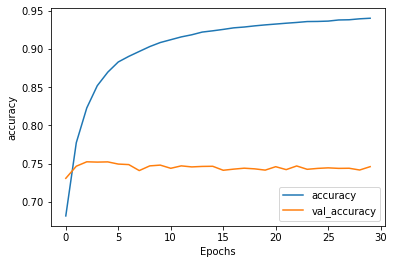

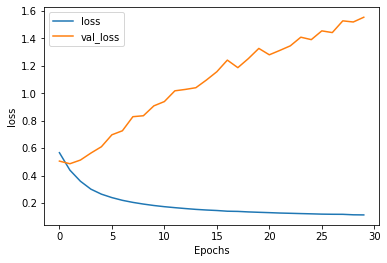

In [31]:
import matplotlib.pyplot as plt
def plot_graphs(history, string):
    plt.plot(history.history[string])
    plt.plot(history.history['val_' + string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_' + string])
    plt.show()
plot_graphs(history, 'accuracy')
plot_graphs(history, 'loss')